<a href="https://colab.research.google.com/github/mancai111/Rett_Mouse/blob/main/Other_Std_and_mean_of_all_coords_at_all_speeds_of_all_mice.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
import sys

# Mount Google Drive
drive.mount('/content/drive')

# Get the absolute path of the current folder
abspath_curr = '/content/drive/My Drive/TestCase/heatmap/'

curr = '/content/drive/My Drive/TestCase/preprocessed_data/'

import warnings

# Ignore warnings
warnings.filterwarnings('ignore')

Mounted at /content/drive


In [ ]:
import os
import math
import numpy as np
import pandas as pd
import seaborn as sns
from numpy import dot
from scipy import stats
from numpy.linalg import norm
import matplotlib.pyplot as plt
from collections import defaultdict

os.chdir(abspath_curr)
print(os.getcwd())

/content/drive/My Drive/TestCase/heatmap


In [ ]:
os.chdir(curr)
print(os.getcwd())

/content/drive/My Drive/TestCase/preprocessed_data


In [ ]:
# NC436 Wild Mouse
# Check speed up 60 and down 60, across 14 days

# Setup Parameters

# up_speed_list = 'fup60'
# down_speed_list = 'fdown60'
# speed_list = [up_speed_list, down_speed_list]
speed_list = ['fup0','fup15','fup30','fup45','fup60',
              'fdown60','fdown45','fdown30','fdown15','fdown0']

# Coordinate Heatmap

In [ ]:
def left_right_paw_heatmap(wb, speed, day, mouse):
    # read the paw movement data
    sample = pd.read_excel(wb, speed+' pawMovement').iloc[:,1:]
    
    # get LX, LY, RX, RY, round them to closet digit, and turn them into numpy form
    LX = sample.iloc[:,0]
    LX = np.rint(LX.to_numpy())
    LX_mean = np.mean(LX)
    LX_std = np.std(LX)

    LY = sample.iloc[:,1]
    LY = np.rint(LY.to_numpy())
    LY_mean = np.mean(LY)
    LY_std = np.std(LY)

    RX = sample.iloc[:,2]
    RX = np.rint(RX.to_numpy())
    RX_mean = np.mean(RX)
    RX_std = np.std(RX)

    RY = sample.iloc[:,3]
    RY = np.rint(RY.to_numpy())
    RY_mean = np.mean(RY)
    RY_std = np.std(RY)
    
    # organize a list of (x,y) coordinates
    coords_list_L = [i for i in zip(LX,LY)]
    coords_list_R = [i for i in zip(RX,RY)]
    coords_list = coords_list_L + coords_list_R

    # count the frequency of each (x,y) coordinate pair
    d = defaultdict(int)
    for i in coords_list:       
        d[i] += 1
        
    coords = [i for i in map(list, zip(*d.keys()))]
    
    # build a dataframe that has x-coord as column and y-coord as row
    column_list = sorted(set(coords[0]))
    index_list = sorted(set(coords[1]))
    df = pd.DataFrame(columns = column_list, index = index_list)

    # fill the values (frequency count)
    key_list, value_list = list(d.keys()), list(d.values())
    for i in range(len(d.keys())):
        df.loc[key_list[i][1], key_list[i][0]] = value_list[i]
    
    for i in np.arange(min(column_list),max(column_list)):
        if i not in df.columns:
            df[i] = np.nan
            
    for i in np.arange(min(index_list),max(column_list)):
        if i not in df.index:
            df.loc[i] = np.nan

    df = df.sort_index(axis=1)
    df = df.sort_index(axis=0)
    df = df.fillna(0)


    #####################
    # construct heatmap with the dataframe
    img_savePath = abspath_curr+mouse+'/'
    
    if not os.path.exists(img_savePath):
        os.makedirs(img_savePath)

    fig, ax = plt.subplots(figsize=(12, 8))
    plt.title(mouse+': Frequncy Count of X-Y for Paw Movement at ' + speed + ' on Day '+day)
    sns.heatmap(df)
    plt.ylim(max( max(LY), max(RY) ) - min( min(LY), min(RY) )+1,0)
    plt.savefig(img_savePath+'Day'+day+'_'+speed+'.png')
    plt.close()

    return LX_std, RX_std, LY_std, RY_std, LX_mean, RX_mean, LY_mean, RY_mean

# Std Mean + save heatmap

In [ ]:
def mouse_std_and_mean(mouse):
  dir_path = mouse + ' alignedNeuronPaw'
  len_days = len([name for name in os.listdir(dir_path)])

  if len_days == 14:
    days = ['1','2','3','4','5','6','7','8','9','10','11','12','13','14']
  elif len_days == 12:
    days = ['1','2','3','4','5','6','7','8','9','10','11','12']
  elif len_days == 11:
    days = ['1','2','3','4','5','6','7','8','9','10','11']

  # LX_std, RX_std, LY_std, RY_std, LX_mean, RX_mean, LY_mean, RY_mean

  up_LX_std_list = defaultdict(list)
  up_RX_std_list = defaultdict(list)
  up_LY_std_list = defaultdict(list)
  up_RY_std_list = defaultdict(list)

  down_LX_std_list = defaultdict(list)
  down_RX_std_list = defaultdict(list)
  down_LY_std_list = defaultdict(list)
  down_RY_std_list = defaultdict(list)

  up_LX_mean_list = defaultdict(list)
  up_RX_mean_list = defaultdict(list)
  up_LY_mean_list = defaultdict(list)
  up_RY_mean_list = defaultdict(list)

  down_LX_mean_list = defaultdict(list)
  down_RX_mean_list = defaultdict(list)
  down_LY_mean_list = defaultdict(list)
  down_RY_mean_list = defaultdict(list)

  for d in days:
    basename = '{mouse}-Day{day}_aligned.xlsx'.format(mouse = mouse, day=d)
    PN_WB = pd.ExcelFile(curr+mouse+' alignedNeuronPaw/'+basename) #curr and abspath_curr
    for i in speed_list:
      result = left_right_paw_heatmap(PN_WB, i, d, mouse)
      if 'up' in i:
        up_LX_std_list[i].append(result[0])
        up_RX_std_list[i].append(result[1])
        up_LY_std_list[i].append(result[2])
        up_RY_std_list[i].append(result[3])
        up_LX_mean_list[i].append(result[4])
        up_RX_mean_list[i].append(result[5])
        up_LY_mean_list[i].append(result[6])
        up_RY_mean_list[i].append(result[7])
      elif 'down' in i:
        down_LX_std_list[i].append(result[0])
        down_RX_std_list[i].append(result[1])
        down_LY_std_list[i].append(result[2])
        down_RY_std_list[i].append(result[3])
        down_LX_mean_list[i].append(result[4])
        down_RX_mean_list[i].append(result[5])
        down_LY_mean_list[i].append(result[6])
        down_RY_mean_list[i].append(result[7])

  return [
      up_LX_std_list, up_RX_std_list, 
      up_LY_std_list, up_RY_std_list,
      down_LX_std_list, down_RX_std_list,
      down_LY_std_list, down_RY_std_list,

      up_LX_mean_list, up_RX_mean_list,
      up_LY_mean_list, up_RY_mean_list,
      down_LX_mean_list, down_RX_mean_list,
      down_LY_mean_list, down_RY_mean_list,
      ]      

## Wild std mean

In [ ]:
std_mean_436 = mouse_std_and_mean('NC436-M-WT')

In [ ]:
std_mean_436

[defaultdict(list,
             {'fup0': [14.63761203170462,
               20.515756560492694,
               46.75607079187003,
               26.397067703764698,
               22.64530049696587,
               11.127919562287868,
               22.490479117377475,
               44.045224998045455,
               27.8395412944333,
               17.520669588780137,
               10.650959526176205,
               13.208613137888841,
               12.307383086343929,
               10.224033537093383],
              'fup15': [25.825485433465474,
               37.24191672133334,
               33.663281245968356,
               27.271177134220174,
               25.379455970323665,
               22.998843349017495,
               26.957897927479923,
               20.50618219801252,
               27.518505825394158,
               21.735568074689013,
               24.65998617292917,
               26.305414272370115,
               27.377236505423877,
               31.35502581

In [ ]:
std_mean_443 = mouse_std_and_mean('NC443-M-WT')
std_mean_506 = mouse_std_and_mean('NC506-M-WT')
std_mean_538 = mouse_std_and_mean('NC538-M-WT')
std_mean_541 = mouse_std_and_mean('NC541-M-WT')
std_mean_542 = mouse_std_and_mean('NC542-M-WT')

In [ ]:
std_mean_443

[defaultdict(list,
             {'fup0': [22.587801299923402,
               25.741816628612064,
               5.4819156825115085,
               28.158329853157205,
               21.50490675715467,
               32.182509736219366,
               6.3338004068640865,
               36.10871600845892,
               24.359237862893757,
               30.206319884231537,
               6.512732502692759,
               44.90958436305542,
               17.891204130086876,
               26.346506900324048],
              'fup15': [29.836236621668682,
               20.886315134189292,
               20.09538296606198,
               24.34672219067241,
               17.369548112519535,
               17.325736588652276,
               26.350004429958442,
               17.897328082026302,
               18.209190227741303,
               22.40784047300615,
               16.606986670417914,
               28.754817537128407,
               26.65568909590048,
               24.85486666

In [ ]:
std_mean_506

[defaultdict(list,
             {'fup0': [15.549412882575288,
               10.18221069215382,
               24.91458037564625,
               50.312248758517995,
               11.93343678015069,
               9.856578236202813,
               14.035546534501645,
               7.909618885914223,
               11.437558733623717,
               10.825968444295993,
               4.445093830672532,
               1.4583638208415104,
               11.950157884183438,
               8.725751471812154],
              'fup15': [18.503899403255808,
               19.307021644568998,
               29.665603624554727,
               31.000047618569166,
               22.240268494630143,
               21.780705481794797,
               17.00198914748927,
               19.8466002480134,
               25.246966897274,
               24.90157503835766,
               25.648191274411918,
               17.340555971755727,
               16.50298607250673,
               21.139089657118028

In [ ]:
std_mean_538

[defaultdict(list,
             {'fup0': [12.299995562544721,
               23.56214370875412,
               17.17360723877898,
               17.365805398584776,
               8.66181440315746,
               10.11369654166728,
               14.77815661497373,
               21.450987988886144,
               17.943203428945697,
               13.854850553590165,
               19.478115576524456,
               20.15485478383877,
               5.081873276445748,
               26.339496460678777],
              'fup15': [30.990783222221513,
               28.00338532898487,
               25.44249294541237,
               23.446430411169363,
               20.26140650828336,
               21.840995269769092,
               19.67170127556102,
               20.55245658058303,
               14.227429575954746,
               17.41683018750567,
               21.047266133699157,
               20.966782120370528,
               24.171289116023978,
               25.30829940268967

In [ ]:
std_mean_541

[defaultdict(list,
             {'fup0': [11.930503545509435,
               17.02091895485348,
               13.973866324787037,
               29.390302766839685,
               27.914015650067565,
               16.921619741839496,
               21.600788504195574,
               29.237033368202848,
               12.606727004266439,
               13.215992242026495,
               14.539038925501265,
               12.354420508071579,
               16.57456106295398,
               21.129867484846148],
              'fup15': [19.183514984089765,
               20.804273039477636,
               15.655767729945765,
               21.324641360397383,
               26.57733716962835,
               21.099208783831894,
               20.625175258767076,
               22.479821404874272,
               17.956602855176595,
               16.00790326911264,
               16.97134960586438,
               16.380180043167655,
               16.35166168172675,
               20.633496

In [ ]:
std_mean_542

[defaultdict(list,
             {'fup0': [10.509936750940211,
               8.86281564334667,
               15.22060963616078,
               23.154937127942603,
               6.242212972107039,
               8.04108362565204,
               15.210078187051844,
               17.31903423964219,
               18.775951981925733,
               5.679391436401361,
               23.094392392473225,
               27.723601155612773,
               13.863982438943808,
               3.786196829109983],
              'fup15': [21.9187211550533,
               23.624311022343342,
               25.57177905423438,
               23.801216066609587,
               22.03404753004779,
               22.047102813956354,
               22.39146145966808,
               25.98740399307123,
               23.91604908803332,
               23.46744596782191,
               24.518176341180347,
               19.979724549153186,
               25.052335986015425,
               23.80833282987194],


In [ ]:
std_mean_544 = mouse_std_and_mean('NC544-M-WT')
std_mean_771 = mouse_std_and_mean('NC771-M-WT')
std_mean_772 = mouse_std_and_mean('NC772-M-WT')
std_mean_786 = mouse_std_and_mean('NC786-M-WT')

In [ ]:
std_mean_544

[defaultdict(list,
             {'fup0': [16.836235206529626,
               19.331823771614776,
               7.548553446870991,
               2.5576139867553196,
               7.620609736986496,
               8.20835542728095,
               14.681387554667545,
               9.518336544380203,
               9.142023323301855,
               8.640831850133724,
               5.410952265260042,
               6.782920279867237,
               6.652700021204864,
               13.361944502767019],
              'fup15': [25.947086605731077,
               26.76049519625915,
               25.60360306083976,
               28.11892220481175,
               18.33198391816405,
               19.39653924714251,
               20.262273296229196,
               23.987076258571285,
               20.31080706024234,
               22.660266176714337,
               22.405002485085287,
               20.981668140796867,
               16.428699796492374,
               17.39725291773077],

In [ ]:
std_mean_771

[defaultdict(list,
             {'fup0': [12.484668892683533,
               30.040201334693048,
               52.13567671509244,
               52.44810036544661,
               11.41096800234923,
               21.505814477844513,
               19.920726715603163,
               15.479542557076131,
               10.35059990299419,
               8.130019933232424,
               9.484500692628874,
               7.842036599195232],
              'fup15': [26.065081318117397,
               21.768568260448614,
               22.555546700937803,
               29.011486380257875,
               20.916027043116358,
               18.759755781153263,
               17.164776318896312,
               23.76760738324556,
               21.771512390471823,
               21.25118411213309,
               23.740382842928298,
               24.370587189115184],
              'fup30': [21.960763475693344,
               16.07027046665008,
               15.306025363600272,
               18.

In [ ]:
std_mean_772

[defaultdict(list,
             {'fup0': [20.838446474942558,
               4.838683025397732,
               9.819993808177331,
               8.758640104054376,
               24.829879747266123,
               12.515354902964992,
               20.67915158713854,
               44.56413119663955,
               43.841119381976455,
               8.372475410240407,
               11.260473610549308,
               13.538370599455206],
              'fup15': [28.565870303914465,
               22.871144819992107,
               37.19469493075104,
               44.54175350215901,
               25.23942337524034,
               20.6836423617,
               23.5883373475606,
               27.0991444954892,
               19.884374173427346,
               18.88860880162698,
               17.327903141438494,
               23.16475244114469],
              'fup30': [22.871216755201456,
               20.09404735816856,
               31.67711940740173,
               34.042996871863

In [ ]:
std_mean_786

[defaultdict(list,
             {'fup0': [34.949398725389855,
               24.12965978611061,
               24.888501396978356,
               18.80367290091954,
               12.21751481603141,
               8.451046763964602,
               13.980244224359112,
               10.477300920435532,
               7.632990400613214,
               5.8257244563499375,
               13.428716045282677,
               14.276169085336091],
              'fup15': [29.21093875139584,
               26.784336856201815,
               24.92345629613971,
               19.28667020792756,
               28.72680214564036,
               18.226144741623262,
               20.630304530636643,
               22.123566573844176,
               18.653008206070478,
               20.010697864448012,
               17.873642963875408,
               18.072741943953005],
              'fup30': [33.512469342478894,
               22.61515018947759,
               31.051395664042637,
               30.

In [ ]:
std_mean_804 = mouse_std_and_mean('NC804-M-WT')

In [ ]:
std_mean_804

[defaultdict(list,
             {'fup0': [12.57089604796114,
               18.45887284369595,
               6.181836805767302,
               26.50137648342423,
               23.518961280180747,
               34.02878911644418,
               8.06697651915749,
               6.97764212259852,
               9.421829731787376,
               14.216997328874845,
               24.910828974419662,
               13.01217904572201],
              'fup15': [34.45754130929302,
               26.545017054531936,
               14.519736316862627,
               16.116275582390916,
               16.18945694224669,
               19.614218351517625,
               17.77797946822292,
               26.559785961054644,
               20.731873975323644,
               14.621607896636396,
               12.756905059997885,
               13.37737758119092],
              'fup30': [20.463214276150357,
               17.879683924196243,
               19.035301640054033,
               20.29988

## Rett std mean

In [ ]:
std_mean_437 = mouse_std_and_mean('NC437-M-NL')

In [ ]:
std_mean_437

[defaultdict(list,
             {'fup0': [9.292598933512135,
               2.1830331182233778,
               11.609032721173746,
               1.1938150720945968,
               5.076688356066155,
               10.975431937624956,
               5.867023908921876,
               9.392654028403188,
               9.370087340925283,
               2.333770557920377,
               5.876222742986968,
               4.273984467568505,
               4.552972585854242,
               2.1218799447047165],
              'fup15': [26.73090127801994,
               15.19436470138047,
               11.1160975183155,
               10.16993807364832,
               12.101320926593662,
               11.266149469583569,
               12.503783537170943,
               12.661343077373951,
               13.70537949475942,
               17.594089322446727,
               19.208341712893308,
               20.667030437053263,
               18.49850799762193,
               18.46789438916897],

In [ ]:
std_mean_440 = mouse_std_and_mean('NC440-M-NL')

In [ ]:
std_mean_442 = mouse_std_and_mean('NC442-M-NL')
std_mean_539 = mouse_std_and_mean('NC539-M-NL')
std_mean_540 = mouse_std_and_mean('NC540-M-NL')
std_mean_545 = mouse_std_and_mean('NC545-M-NL')

In [ ]:
std_mean_440

[defaultdict(list,
             {'fup0': [10.333893101336928,
               22.27875808479725,
               16.293841105618394,
               25.61182384266837,
               11.989344646848833,
               25.459107858004135,
               5.759903952848292,
               10.229991734355542,
               12.861931645947264,
               48.25630811277075,
               20.27705280030486,
               11.071076399395613,
               7.555437945382577,
               6.829467623241947],
              'fup15': [35.49411100500196,
               23.0731320522665,
               21.538831533832965,
               24.82757698238119,
               24.688097145519528,
               24.019544655096706,
               20.014212761290956,
               20.2511015937617,
               17.673439403479502,
               16.259189408577807,
               16.4604766023026,
               14.062341625994245,
               14.805904175054227,
               19.665301214553214

In [ ]:
std_mean_442

[defaultdict(list,
             {'fup0': [28.52575887016804,
               69.08895889962393,
               9.522904835010955,
               6.506019903626346,
               6.237446189572307,
               4.676103934719252,
               2.579174692905523,
               9.701805418993672,
               12.866016844835949,
               7.526147069149242,
               2.833614676135499,
               17.669824464818387,
               11.011508311742945,
               4.603323157782132],
              'fup15': [18.326136757672735,
               20.879026546337375,
               14.108987451626566,
               20.2004218229682,
               11.416649201001931,
               15.192951683582251,
               16.51922275007524,
               15.445219114504821,
               12.298244389952707,
               13.383495475799474,
               15.763005943723998,
               18.211450097330054,
               16.893039414986852,
               14.87401892361689

In [ ]:
std_mean_539

[defaultdict(list,
             {'fup0': [14.957558234339071,
               6.34226550746309,
               9.435365940533723,
               2.4633399600457566,
               3.4820653949358404,
               3.4032264251764492,
               9.060181288993451,
               4.630403964127016,
               0.6284819634995791,
               2.2468660001308947,
               11.352615733322725,
               3.9199643415728356,
               1.6408949842314842,
               6.235857711258214],
              'fup15': [16.803289291179773,
               24.24998686932011,
               13.459878700057319,
               16.527149397430506,
               17.589486117738293,
               19.953936163104196,
               14.551225287283737,
               15.768415158870832,
               16.330575665141332,
               16.393635471712873,
               15.23016425740304,
               15.434450402647398,
               13.991878972728262,
               17.34431654

In [ ]:
std_mean_540

[defaultdict(list,
             {'fup0': [1.1626235158979867,
               2.8996348672601036,
               3.8658278914889386,
               2.6546288424829982,
               4.943491588000535,
               1.3001596165752354,
               6.189818346637584,
               2.7558327415924757,
               2.188443754991295,
               0.8850427184704552,
               1.4302314963542657,
               5.533345123277615,
               3.7134220174070762,
               2.730603409472232],
              'fup15': [13.3006302296728,
               18.45562386192925,
               19.1809025306724,
               17.6209395159515,
               16.917961990010337,
               20.357916248451076,
               20.350802628596107,
               22.225960302383168,
               14.688630344218733,
               13.791327697786079,
               12.48643986170293,
               13.50495686014316,
               13.437570413584744,
               17.41240464987563

In [ ]:
std_mean_545

[defaultdict(list,
             {'fup0': [5.205178979398934,
               8.984313060497785,
               4.365996110974401,
               7.9730954914309935,
               1.1192902321393199,
               1.0337964812445746,
               2.4368651567304704,
               2.4497438370218085,
               2.7700041452316193,
               8.739701719219543,
               2.077496327278182,
               4.272315659019315,
               7.3607936338130875,
               5.999370243675548],
              'fup15': [16.592688699763663,
               15.28283812096622,
               12.632353099676056,
               11.10454451584269,
               9.678355809499475,
               9.72160955290592,
               16.74784541980336,
               14.823143306171898,
               15.878504837533894,
               17.70170132726899,
               15.420583595792737,
               14.242851550986718,
               14.653249917024896,
               16.06309297803093

In [ ]:
std_mean_770 = mouse_std_and_mean('NC770-M-NL')
std_mean_773 = mouse_std_and_mean('NC773-M-NL')
std_mean_787 = mouse_std_and_mean('NC787-M-NL')
std_mean_790 = mouse_std_and_mean('NC790-M-NL')
std_mean_797 = mouse_std_and_mean('NC797-M-NL')
std_mean_802 = mouse_std_and_mean('NC802-M-NL')

In [ ]:
std_mean_770

[defaultdict(list,
             {'fup0': [16.379957900472217,
               6.938459556054229,
               10.893720671502459,
               9.350051248069944,
               8.679116035986272,
               6.582457303155357,
               17.98294125710109,
               9.31175747562154,
               9.118305645284577,
               5.9263654016624,
               5.764783712775207,
               2.1615929072412463],
              'fup15': [21.052221846811364,
               16.084518568550035,
               11.816583710020389,
               15.181020494214875,
               27.06204250388279,
               19.169210316358246,
               17.66816410967728,
               18.66866363417064,
               15.296228117387187,
               12.362148918723316,
               13.348199734456271,
               14.788844014697416],
              'fup30': [16.563897805555975,
               15.789923647056654,
               12.669162839504732,
               12.02476

In [ ]:
std_mean_773

[defaultdict(list,
             {'fup0': [0.7848999100550805,
               4.376910186520248,
               0.6233377214336737,
               2.1585953569523704,
               1.609751030279508,
               1.4945124070041136,
               3.5264039956343693,
               1.16367786101284,
               3.7679895760047093,
               1.7067391602316675,
               5.0292587680892975,
               0.9876031815169045],
              'fup15': [14.295584399476887,
               15.448188025747937,
               13.154277354771033,
               15.514851504339548,
               15.27602044902508,
               24.206914904616934,
               24.37333262292204,
               21.651283850133225,
               22.24715996584238,
               17.021605642586767,
               19.72323538503608,
               20.88948628587608],
              'fup30': [19.61996509963812,
               15.958987737368908,
               12.873359722572387,
               12.

In [ ]:
std_mean_787

[defaultdict(list,
             {'fup0': [1.3550244967150058,
               0.6733678857514812,
               15.190070212565145,
               1.1175484447757154,
               1.873546131187468,
               5.731555225527196,
               2.052274988716318,
               4.441871282789092,
               2.655088239176457,
               1.4389921311734977,
               0.7520640176579827,
               0.6611682596437002],
              'fup15': [20.45718675623952,
               24.772257340788915,
               16.622043752690402,
               14.017707609058982,
               21.60621880748462,
               22.706382588944813,
               23.401167053144952,
               15.176521045761248,
               12.130647644959632,
               12.57936728907474,
               18.061365845004826,
               18.29489974279413],
              'fup30': [17.845083209097,
               16.153434257330677,
               12.064931714621727,
               14.09

In [ ]:
std_mean_790

[defaultdict(list,
             {'fup0': [9.371967415779059,
               3.8490552614875226,
               2.134874781873738,
               1.9307584855368534,
               1.4985243590729918,
               7.516845749196231,
               3.959858963196318,
               5.148307764026186,
               4.998865864802856,
               1.075917507656108,
               2.0111056791003894,
               0.990817318930708],
              'fup15': [18.957264554408773,
               17.08801054247304,
               12.64196459650615,
               8.361951495937683,
               12.24124774726091,
               14.984037975432361,
               16.069882514007052,
               14.423911608146652,
               10.865287293908075,
               13.277051445291788,
               12.341237365751415,
               13.396260862427162],
              'fup30': [16.806147316813362,
               14.684511929059582,
               10.065018651575535,
               8.900

In [ ]:
std_mean_797

[defaultdict(list,
             {'fup0': [17.969931627721767,
               6.173929142296626,
               4.134257063625291,
               3.1960795687597536,
               3.739772634472272,
               2.753231066638414,
               11.11828666375488,
               2.0815613442495793,
               4.716084220094128,
               5.929713709289786,
               11.200408461540741],
              'fup15': [18.18708177599627,
               16.095772099949333,
               14.726764897204017,
               9.87958866102782,
               12.191457339922044,
               10.408653324351773,
               25.55002222473824,
               14.550742149213525,
               17.67081437697312,
               19.126568371800236,
               16.935769343543743],
              'fup30': [12.66971374527104,
               13.468337624593158,
               9.271152551951802,
               9.498974633755344,
               10.562924110481985,
               9.505285

In [ ]:
std_mean_802

[defaultdict(list,
             {'fup0': [3.193721182228336,
               3.3087283995656116,
               1.1711624164293963,
               4.511648495872203,
               4.548870938460686,
               12.562881750230241,
               2.770528811857425,
               4.454478983218907,
               10.208594864065875,
               7.176900025148352,
               3.5889724482220875,
               8.157274269589921],
              'fup15': [17.965006623653565,
               15.306254629712619,
               11.762242529372582,
               17.81044162695181,
               13.568434404241392,
               19.041195544716782,
               24.46403552637065,
               21.4746493796083,
               22.627756309519402,
               18.950338435934945,
               17.00391004578566,
               22.731101522138555],
              'fup30': [17.060587268287005,
               15.08989550420169,
               9.31366576169921,
               9.130539

# Plot

## Wild Std

In [ ]:
def generate_df_list(mouse_list, index, speed):
  d_list = []
  for i in mouse_list:
    value = i[index]
    stat = value[speed]
    d_list.append(stat)
  return d_list

In [ ]:
def plotline(df_list, l_list, xt, stat, pos, speed, type):
  
  array_list = []
  for i in df_list:
    p = np.asarray(i)
    array_list.append(p)

  x = range(14)

  plt.figure(figsize=(12,10))
  plt.xticks(x, xt)
  plt.ylim(0,60)
  plt.title(stat + ' of ' + pos + ' at ' + speed + ' (' + type + ')')

  for i in range(len(l_list)):
    plt.plot(array_list[i], label=l_list[i])

  plt.legend()
  plt.show()

In [ ]:
wild = [std_mean_436,
std_mean_443,
std_mean_506,
std_mean_538,
std_mean_541,
std_mean_542,
std_mean_544,
std_mean_771,
std_mean_772,
std_mean_786,
std_mean_804]

rett = [std_mean_437,
std_mean_440,
std_mean_442,
std_mean_539,
std_mean_540,
std_mean_545,
std_mean_770,
std_mean_773,
std_mean_787,
std_mean_790,
std_mean_797,
std_mean_802]

wild_labels = ['NC436', 'NC443', 'NC506', 'NC538', 'NC541', 'NC542', 'NC544', 'NC771', 'NC772', 'NC786', 'NC804']
rett_labels = ['NC437', 'NC440', 'NC442', 'NC539', 'NC540', 'NC545', 'NC770', 'NC773', 'NC787', 'NC790', 'NC797', 'NC802']

days = ['1','2','3','4','5','6','7','8','9','10','11','12','13','14']

up_speed_list = ['fup0','fup15','fup30','fup45','fup60']
down_speed_list = ['fdown60','fdown45','fdown30','fdown15','fdown0']

up_title_list = ['Up0', 'Up15', 'Up30', 'Up45', 'Up60'] 
down_title_list = ['Down60', 'Down45', 'Down30', 'Down15', 'Down0']

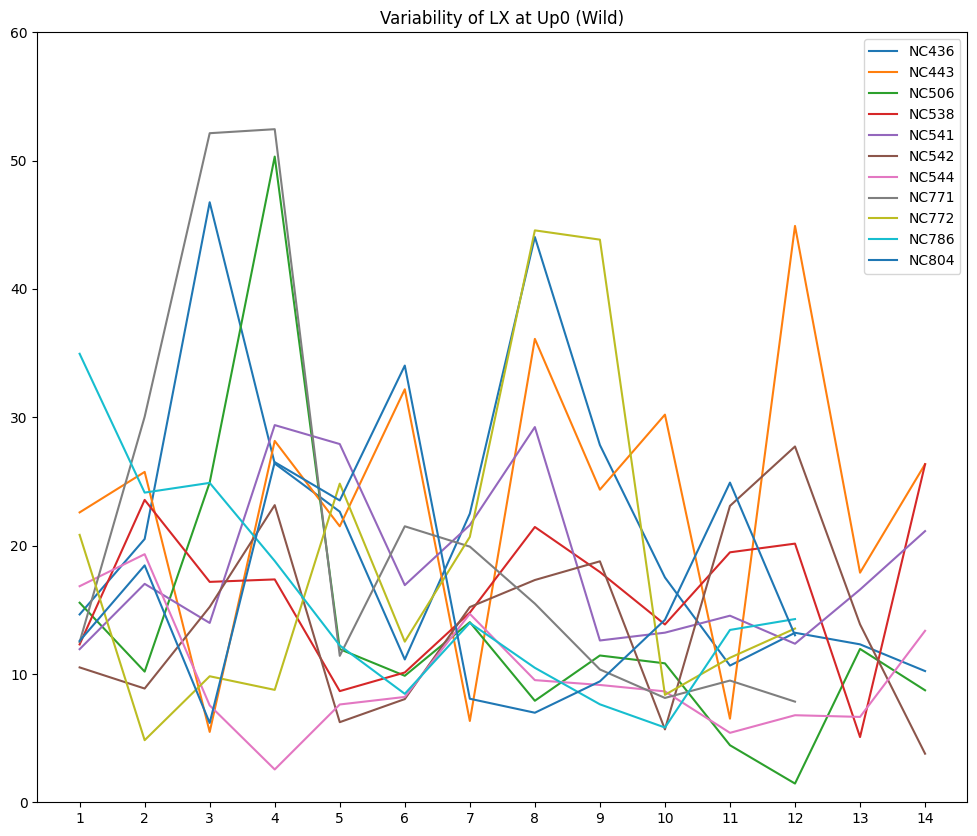

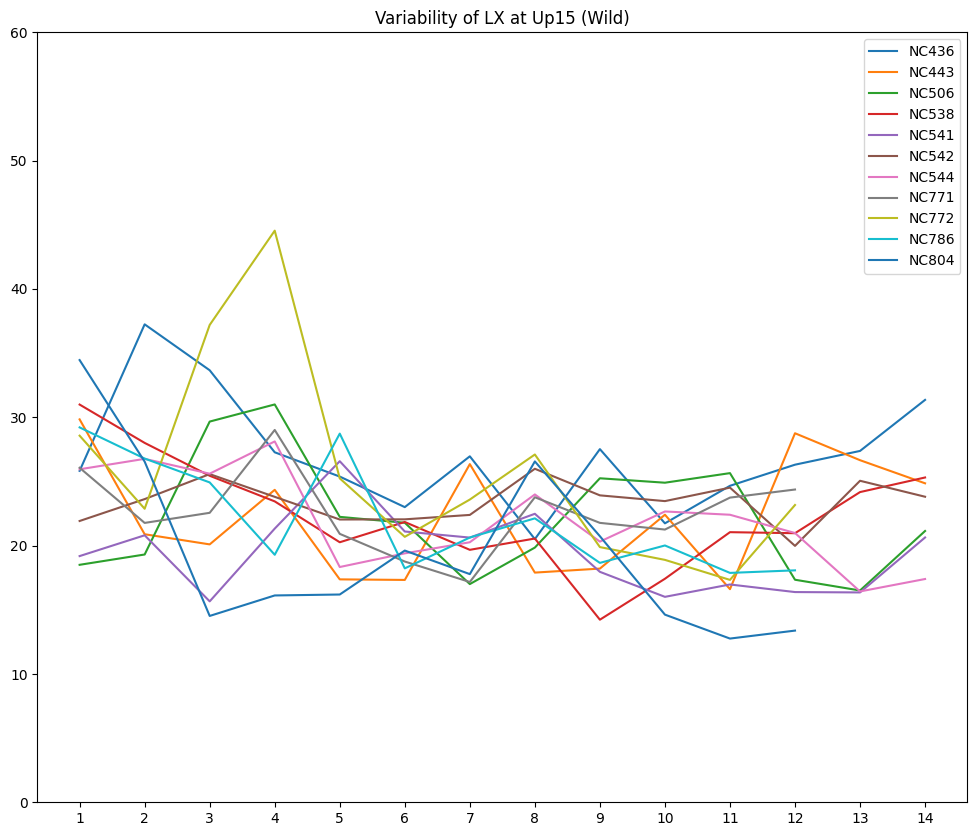

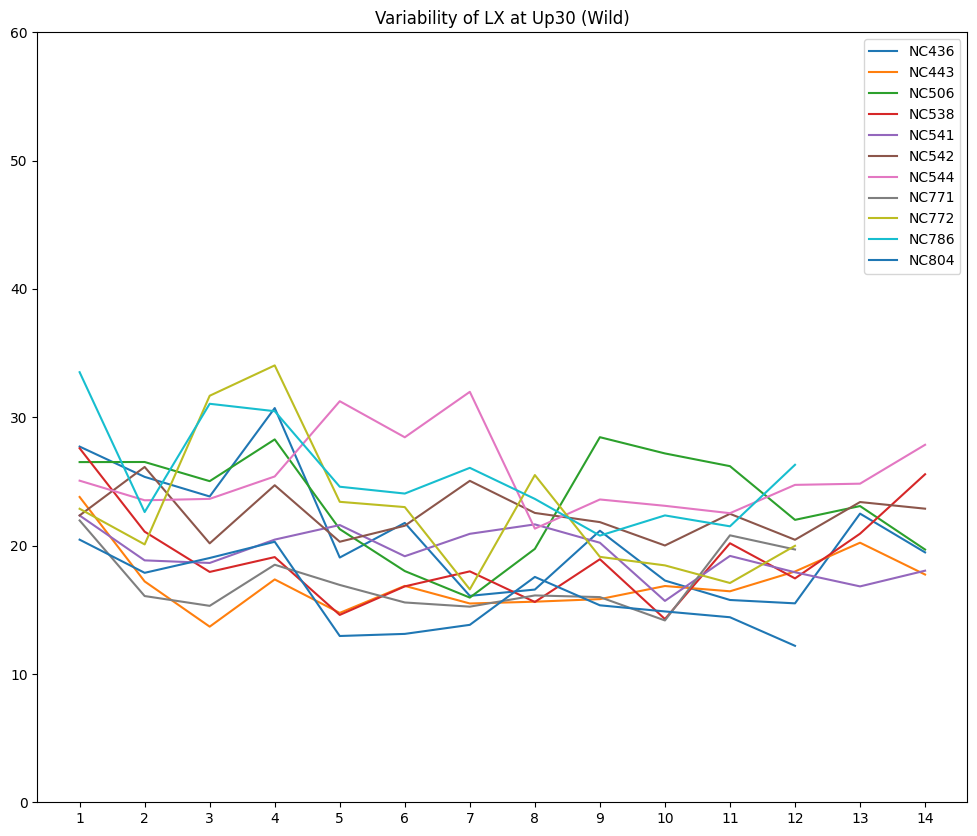

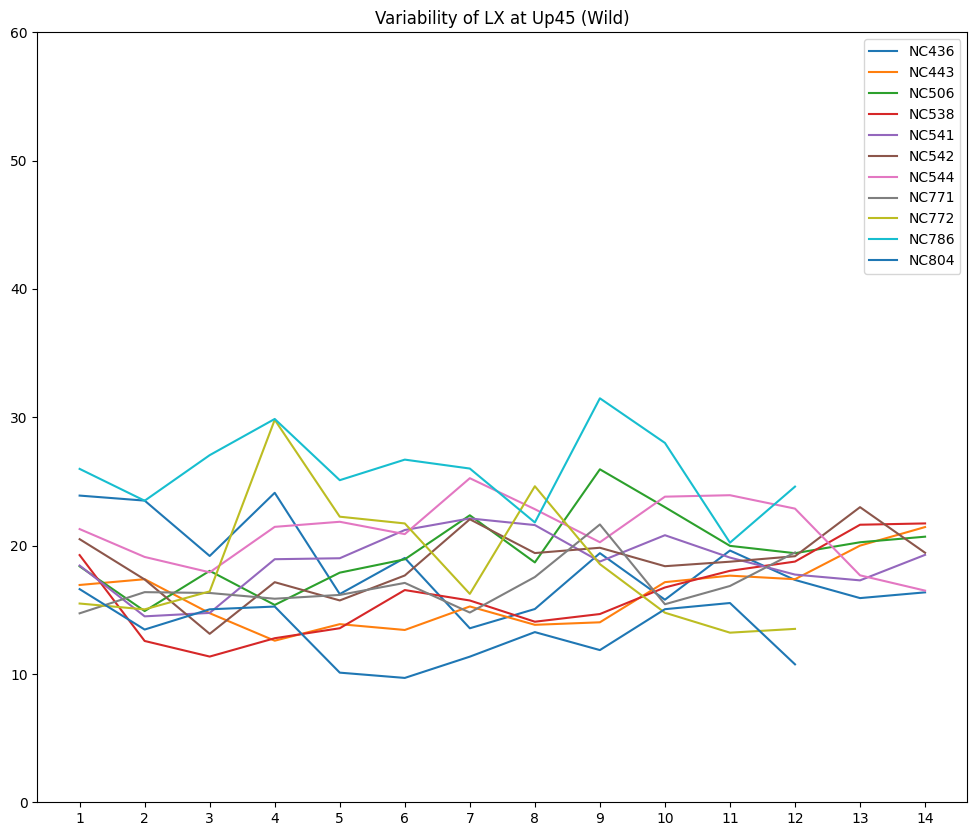

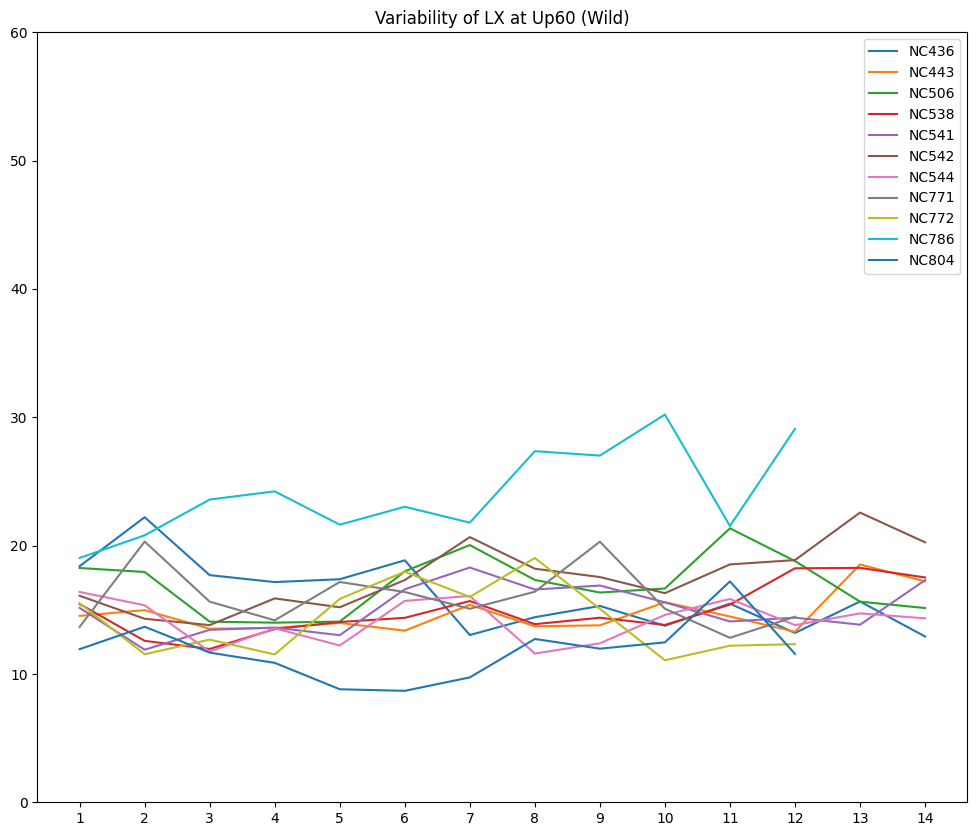

In [ ]:
# 0: up_LX_std_list

for i in range(len(up_speed_list)):
  df = generate_df_list(wild, 0, up_speed_list[i])
  plotline(df, wild_labels, days, 'Variability', 'LX', up_title_list[i], 'Wild')

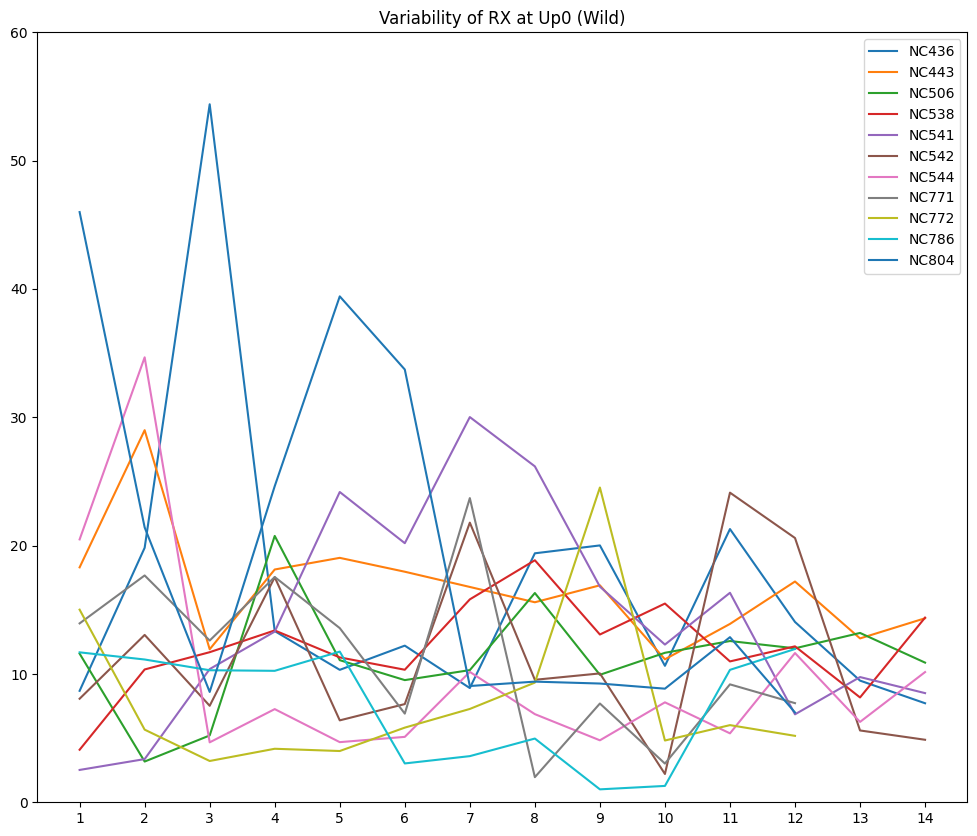

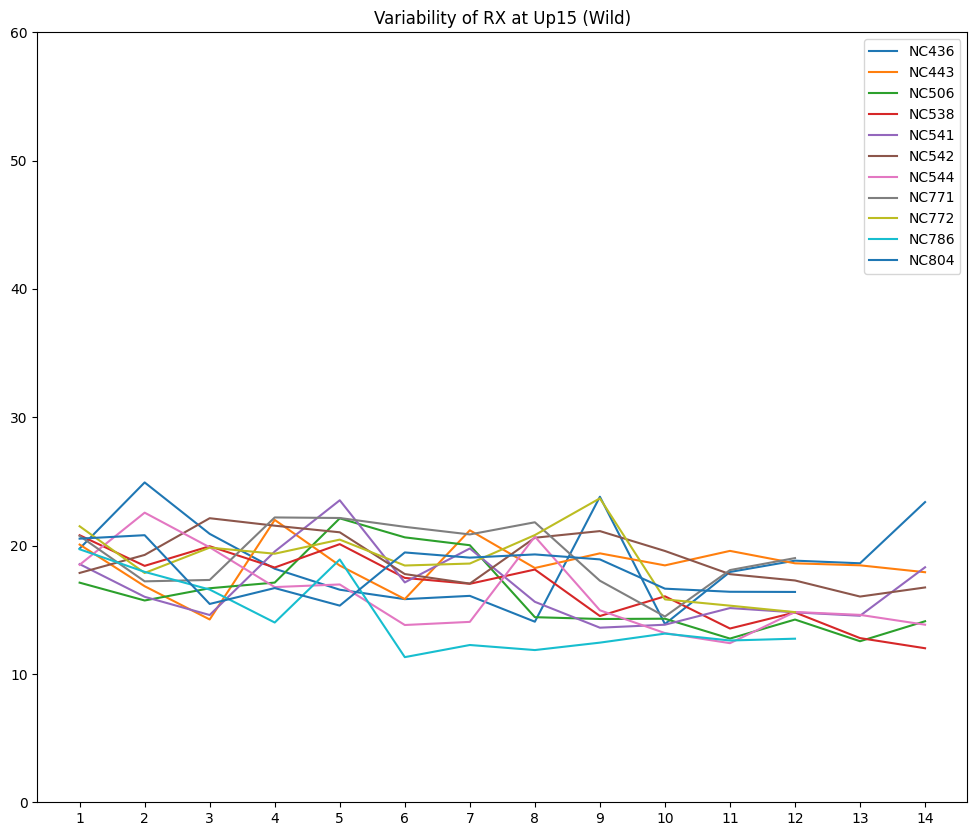

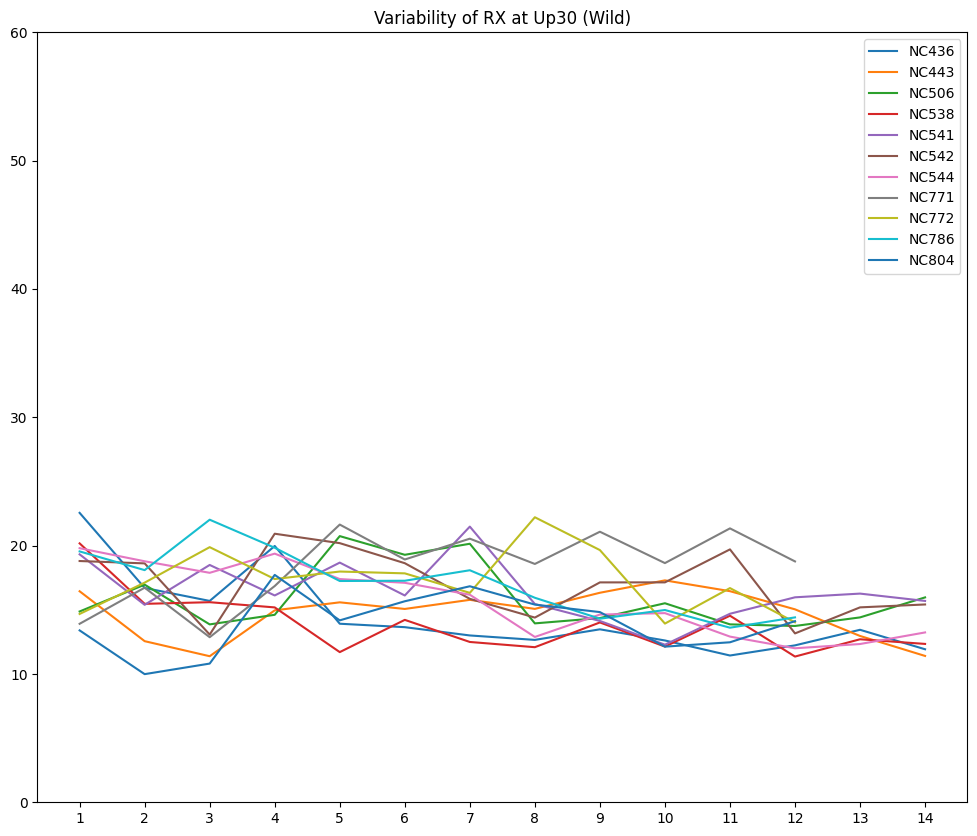

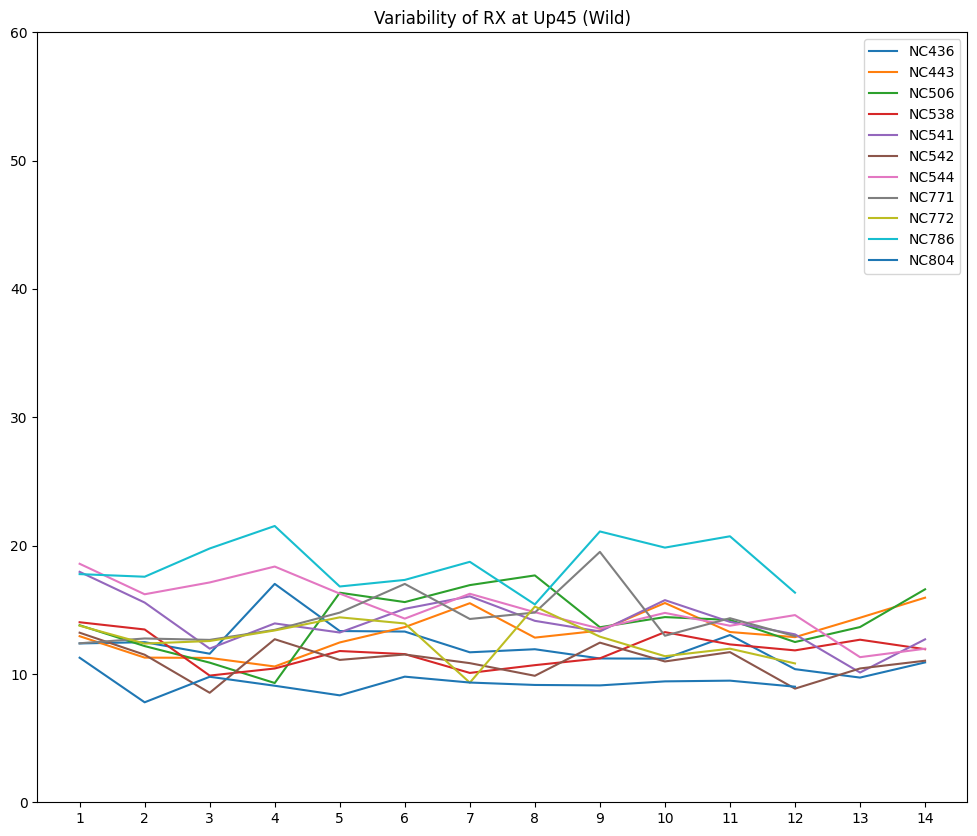

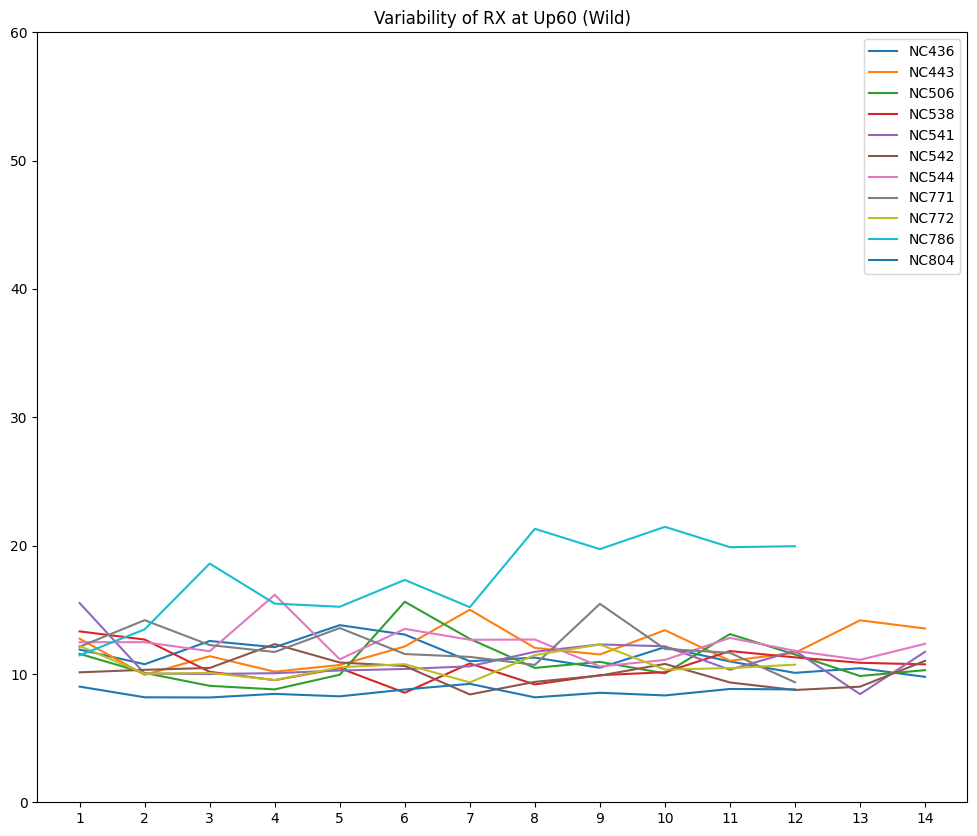

In [ ]:
# 1: up_RX_std_list

for i in range(len(up_speed_list)):
  df = generate_df_list(wild, 1, up_speed_list[i])
  plotline(df, wild_labels, days, 'Variability', 'RX', up_title_list[i], 'Wild')

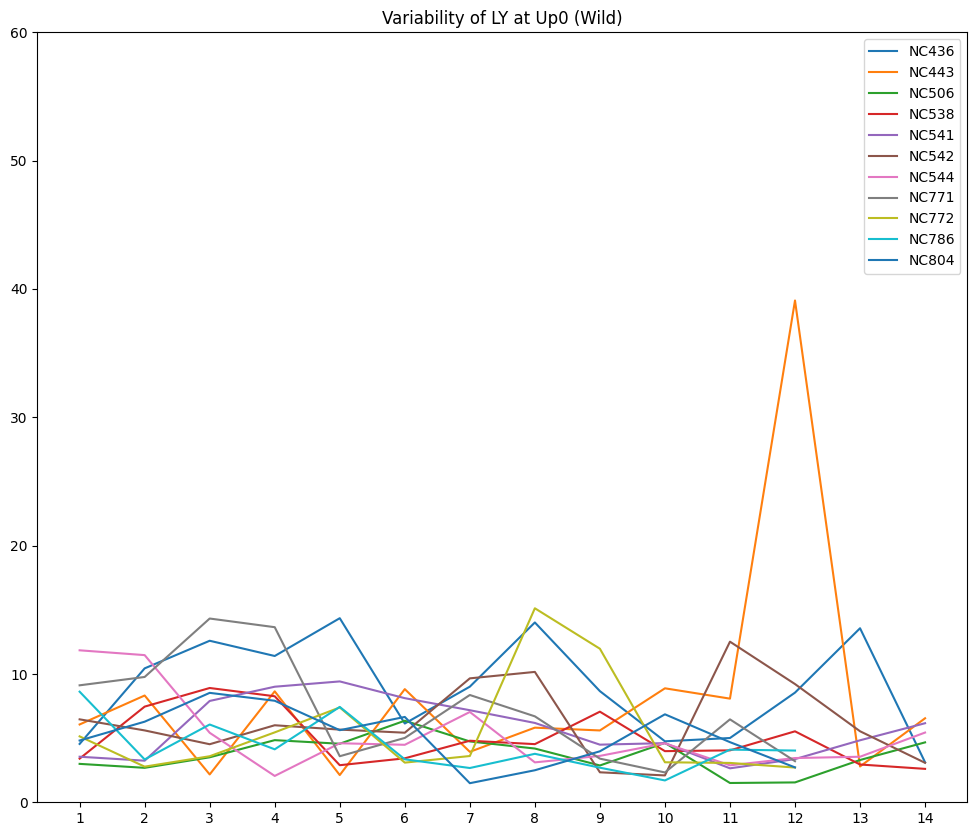

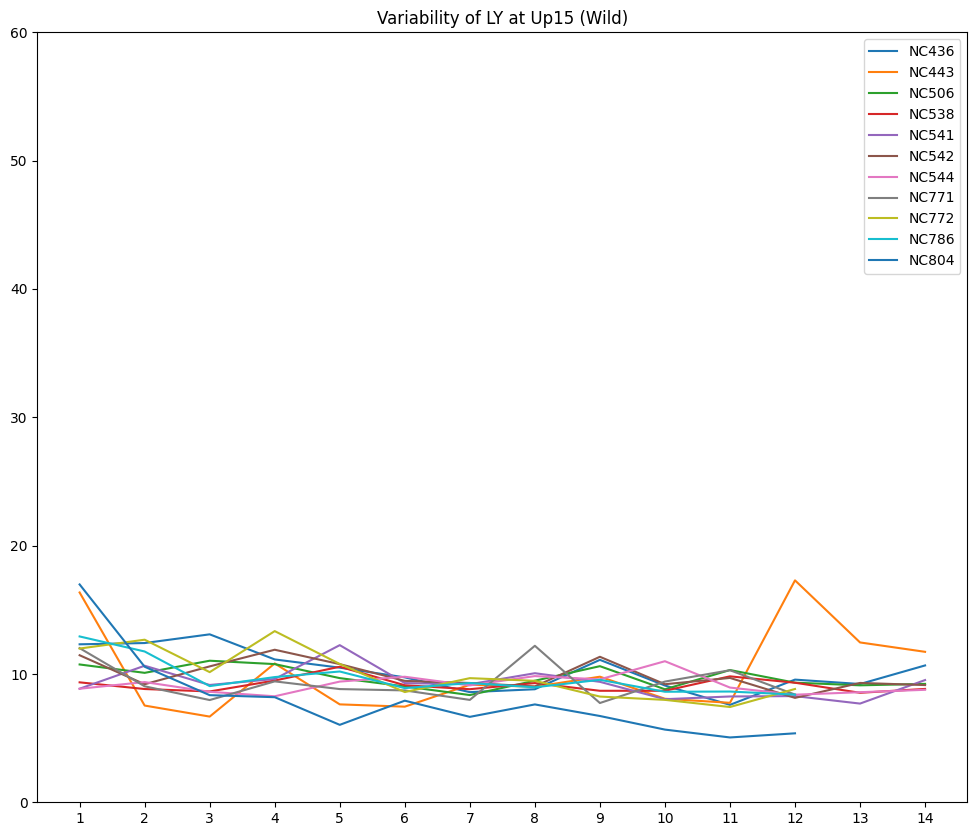

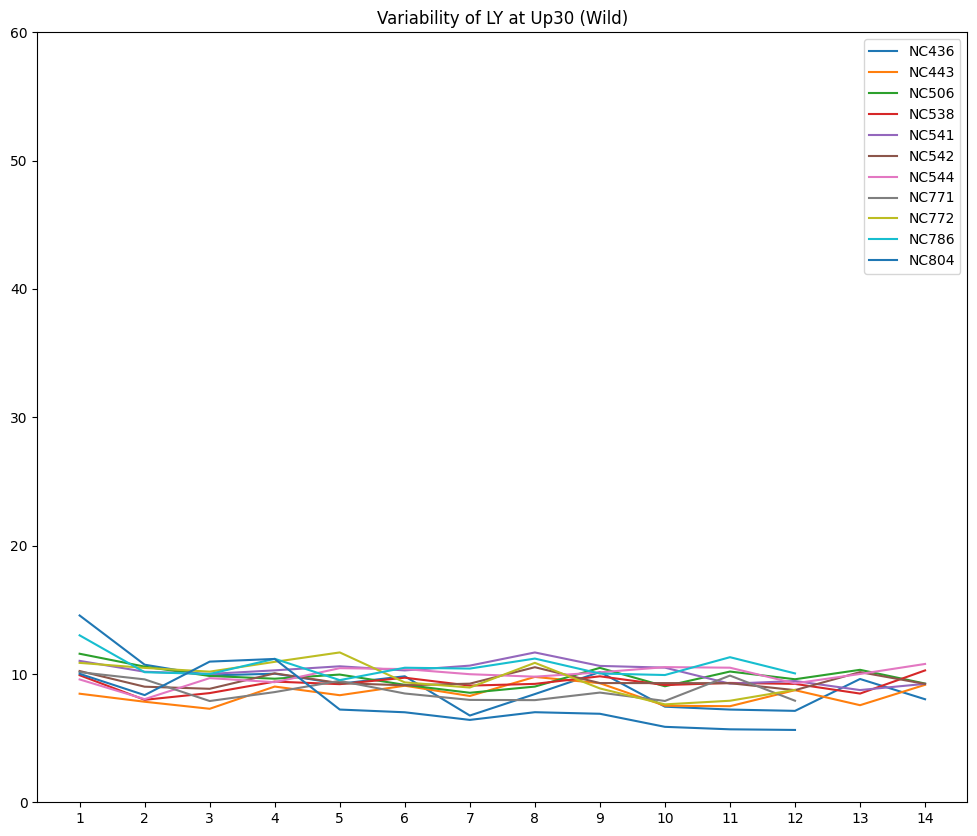

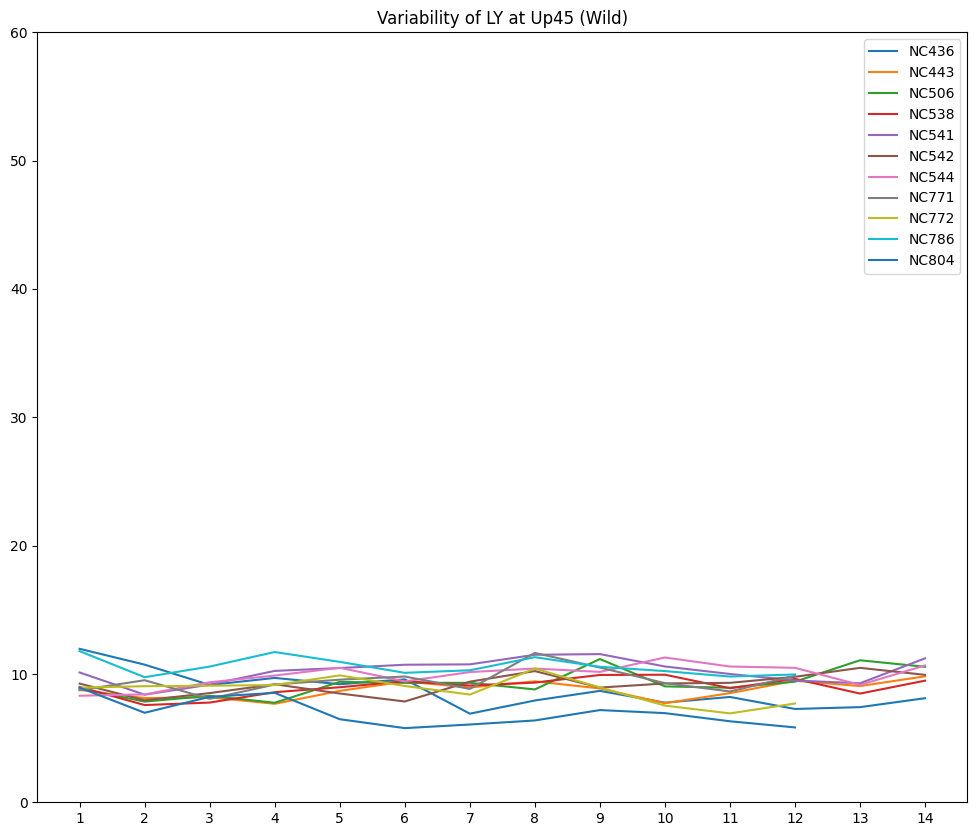

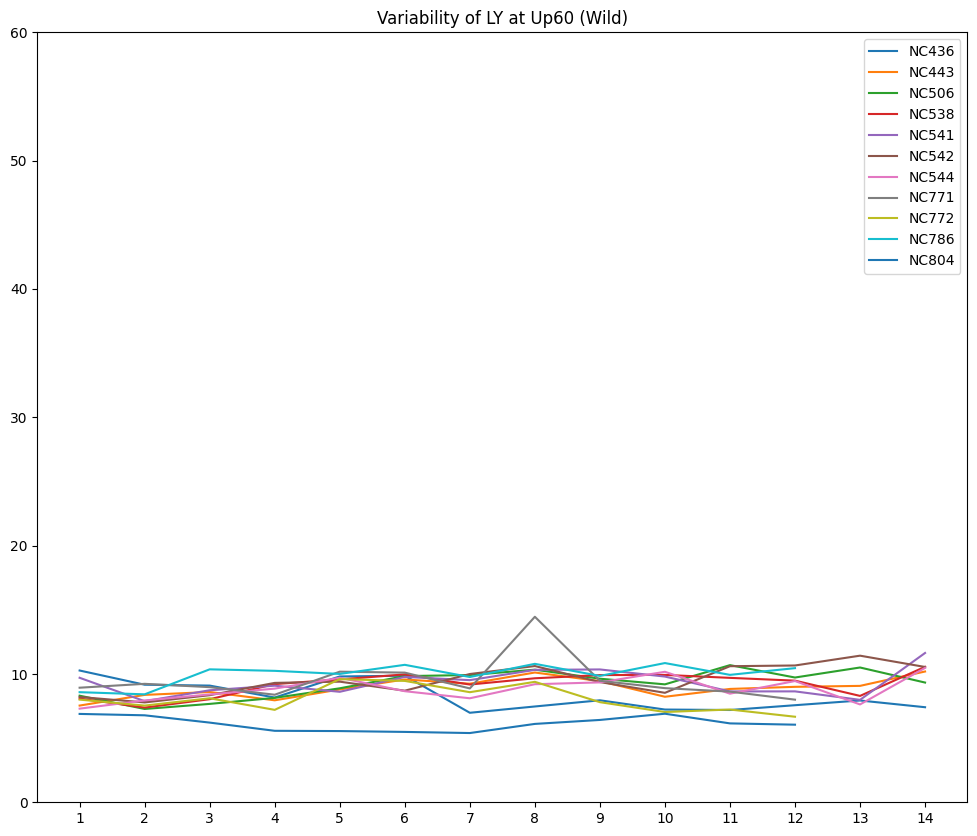

In [ ]:
# 2: up_LY_std_list

for i in range(len(up_speed_list)):
  df = generate_df_list(wild, 2, up_speed_list[i])
  plotline(df, wild_labels, days, 'Variability', 'LY', up_title_list[i], 'Wild')

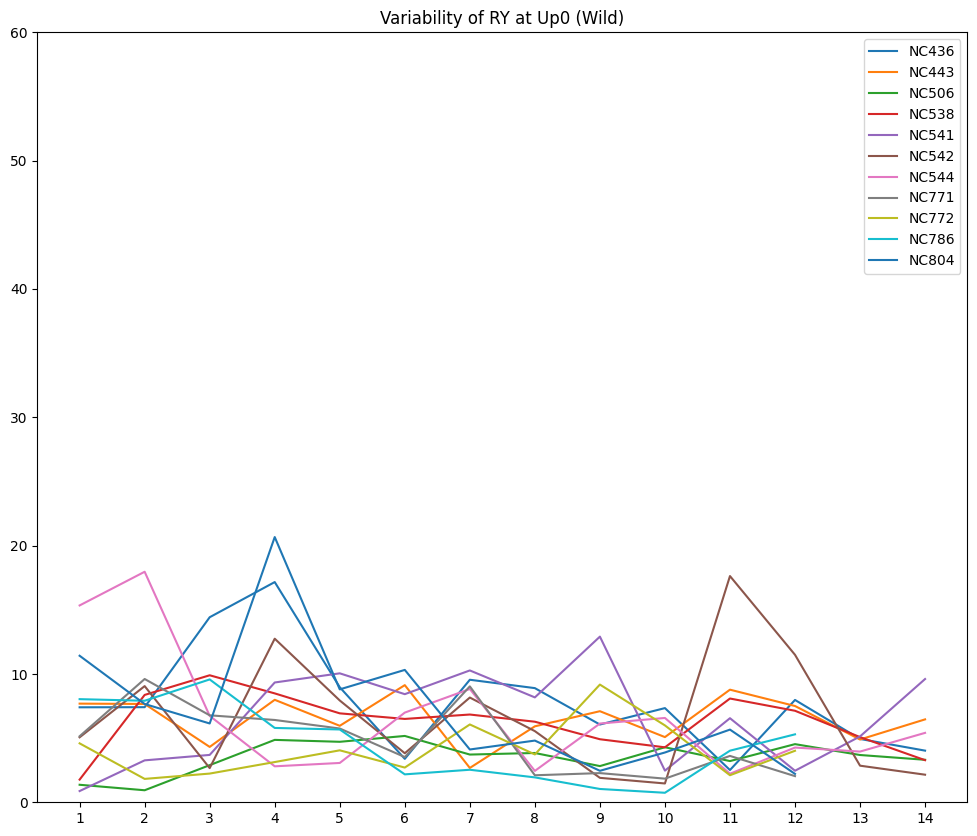

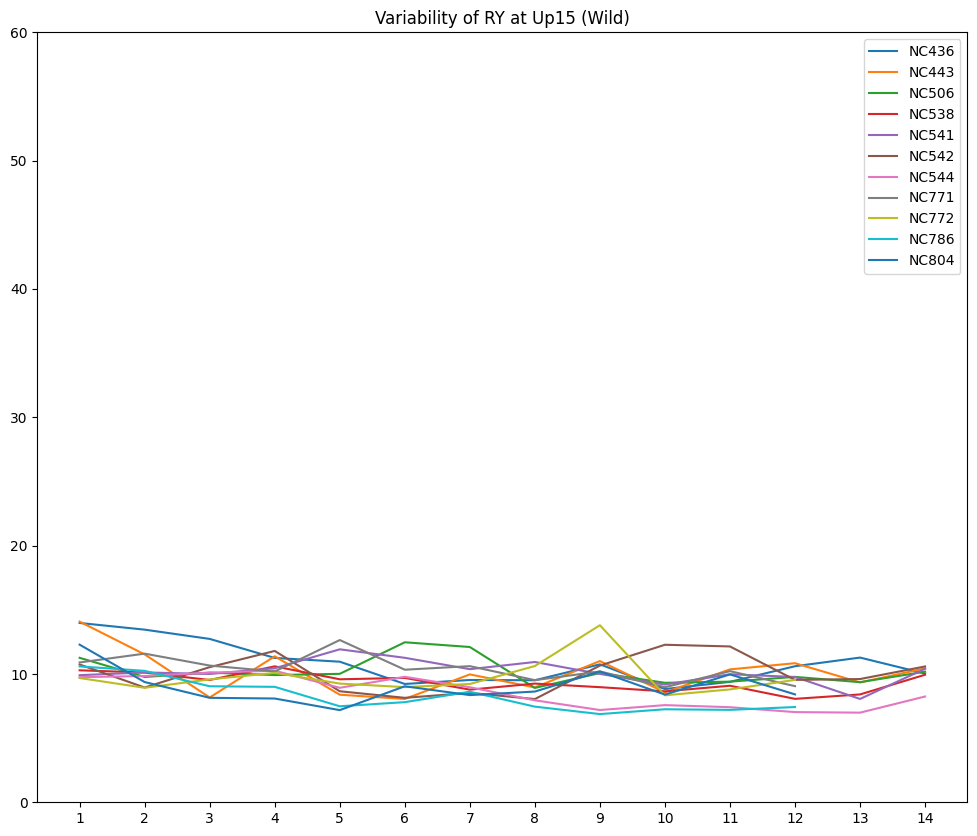

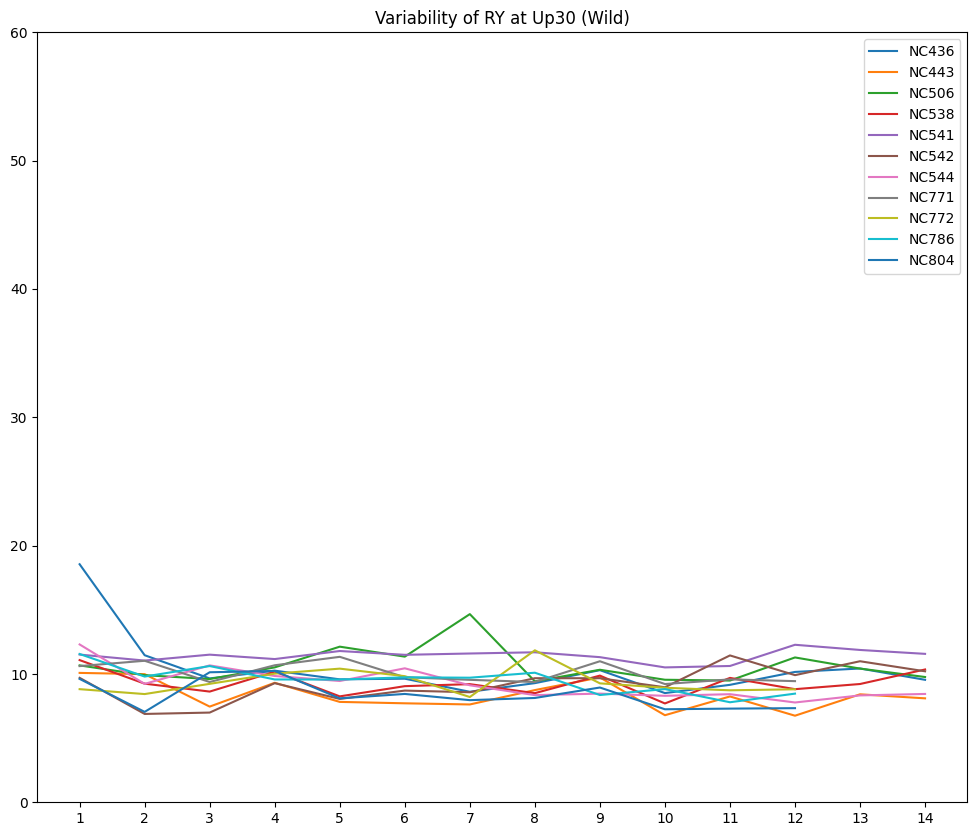

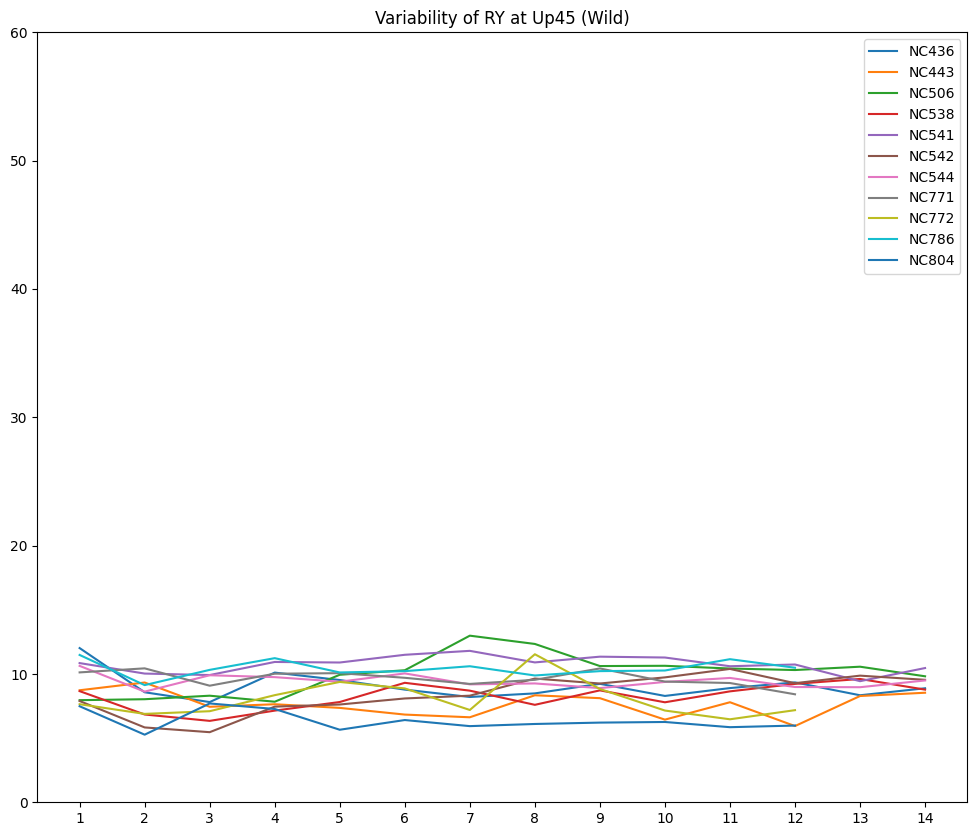

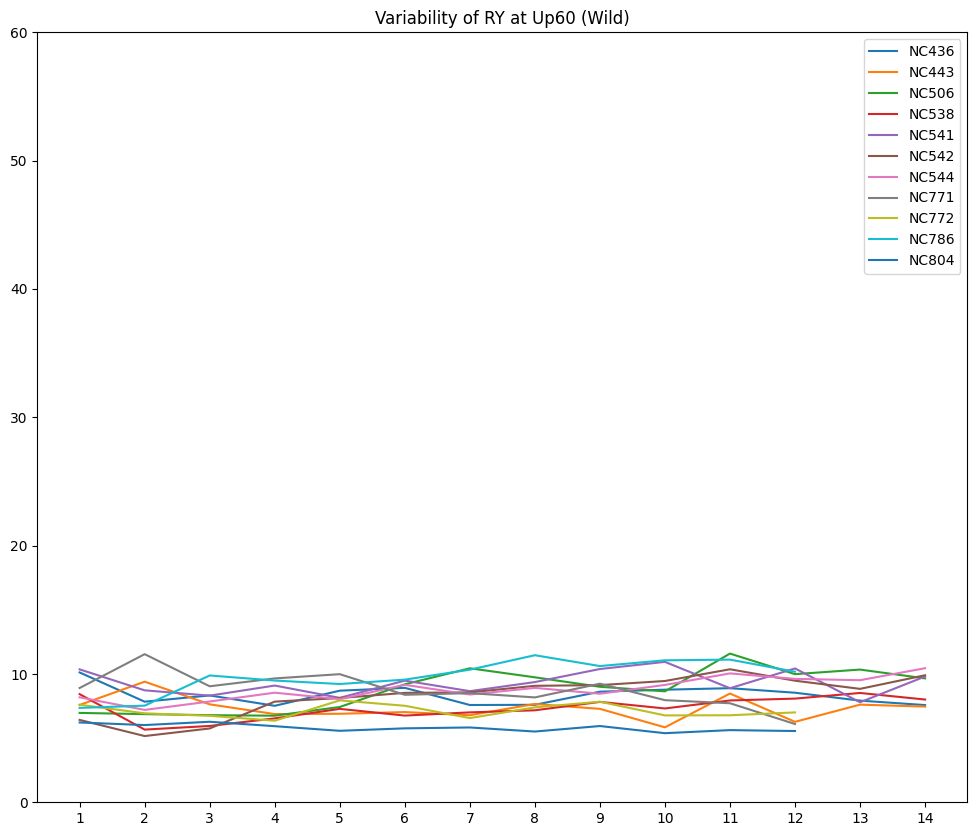

In [ ]:
# 3: up_RY_std_list

for i in range(len(up_speed_list)):
  df = generate_df_list(wild, 3, up_speed_list[i])
  plotline(df, wild_labels, days, 'Variability', 'RY', up_title_list[i], 'Wild')

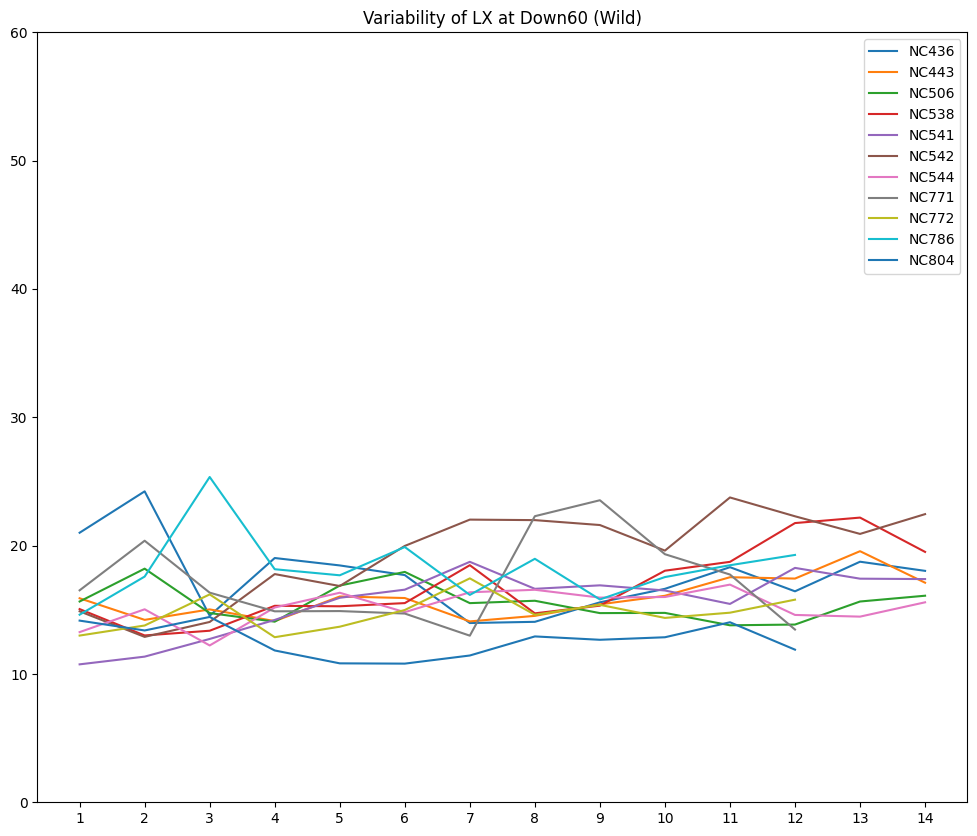

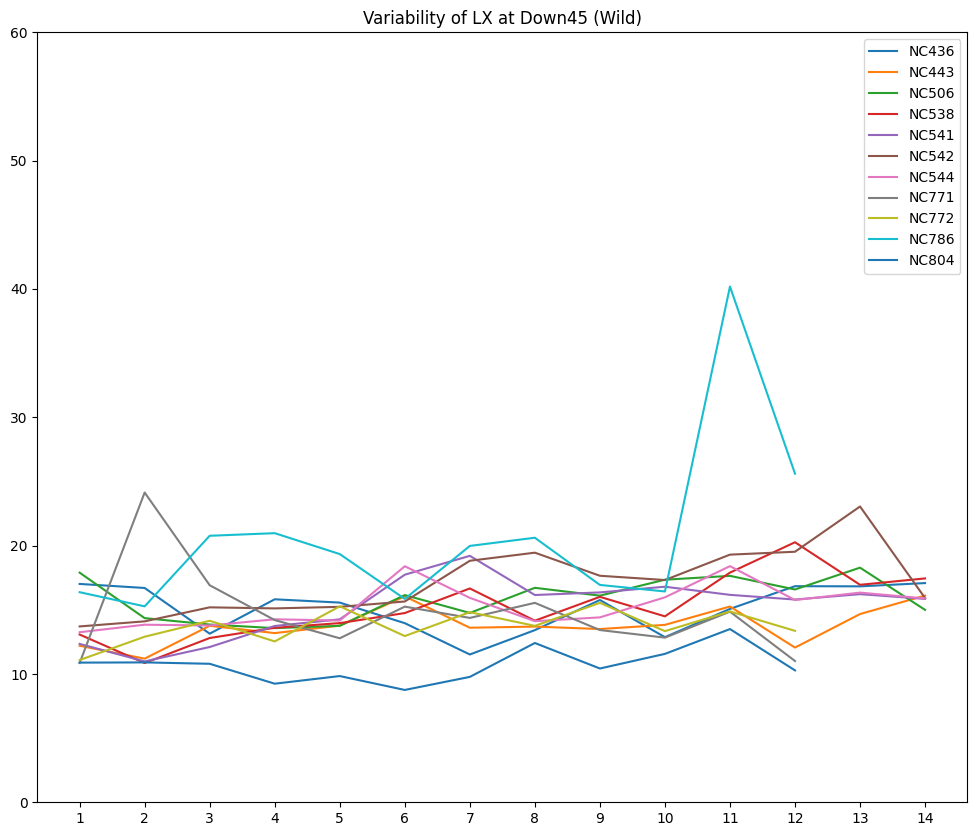

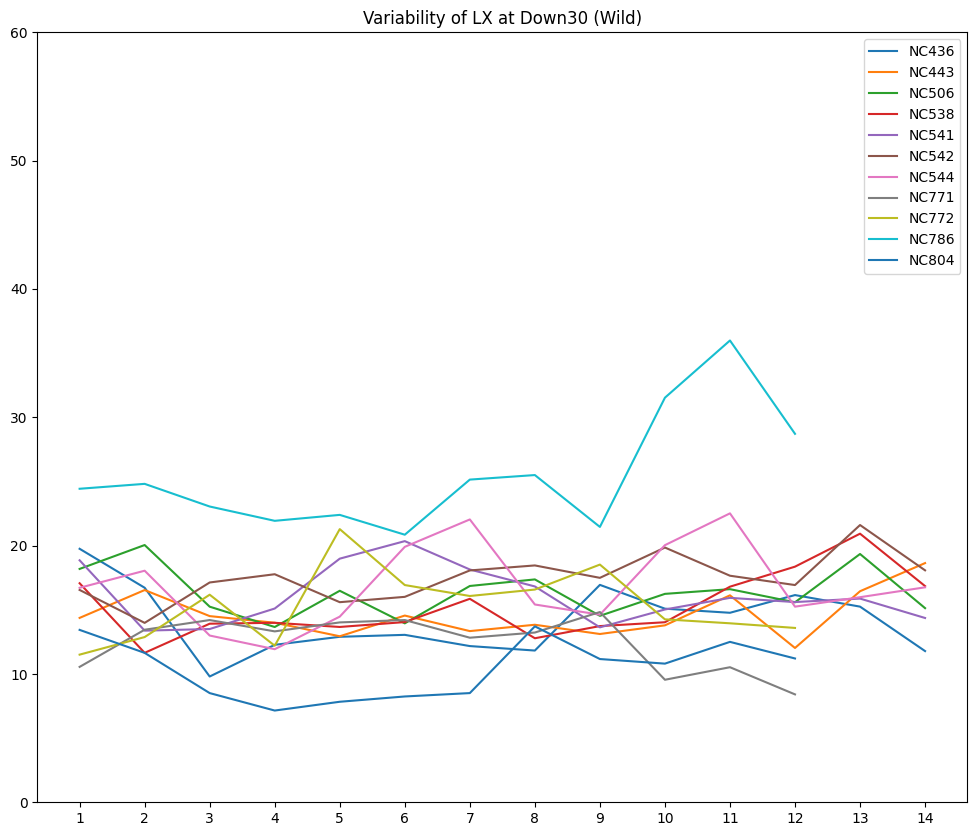

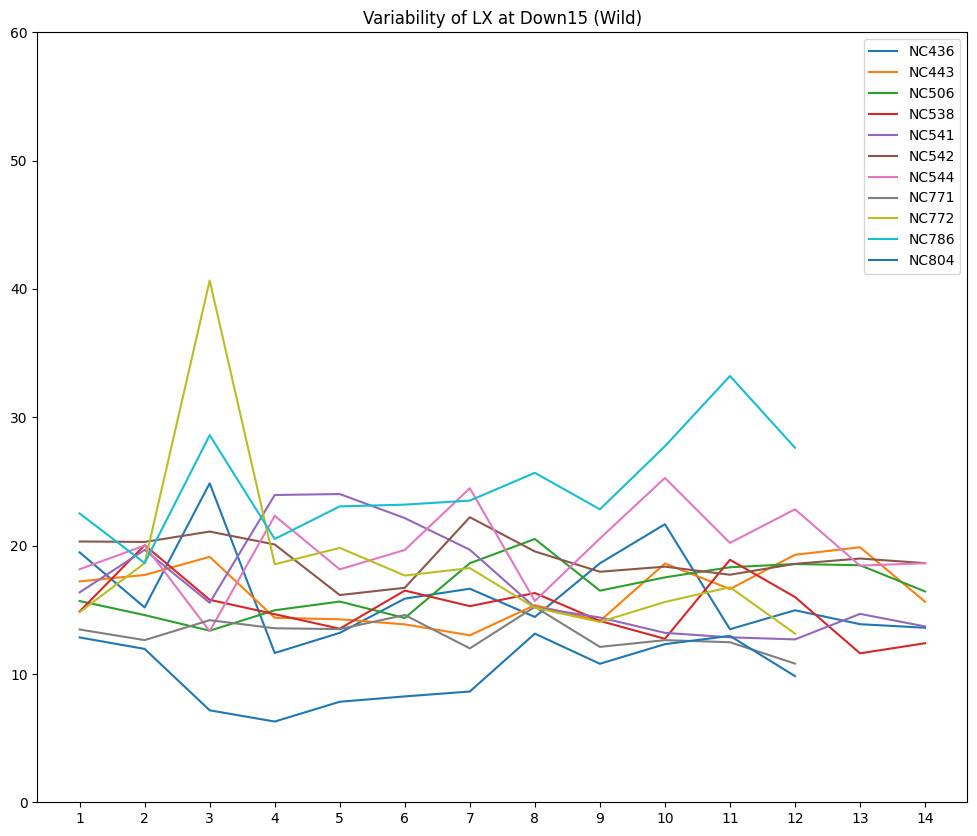

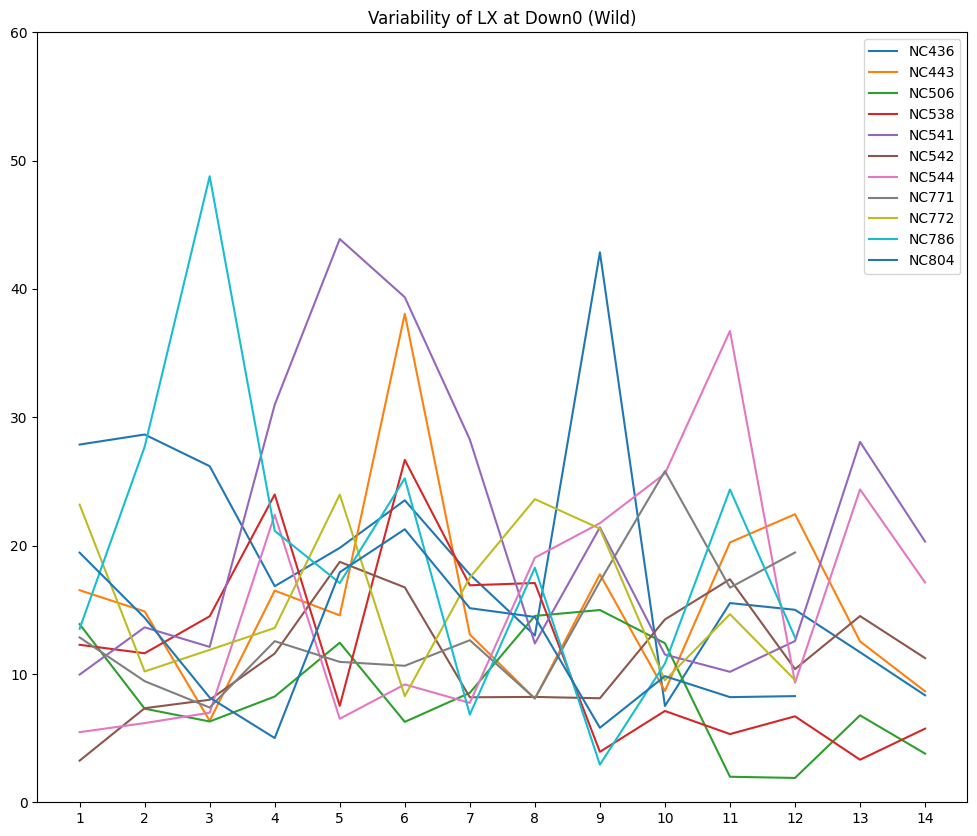

In [ ]:
# 4: down_LX_std_list

for i in range(len(down_speed_list)):
  df = generate_df_list(wild, 4, down_speed_list[i])
  plotline(df, wild_labels, days, 'Variability', 'LX', down_title_list[i], 'Wild')

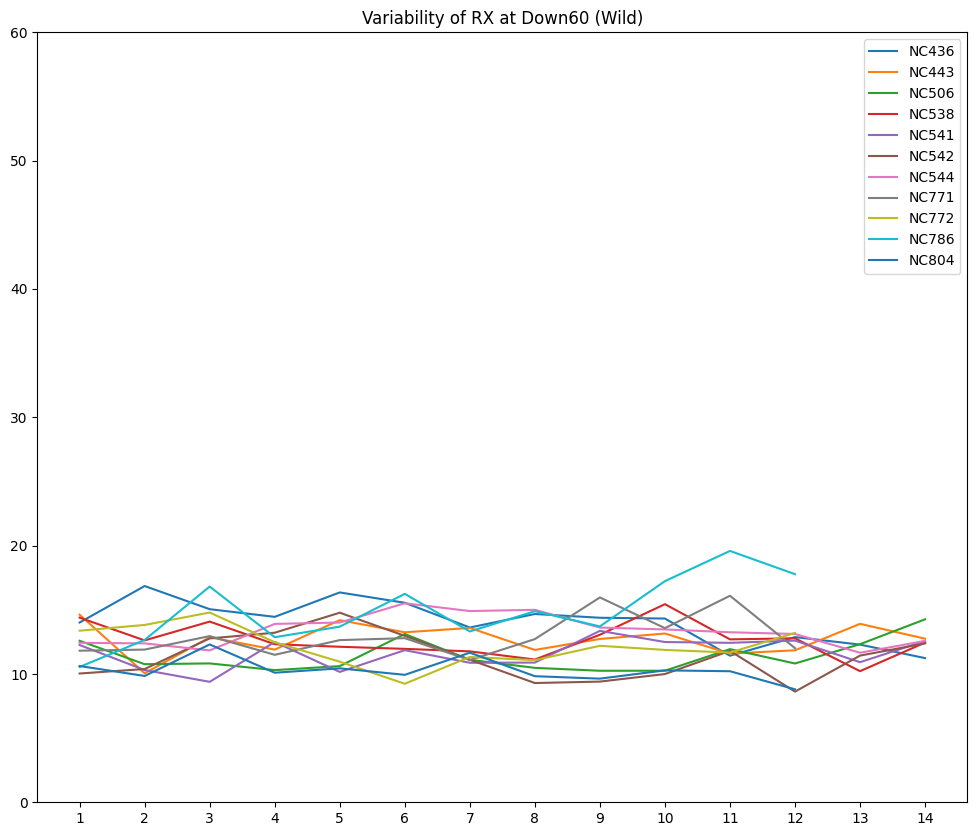

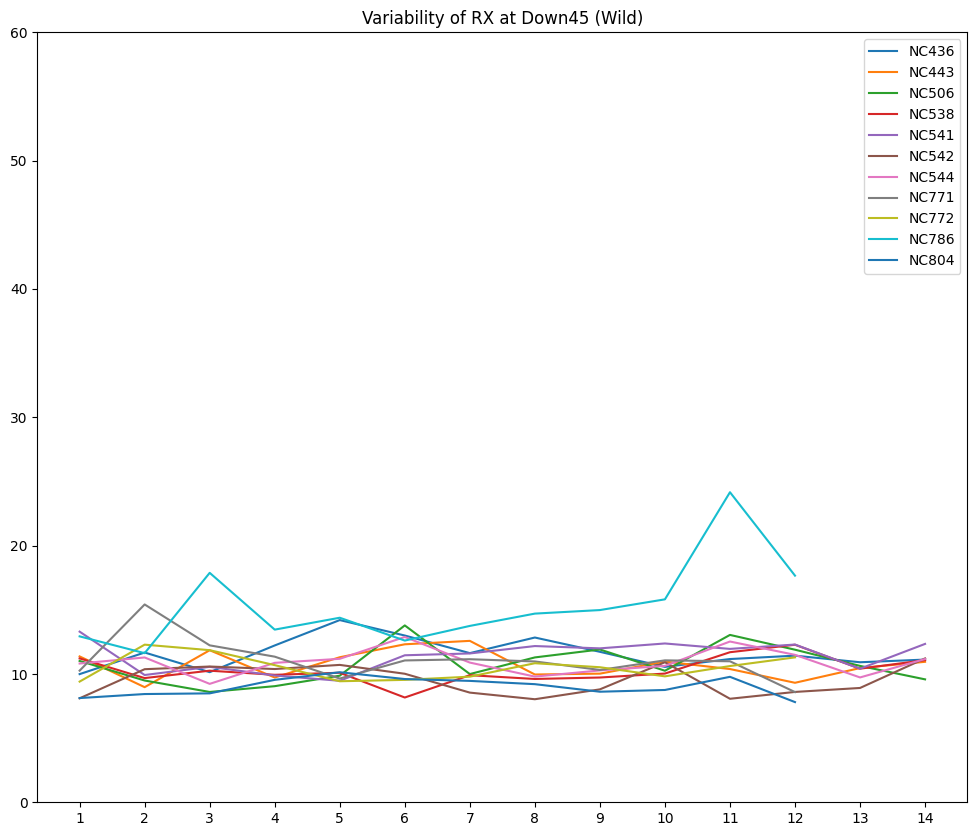

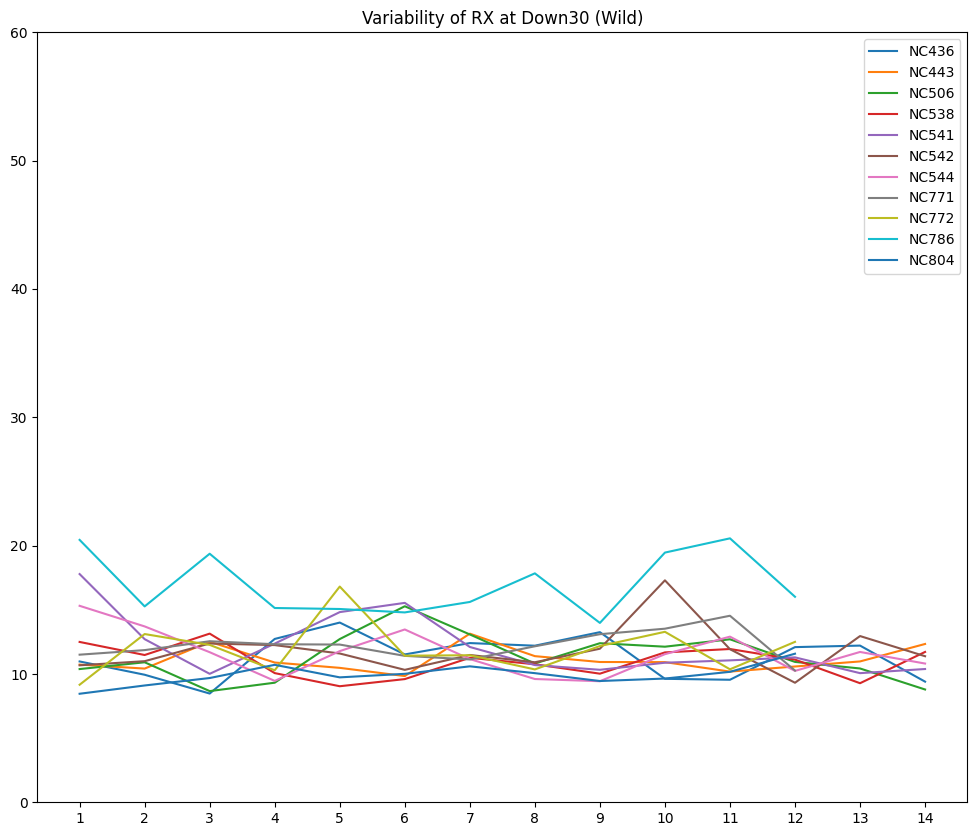

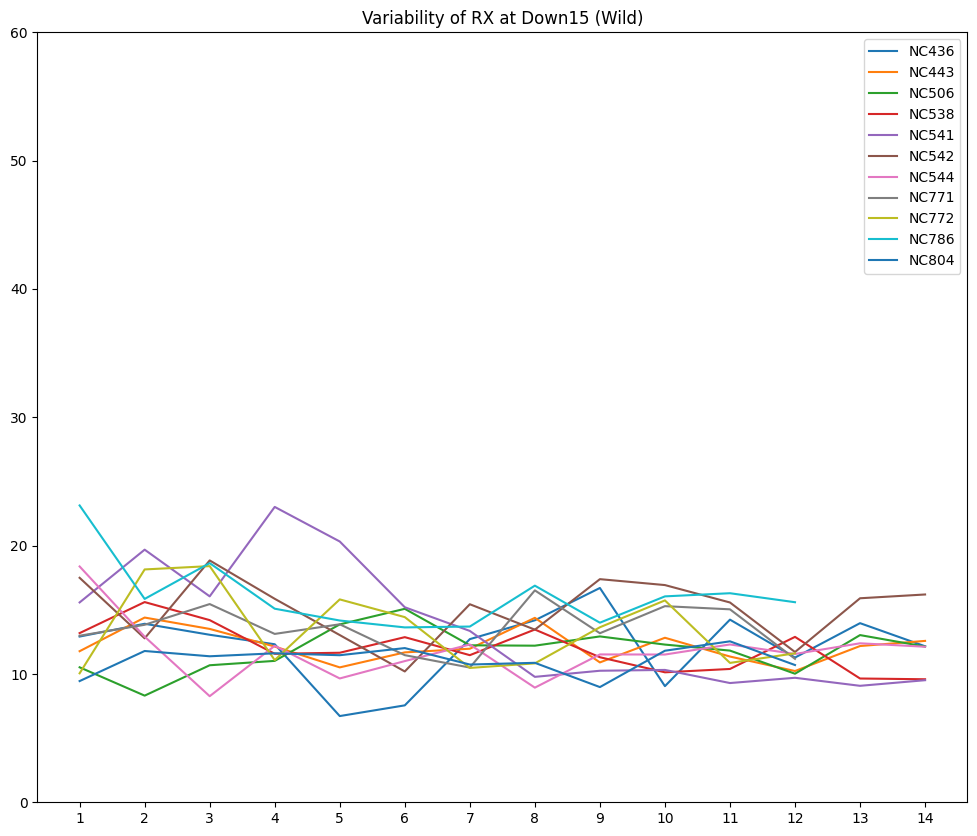

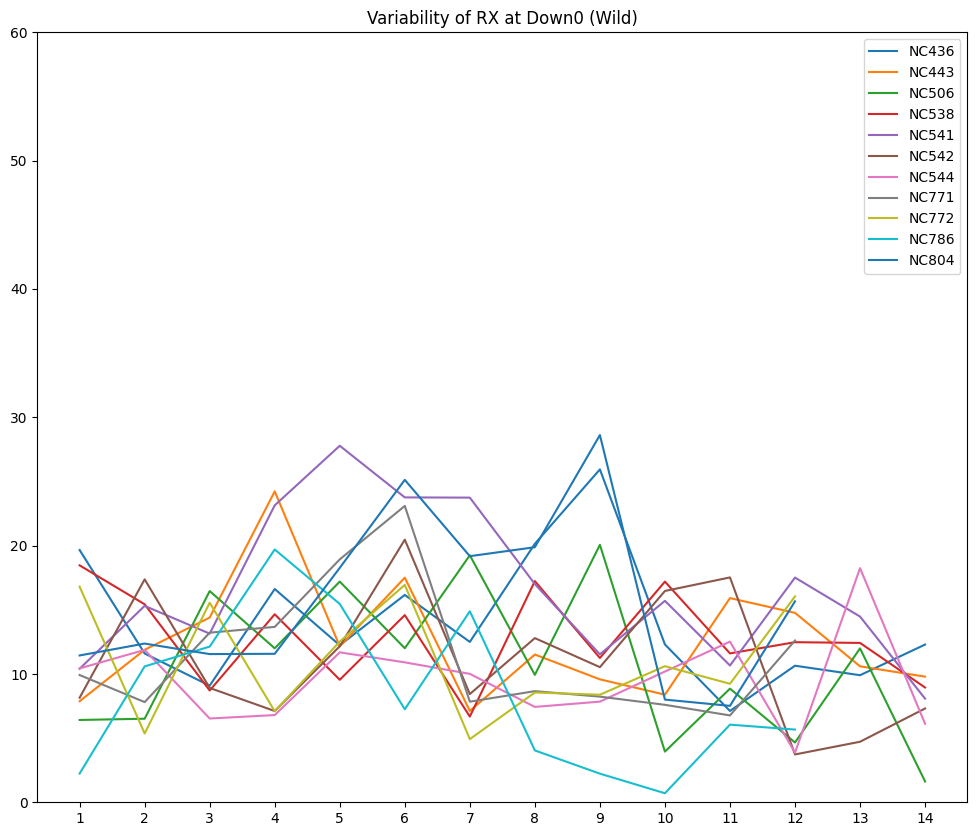

In [ ]:
# 5: down_RX_std_list

for i in range(len(down_speed_list)):
  df = generate_df_list(wild, 5, down_speed_list[i])
  plotline(df, wild_labels, days, 'Variability', 'RX', down_title_list[i], 'Wild')

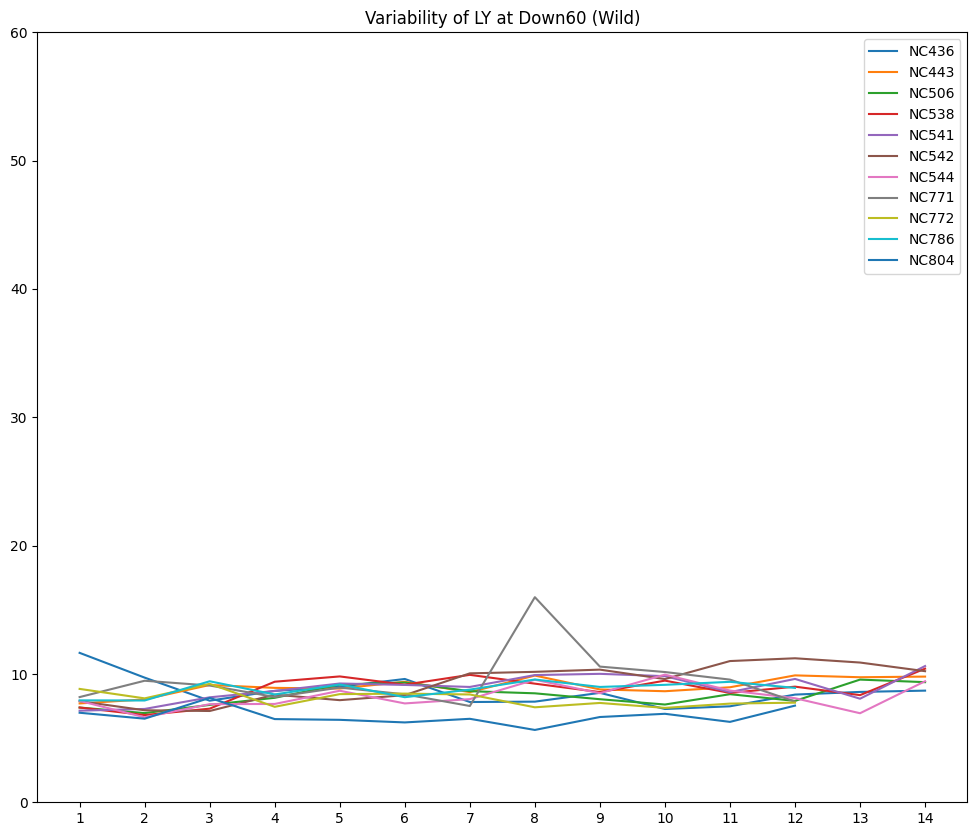

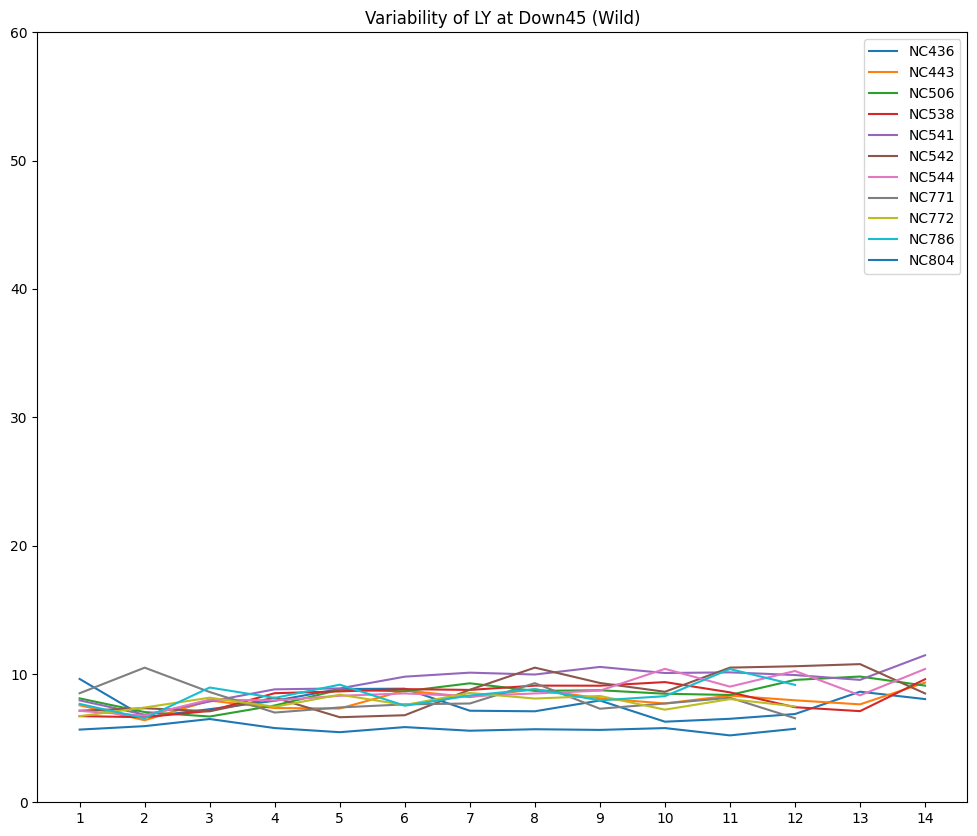

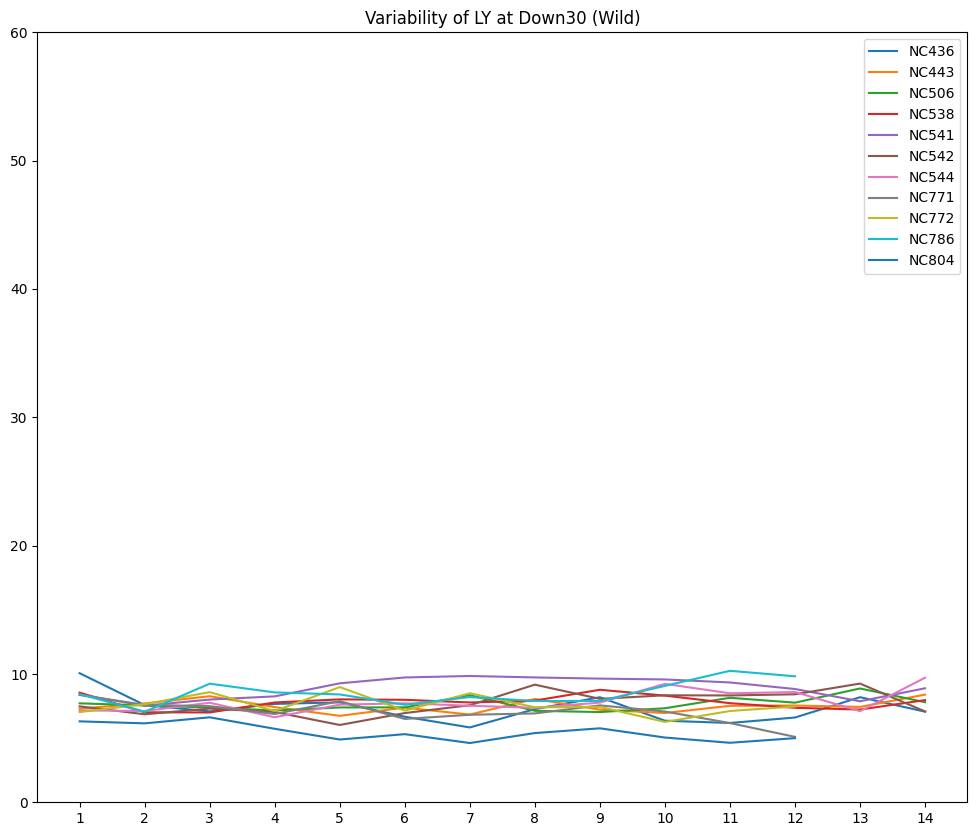

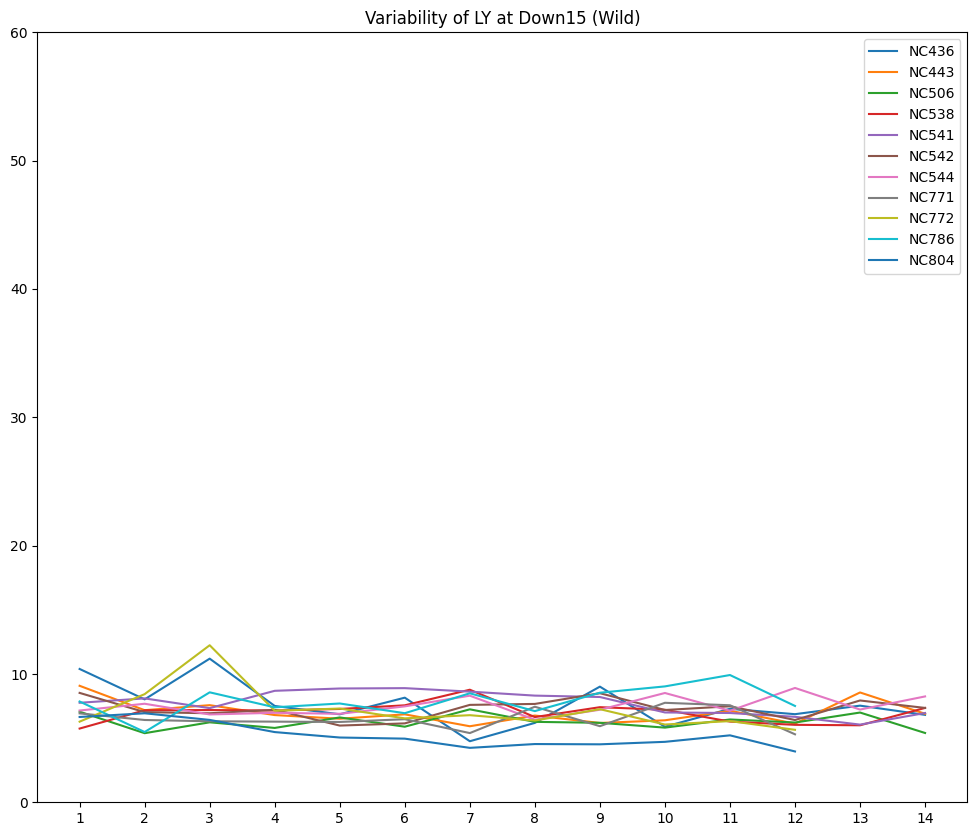

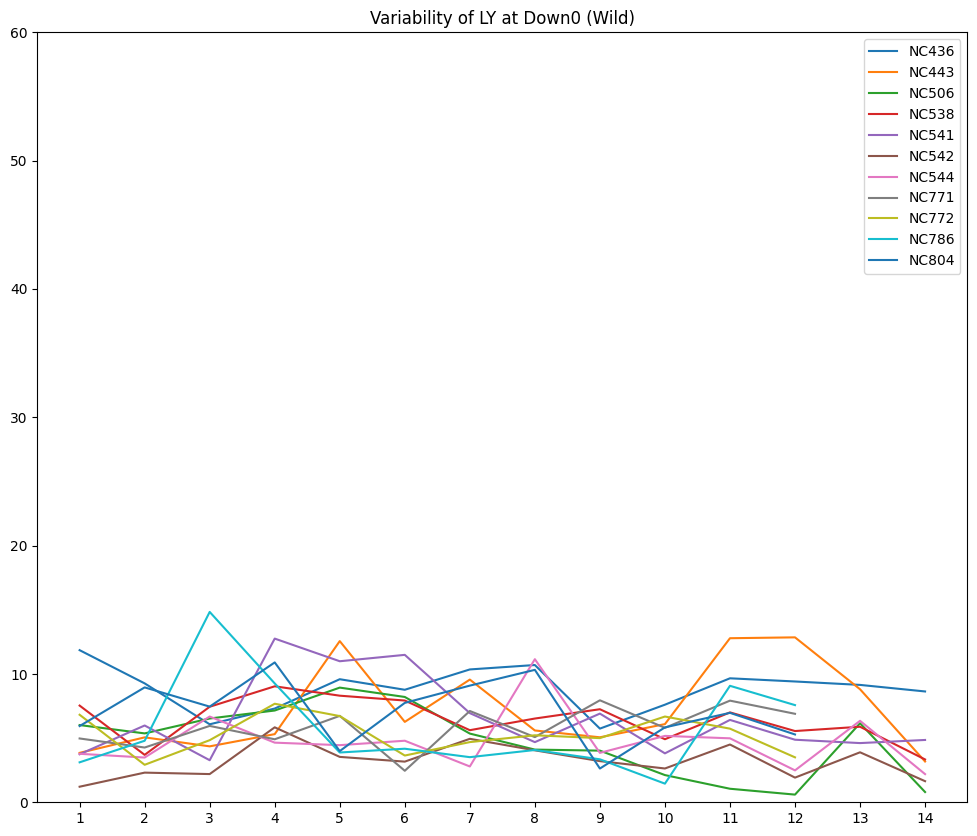

In [ ]:
# 6: down_LY_std_list 

for i in range(len(down_speed_list)):
  df = generate_df_list(wild, 6, down_speed_list[i])
  plotline(df, wild_labels, days, 'Variability', 'LY', down_title_list[i], 'Wild')

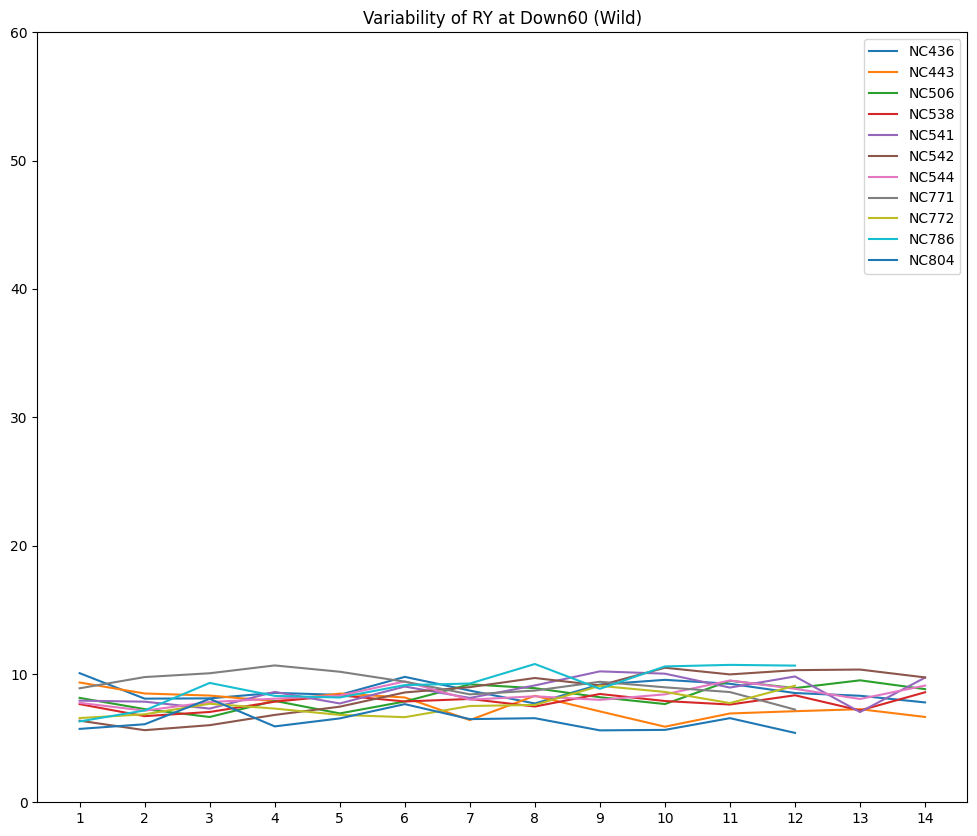

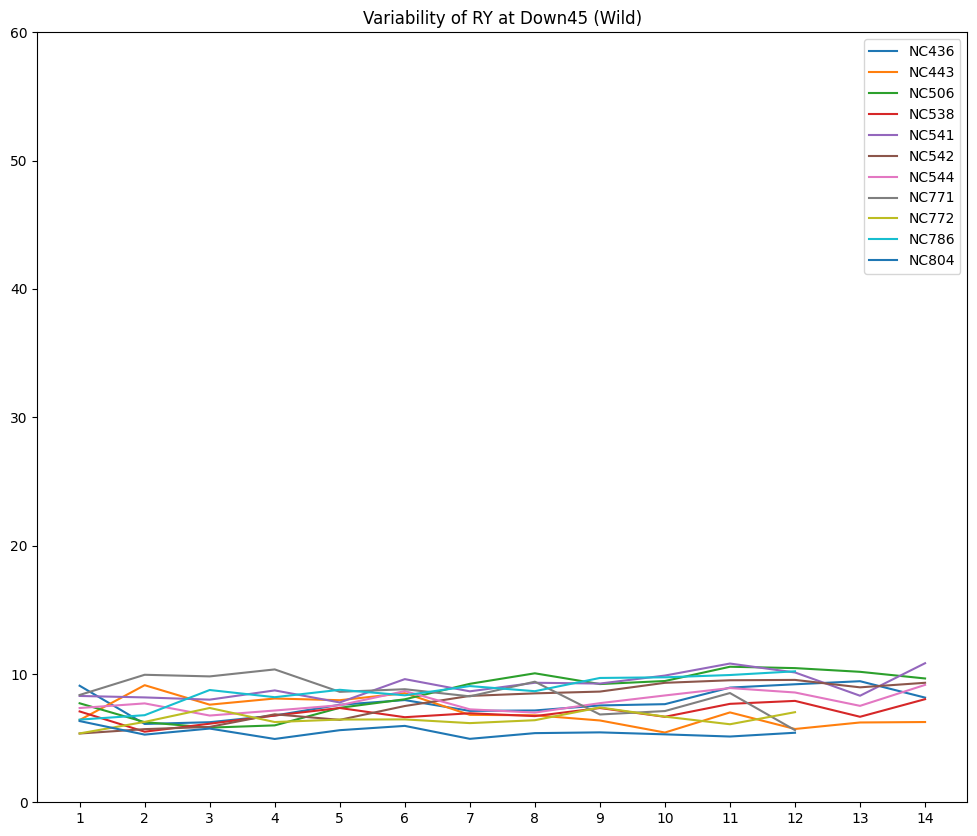

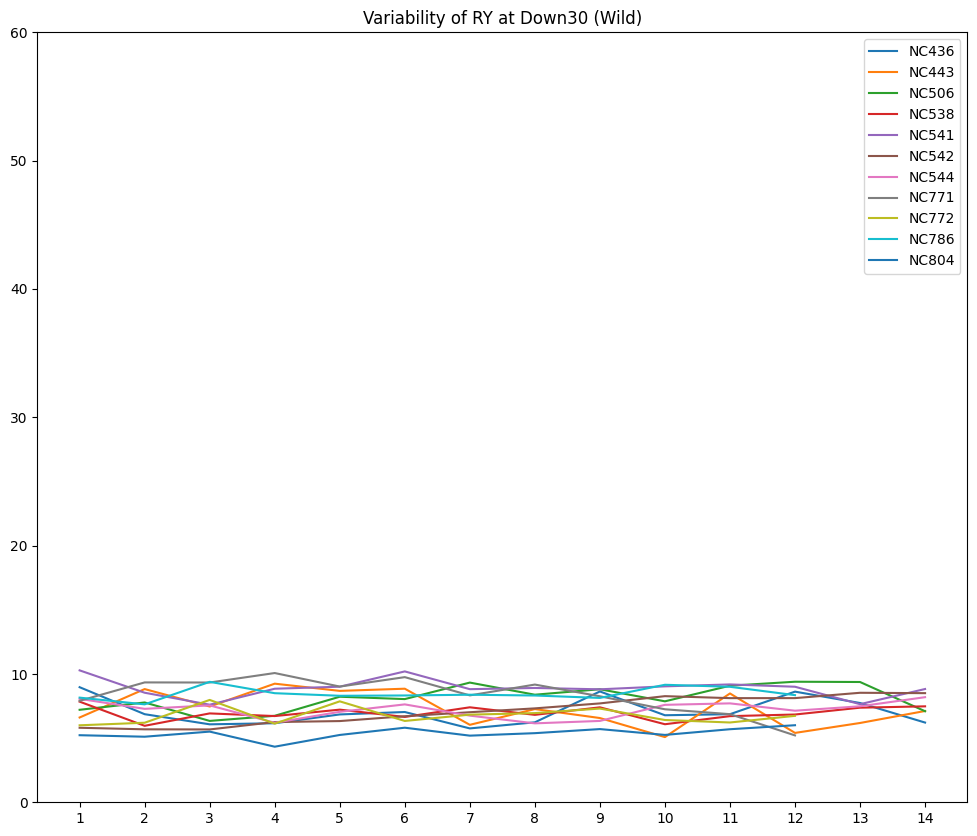

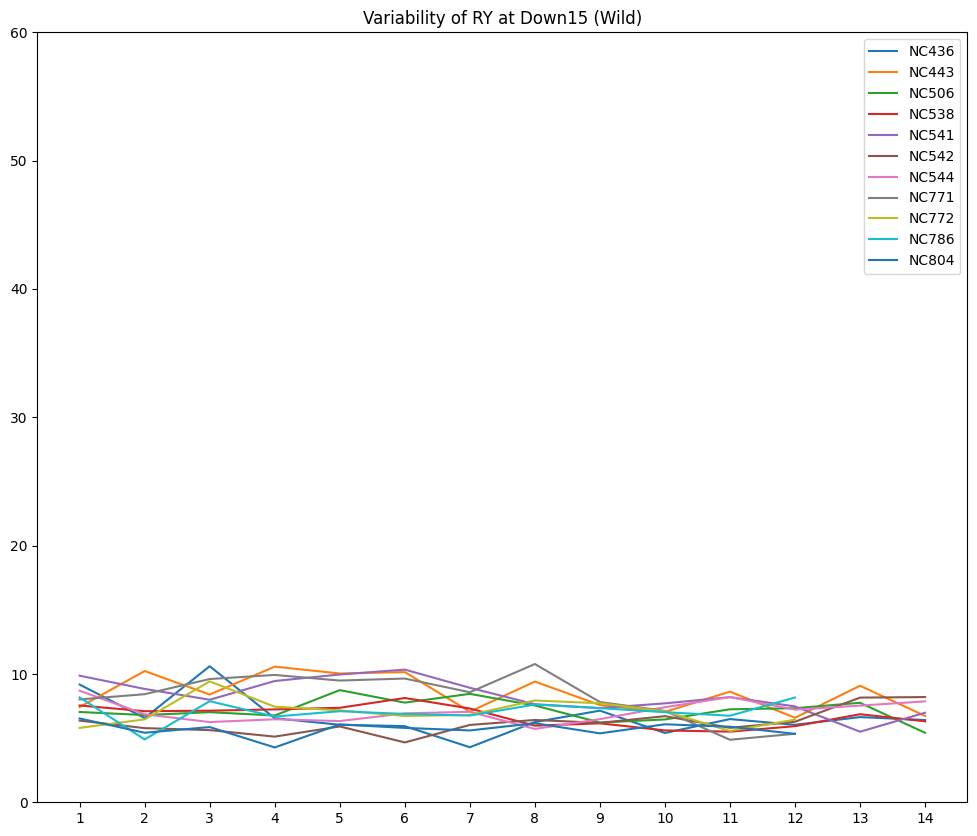

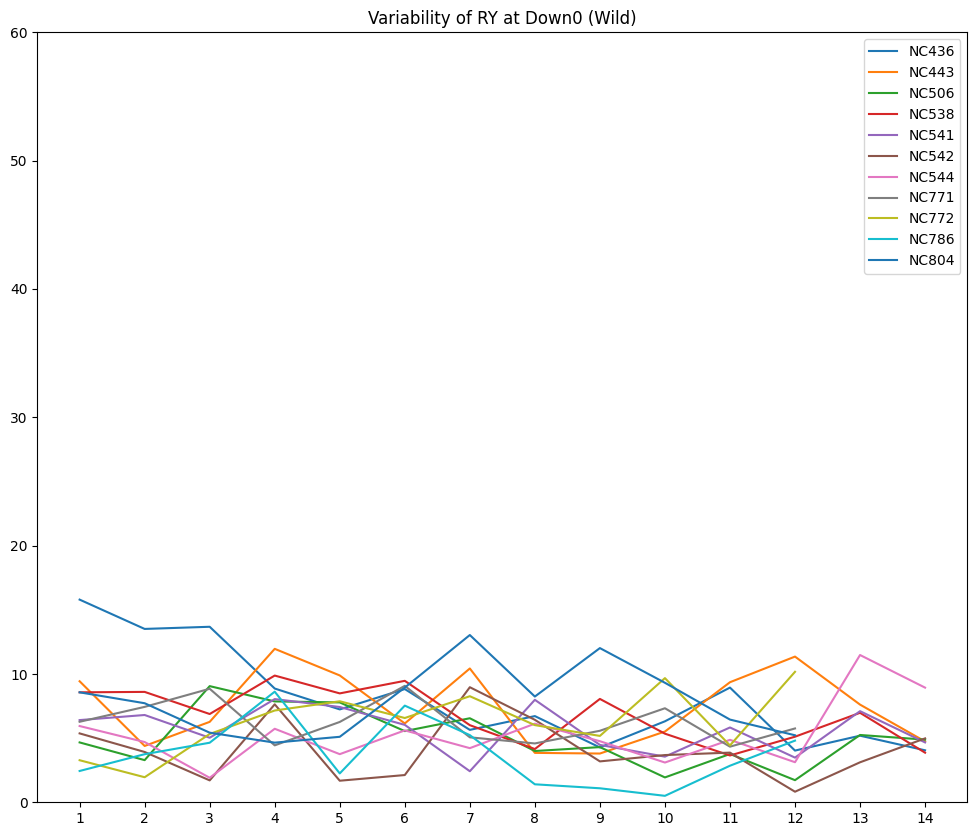

In [ ]:
# 7: down_RY_std_list 

for i in range(len(down_speed_list)):
  df = generate_df_list(wild, 7, down_speed_list[i])
  plotline(df, wild_labels, days, 'Variability', 'RY', down_title_list[i], 'Wild')

## Rett Std

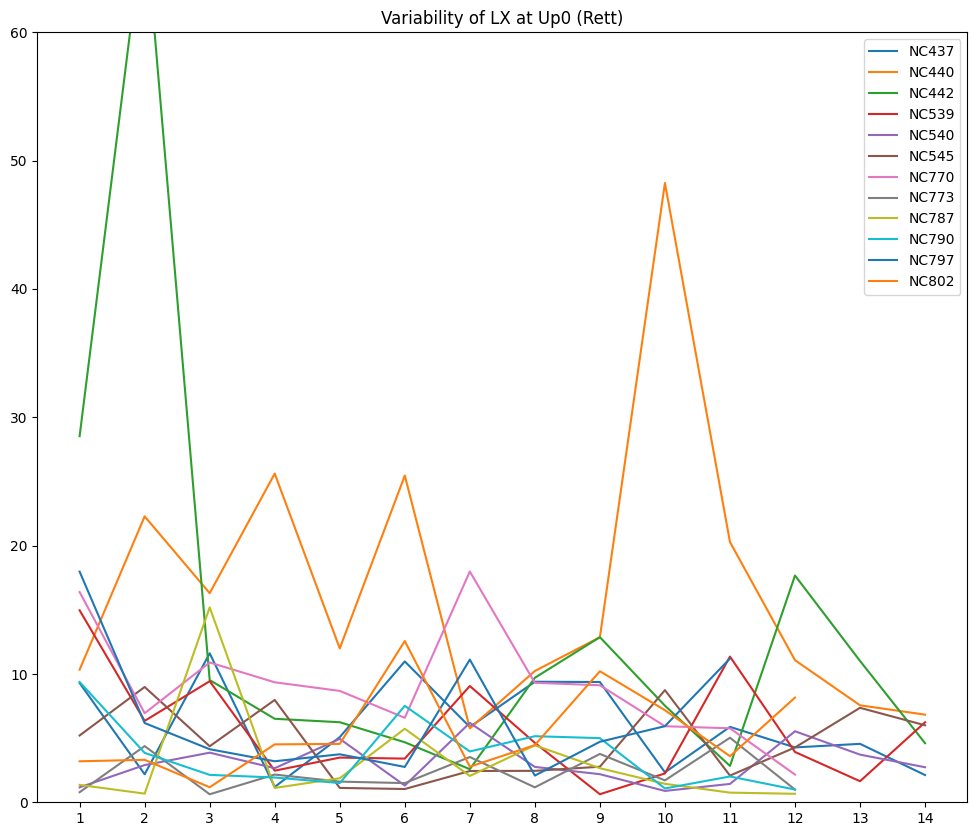

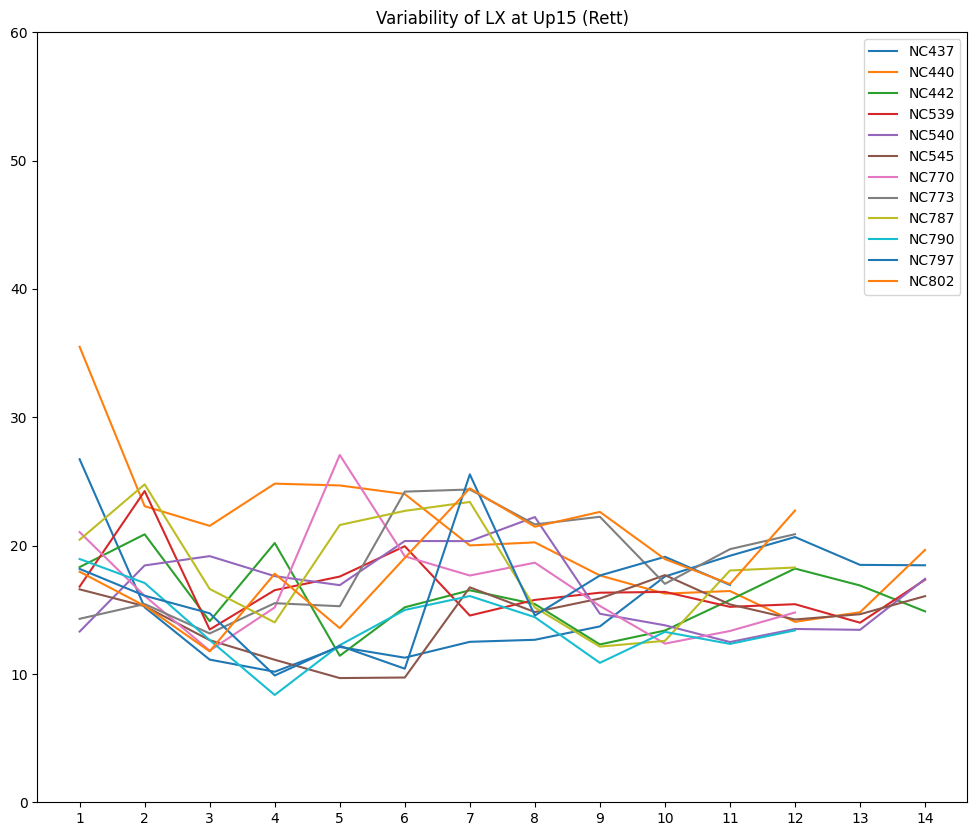

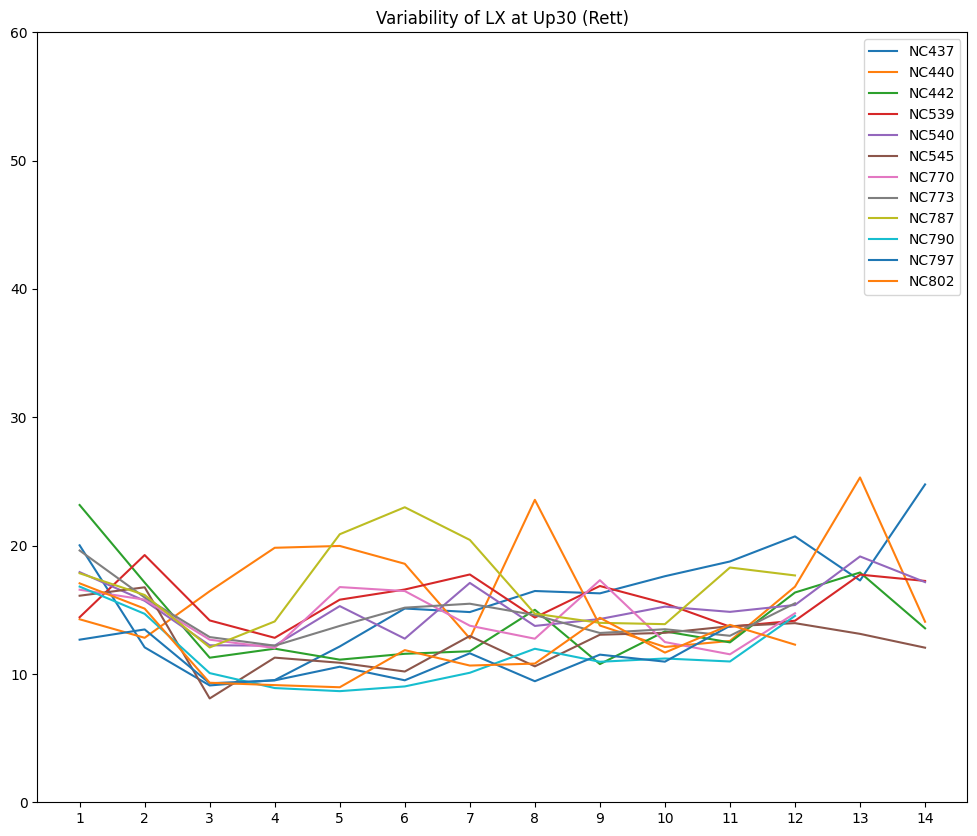

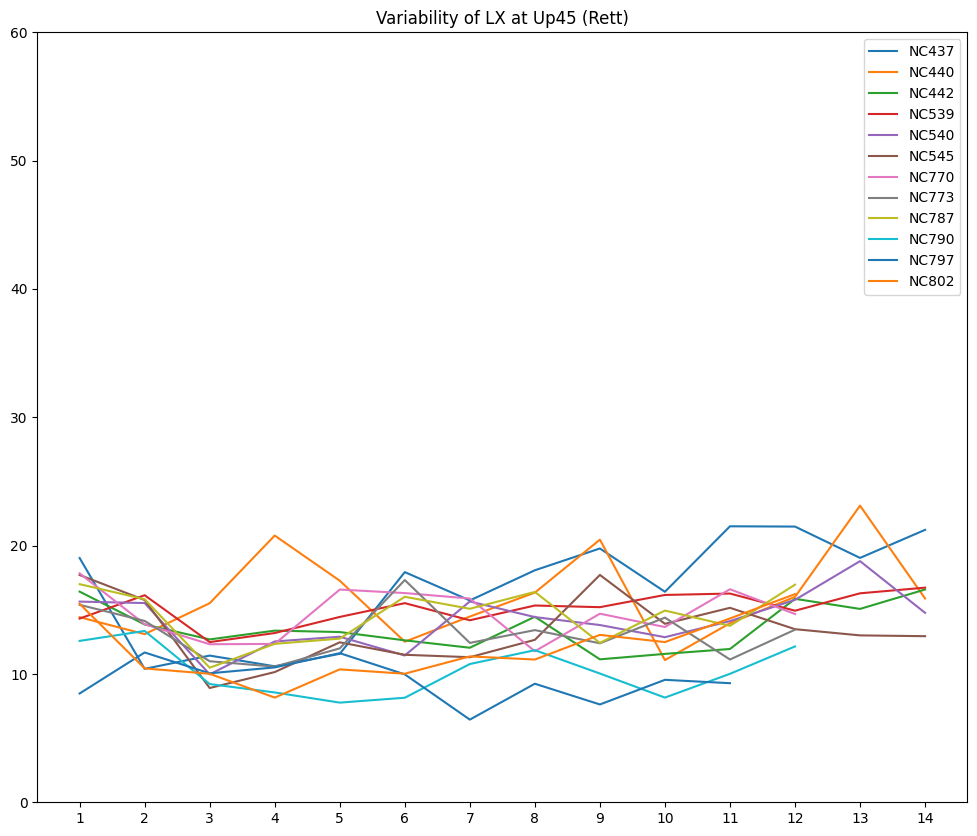

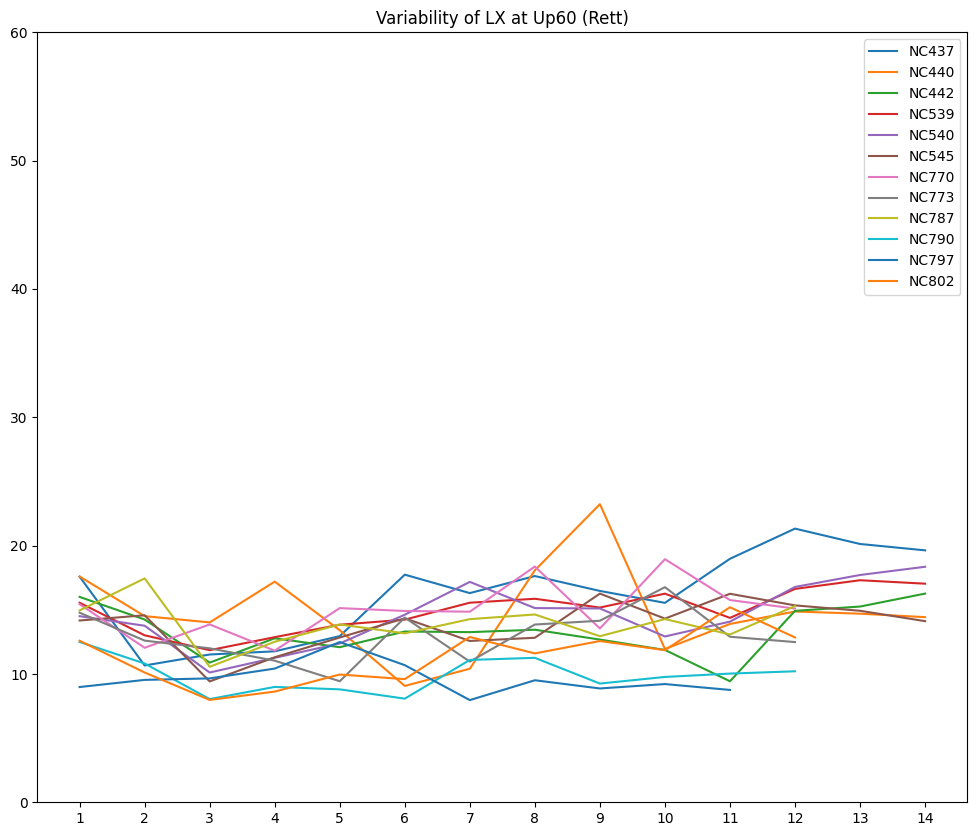

In [ ]:
# 0: up_LX_std_list

for i in range(len(up_speed_list)):
  df = generate_df_list(rett, 0, up_speed_list[i])
  plotline(df, rett_labels, days, 'Variability', 'LX', up_title_list[i], 'Rett')

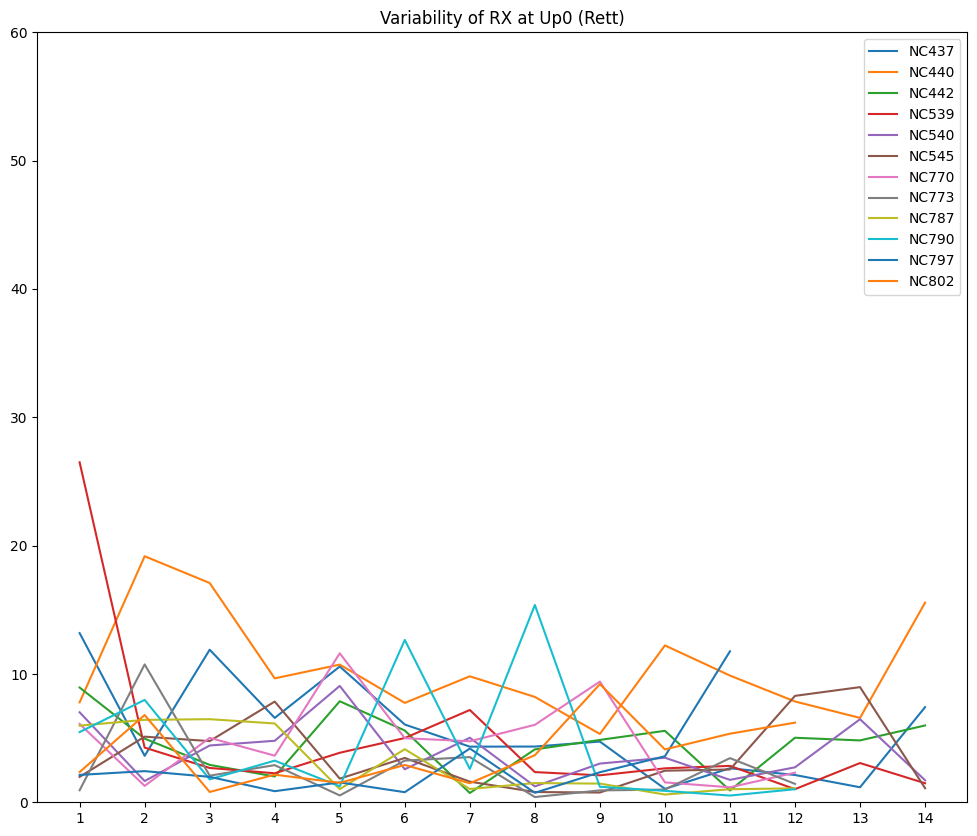

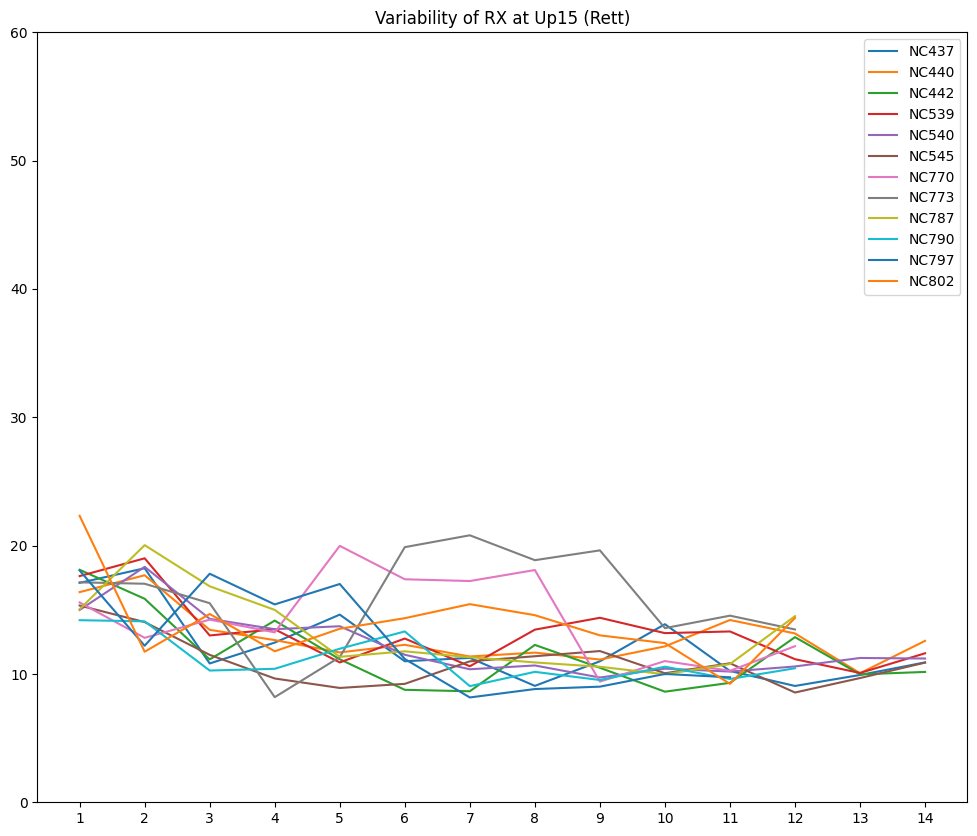

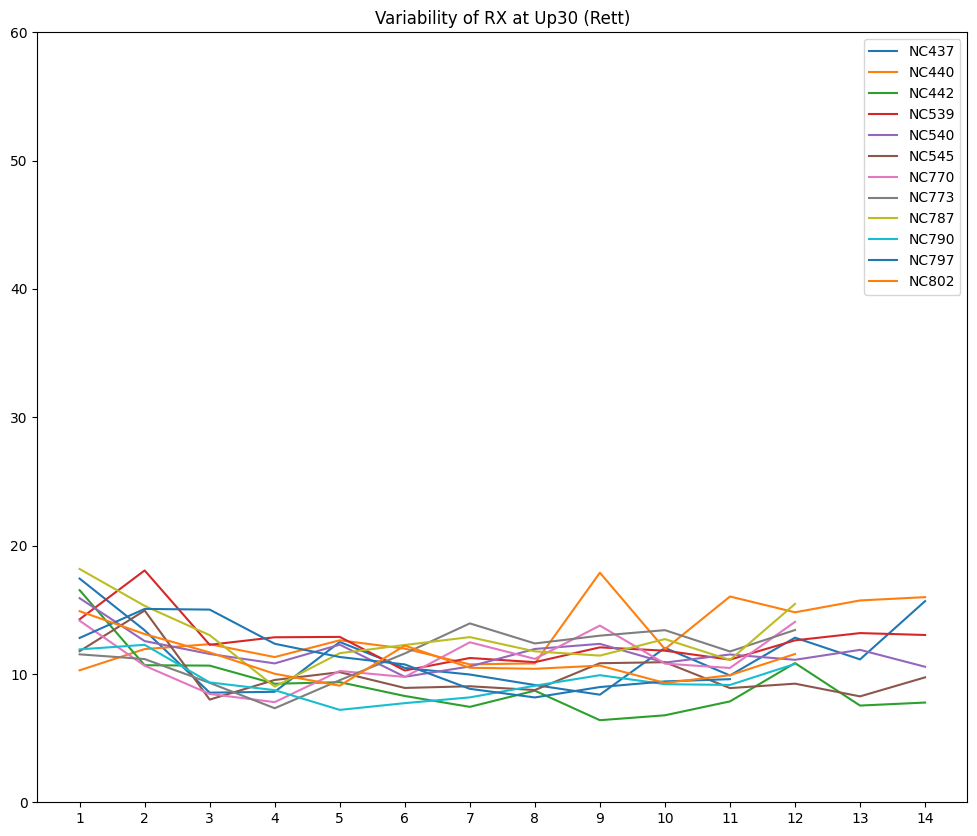

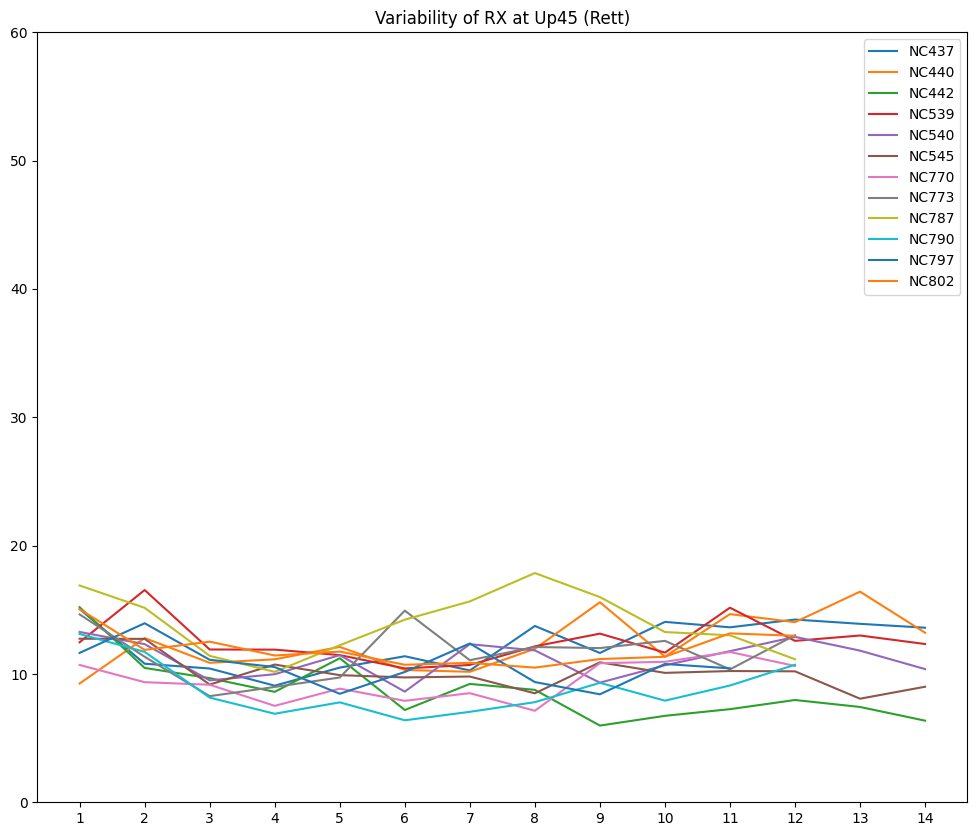

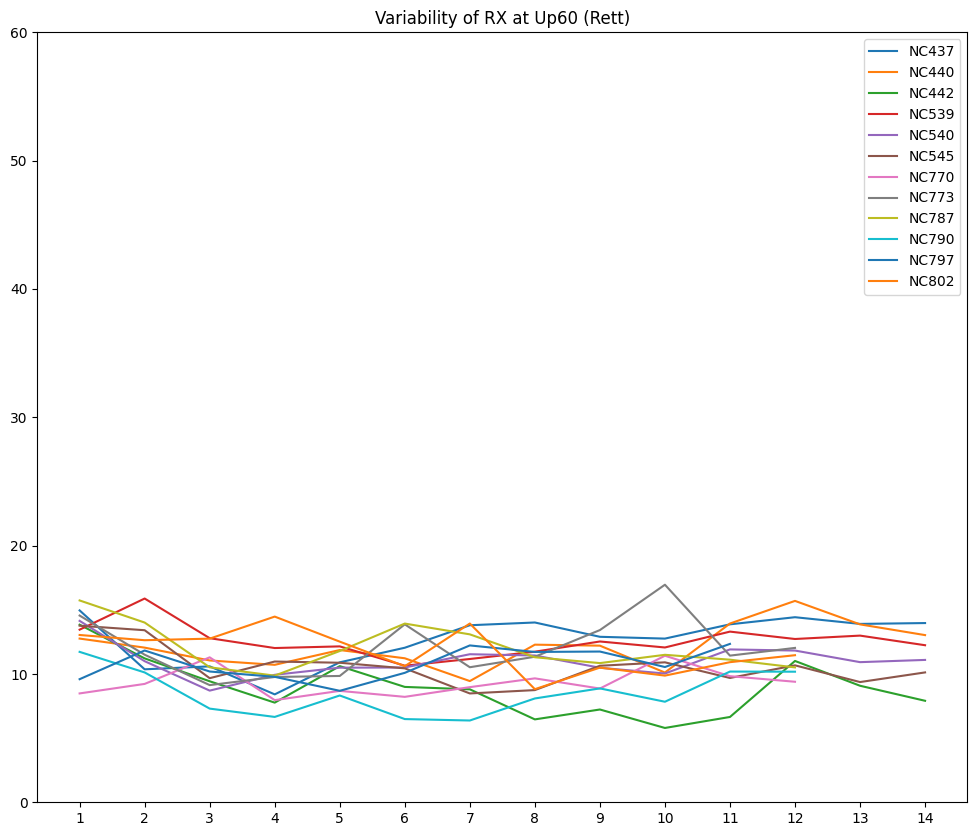

In [ ]:
# 1: up_RX_std_list

for i in range(len(up_speed_list)):
  df = generate_df_list(rett, 1, up_speed_list[i])
  plotline(df, rett_labels, days, 'Variability', 'RX', up_title_list[i], 'Rett')

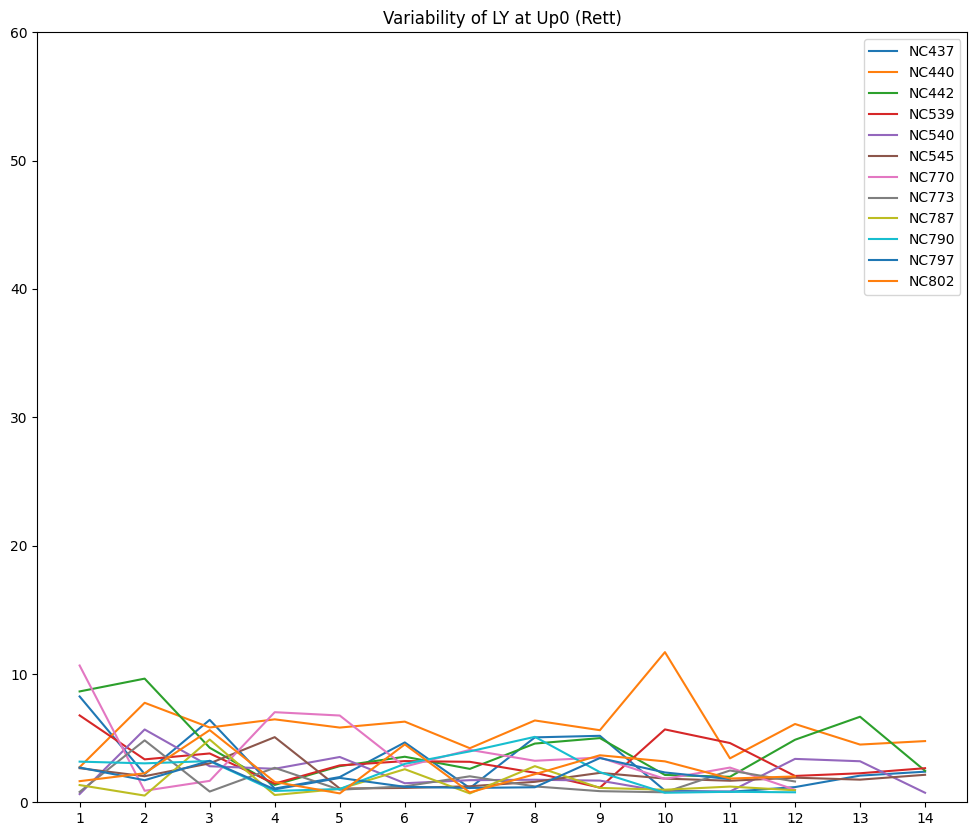

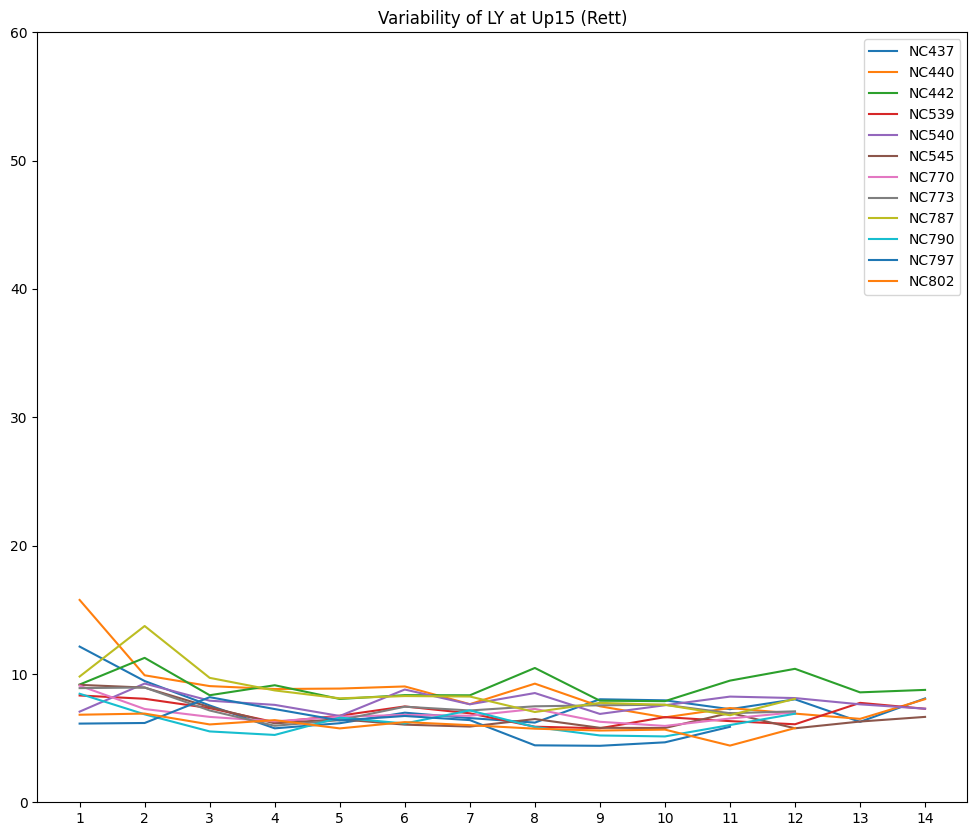

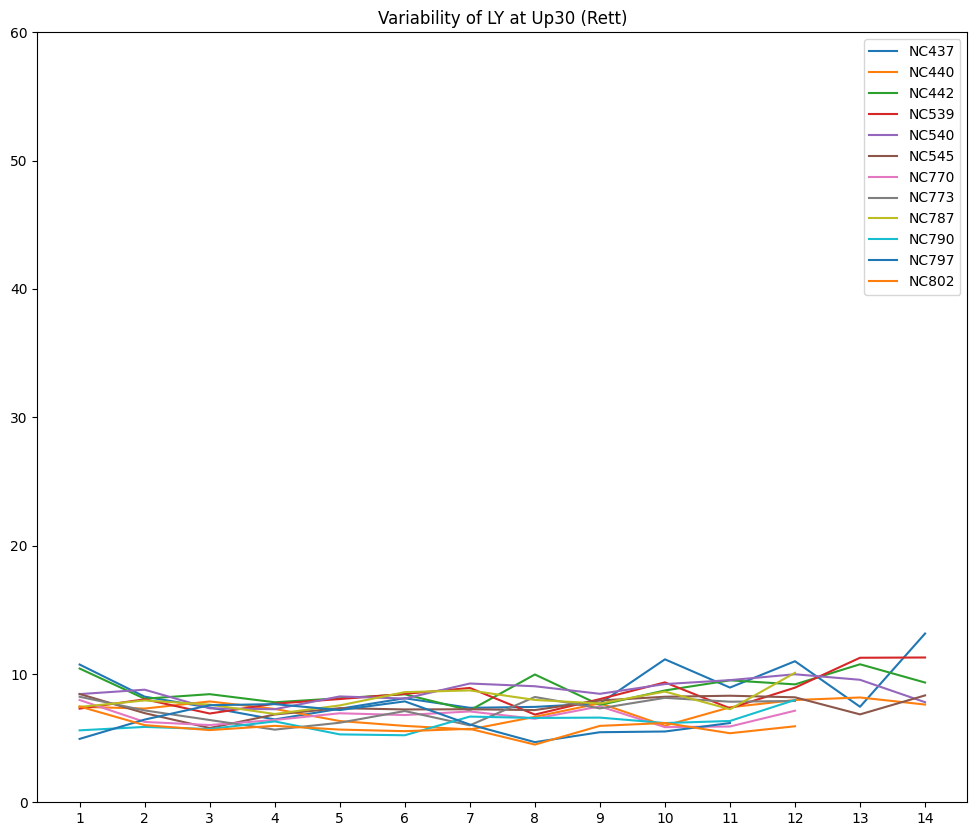

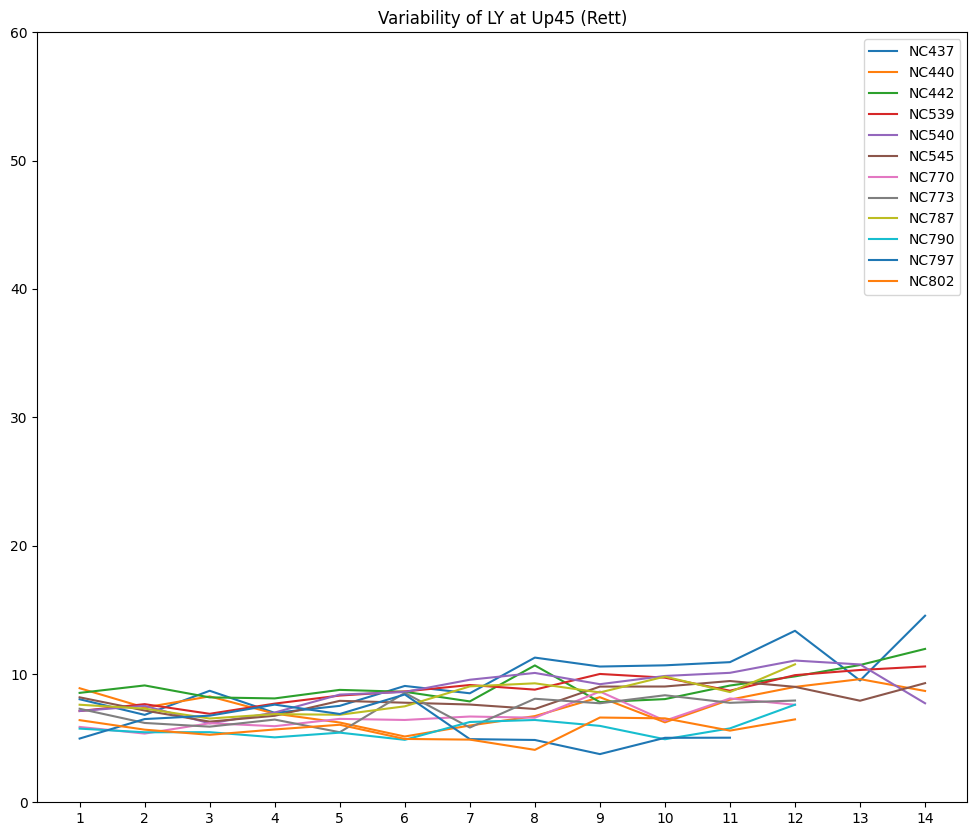

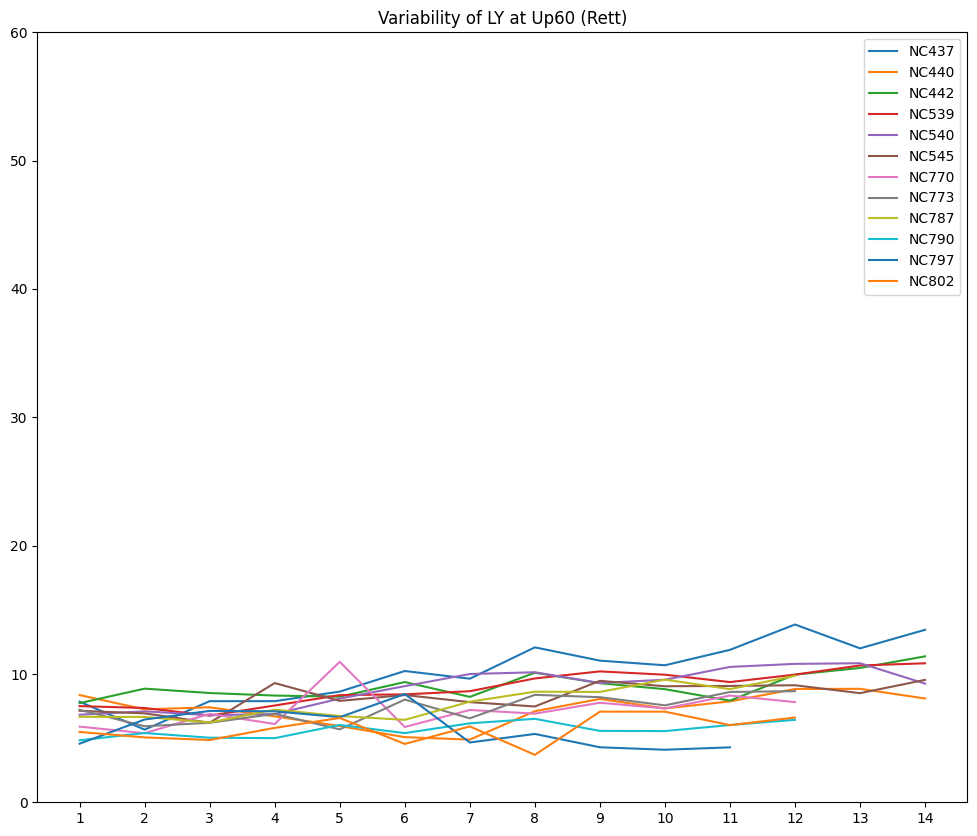

In [ ]:
# 2: up_LY_std_list

for i in range(len(up_speed_list)):
  df = generate_df_list(rett, 2, up_speed_list[i])
  plotline(df, rett_labels, days, 'Variability', 'LY', up_title_list[i], 'Rett')

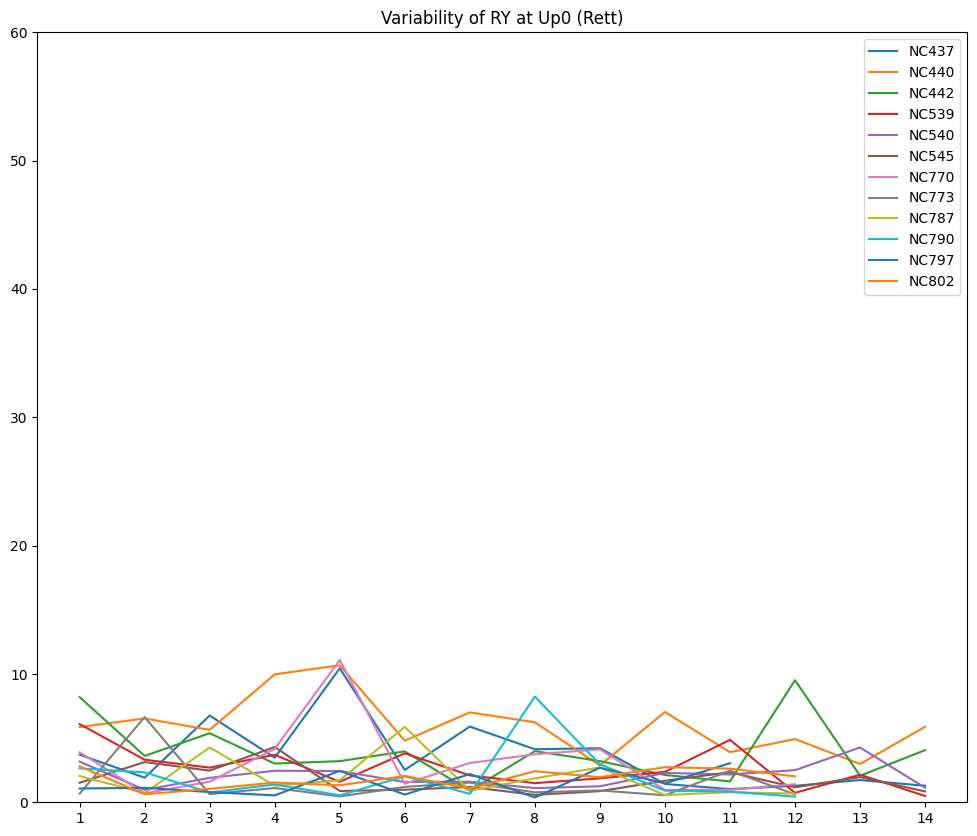

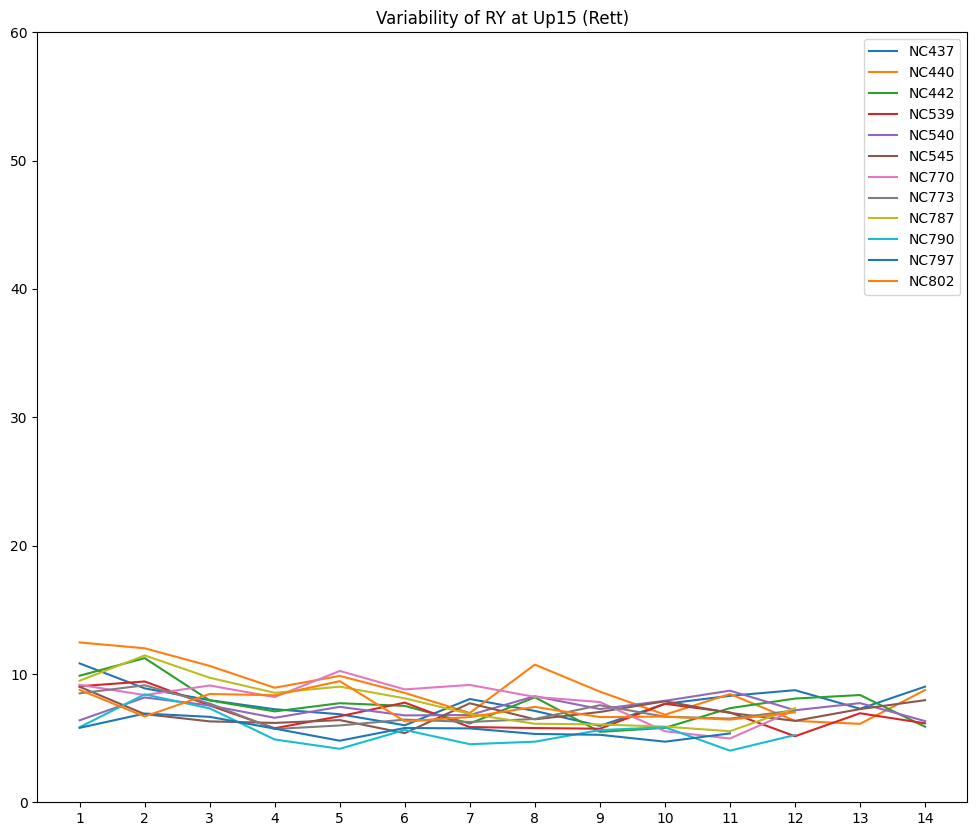

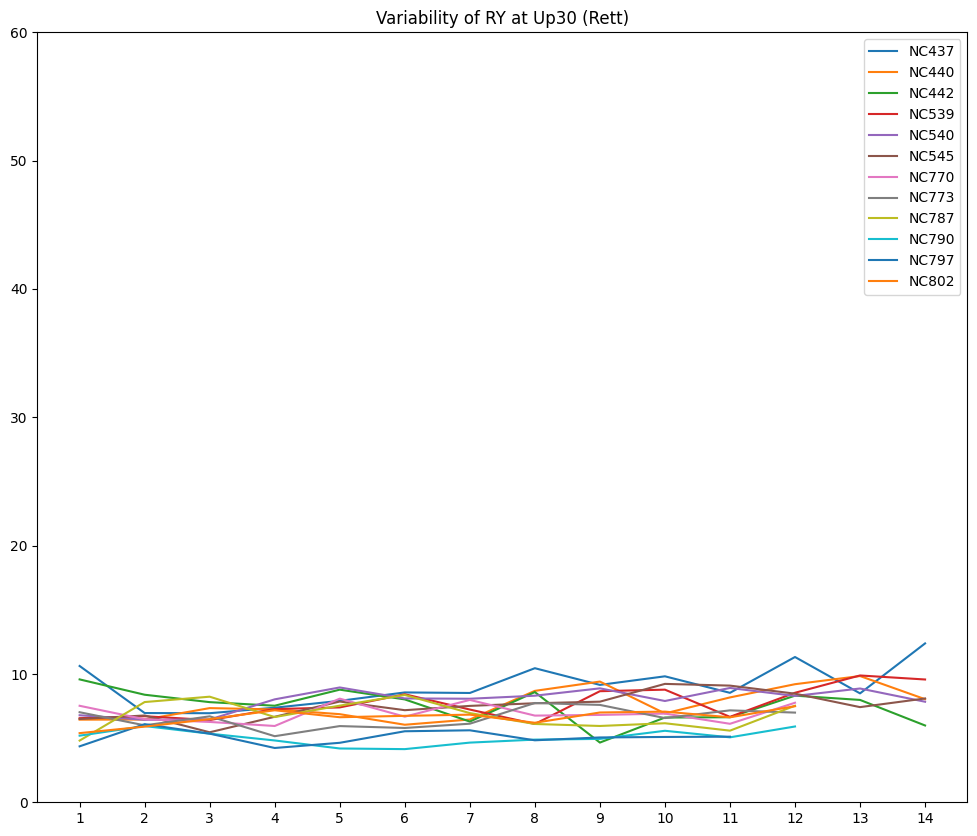

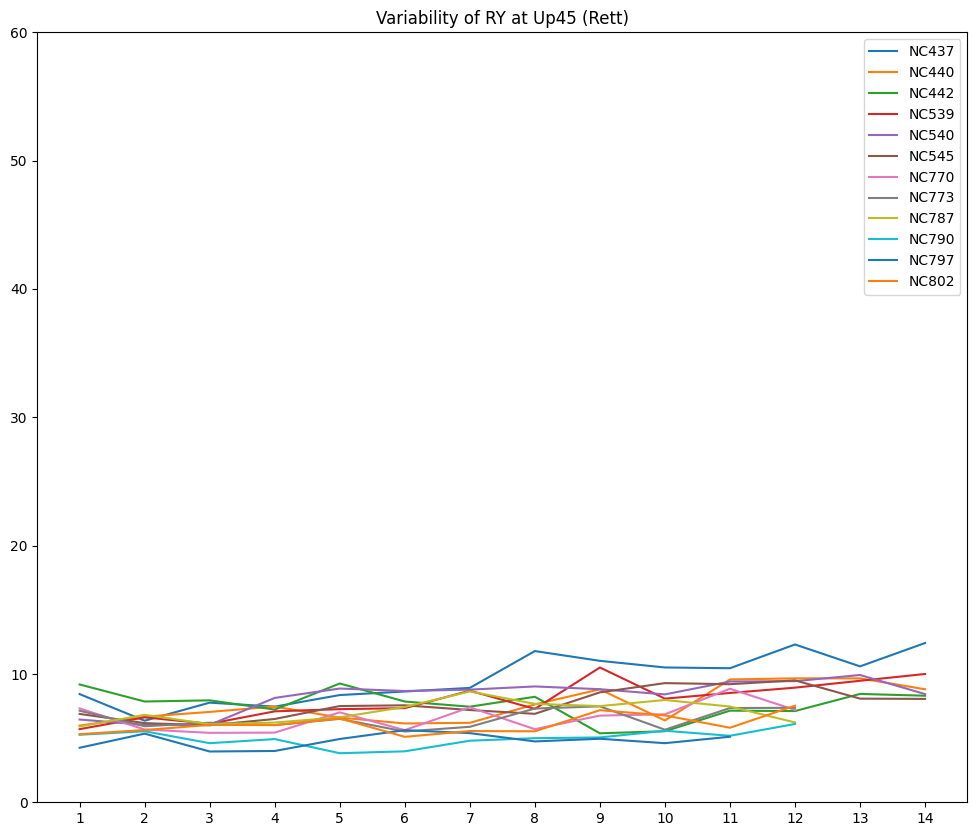

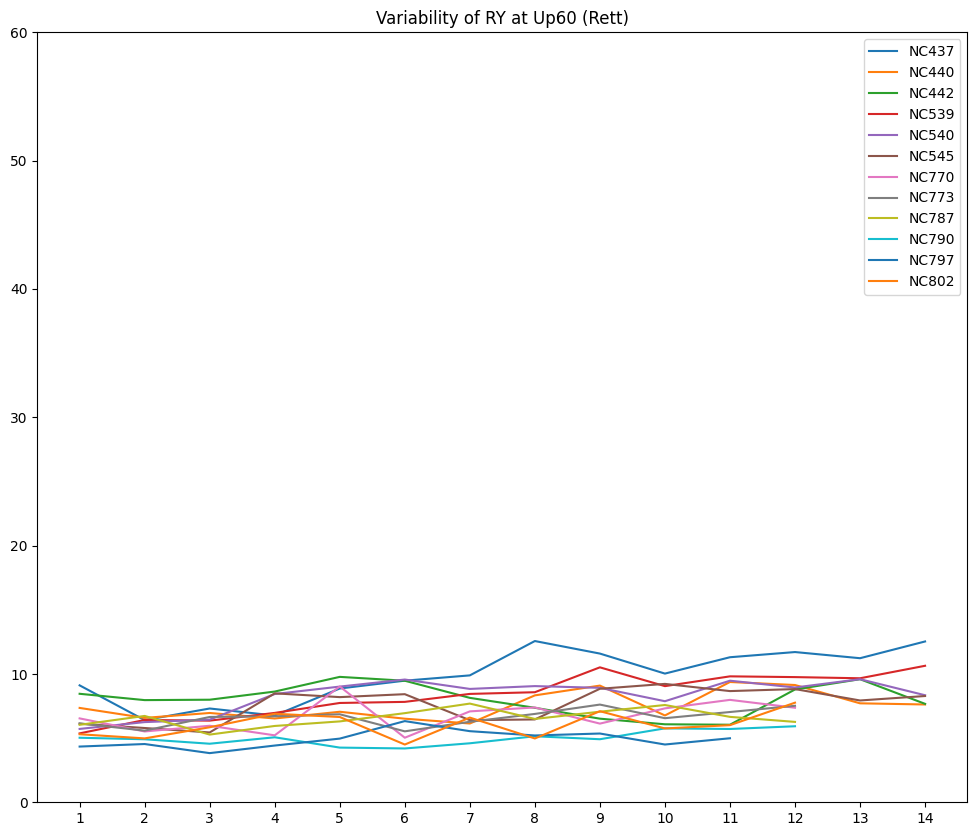

In [ ]:
# 3: up_RY_std_list

for i in range(len(up_speed_list)):
  df = generate_df_list(rett, 3, up_speed_list[i])
  plotline(df, rett_labels, days, 'Variability', 'RY', up_title_list[i], 'Rett')

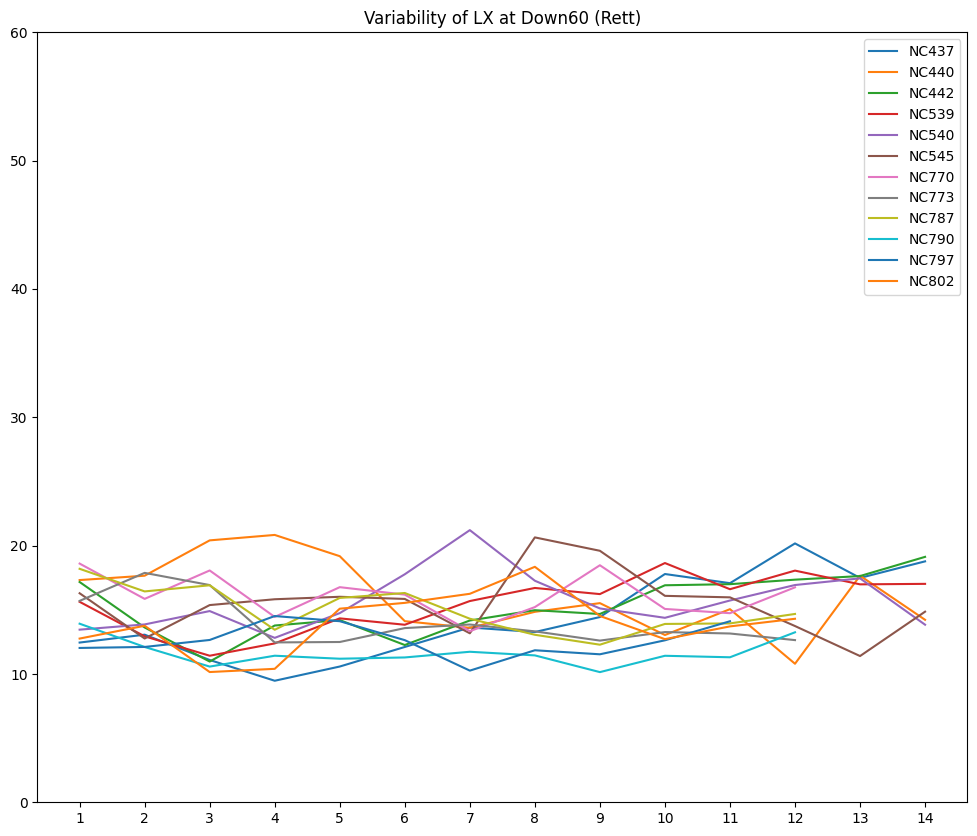

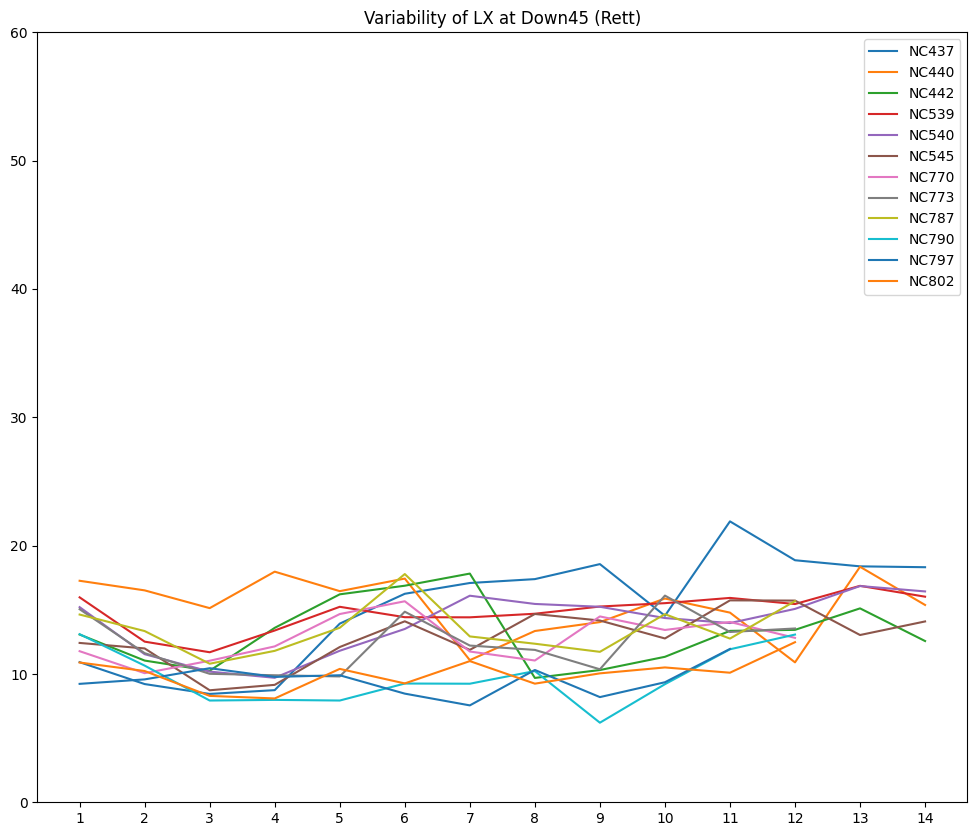

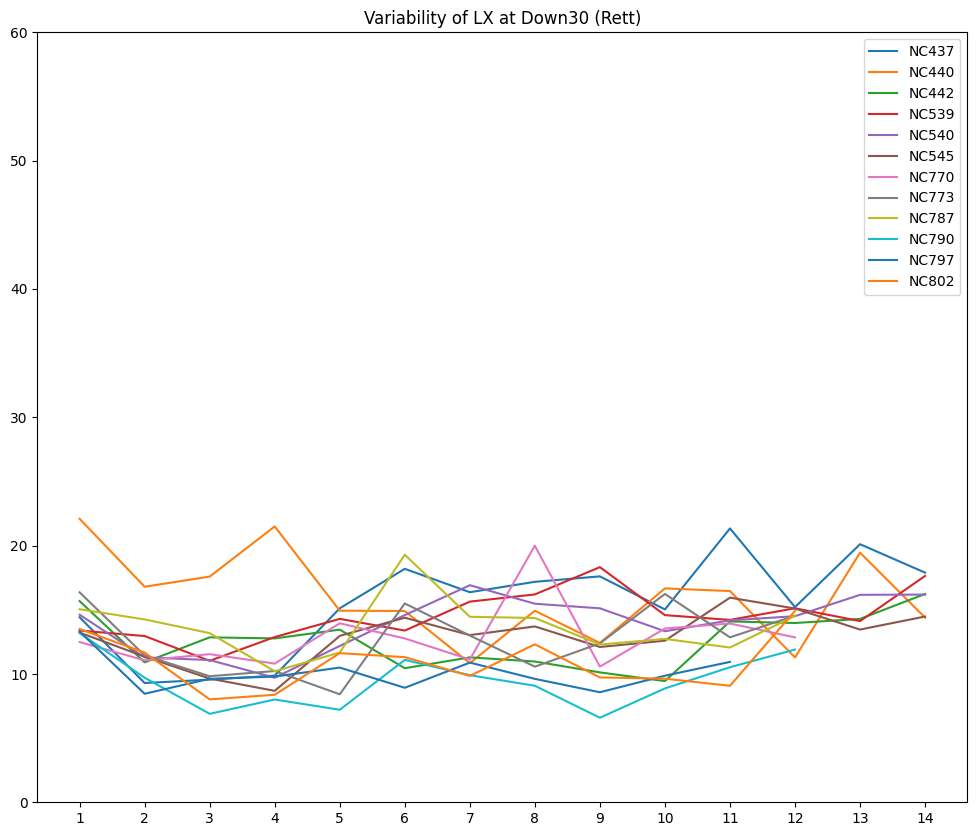

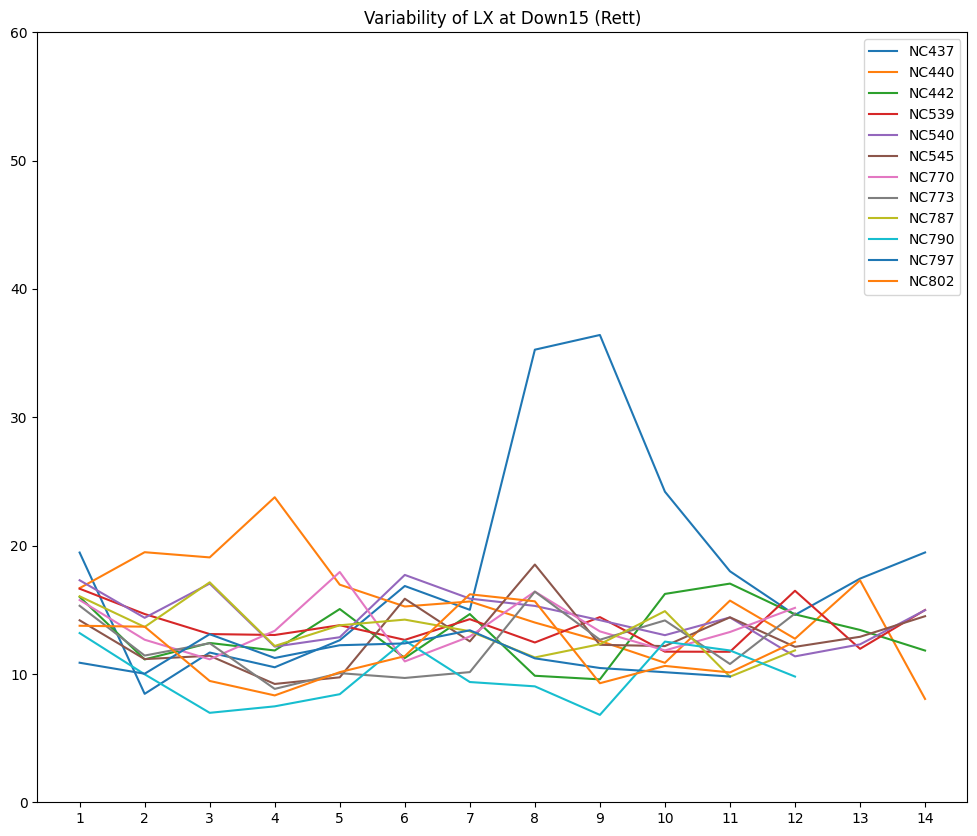

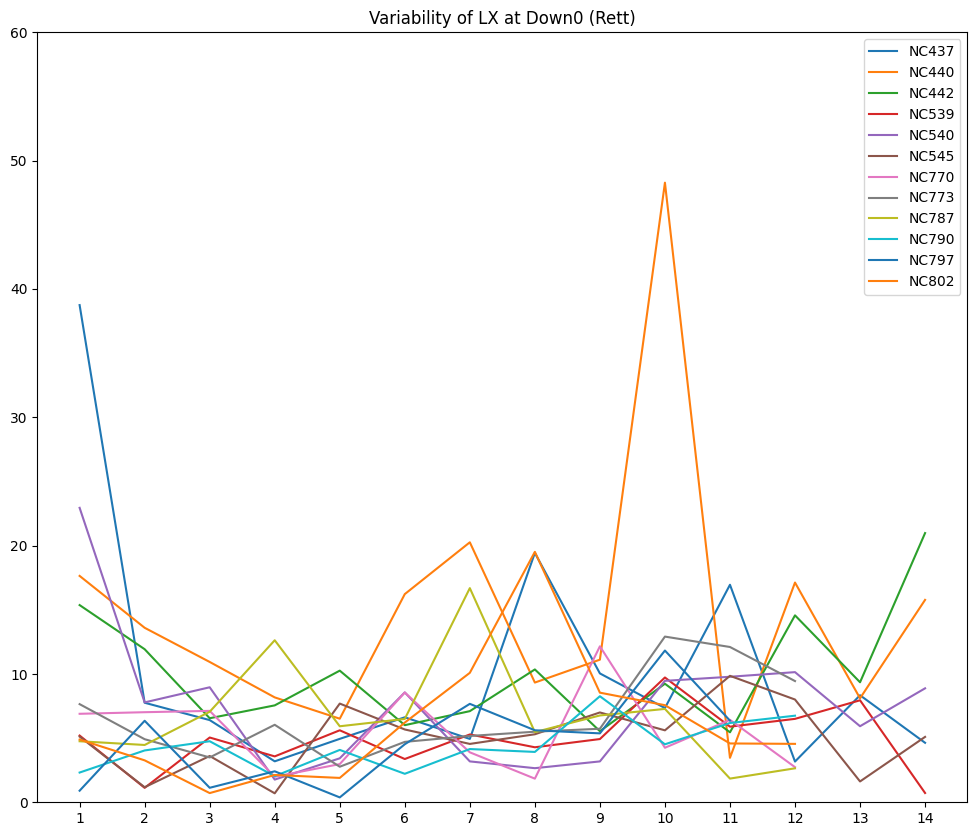

In [ ]:
# 4: down_LX_std_list

for i in range(len(down_speed_list)):
  df = generate_df_list(rett, 4, down_speed_list[i])
  plotline(df, rett_labels, days, 'Variability', 'LX', down_title_list[i], 'Rett')

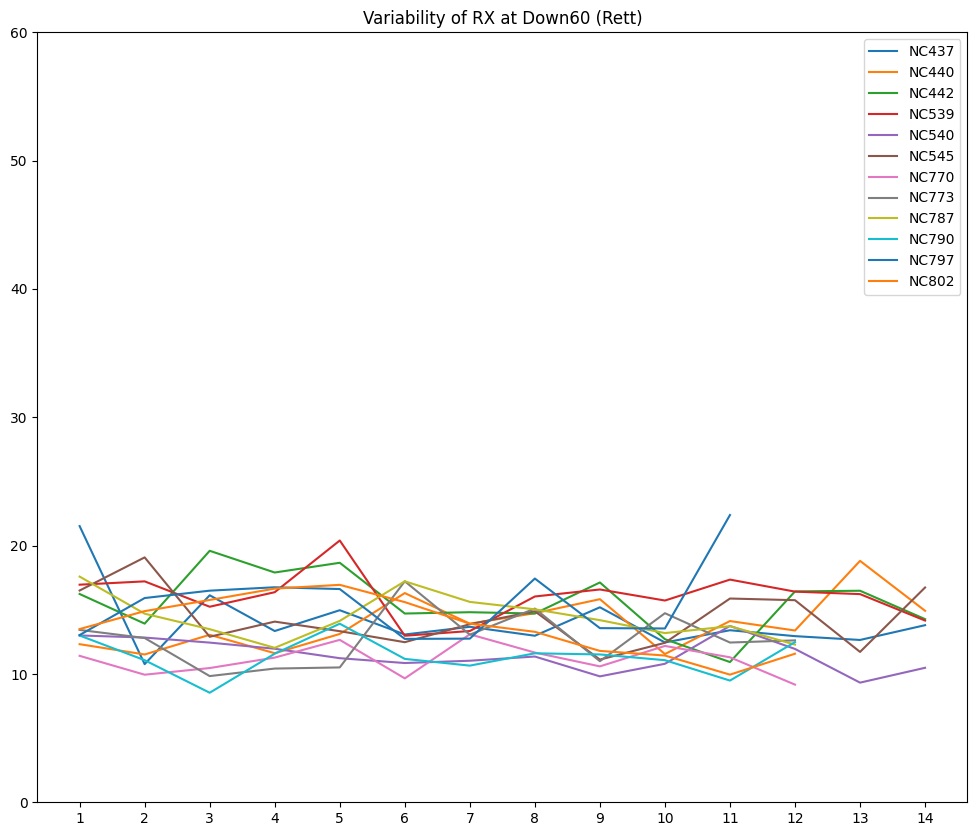

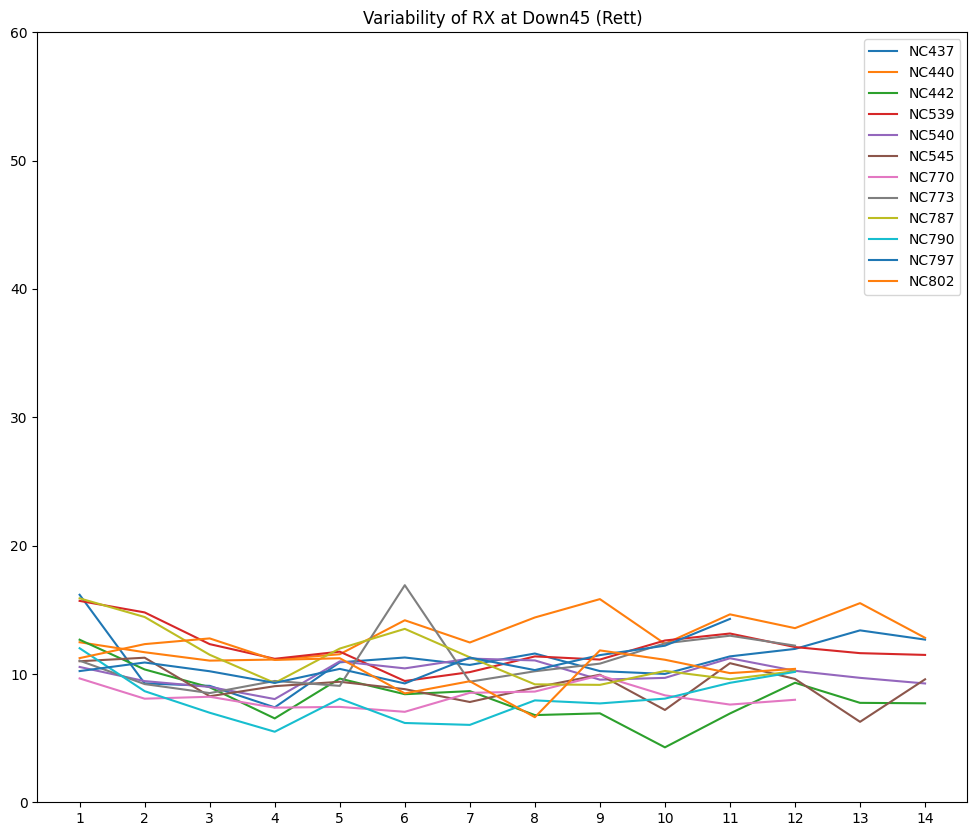

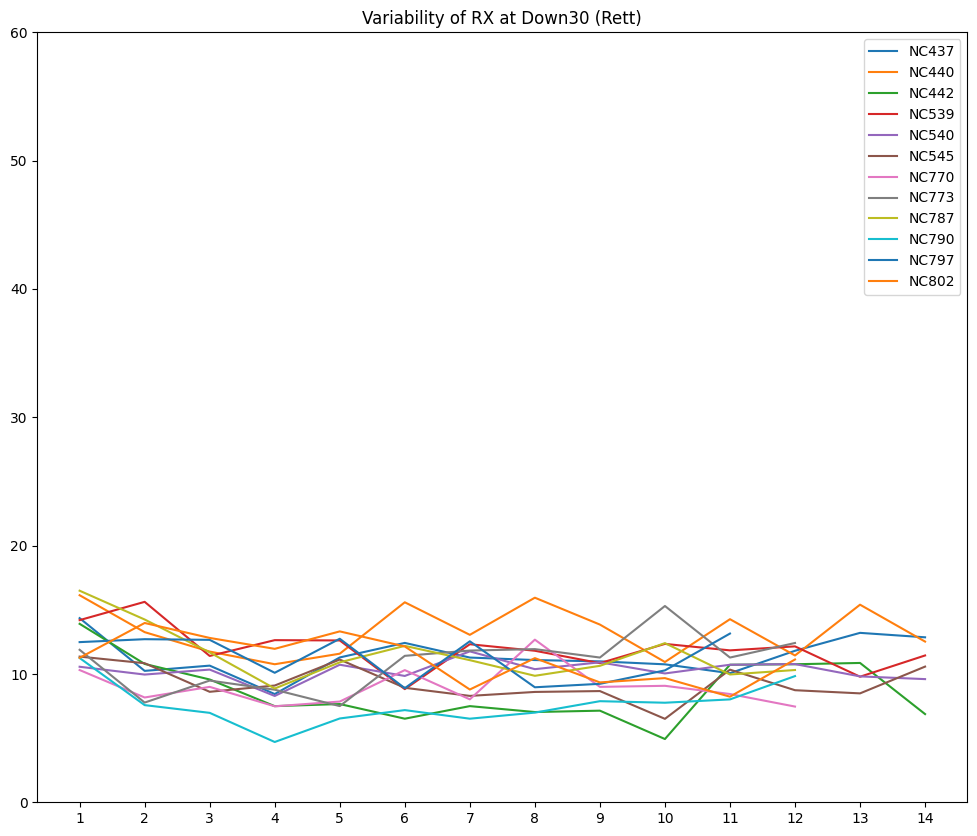

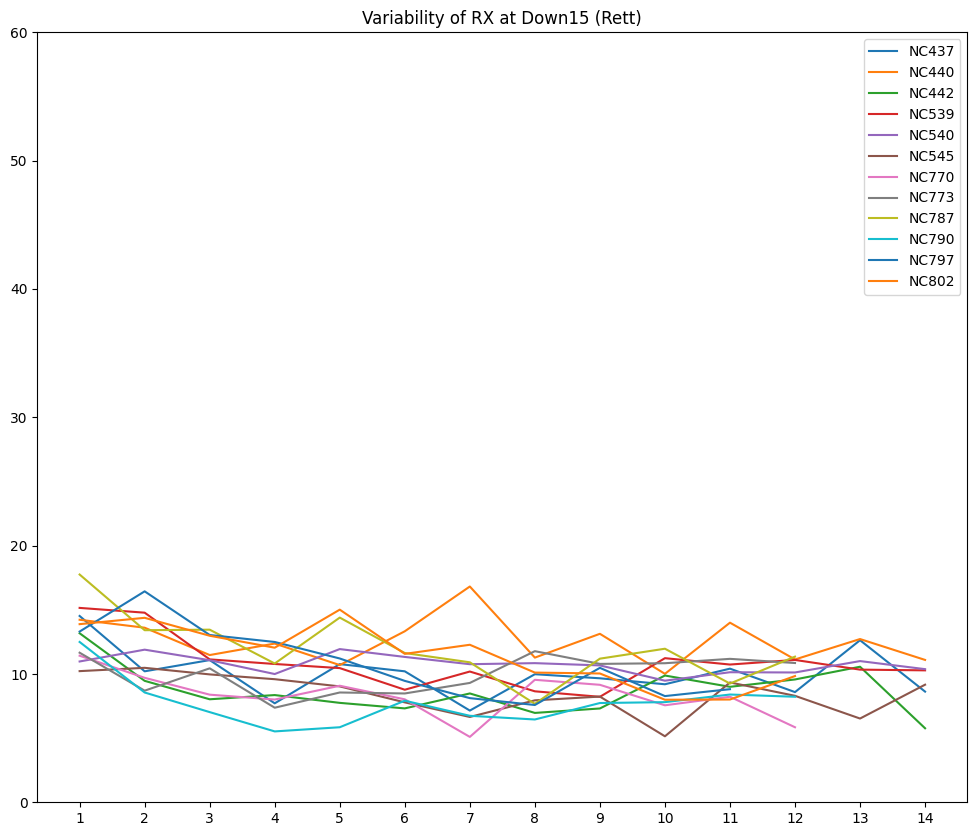

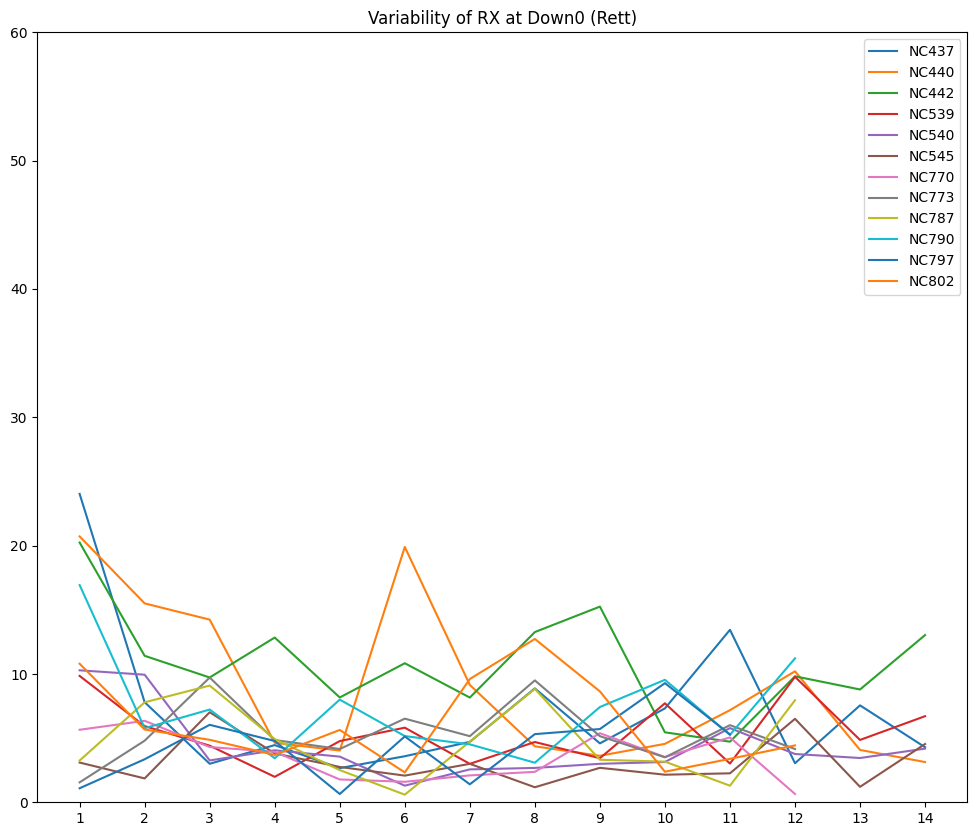

In [ ]:
# 5: down_RX_std_list

for i in range(len(down_speed_list)):
  df = generate_df_list(rett, 5, down_speed_list[i])
  plotline(df, rett_labels, days, 'Variability', 'RX', down_title_list[i], 'Rett')

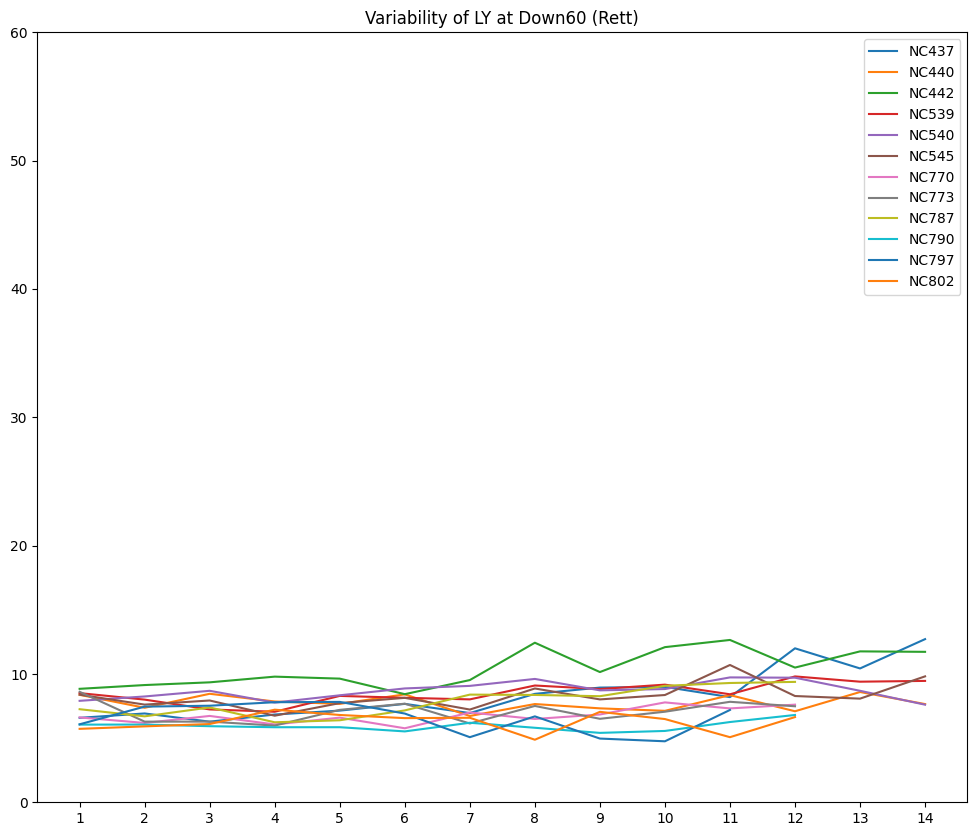

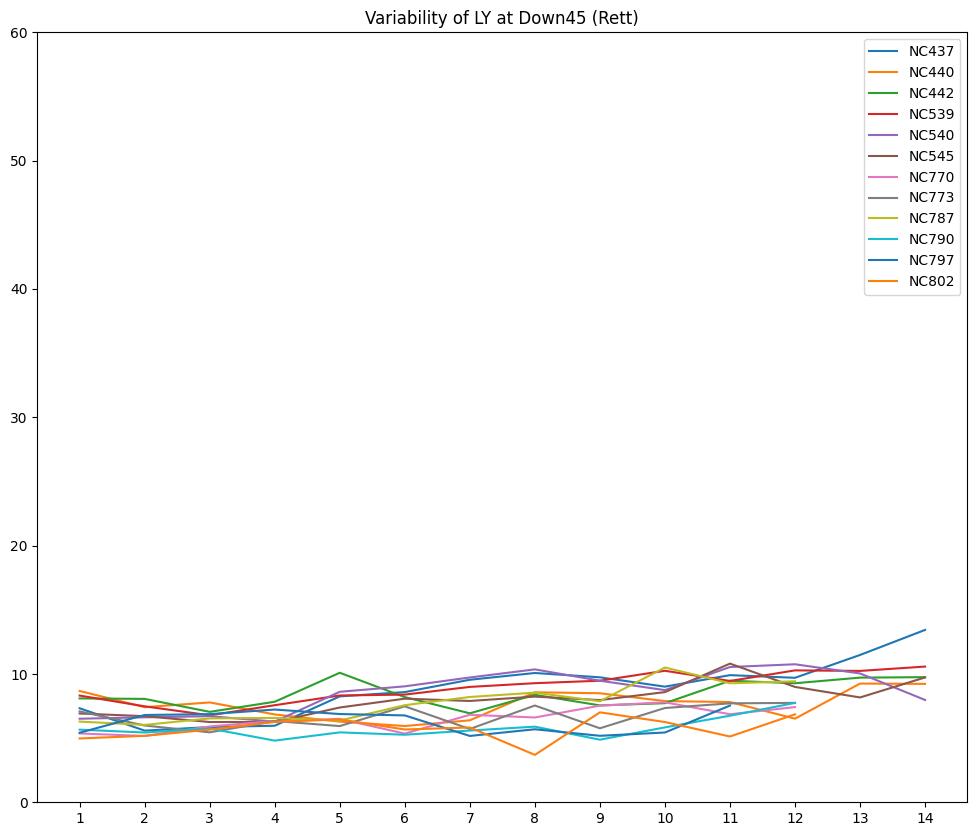

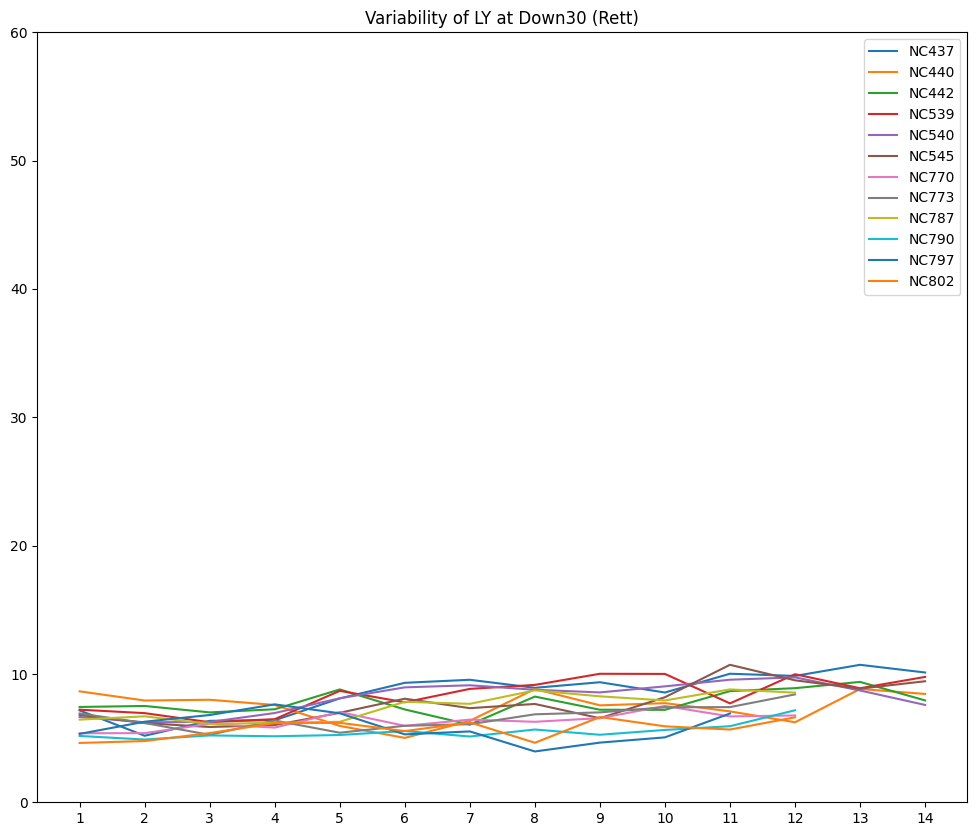

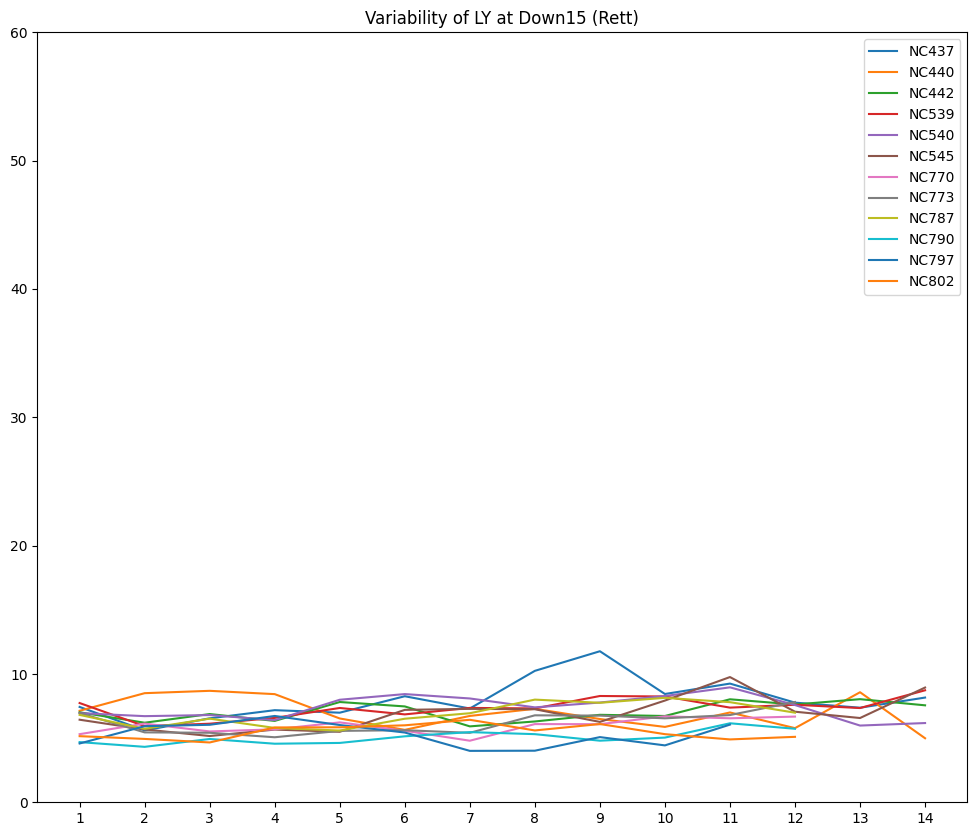

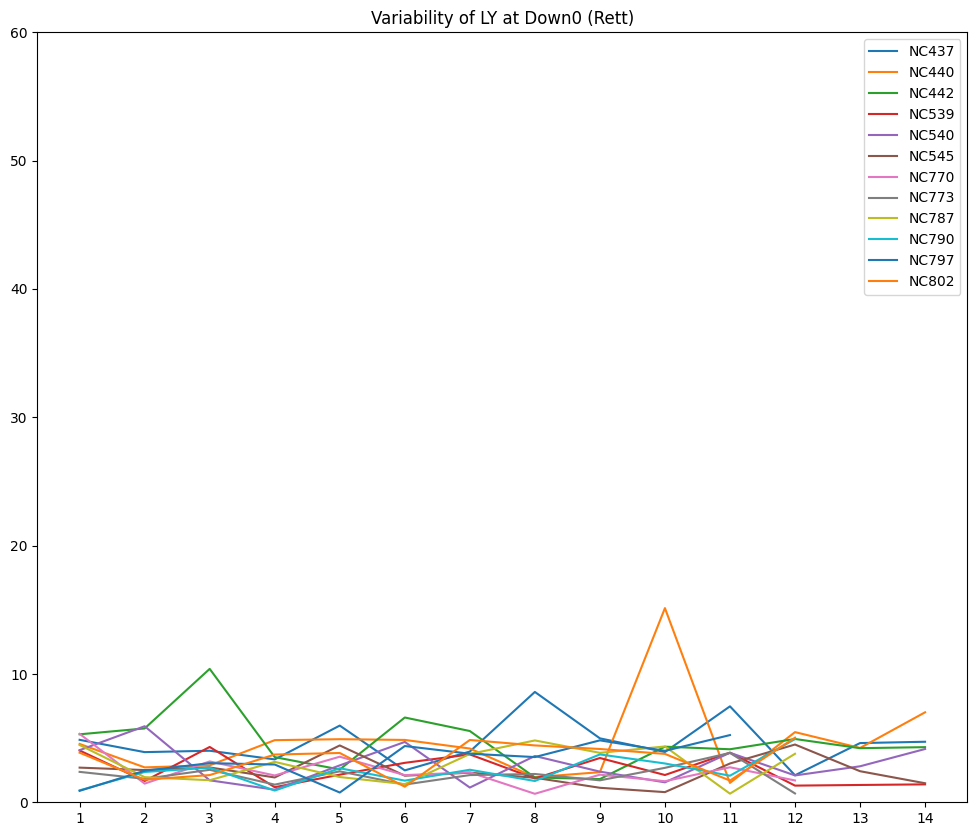

In [ ]:
# 6: down_LY_std_list 

for i in range(len(down_speed_list)):
  df = generate_df_list(rett, 6, down_speed_list[i])
  plotline(df, rett_labels, days, 'Variability', 'LY', down_title_list[i], 'Rett')

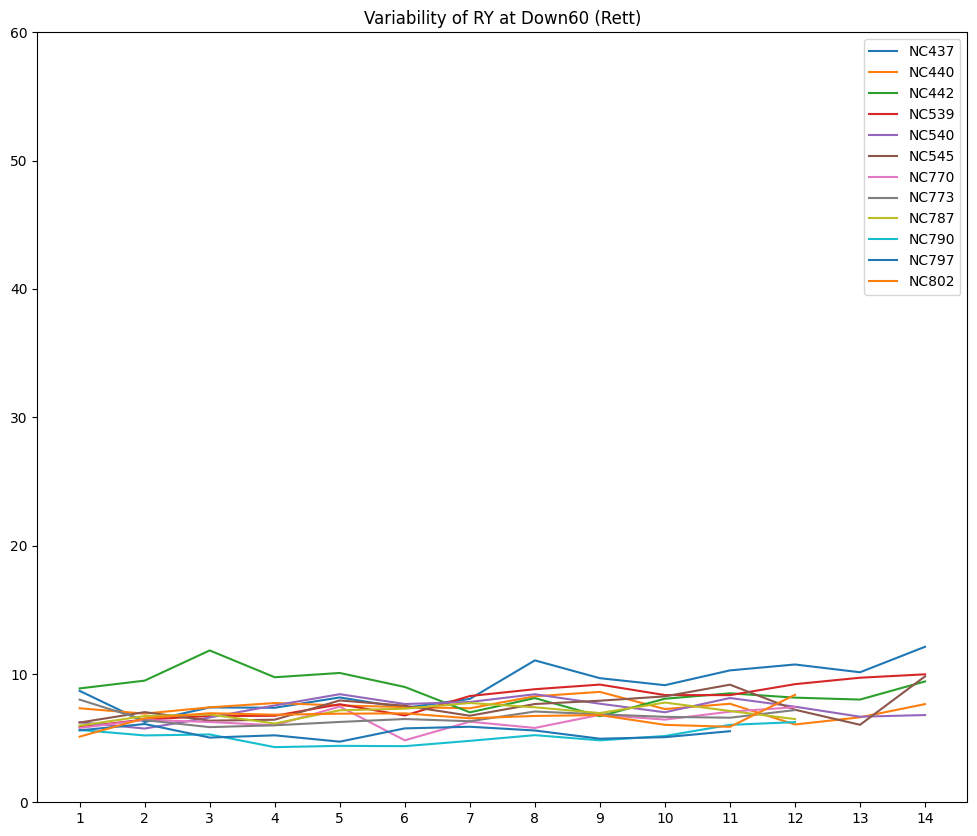

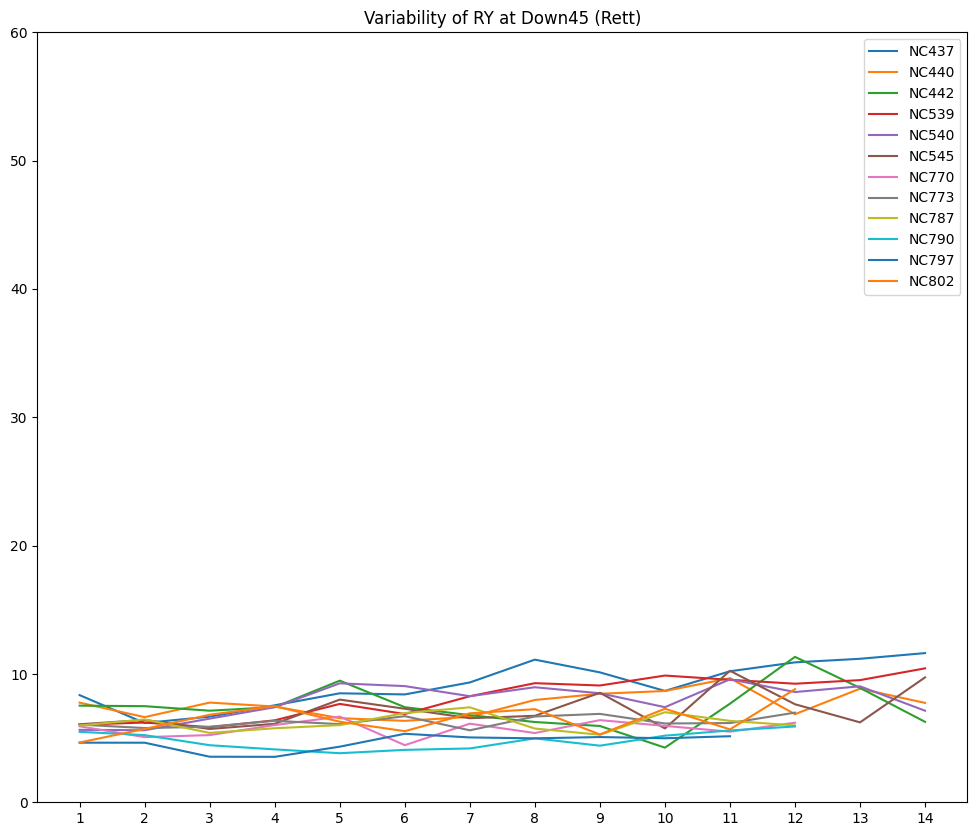

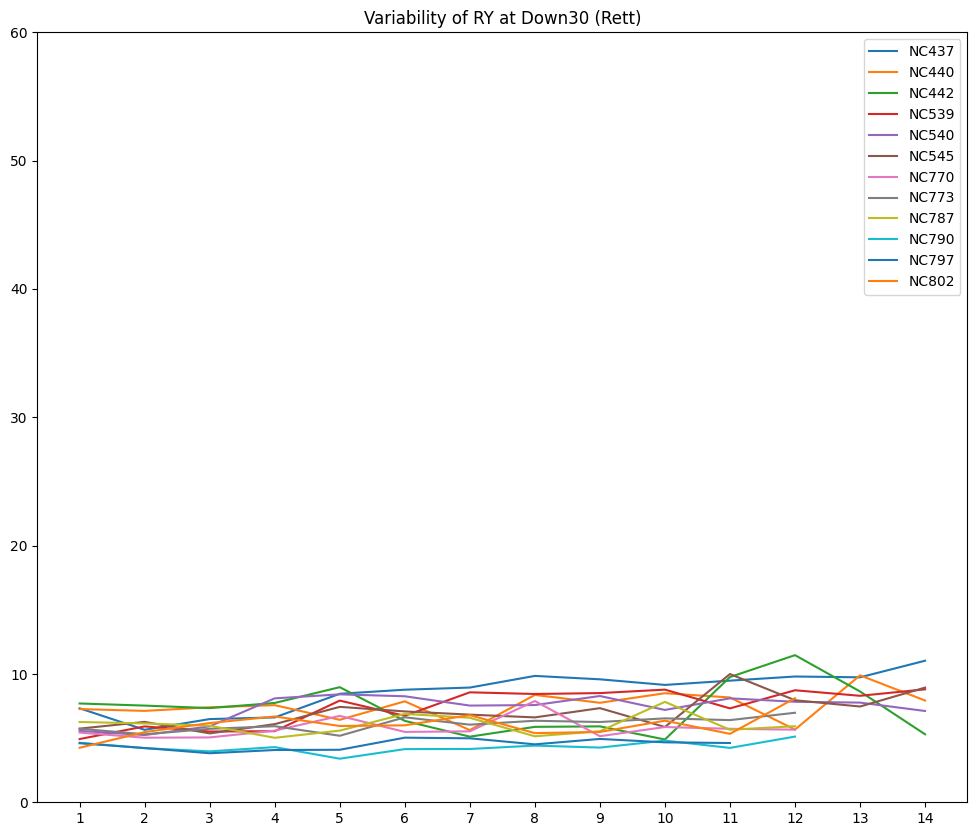

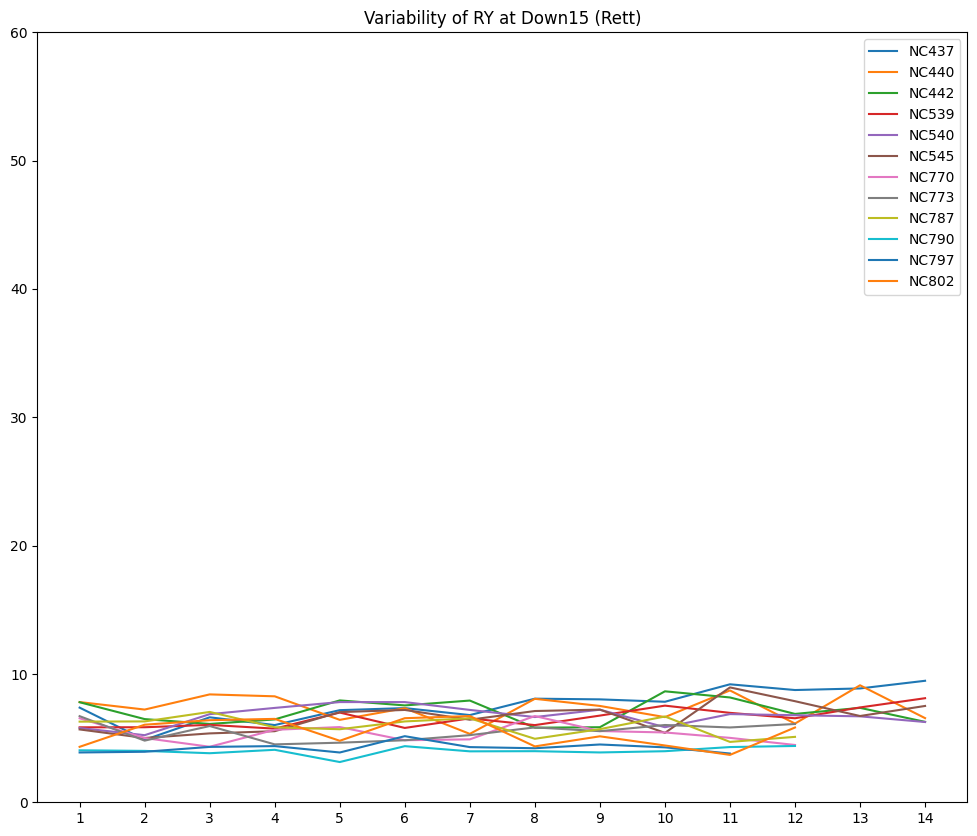

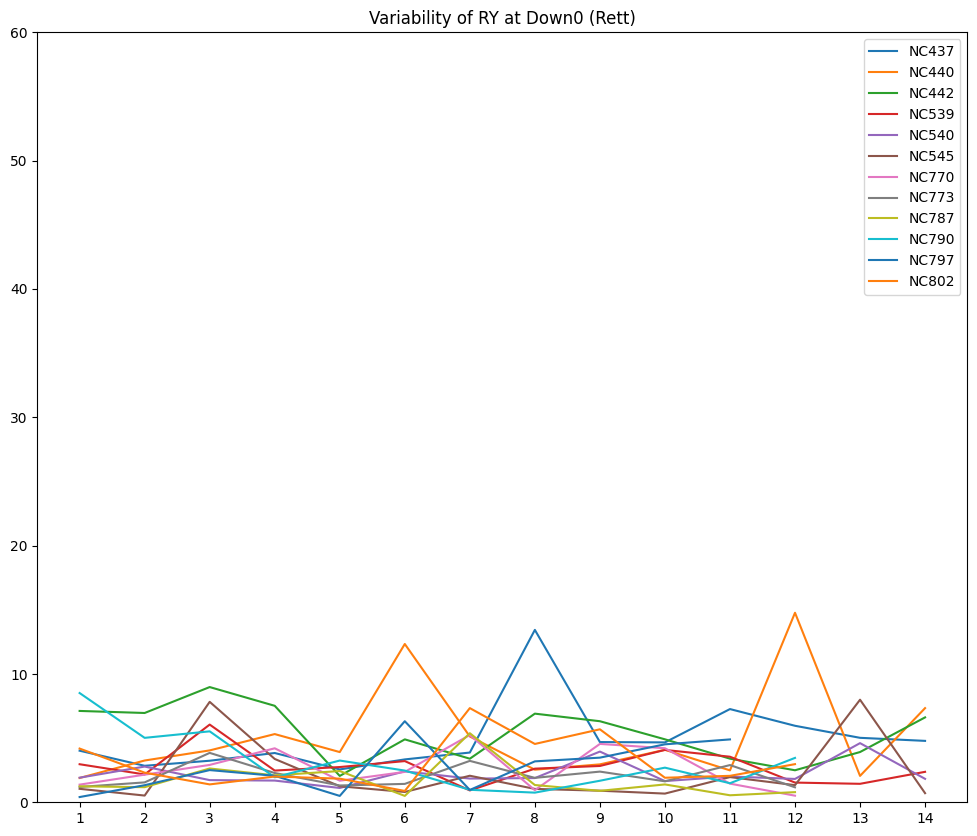

In [ ]:
# 7: down_LY_std_list 

for i in range(len(down_speed_list)):
  df = generate_df_list(rett, 7, down_speed_list[i])
  plotline(df, rett_labels, days, 'Variability', 'RY', down_title_list[i], 'Rett')

## Wild Mean

In [ ]:
def plotline(df_list, l_list, xt, stat, pos, speed, type):
  
  array_list = []
  for i in df_list:
    p = np.asarray(i)
    array_list.append(p)

  x = range(14)

  plt.figure(figsize=(12,10))
  plt.xticks(x, xt)
  plt.ylim(50,300)
  plt.title(stat + ' of ' + pos + ' at ' + speed + ' (' + type + ')')

  for i in range(len(l_list)):
    plt.plot(array_list[i], label=l_list[i])

  plt.legend()
  plt.show()

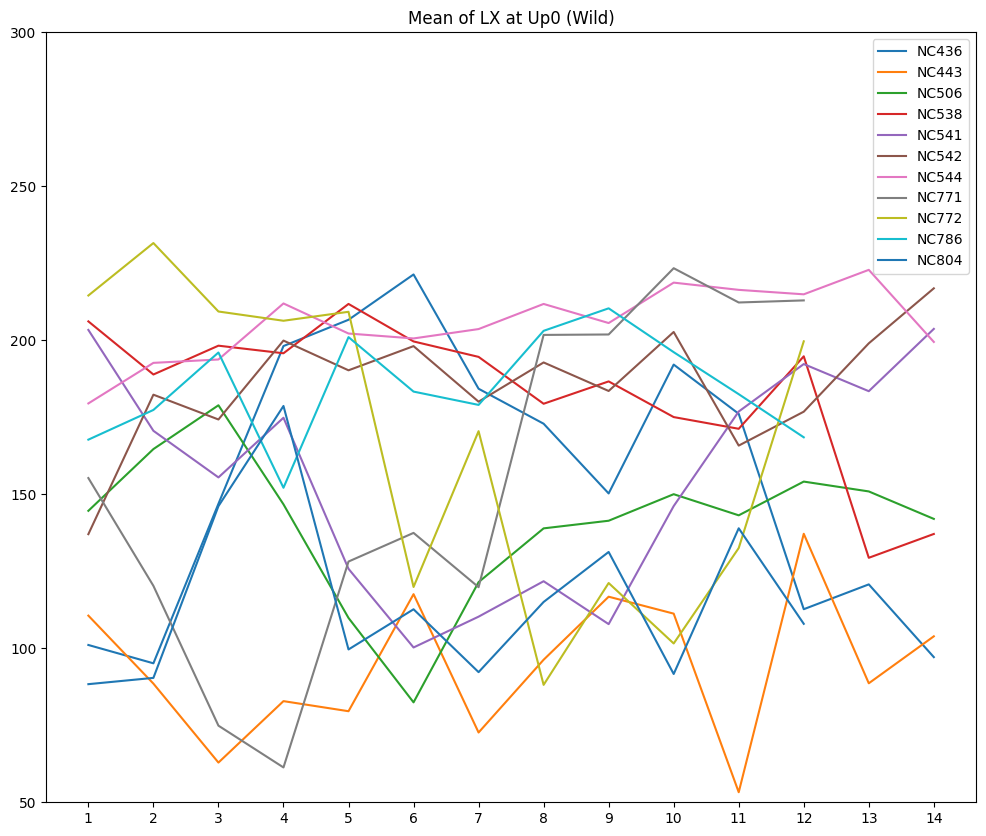

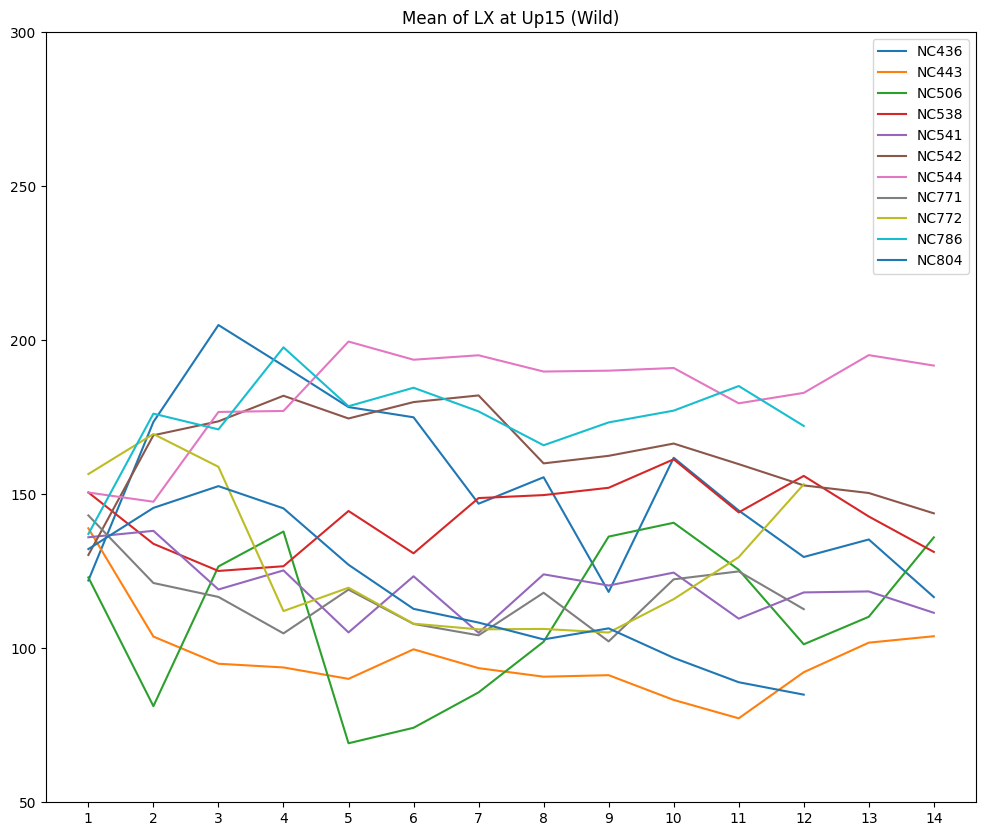

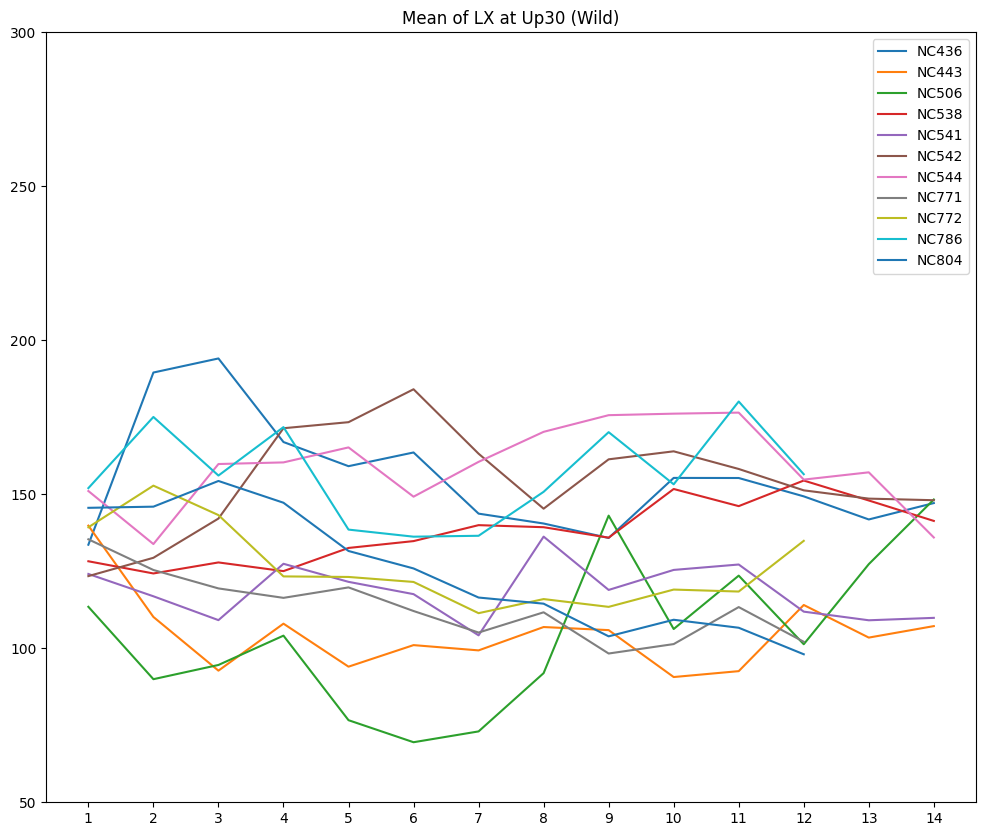

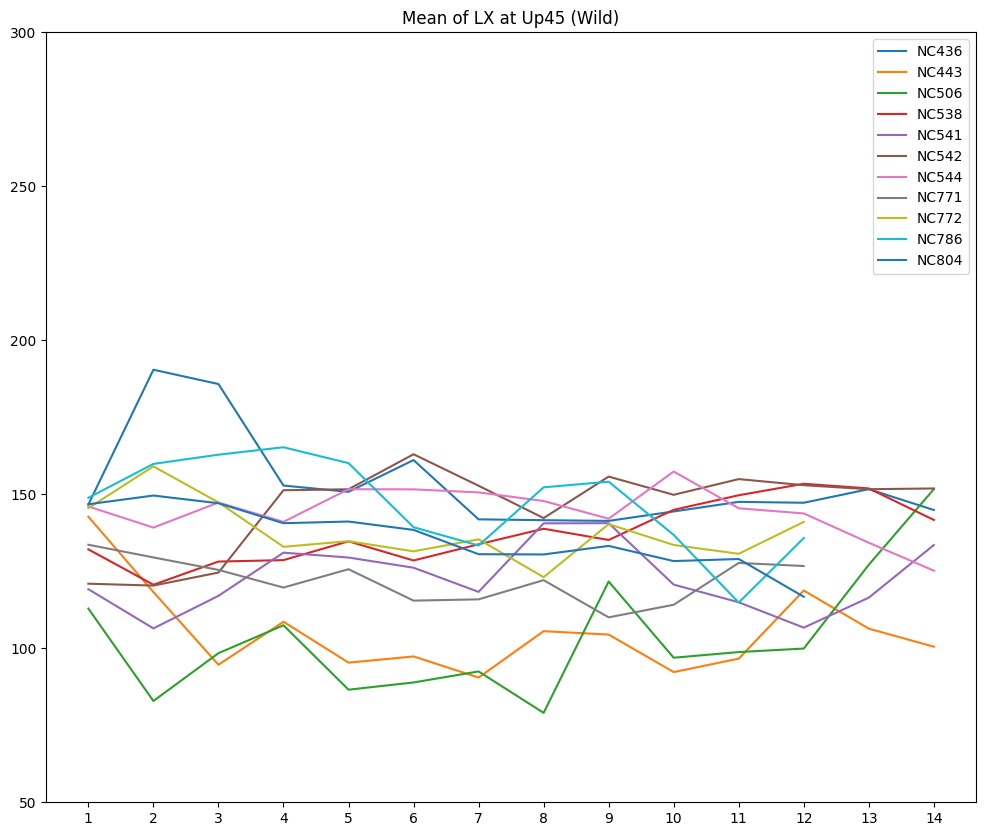

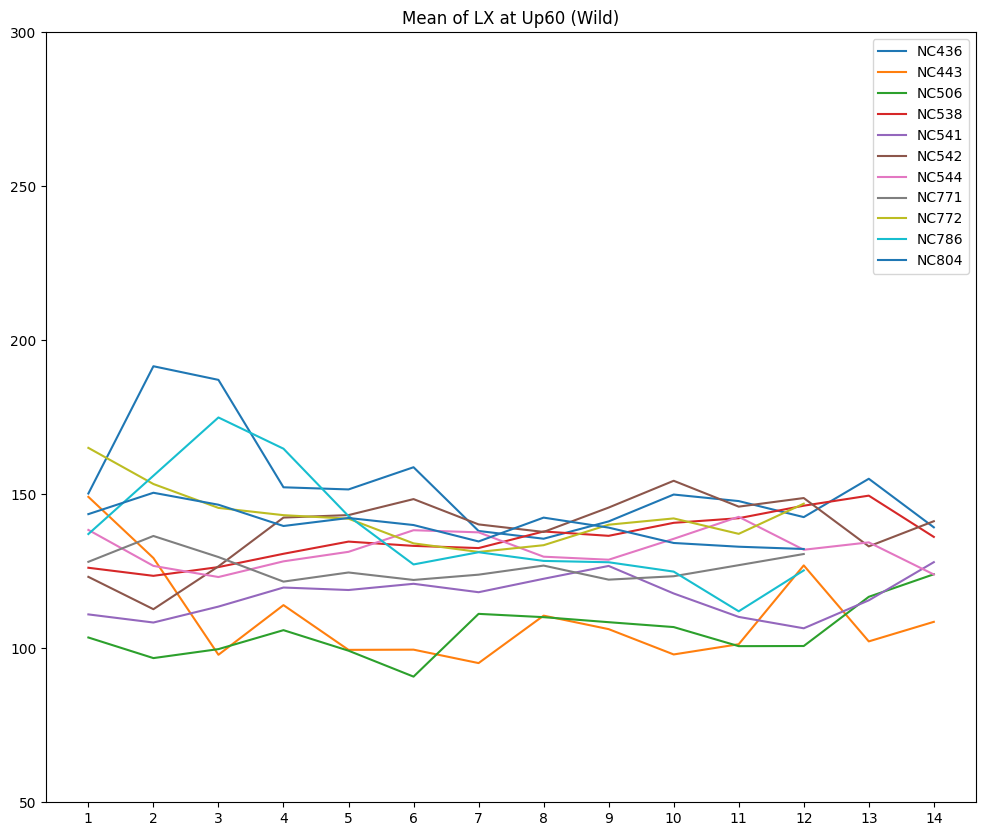

In [ ]:
# 8: up_LX_mean_list

for i in range(len(up_speed_list)):
  df = generate_df_list(wild, 8, up_speed_list[i])
  plotline(df, wild_labels, days, 'Mean', 'LX', up_title_list[i], 'Wild')

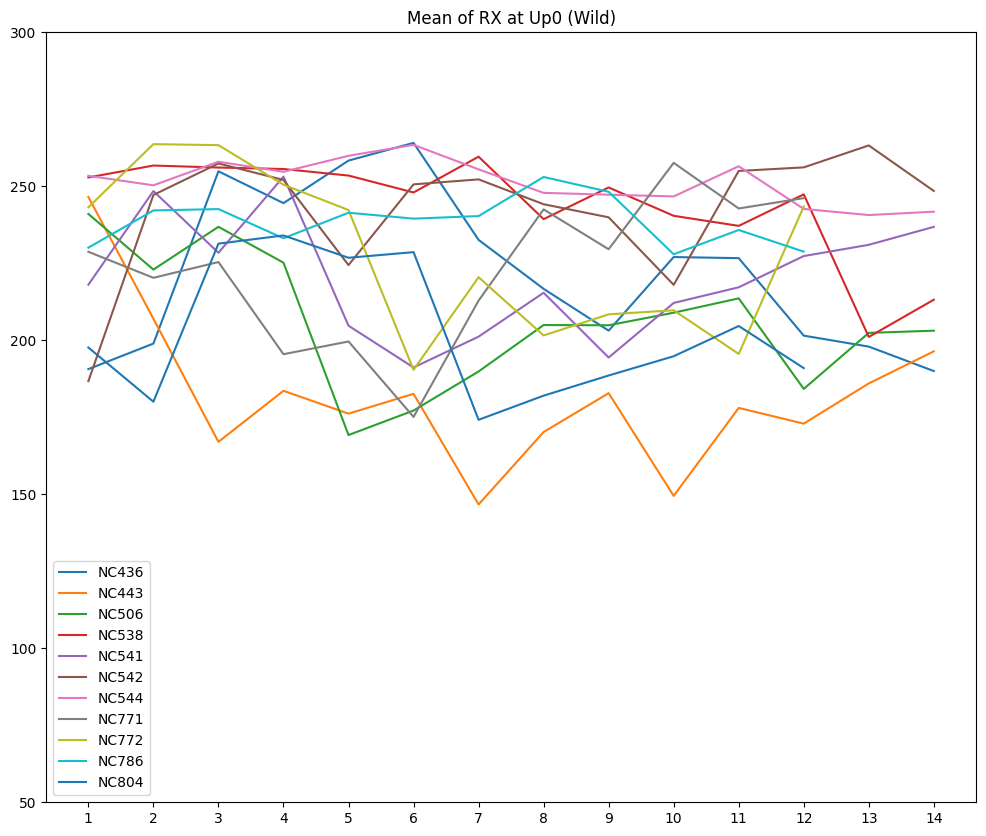

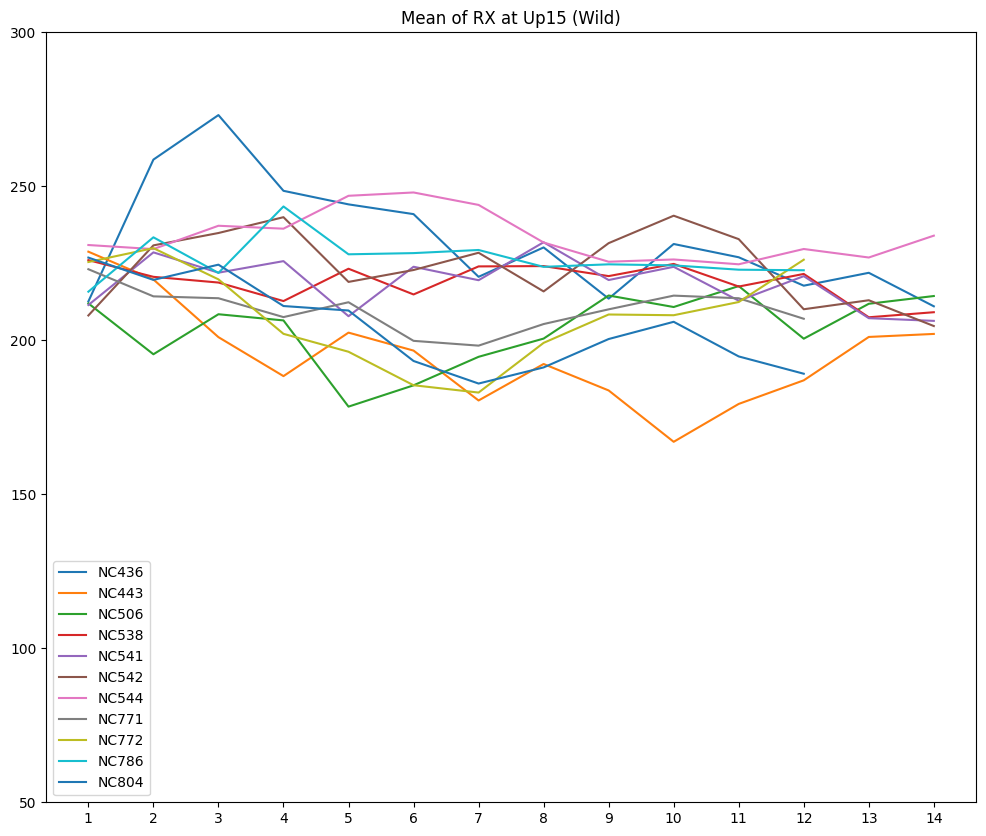

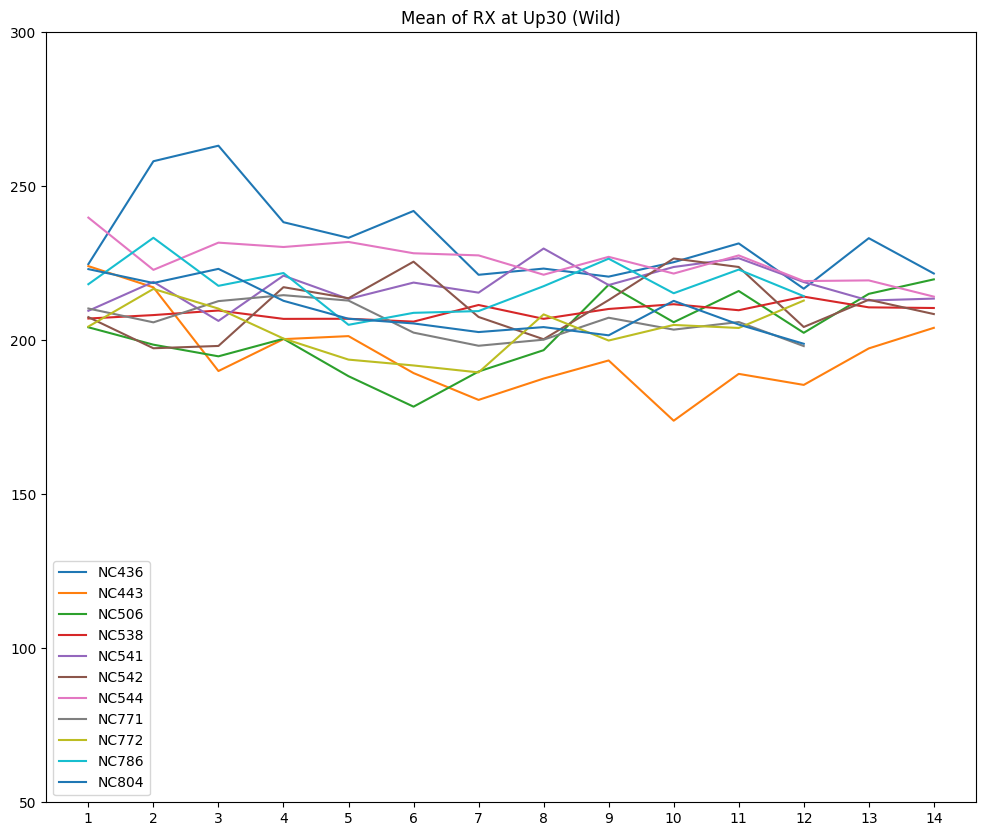

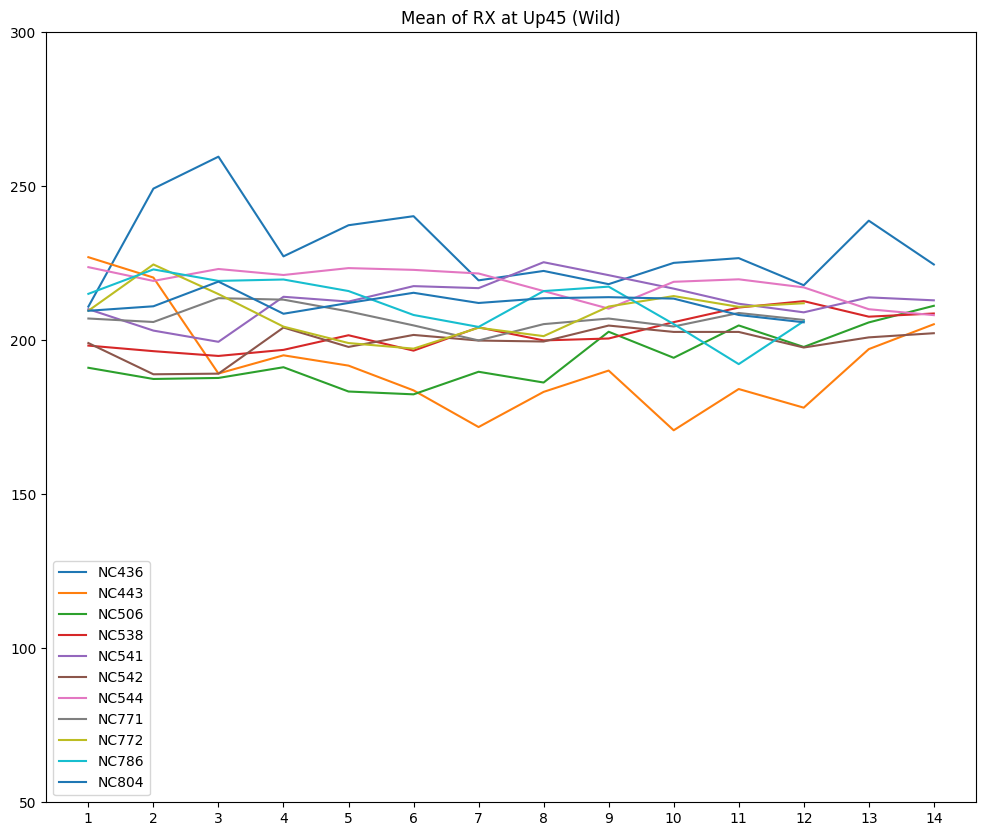

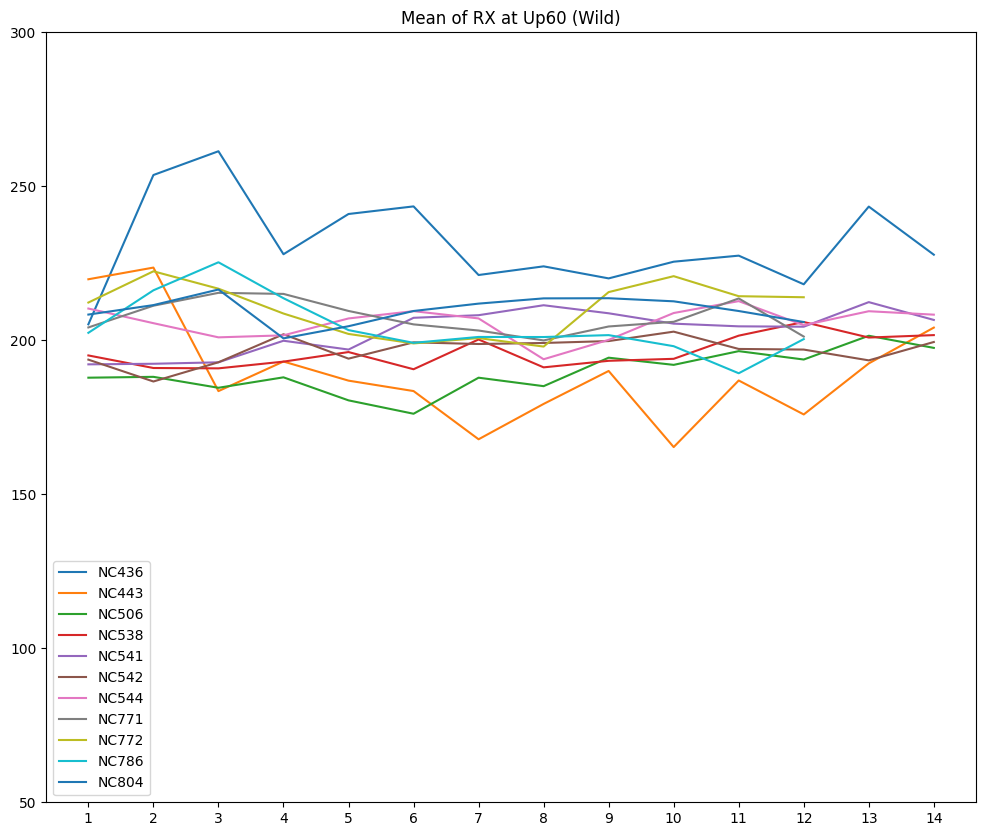

In [ ]:
# 9: up_RX_mean_list

for i in range(len(up_speed_list)):
  df = generate_df_list(wild, 9, up_speed_list[i])
  plotline(df, wild_labels, days, 'Mean', 'RX', up_title_list[i], 'Wild')

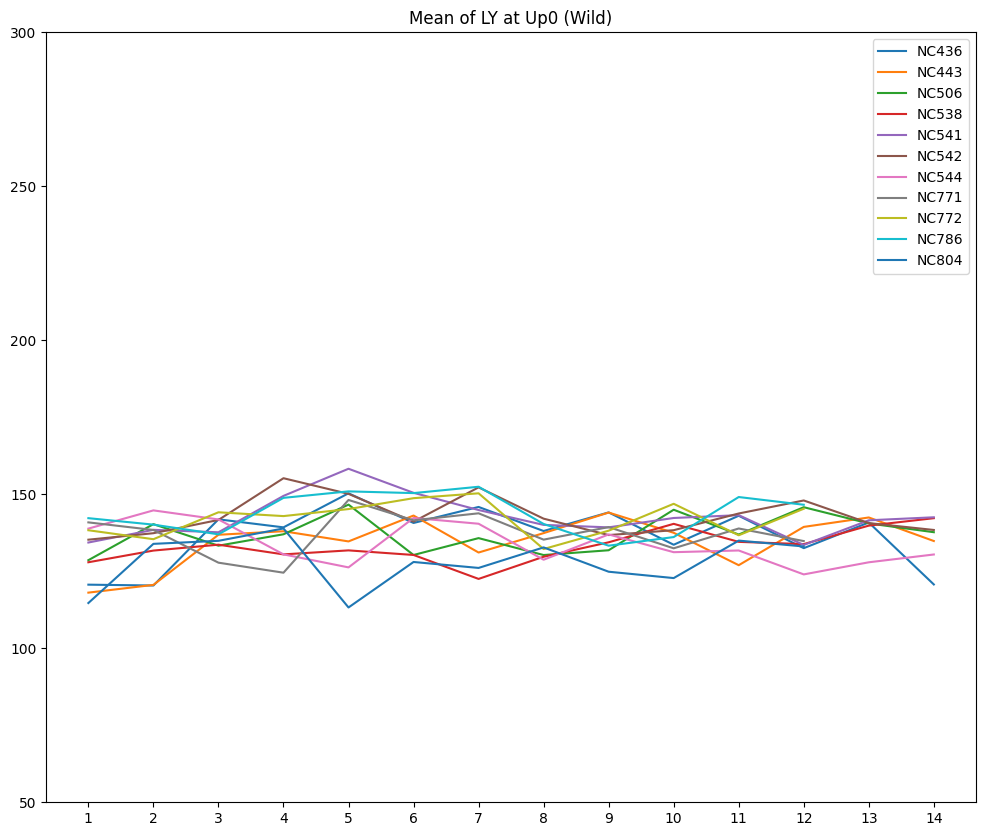

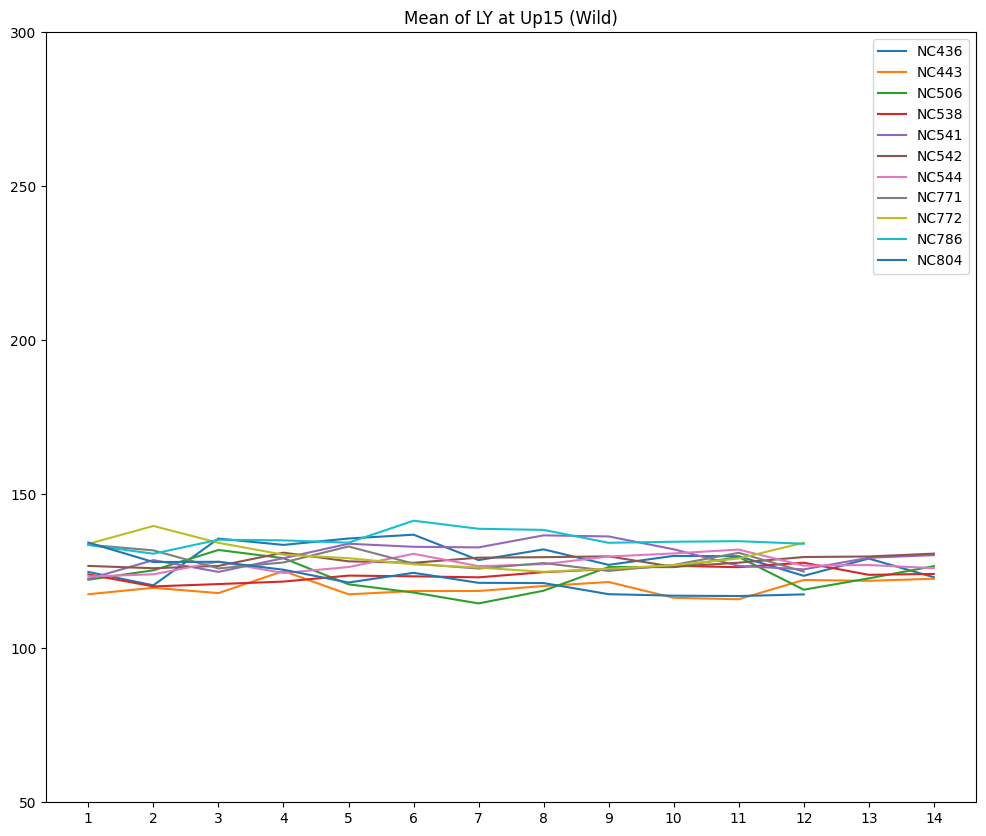

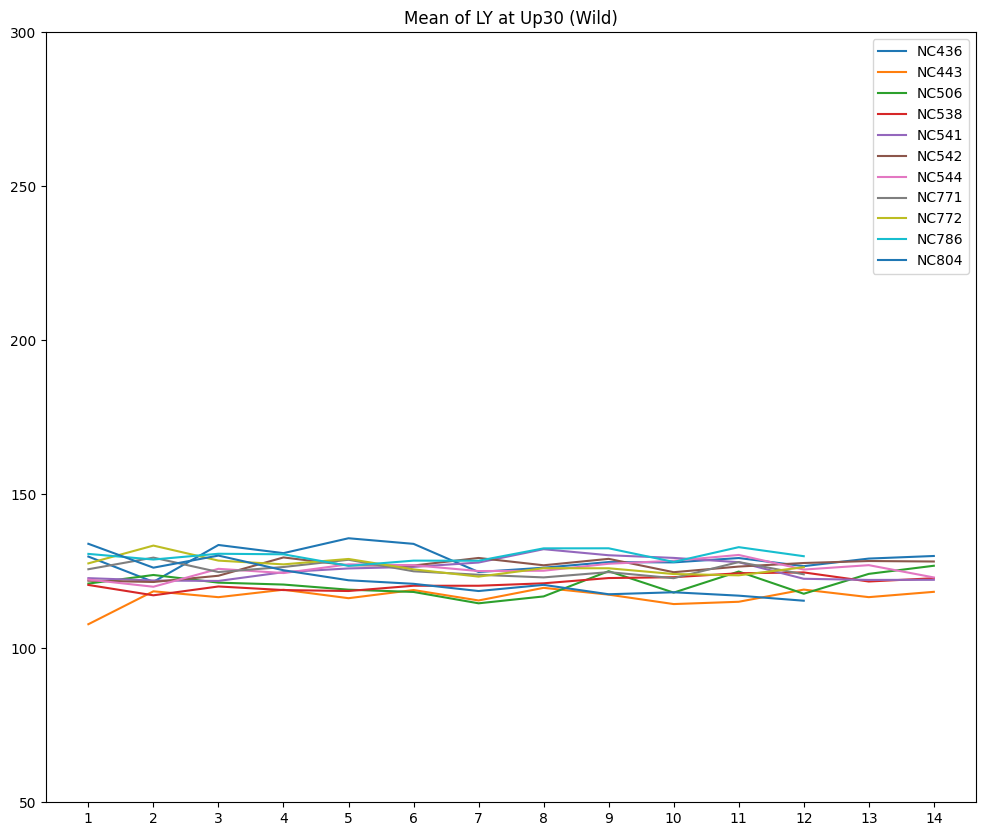

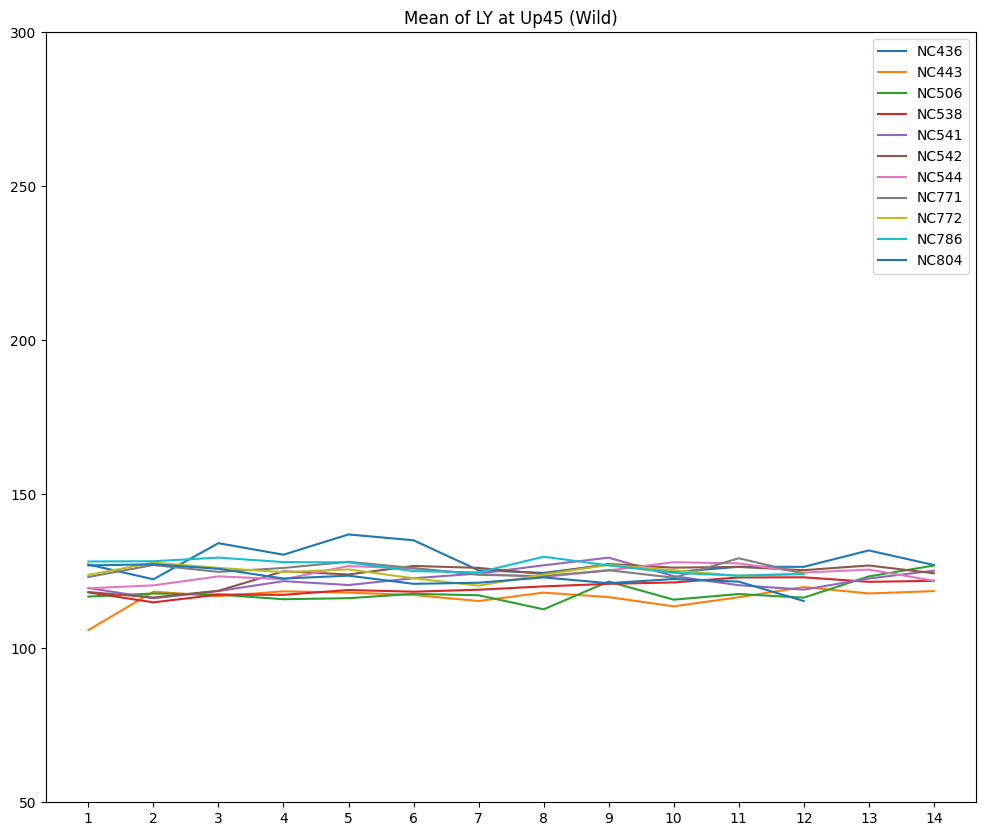

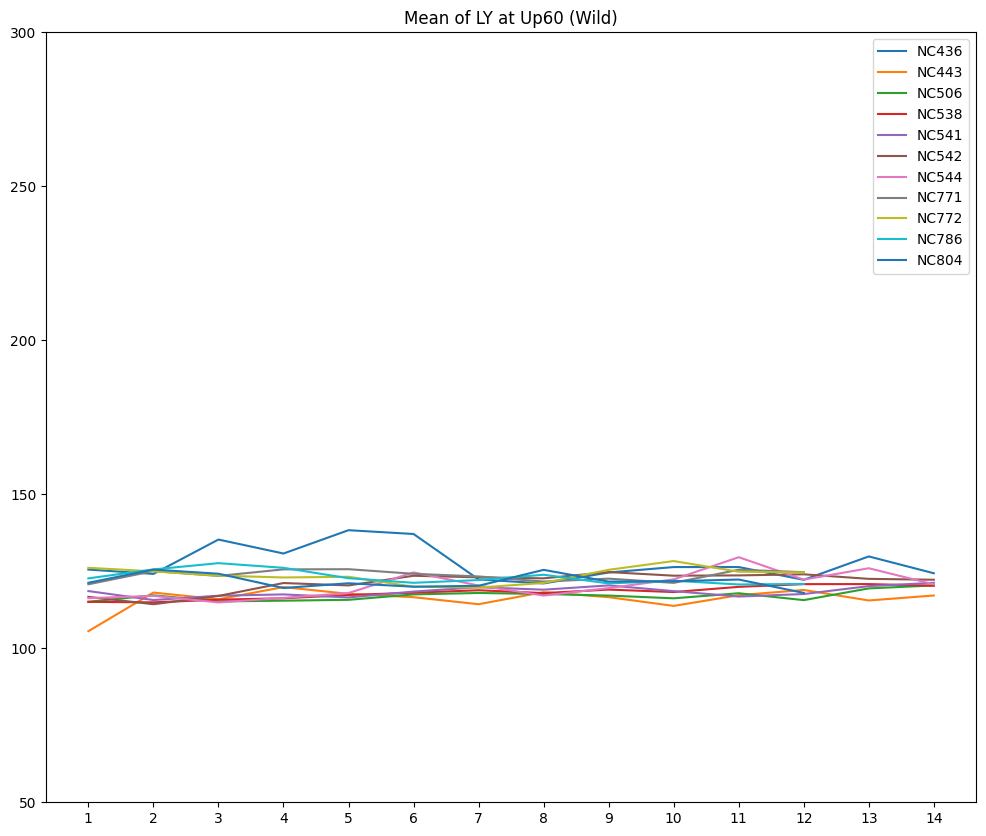

In [ ]:
# 10: up_LY_mean_list

for i in range(len(up_speed_list)):
  df = generate_df_list(wild, 10, up_speed_list[i])
  plotline(df, wild_labels, days, 'Mean', 'LY', up_title_list[i], 'Wild')

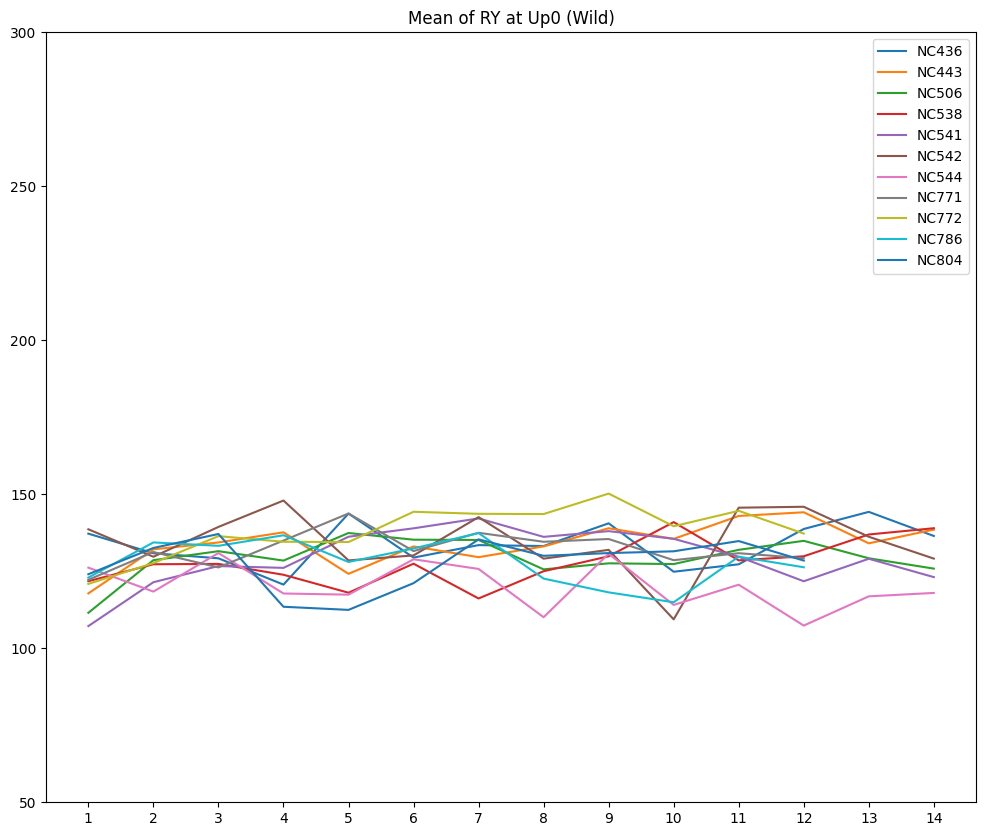

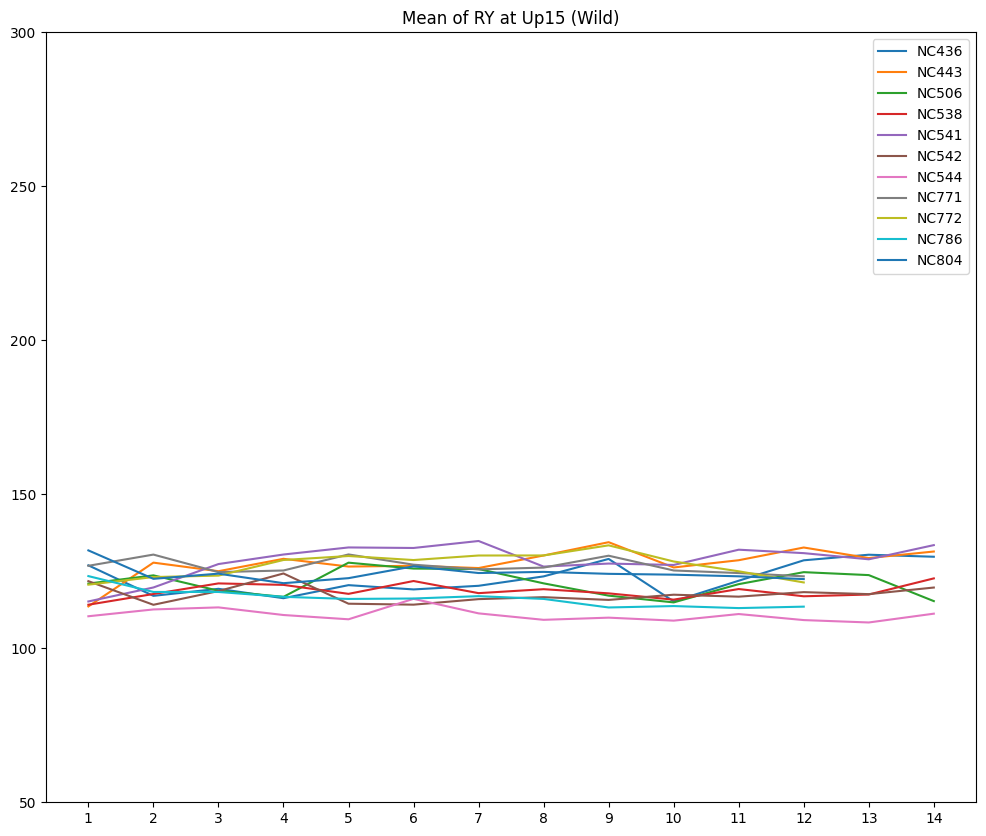

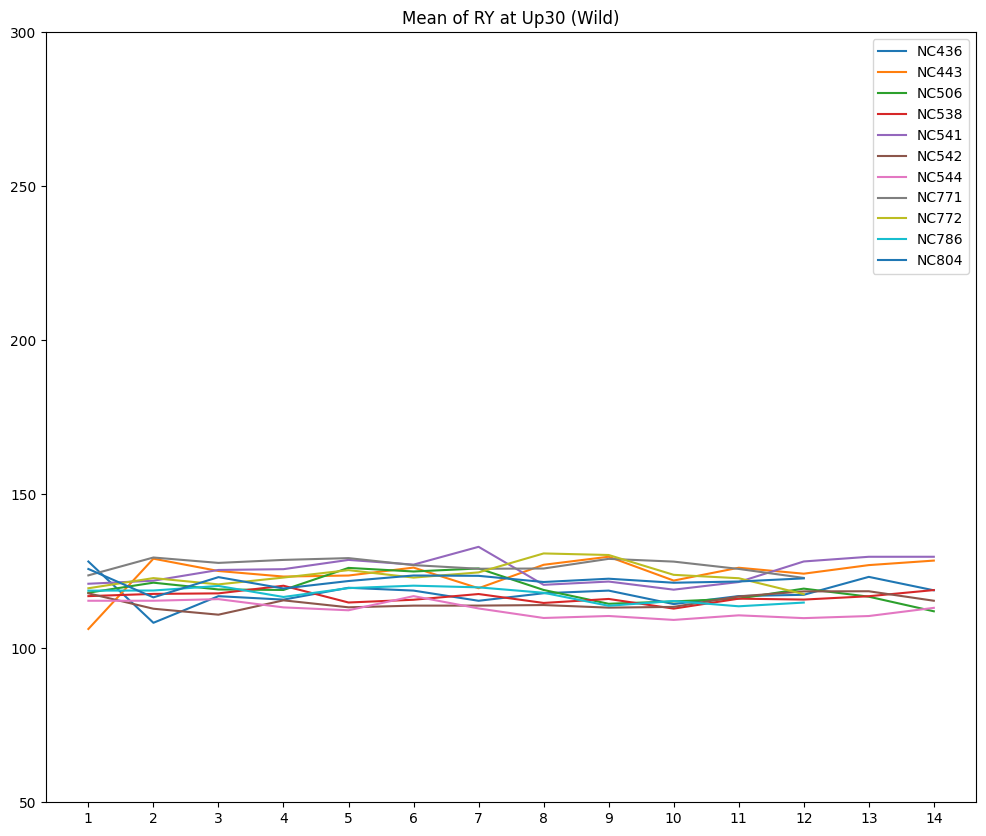

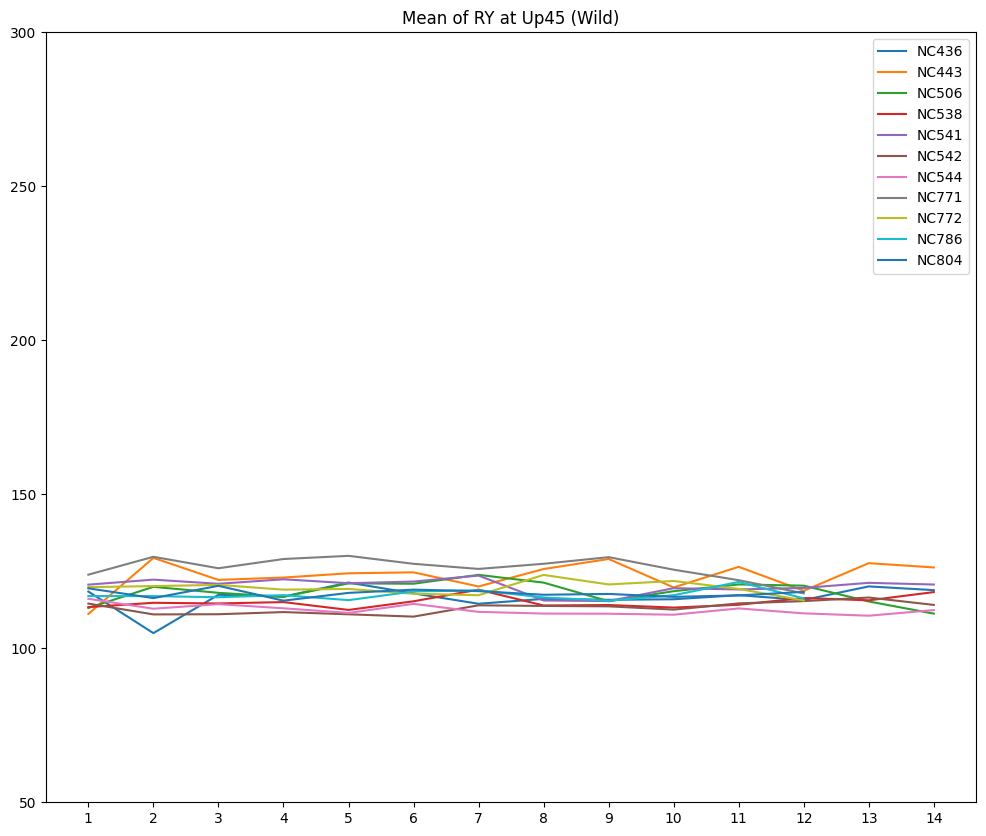

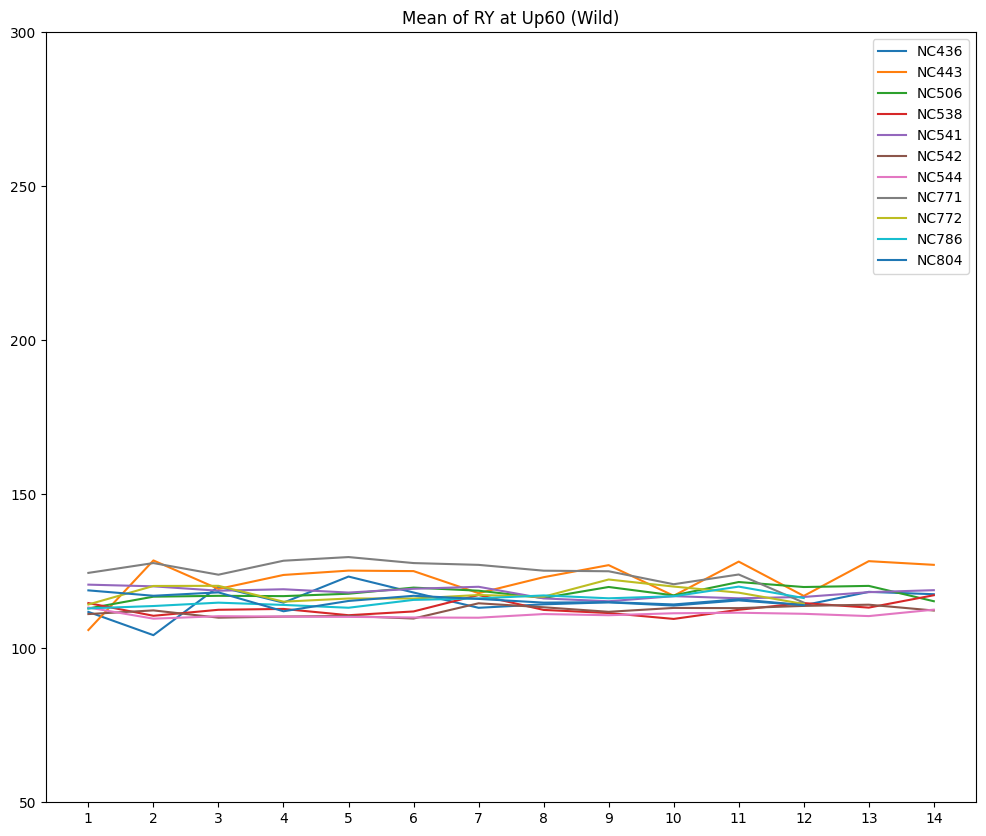

In [ ]:
# 11: up_RY_mean_list

for i in range(len(up_speed_list)):
  df = generate_df_list(wild, 11, up_speed_list[i])
  plotline(df, wild_labels, days, 'Mean', 'RY', up_title_list[i], 'Wild')

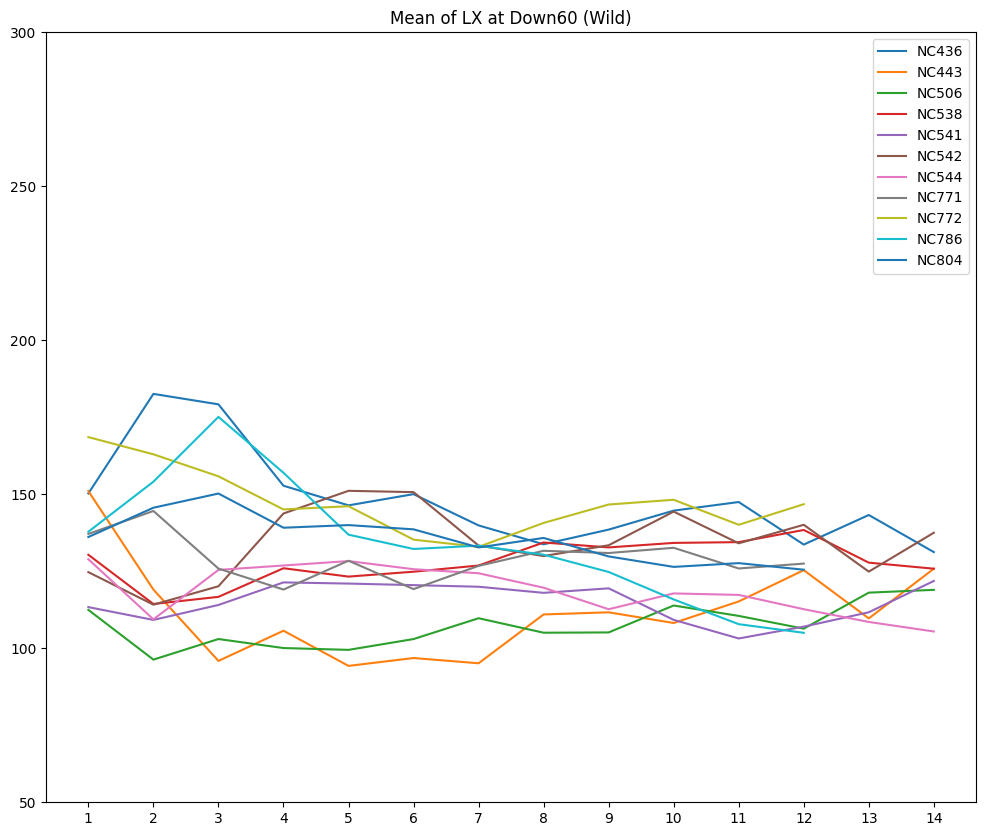

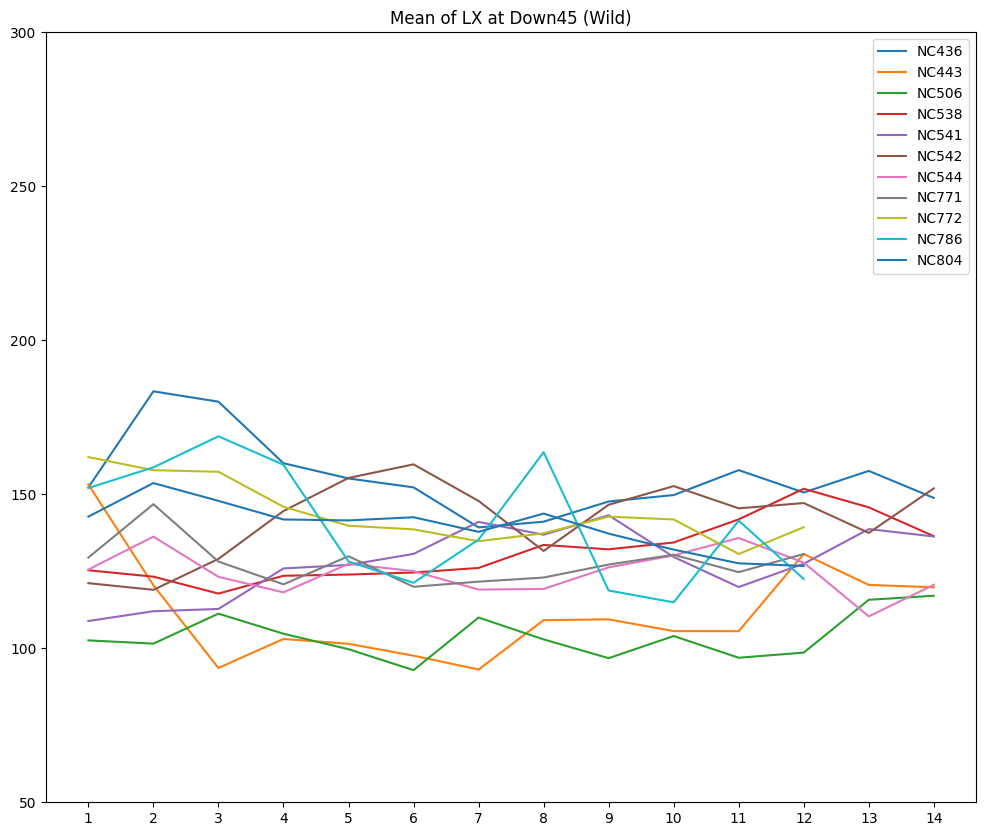

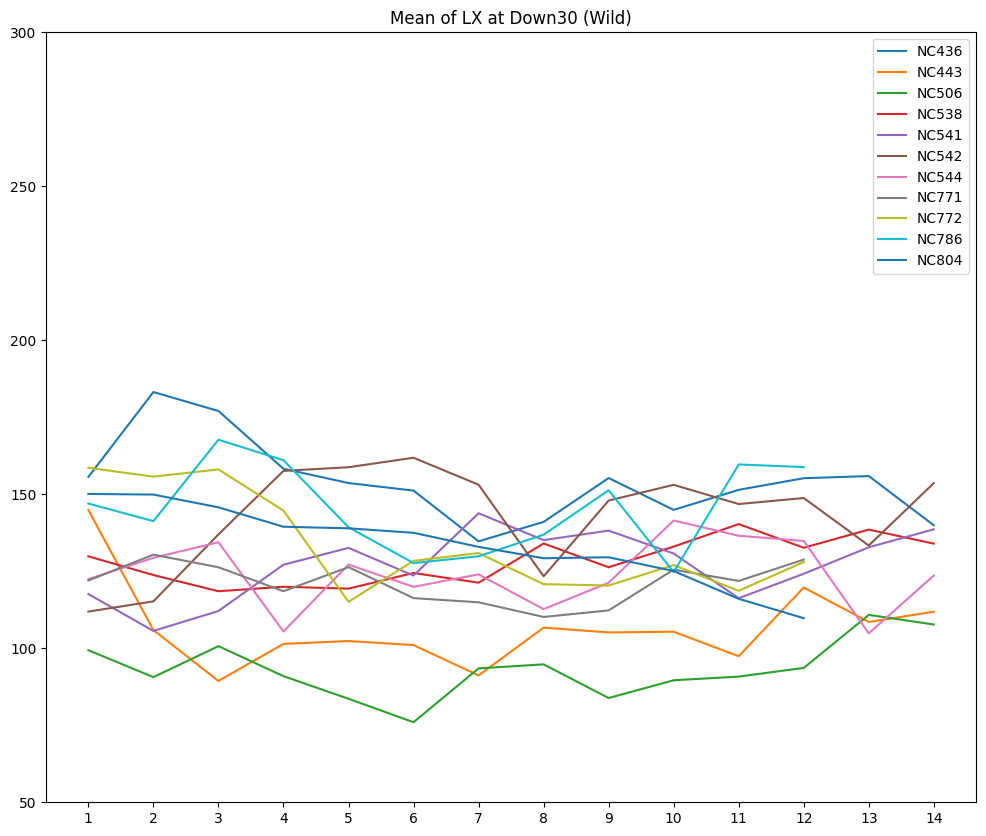

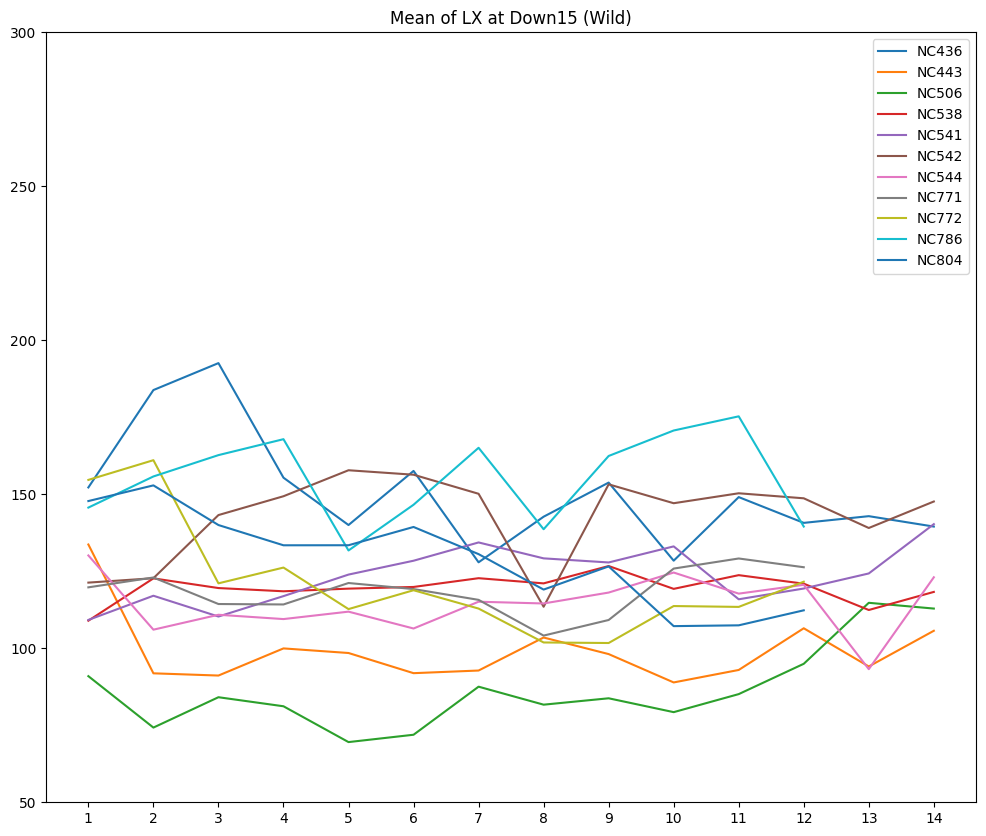

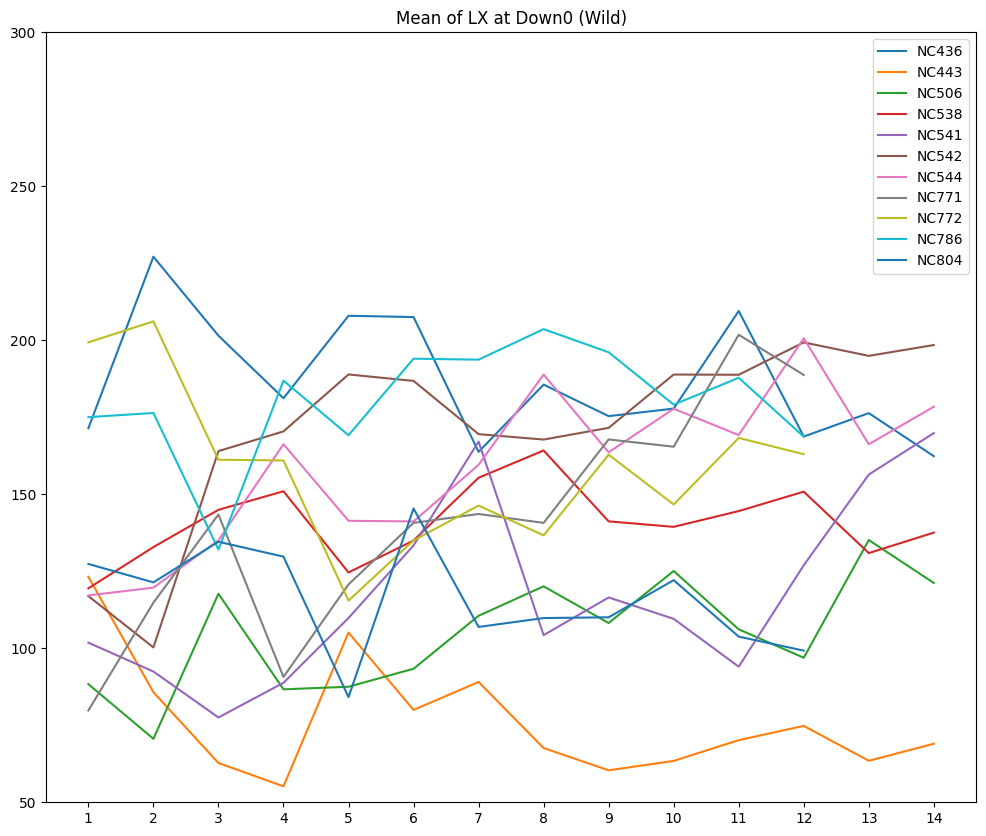

In [ ]:
# 12: down_LX_mean_list

for i in range(len(down_speed_list)):
  df = generate_df_list(wild, 12, down_speed_list[i])
  plotline(df, wild_labels, days, 'Mean', 'LX', down_title_list[i], 'Wild')

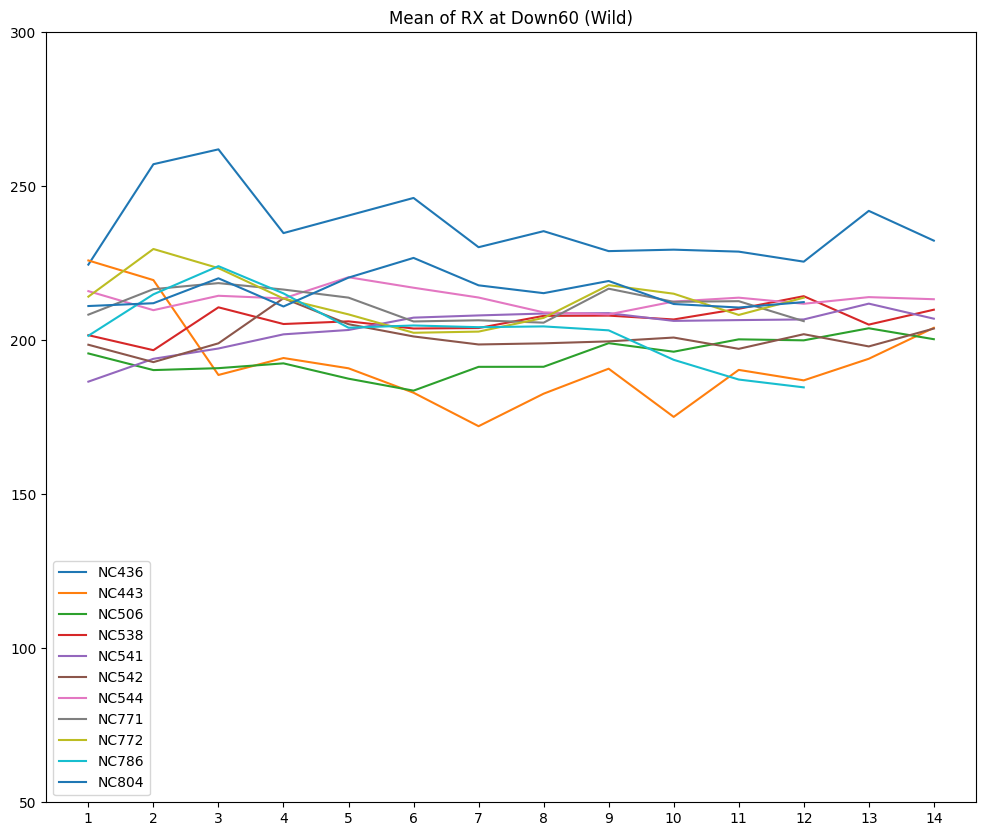

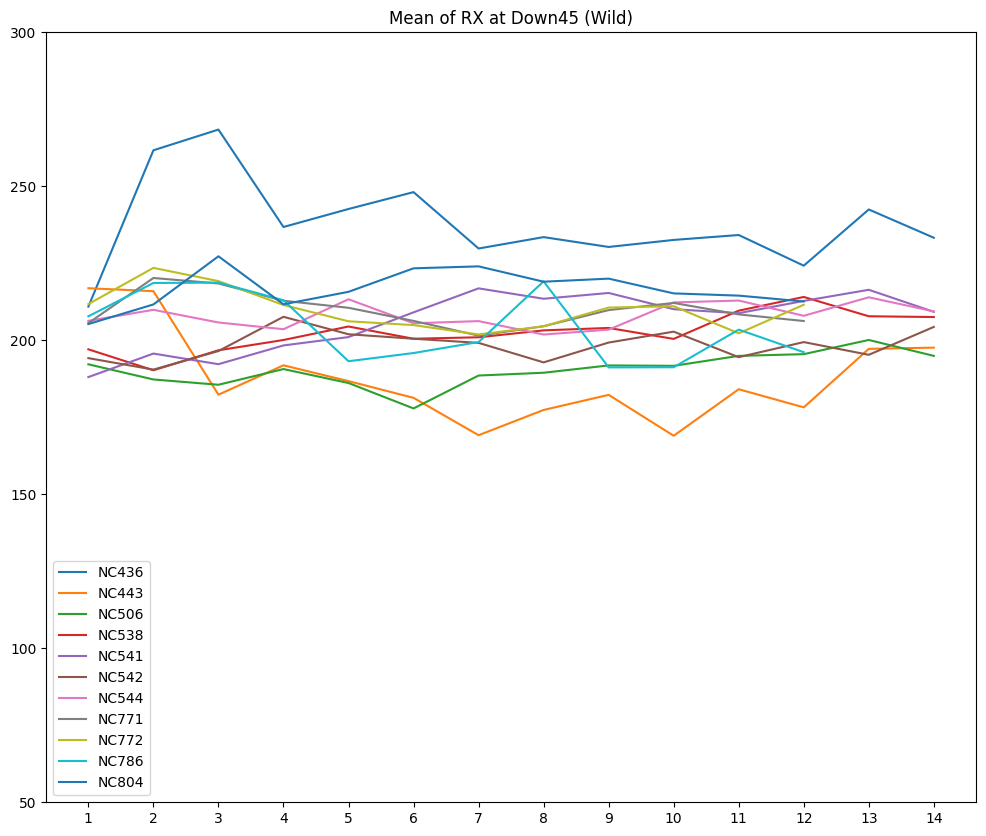

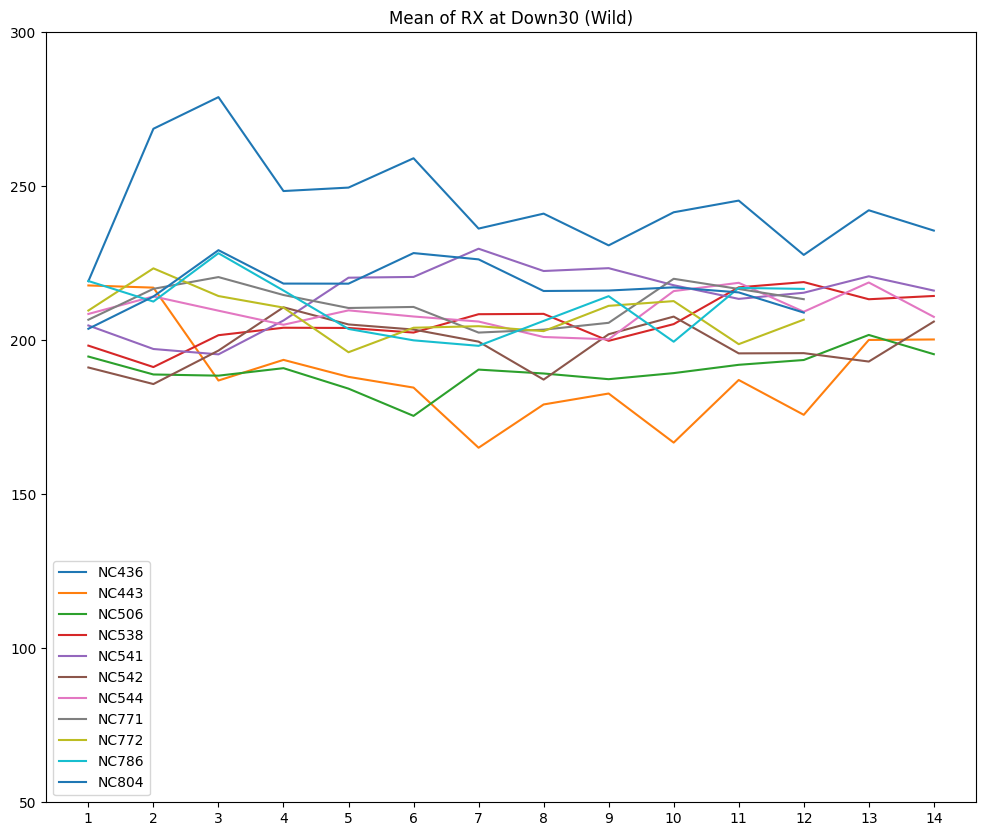

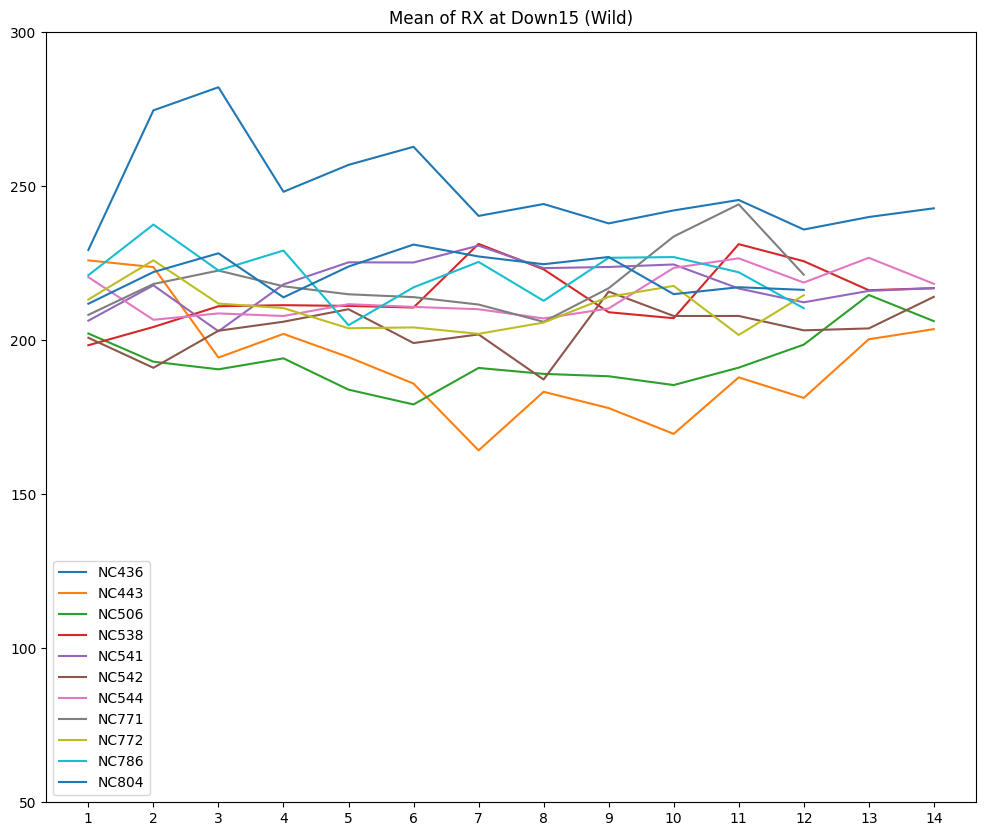

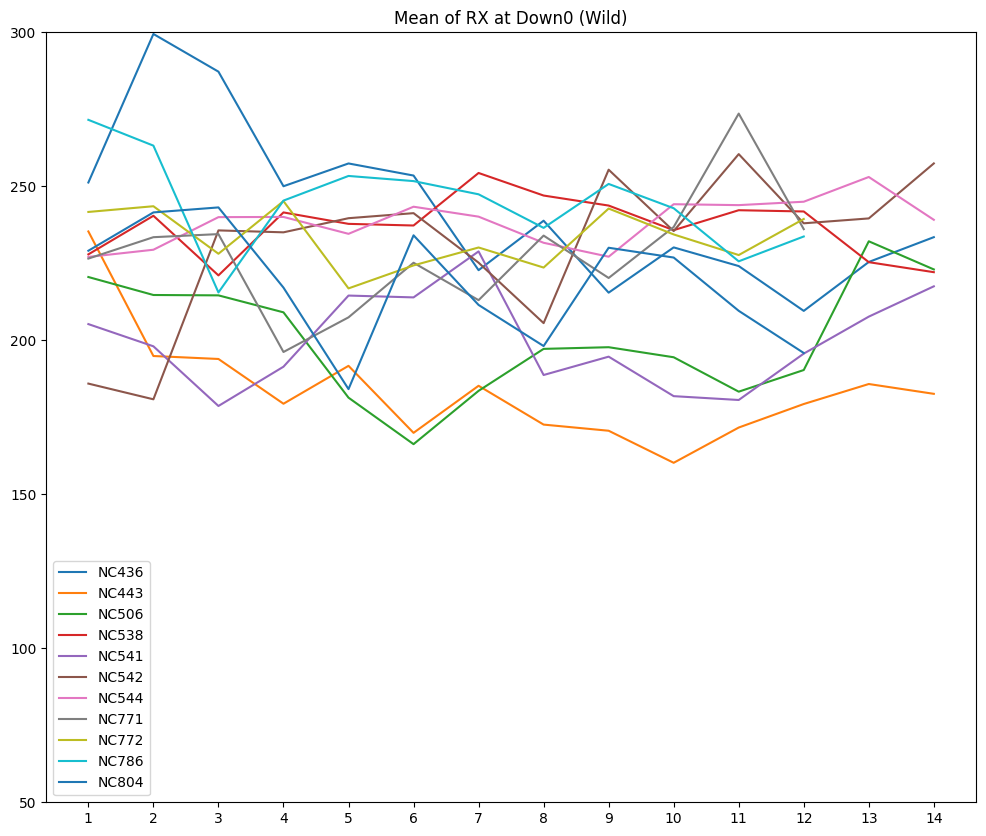

In [ ]:
# 13: down_RX_mean_list

for i in range(len(down_speed_list)):
  df = generate_df_list(wild, 13, down_speed_list[i])
  plotline(df, wild_labels, days, 'Mean', 'RX', down_title_list[i], 'Wild')

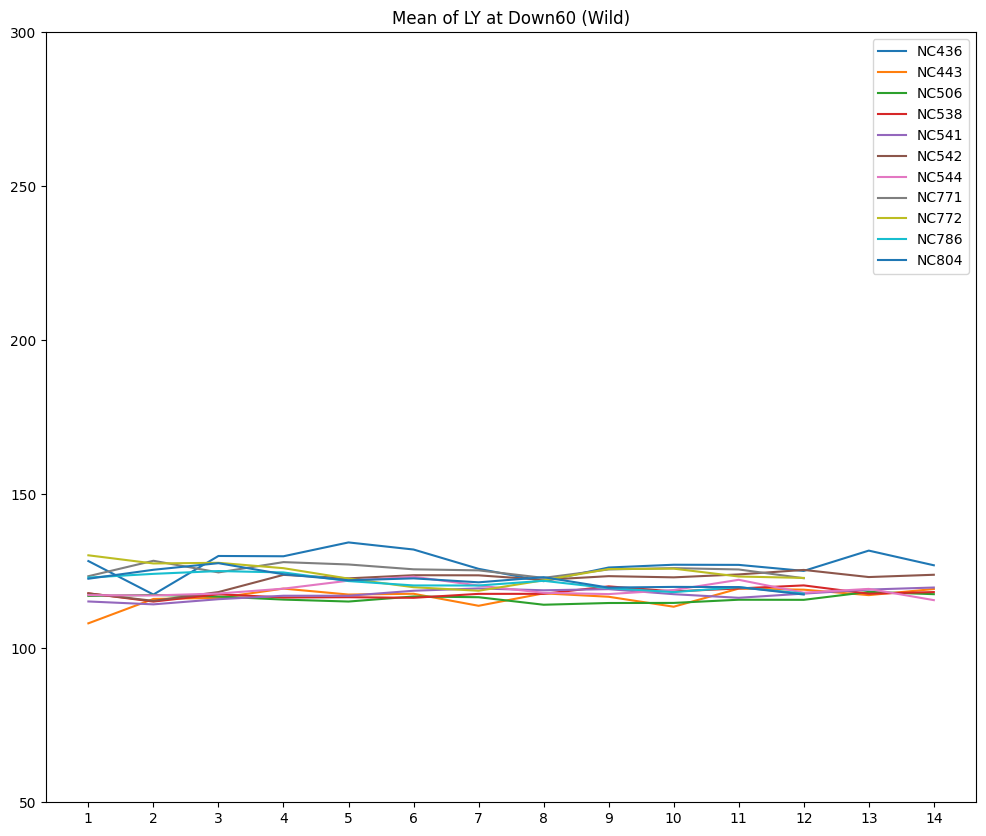

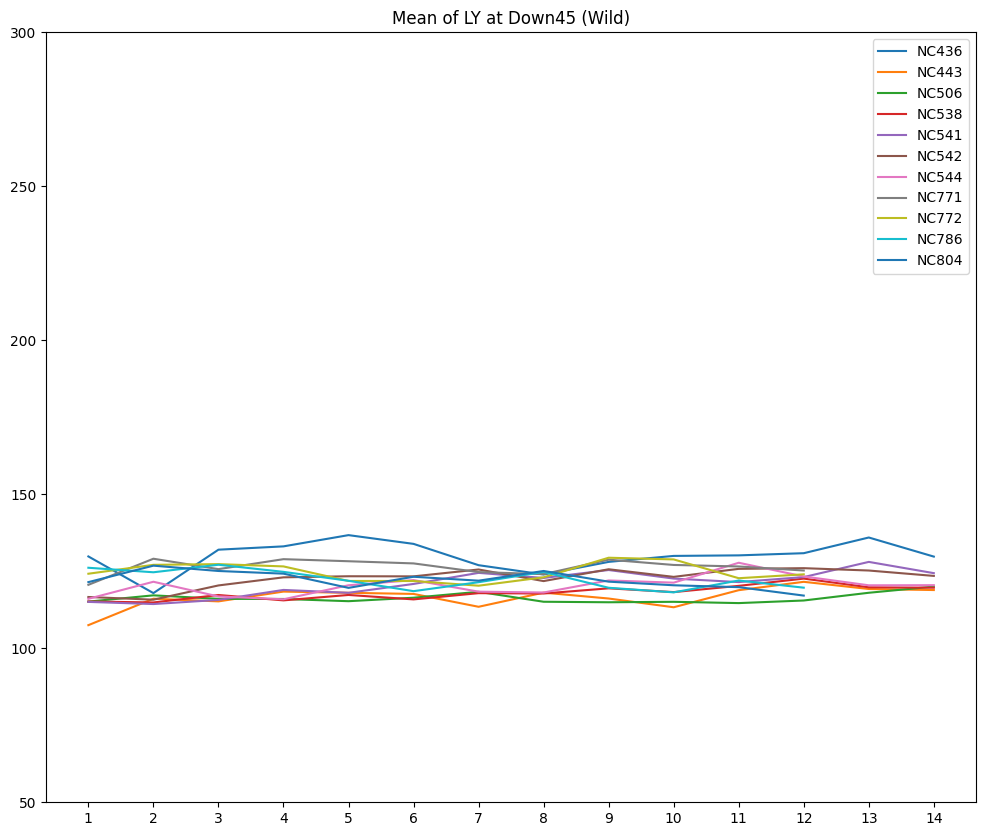

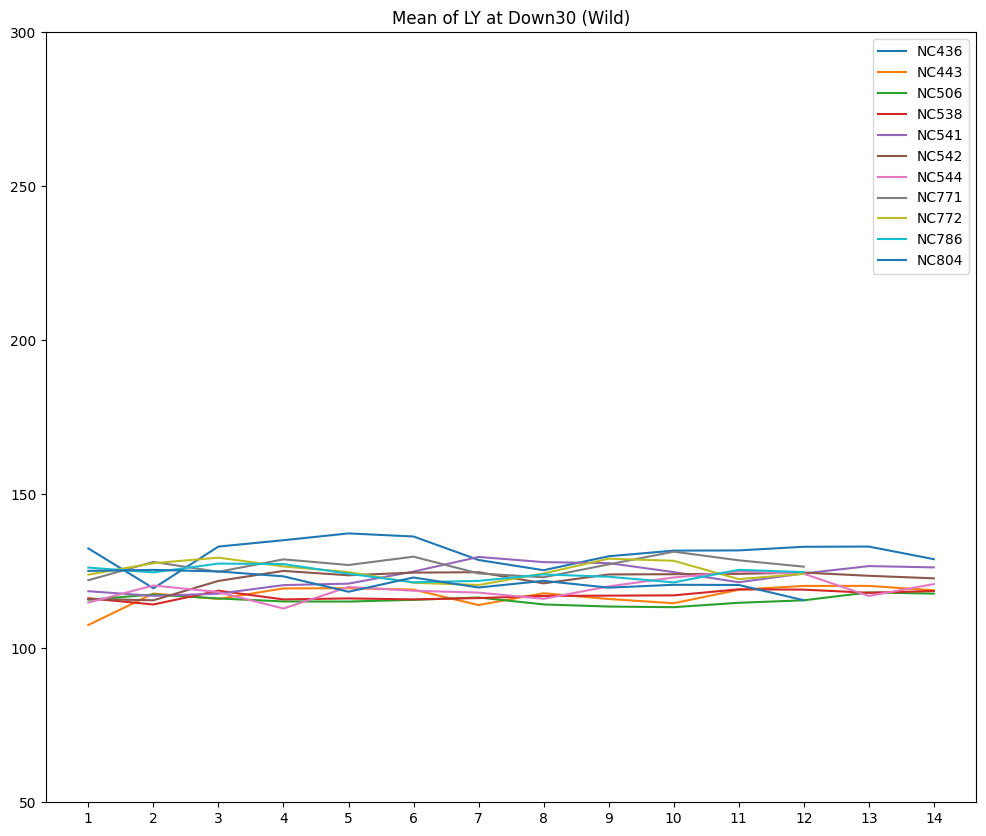

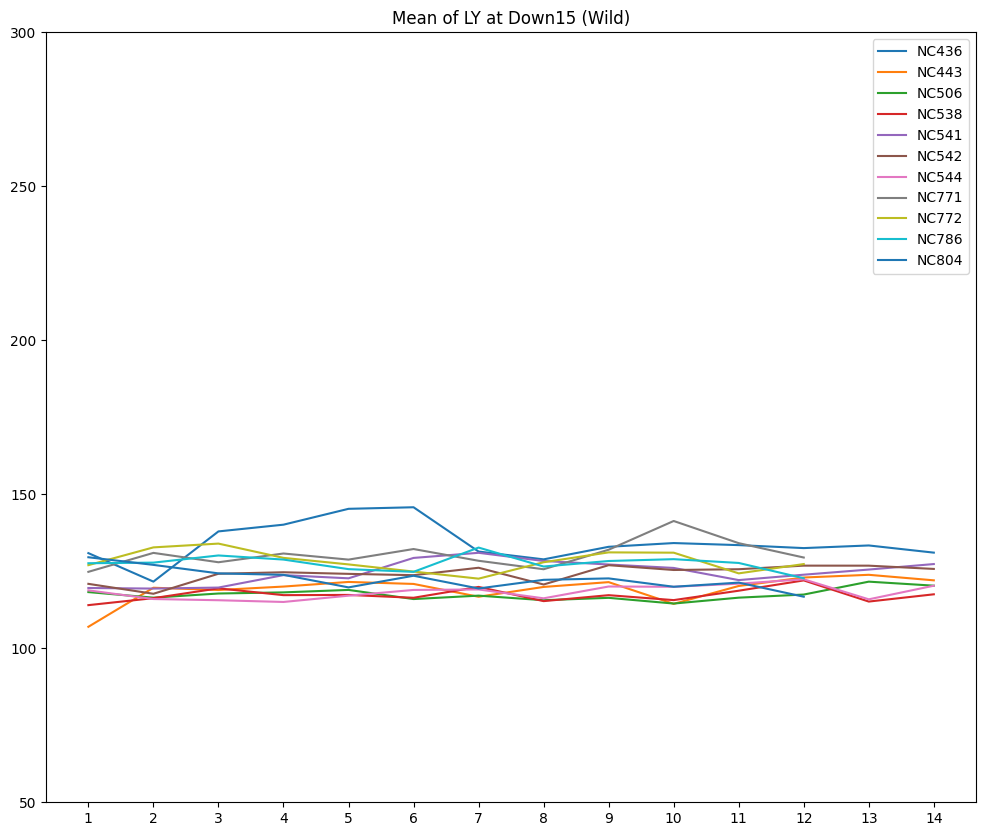

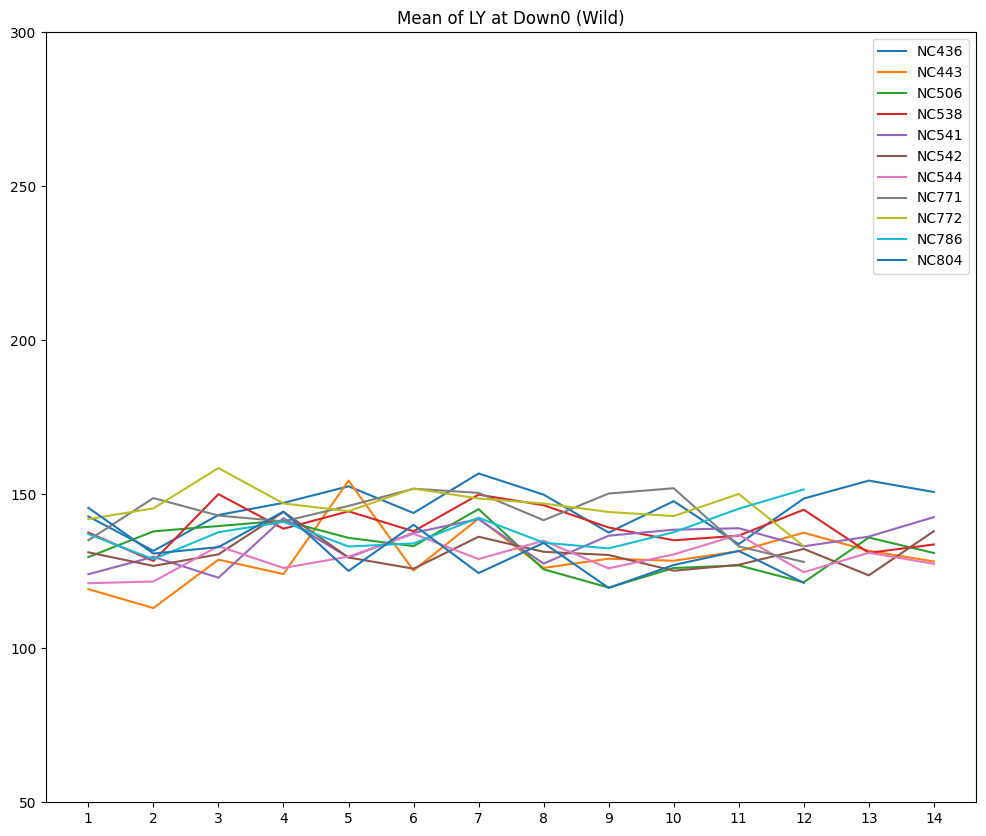

In [ ]:
# 14: down_LY_mean_list 

for i in range(len(down_speed_list)):
  df = generate_df_list(wild, 14, down_speed_list[i])
  plotline(df, wild_labels, days, 'Mean', 'LY', down_title_list[i], 'Wild')

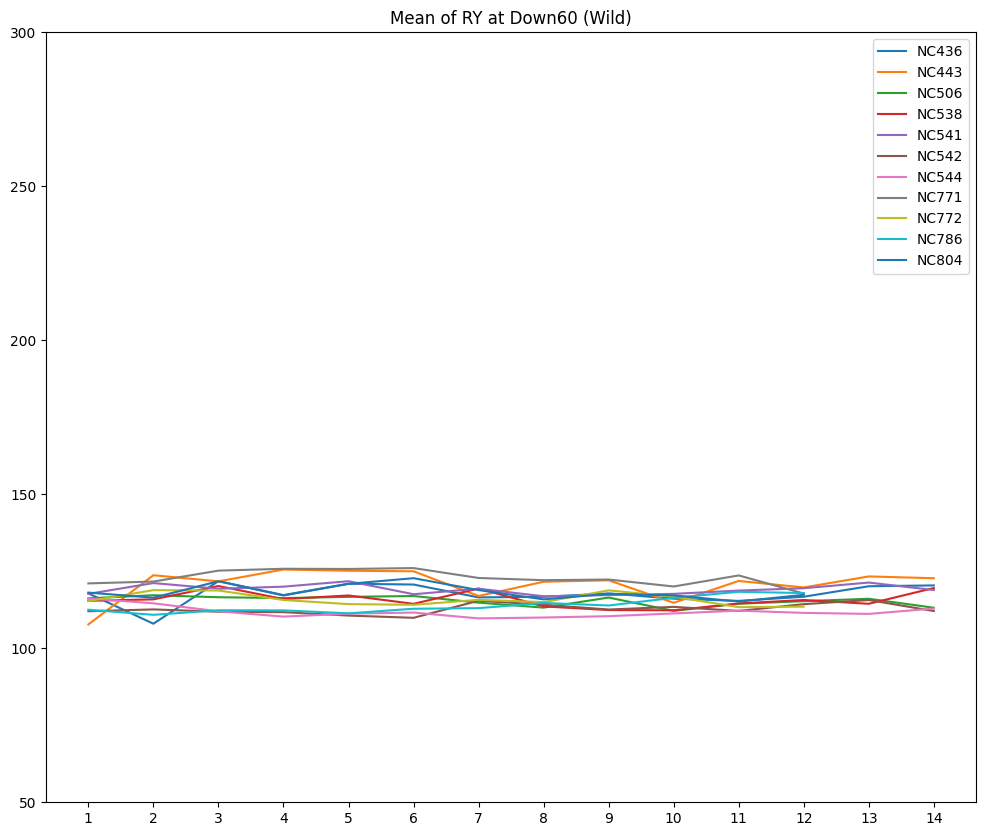

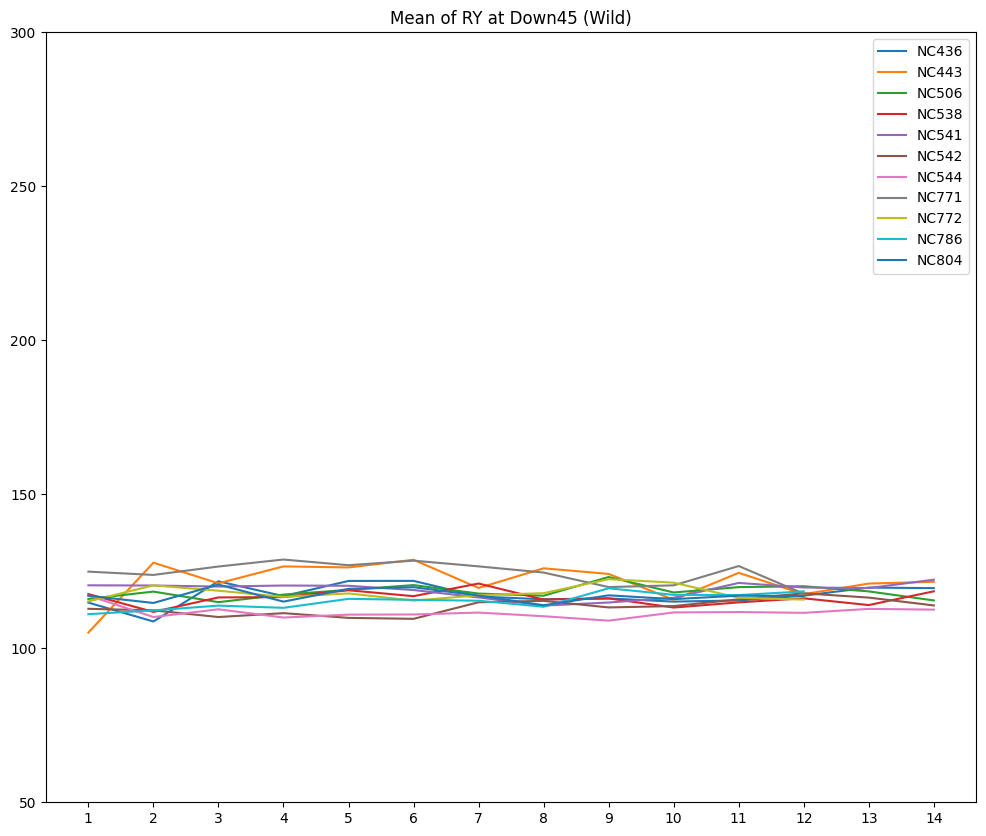

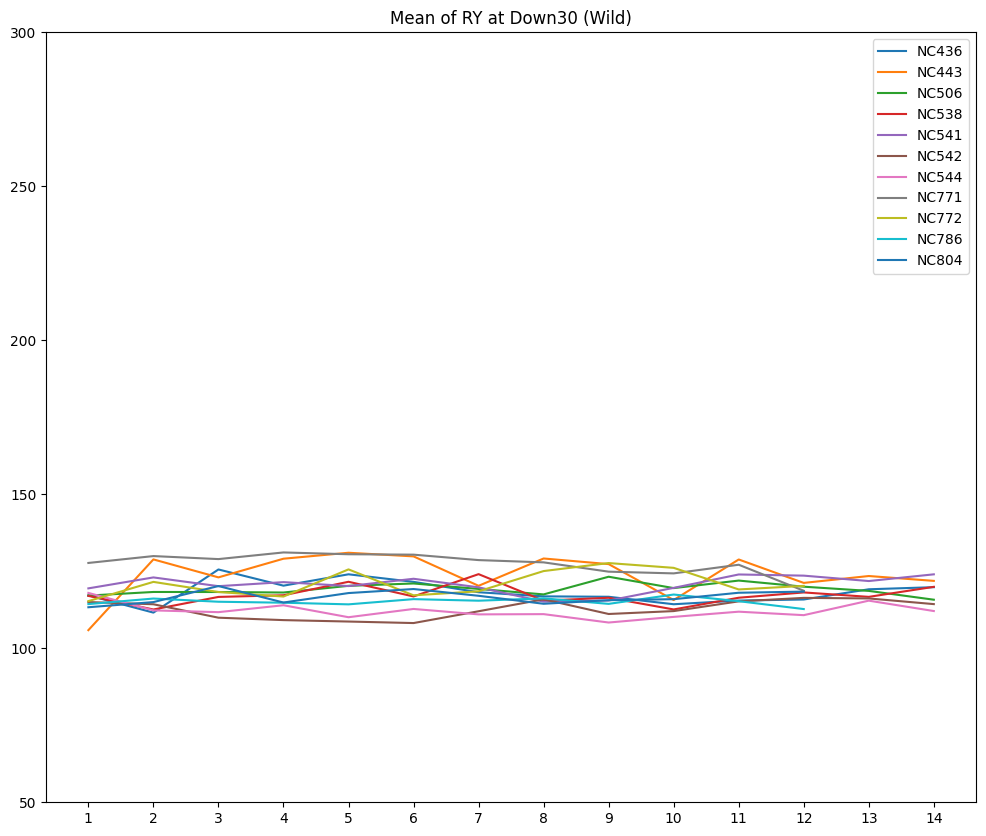

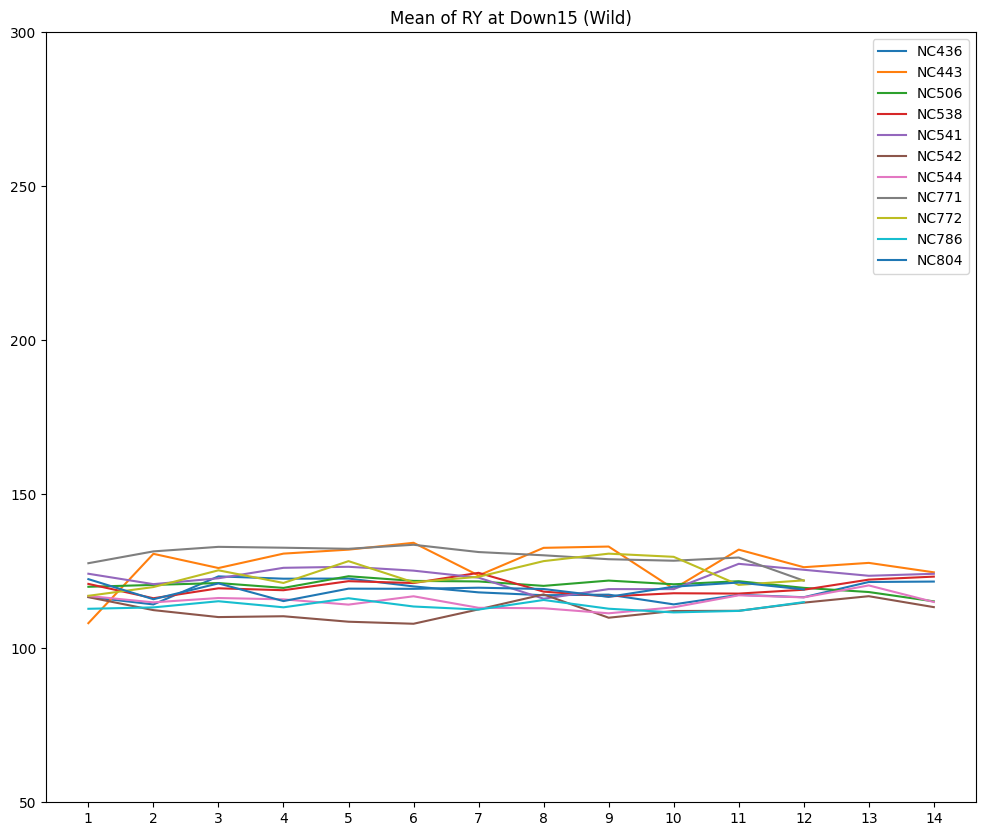

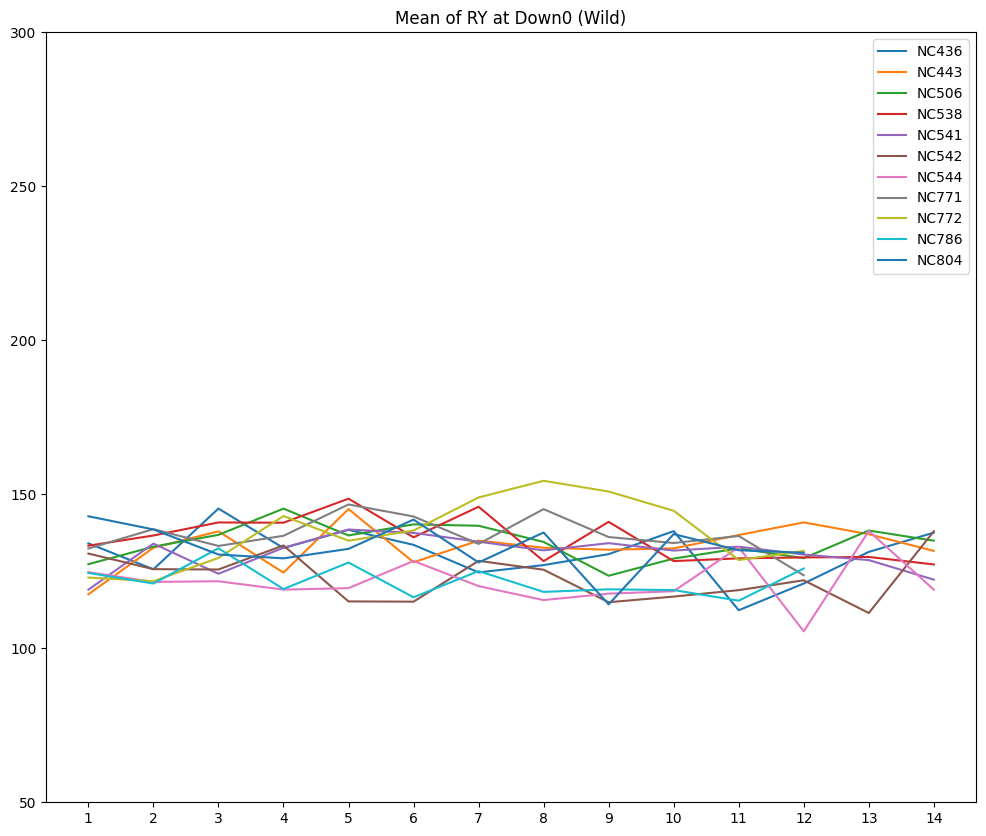

In [ ]:
# 15: down_RY_mean_list

for i in range(len(down_speed_list)):
  df = generate_df_list(wild, 15, down_speed_list[i])
  plotline(df, wild_labels, days, 'Mean', 'RY', down_title_list[i], 'Wild')

## Rett Mean

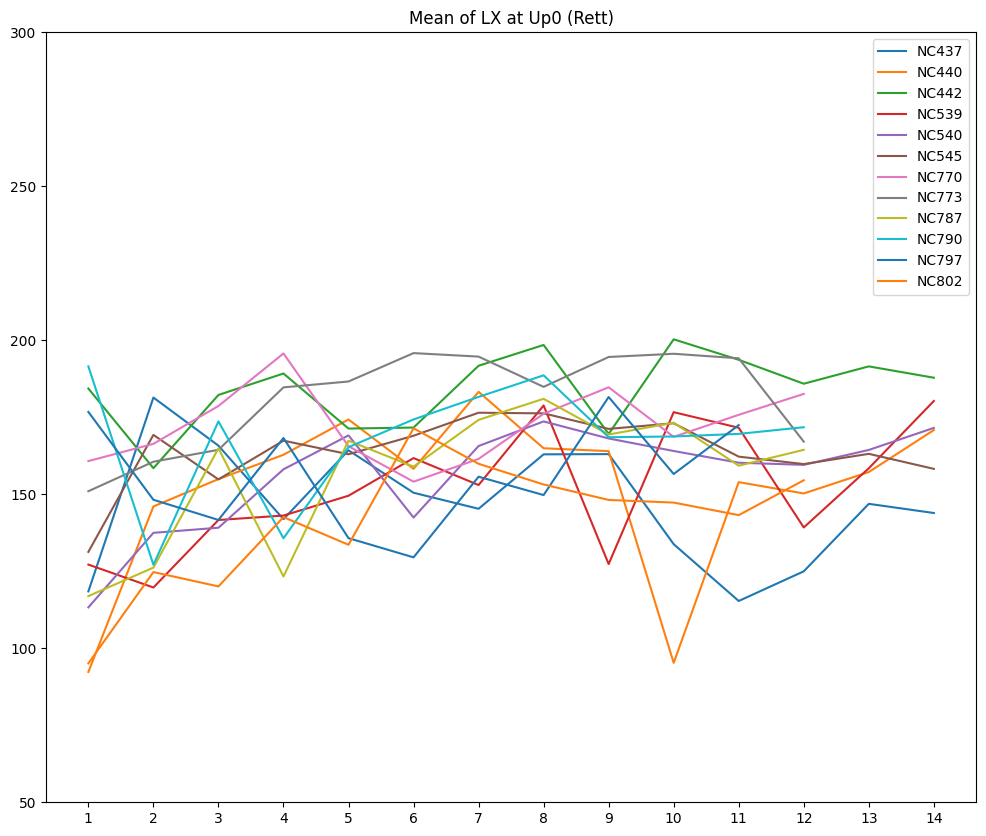

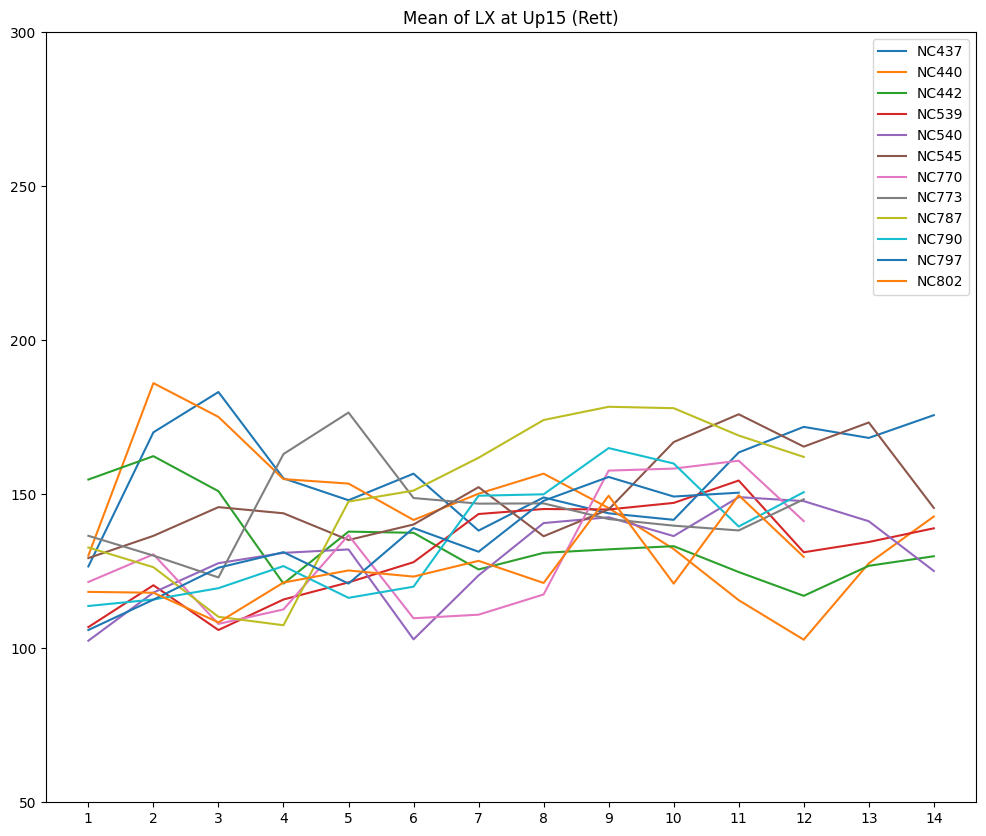

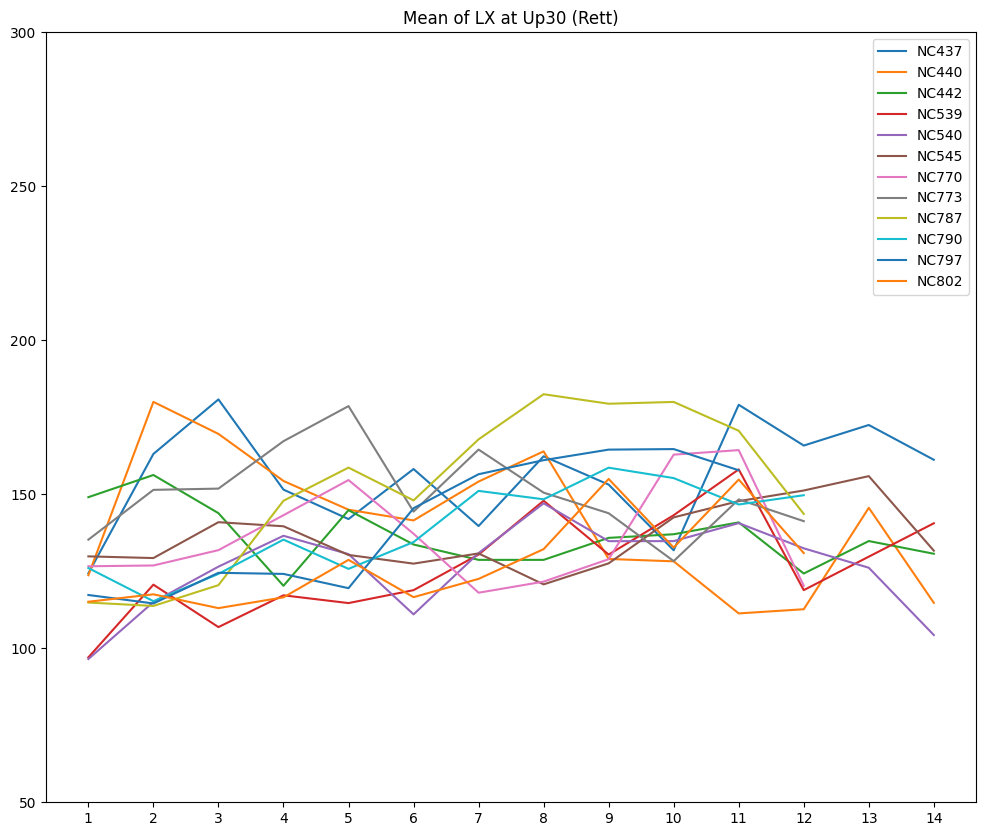

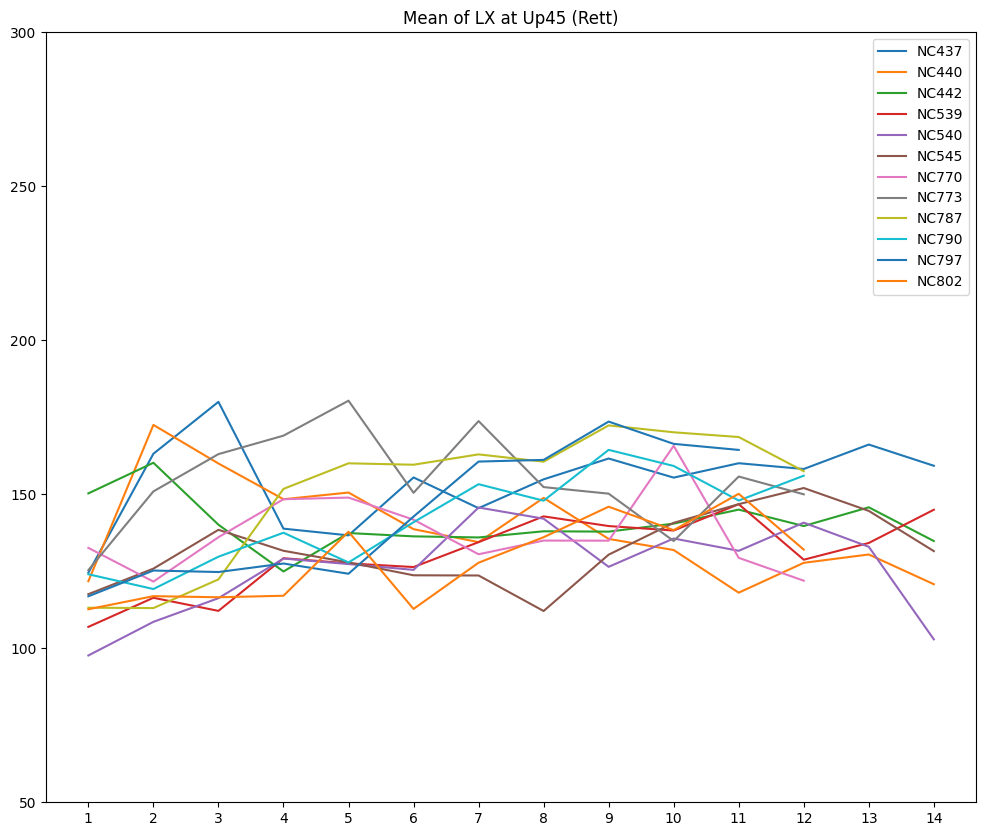

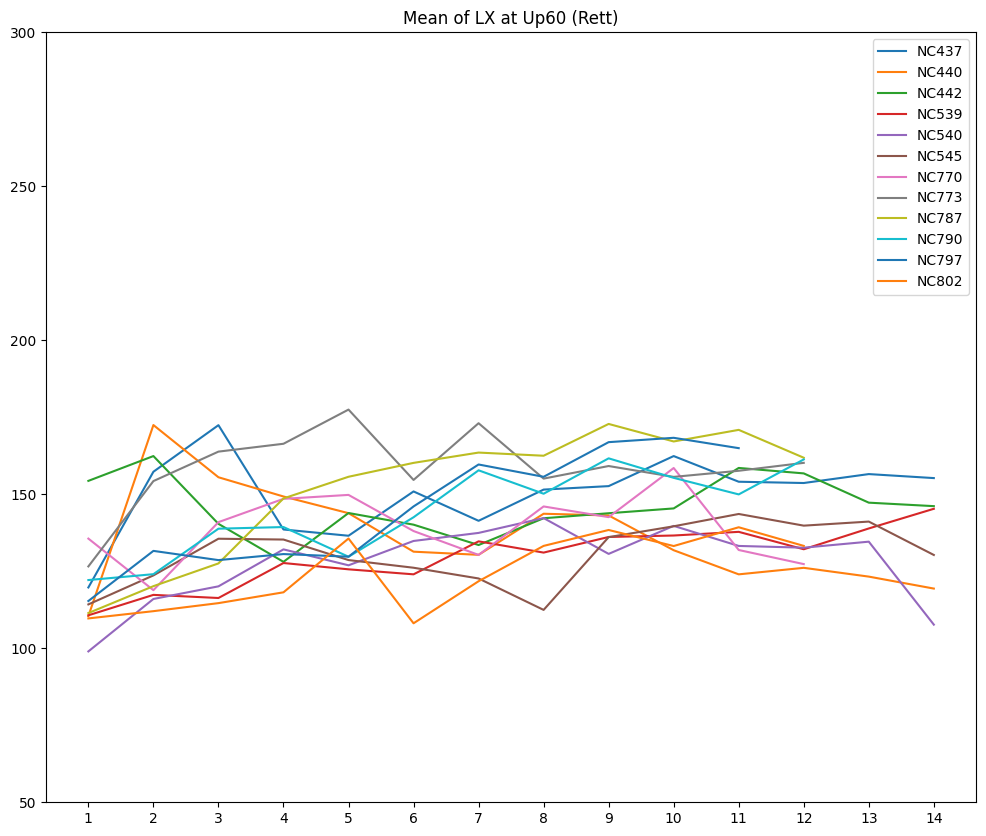

In [ ]:
# 8: up_LX_mean_list

for i in range(len(up_speed_list)):
  df = generate_df_list(rett, 8, up_speed_list[i])
  plotline(df, rett_labels, days, 'Mean', 'LX', up_title_list[i], 'Rett')

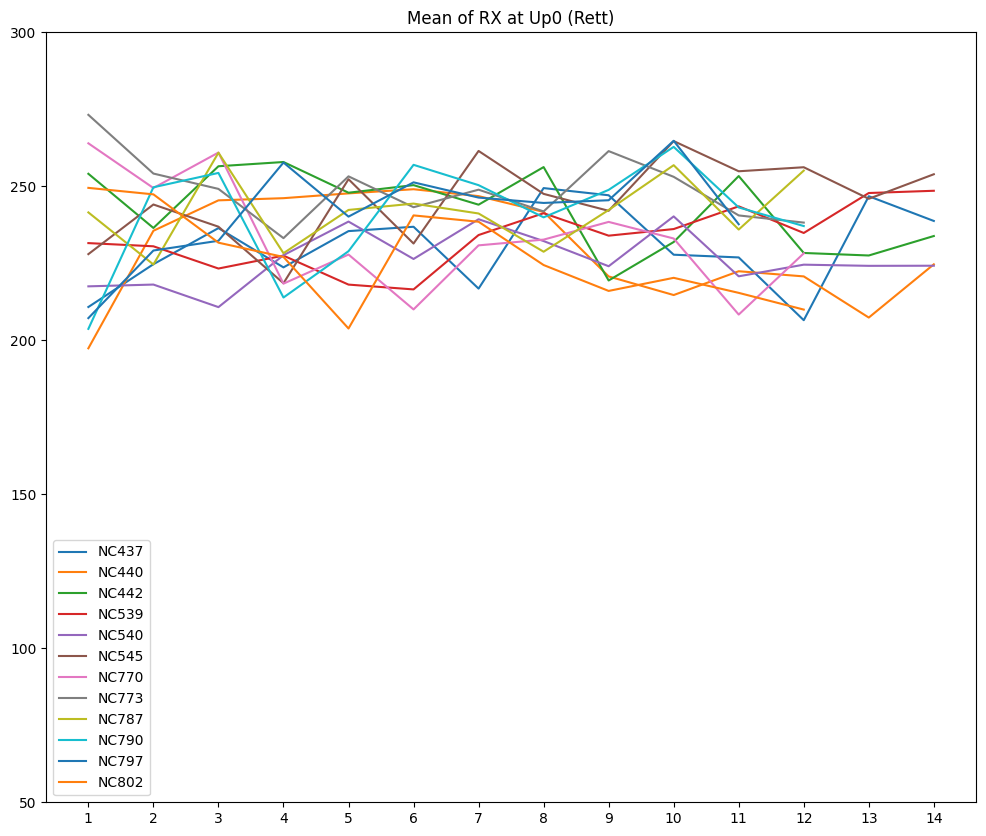

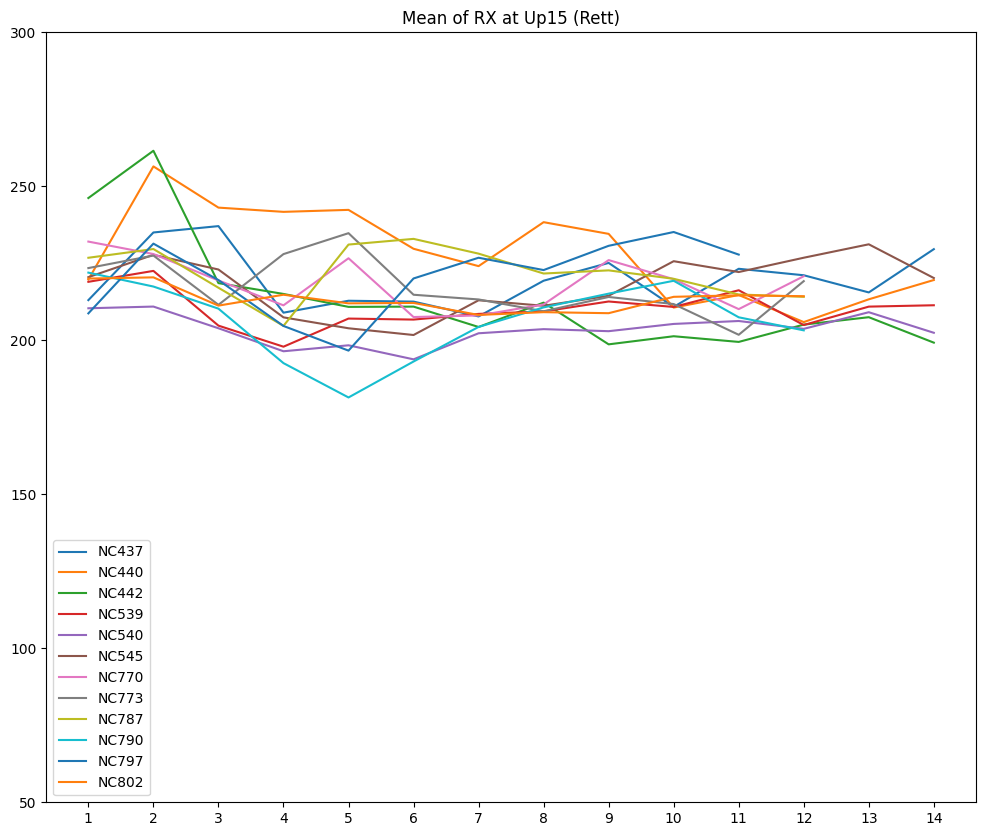

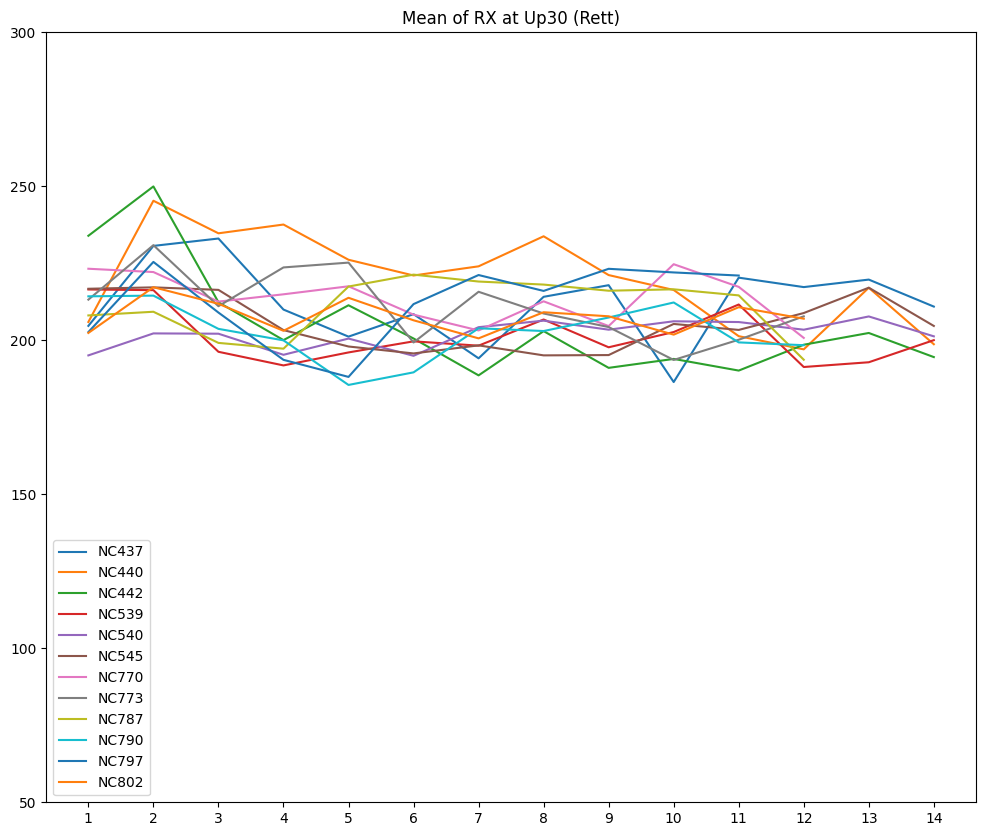

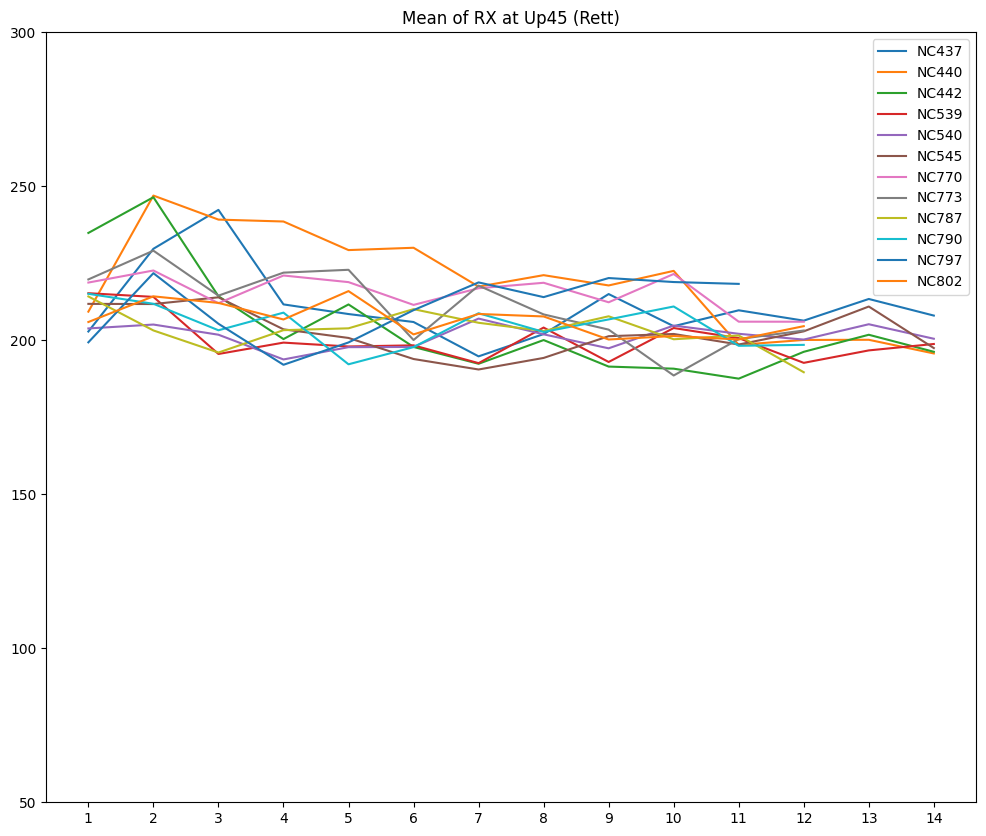

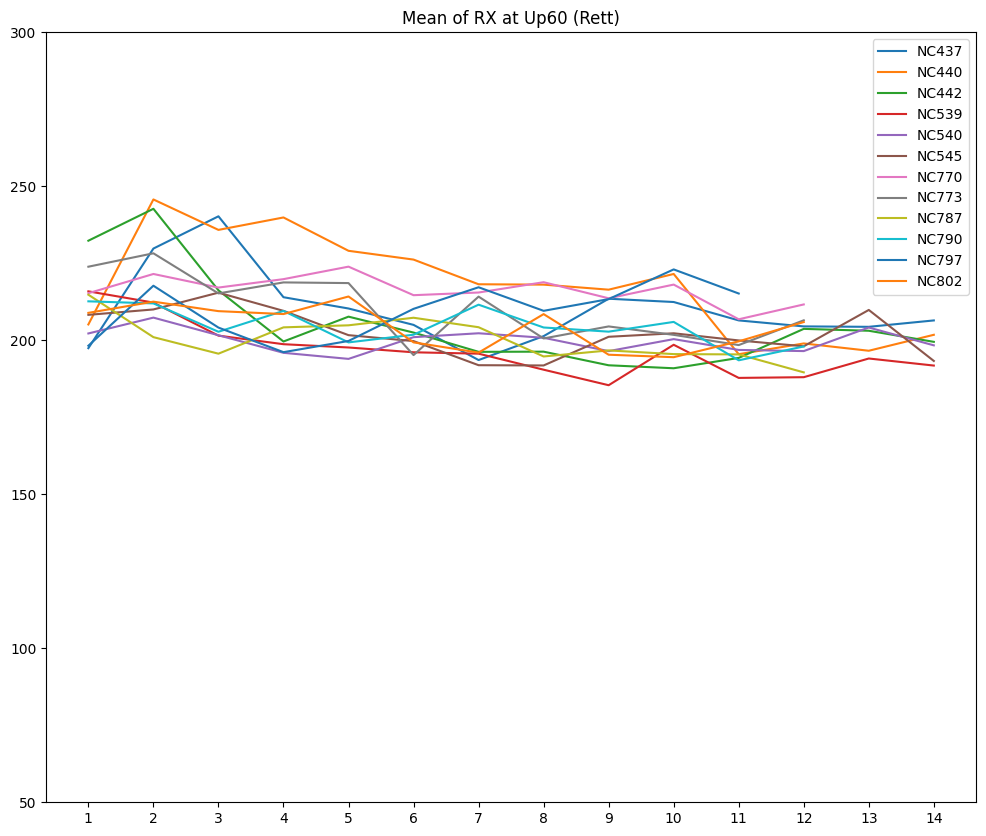

In [ ]:
# 9: up_RX_mean_list

for i in range(len(up_speed_list)):
  df = generate_df_list(rett, 9, up_speed_list[i])
  plotline(df, rett_labels, days, 'Mean', 'RX', up_title_list[i], 'Rett')

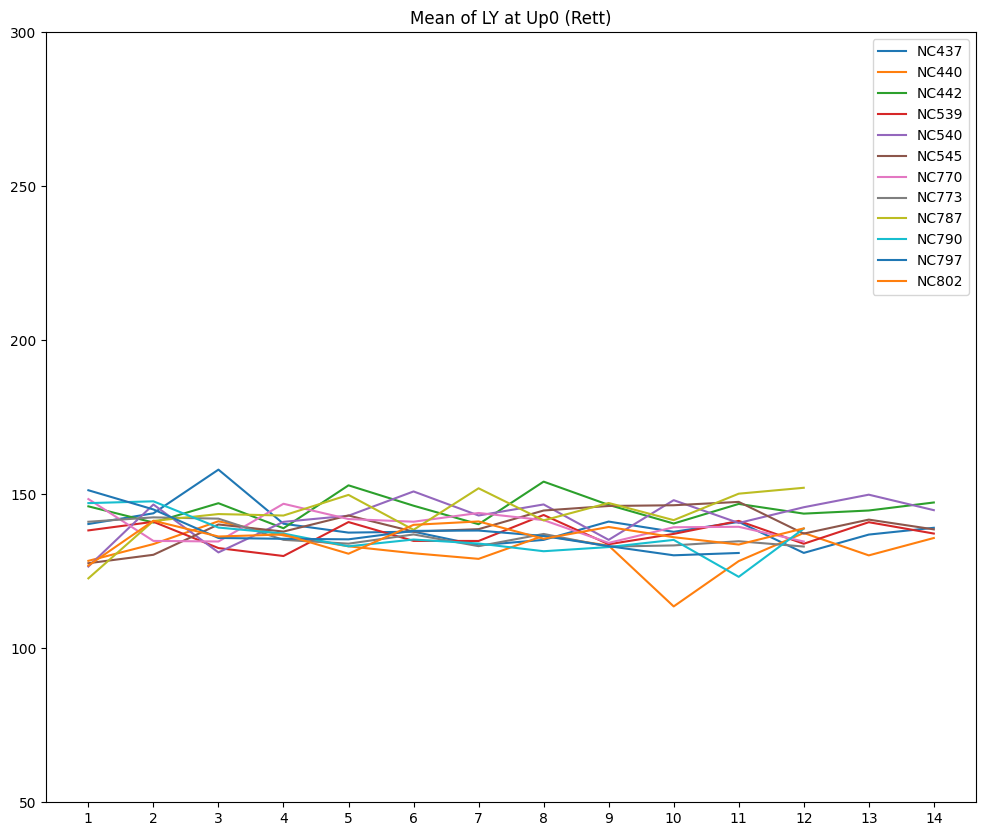

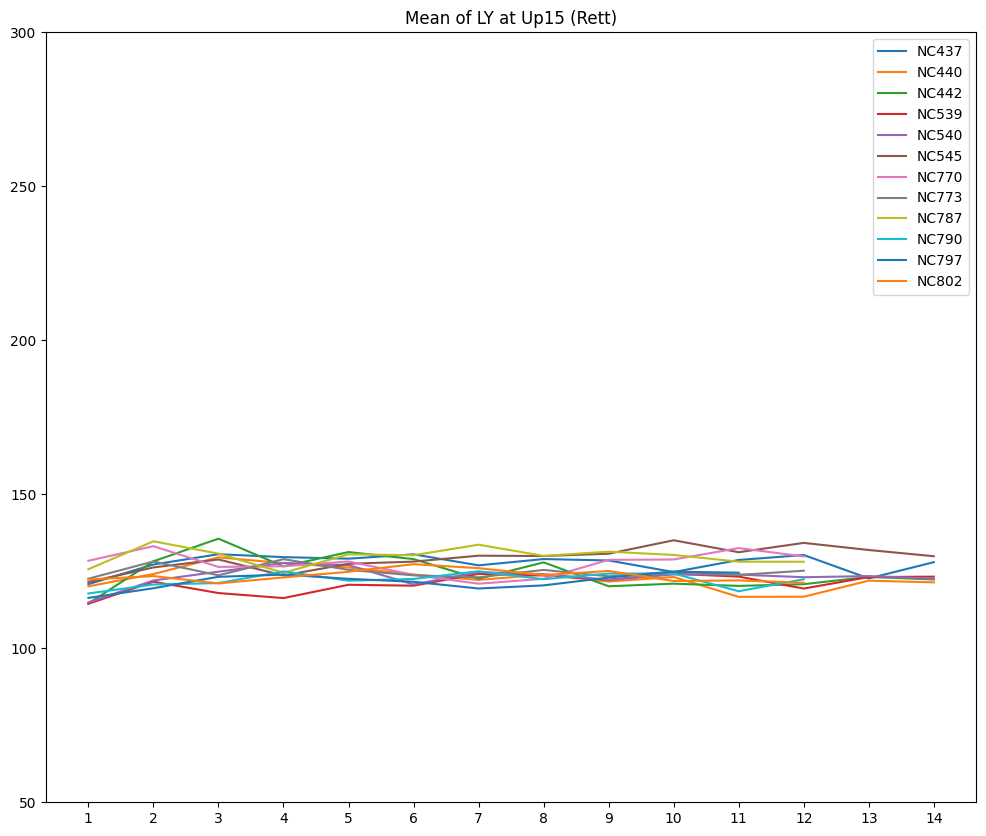

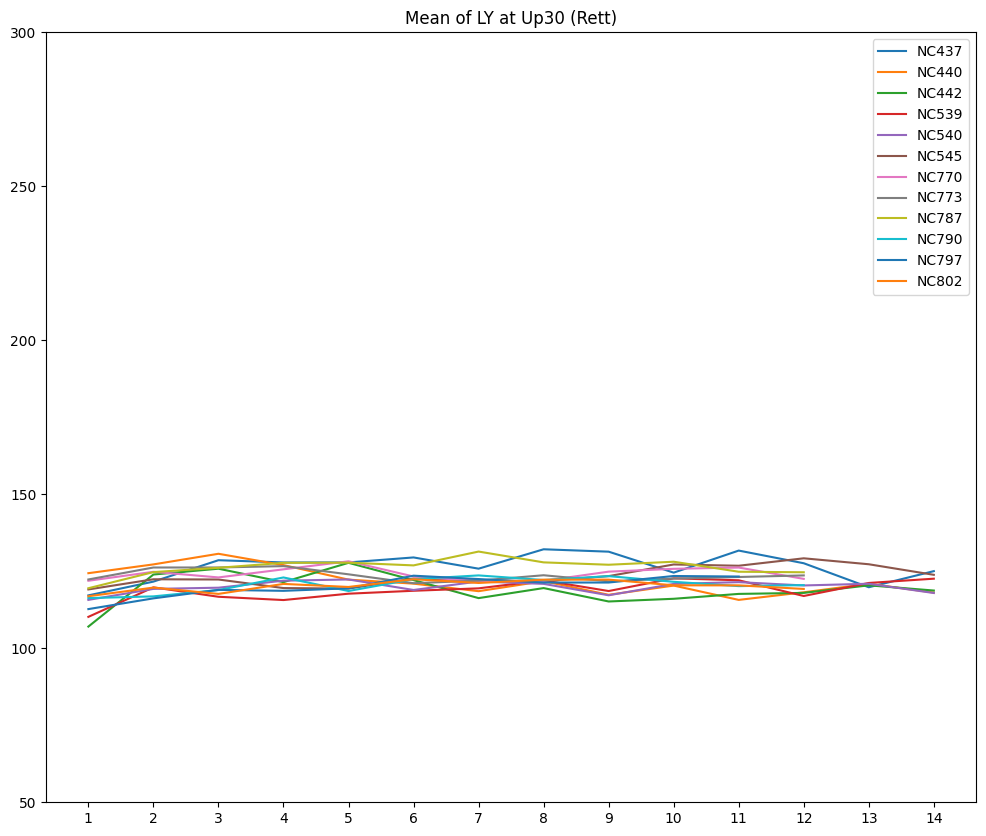

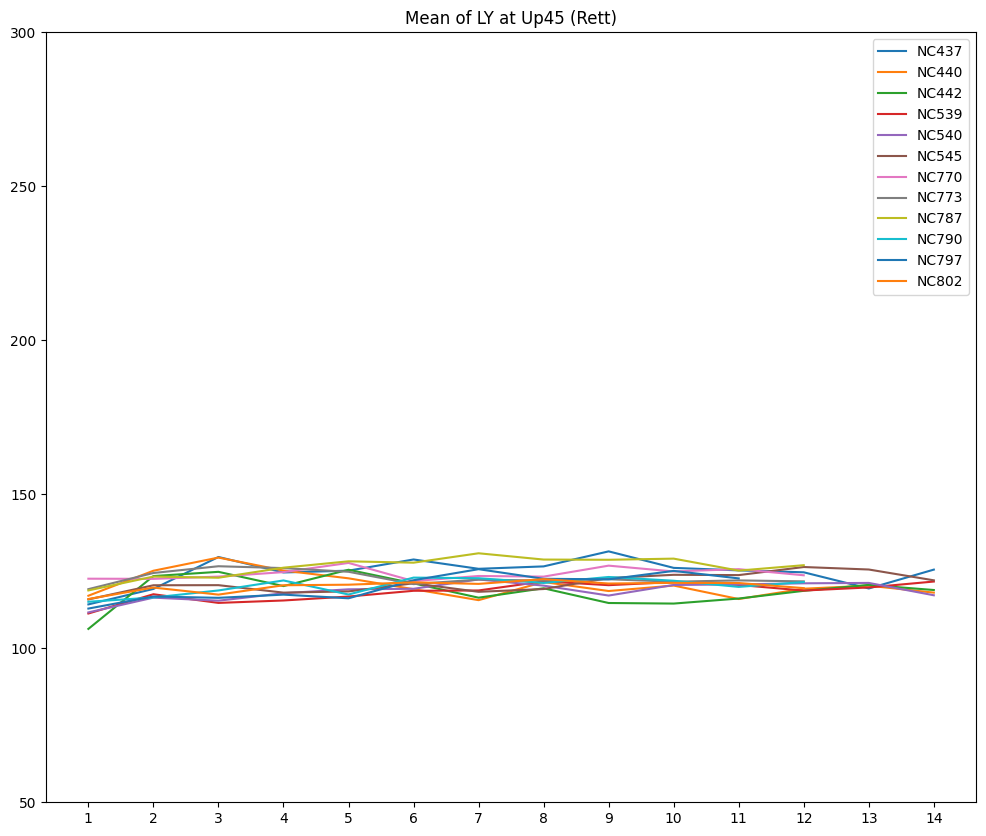

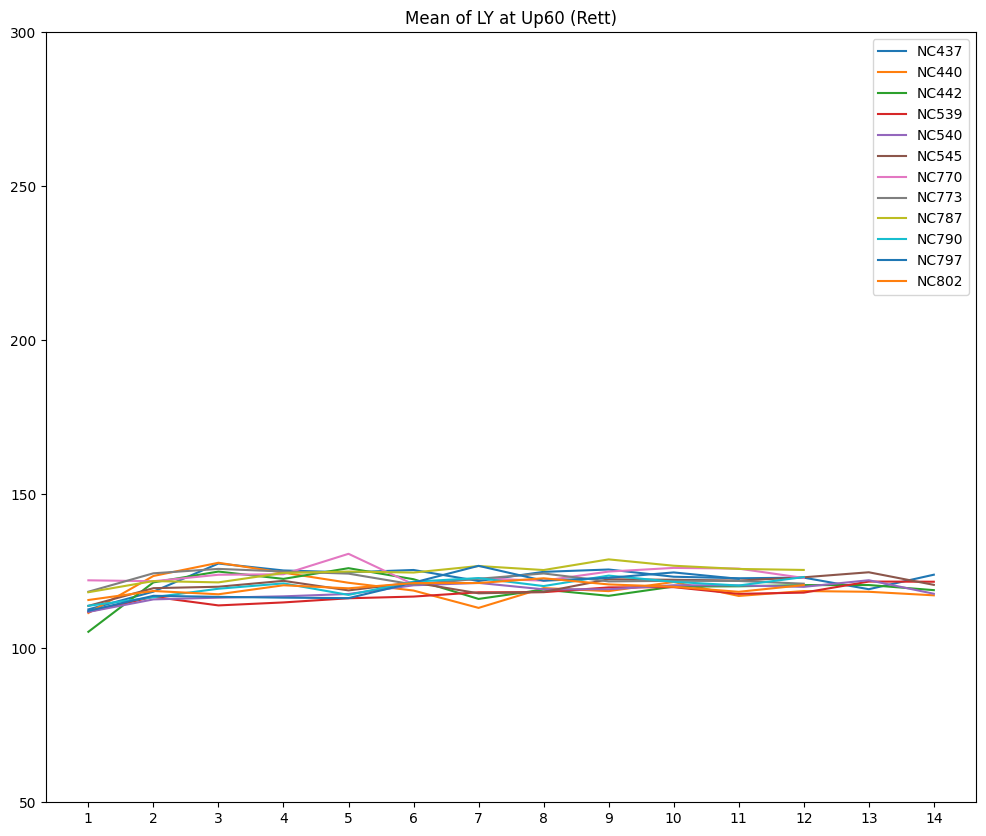

In [ ]:
# 10: up_LY_mean_list

for i in range(len(up_speed_list)):
  df = generate_df_list(rett, 10, up_speed_list[i])
  plotline(df, rett_labels, days, 'Mean', 'LY', up_title_list[i], 'Rett')

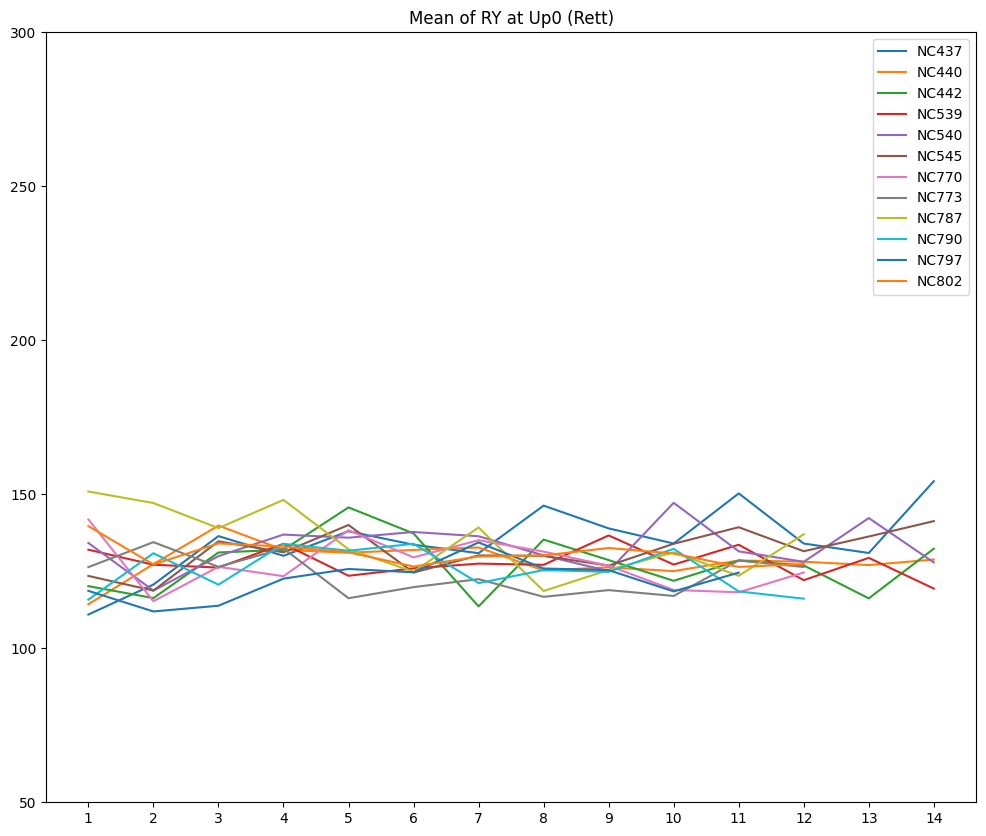

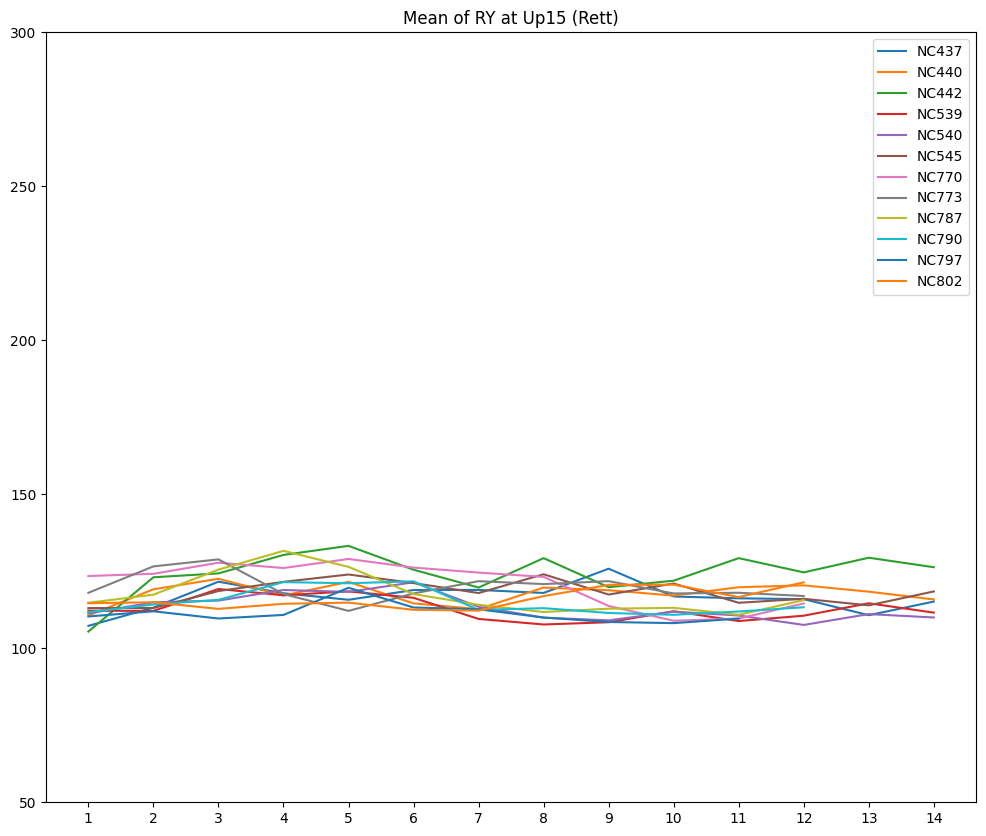

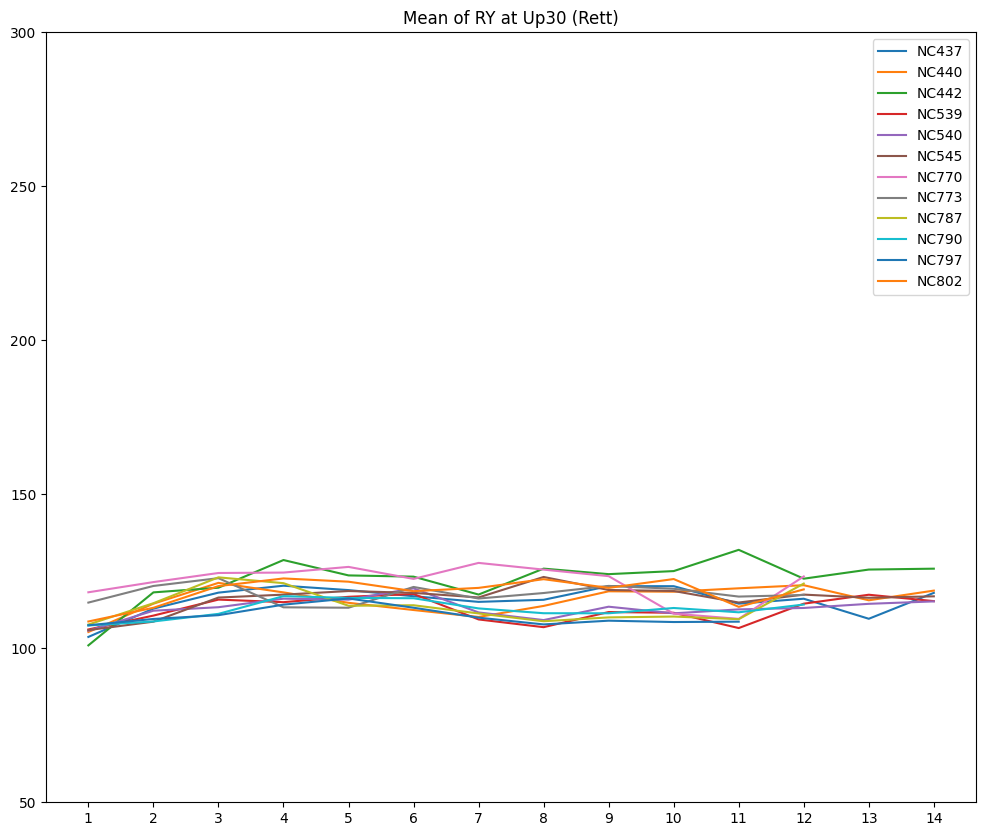

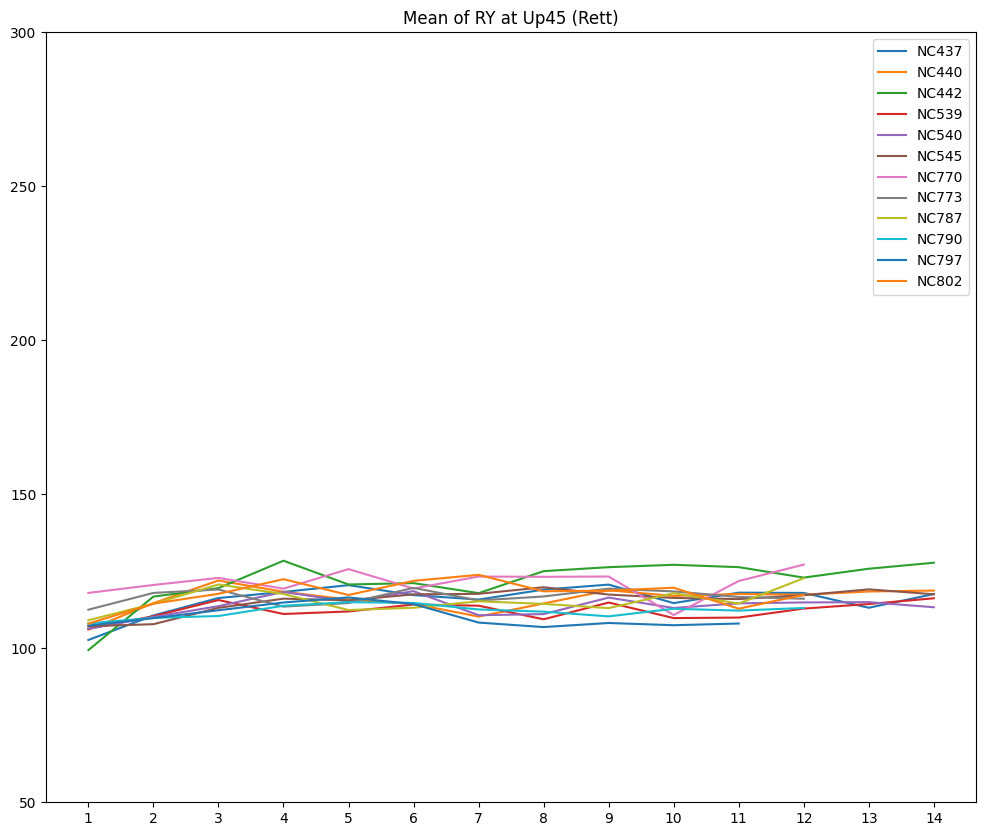

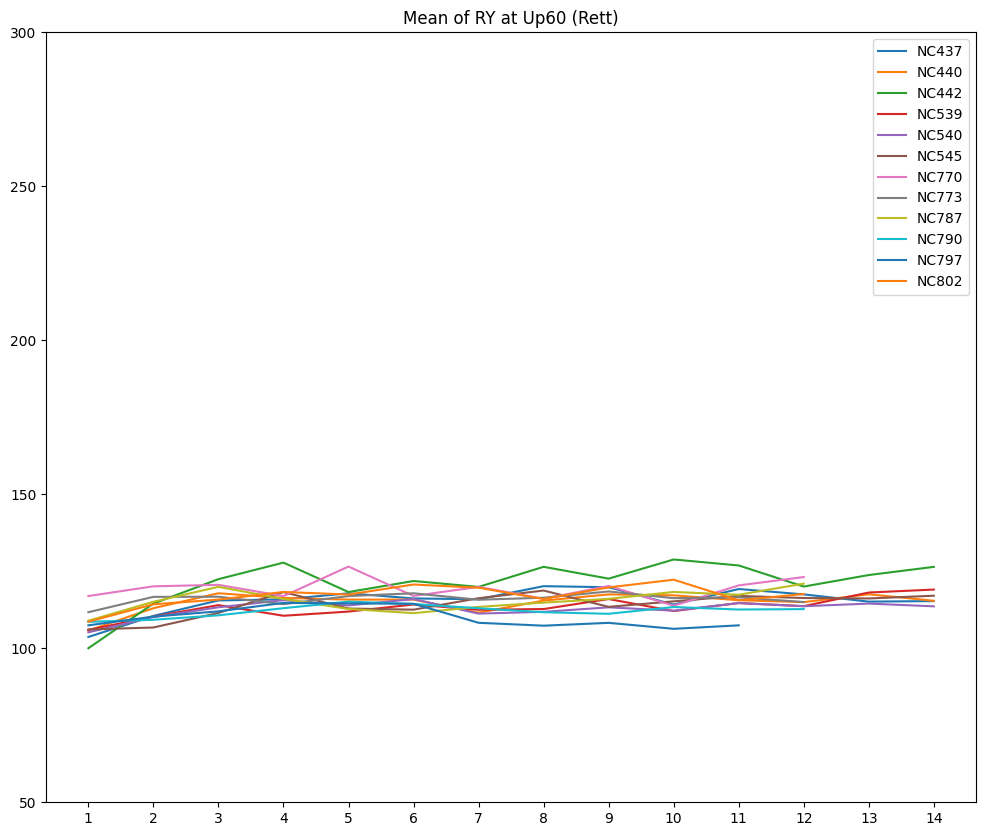

In [ ]:
# 11: up_RY_mean_list

for i in range(len(up_speed_list)):
  df = generate_df_list(rett, 11, up_speed_list[i])
  plotline(df, rett_labels, days, 'Mean', 'RY', up_title_list[i], 'Rett')

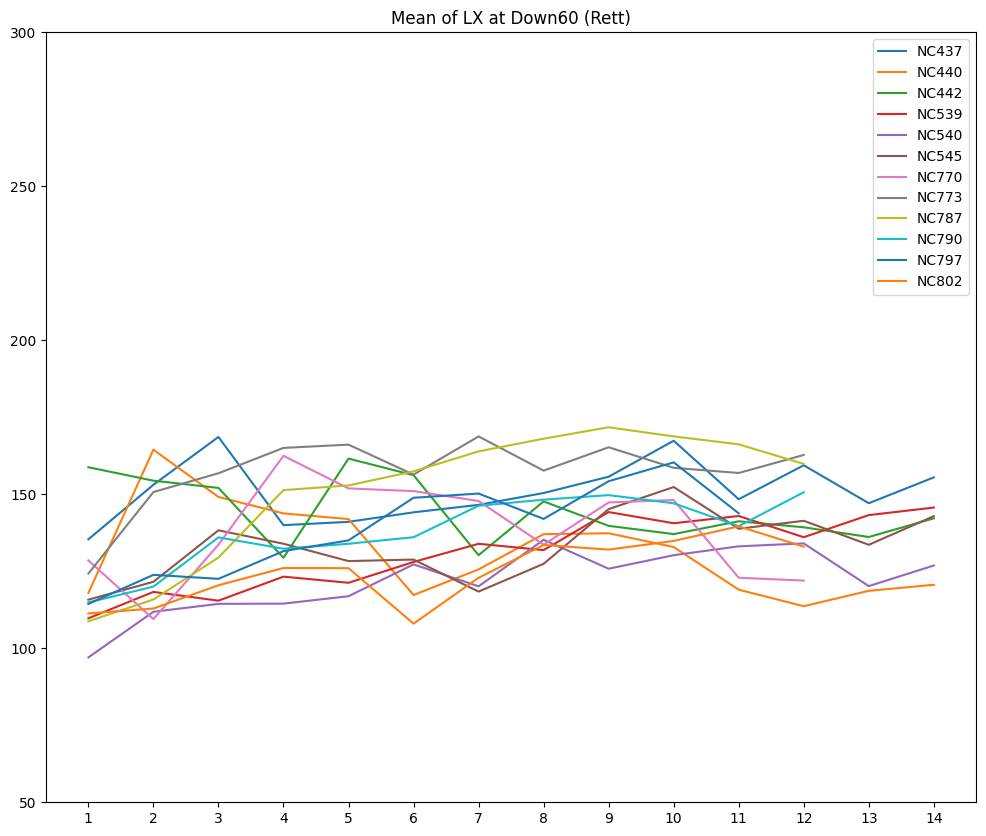

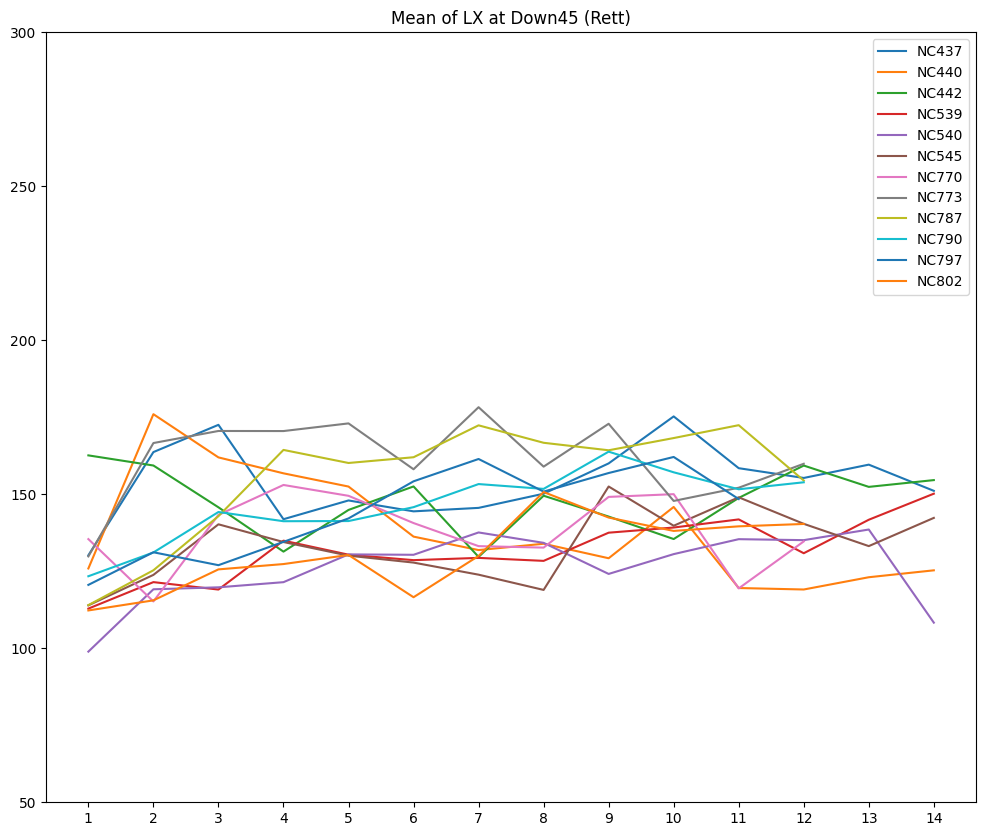

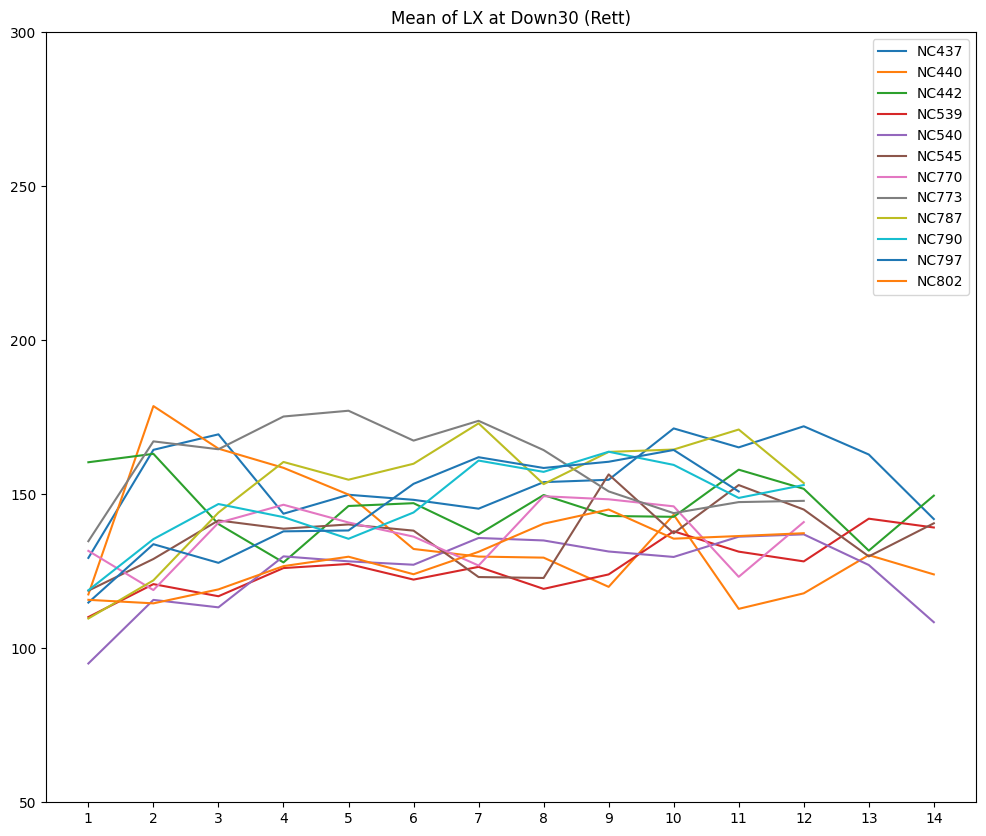

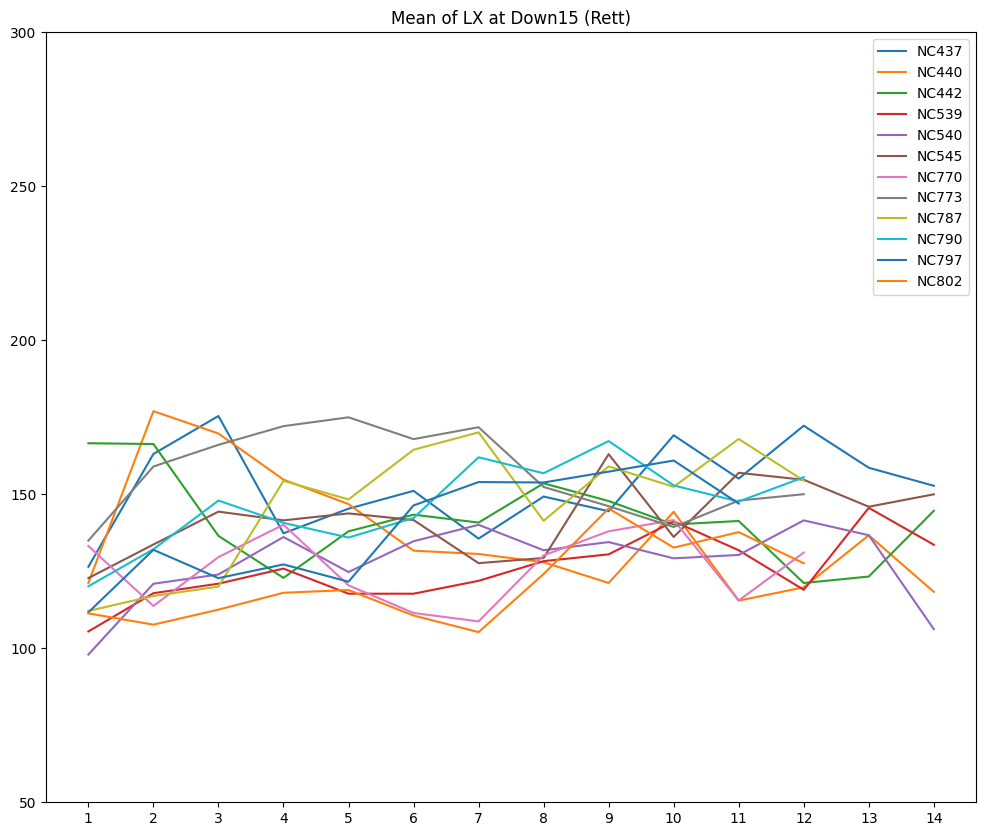

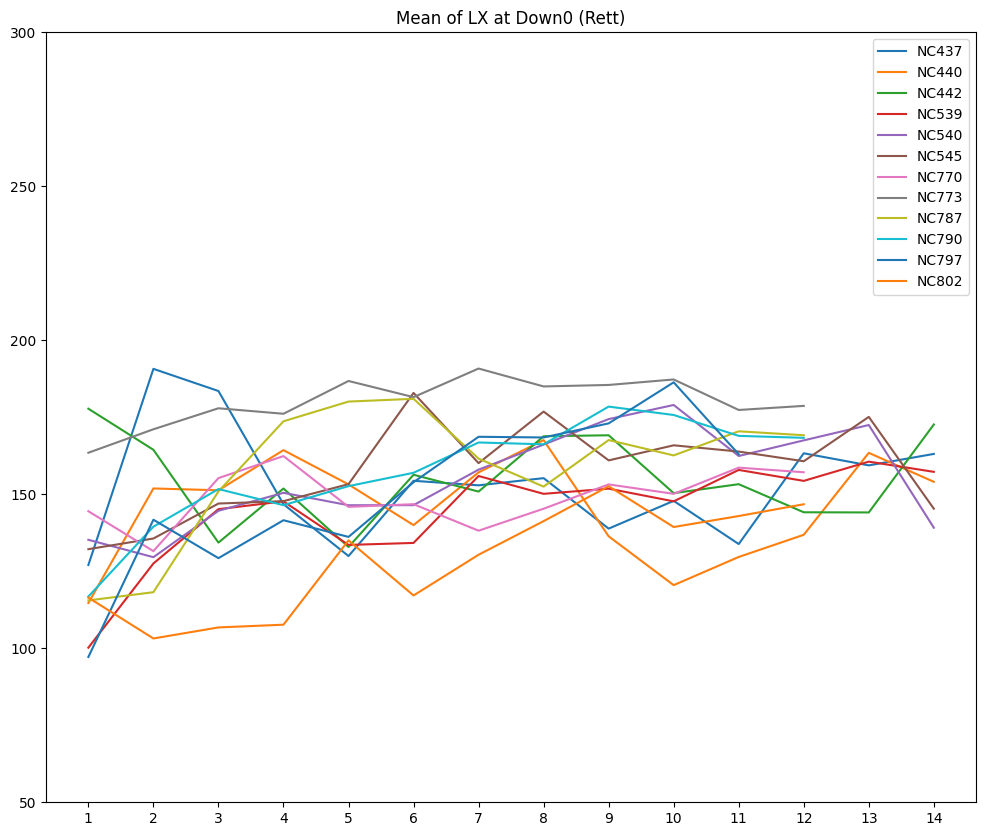

In [ ]:
# 12: down_LX_mean_list

for i in range(len(down_speed_list)):
  df = generate_df_list(rett, 12, down_speed_list[i])
  plotline(df, rett_labels, days, 'Mean', 'LX', down_title_list[i], 'Rett')

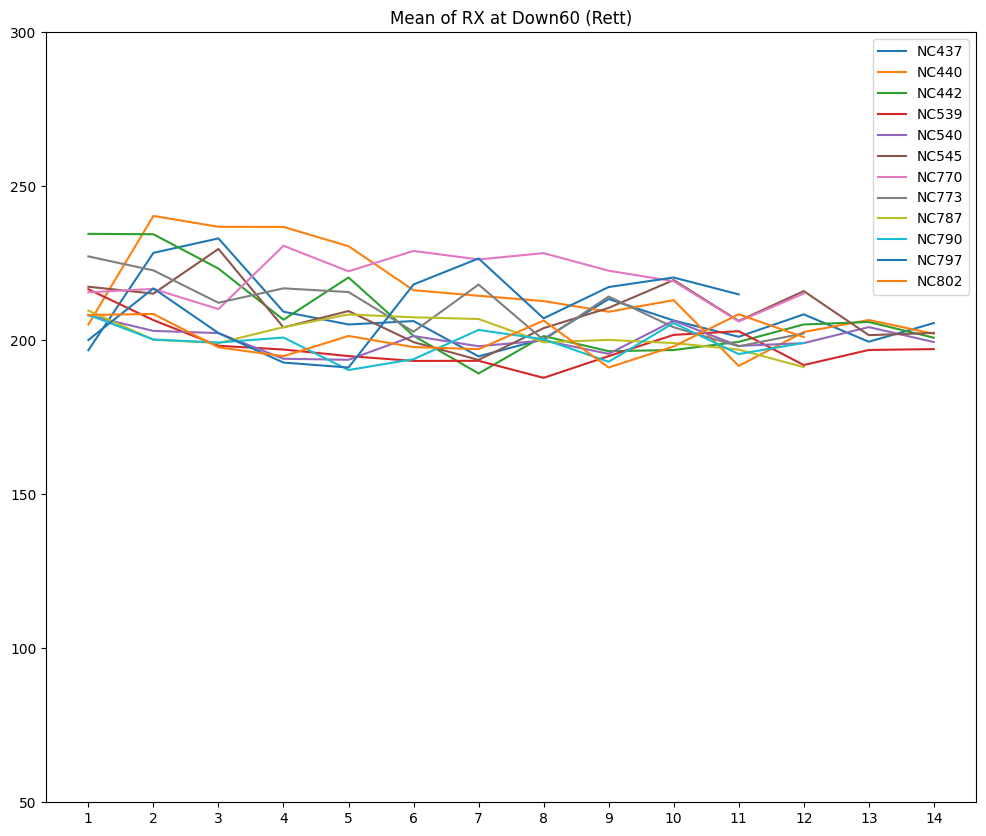

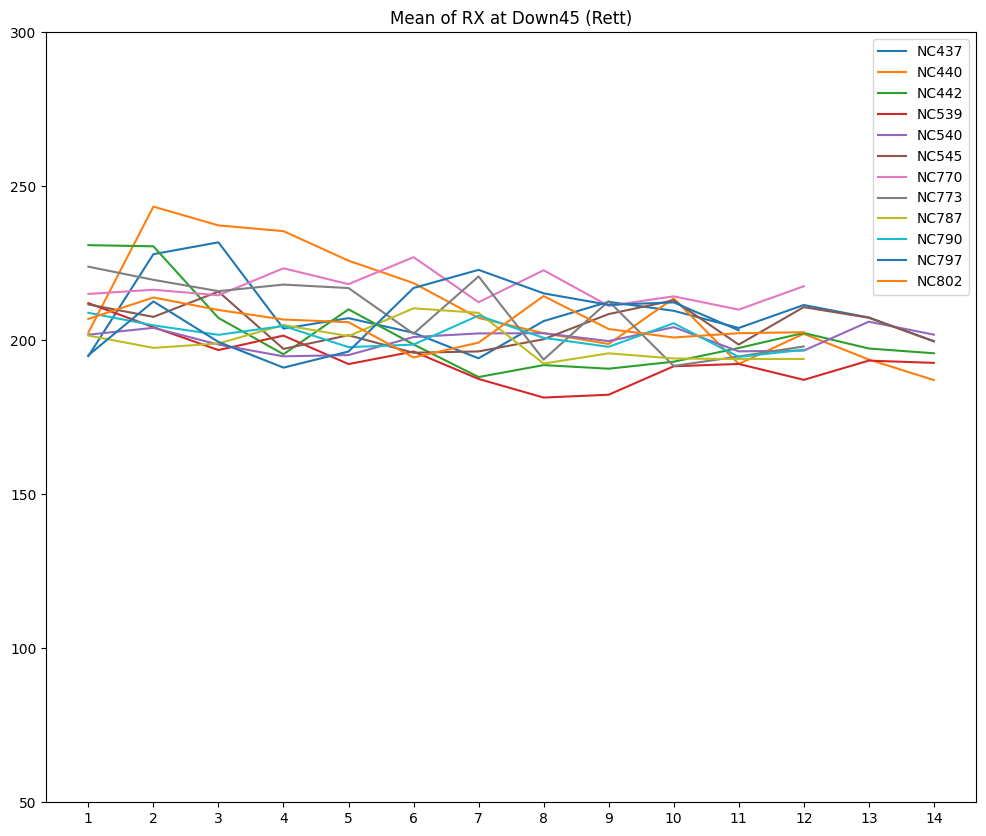

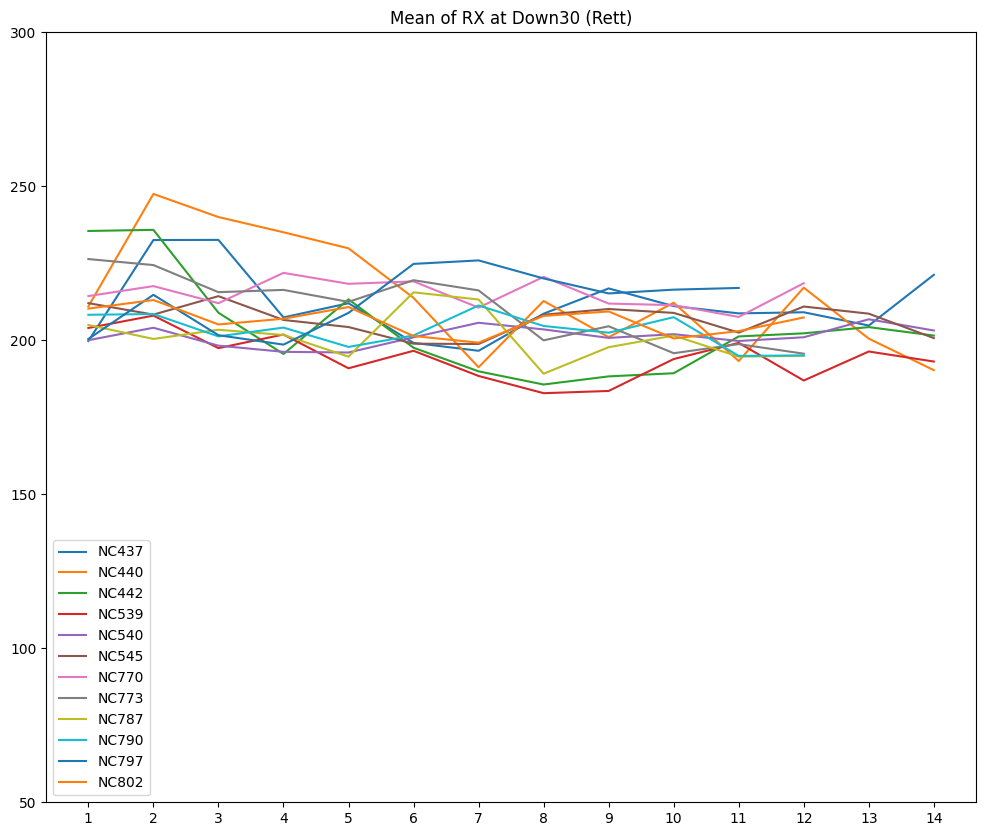

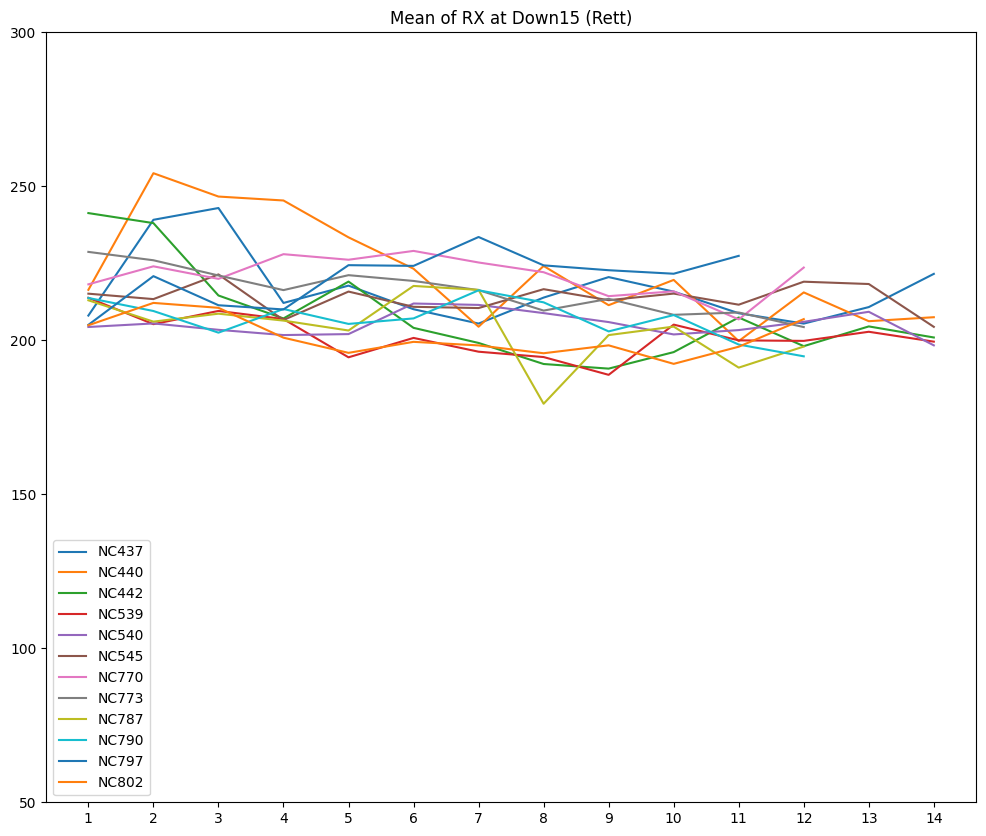

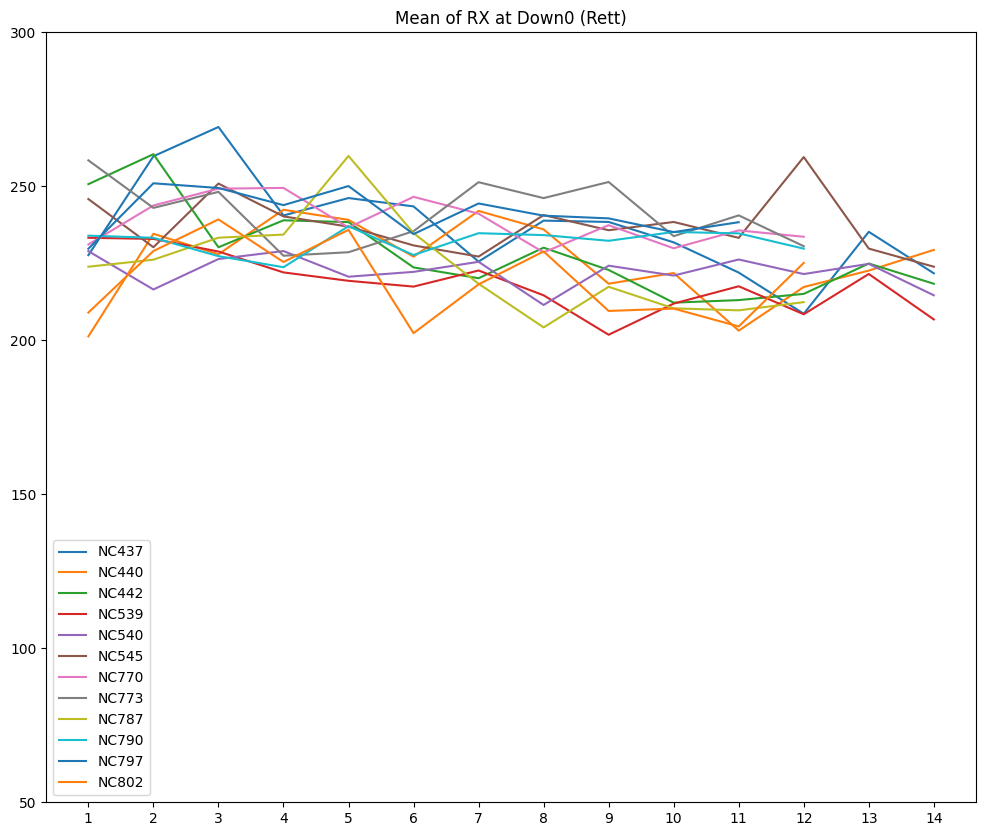

In [ ]:
# 13: down_RX_mean_list

for i in range(len(down_speed_list)):
  df = generate_df_list(rett, 13, down_speed_list[i])
  plotline(df, rett_labels, days, 'Mean', 'RX', down_title_list[i], 'Rett')

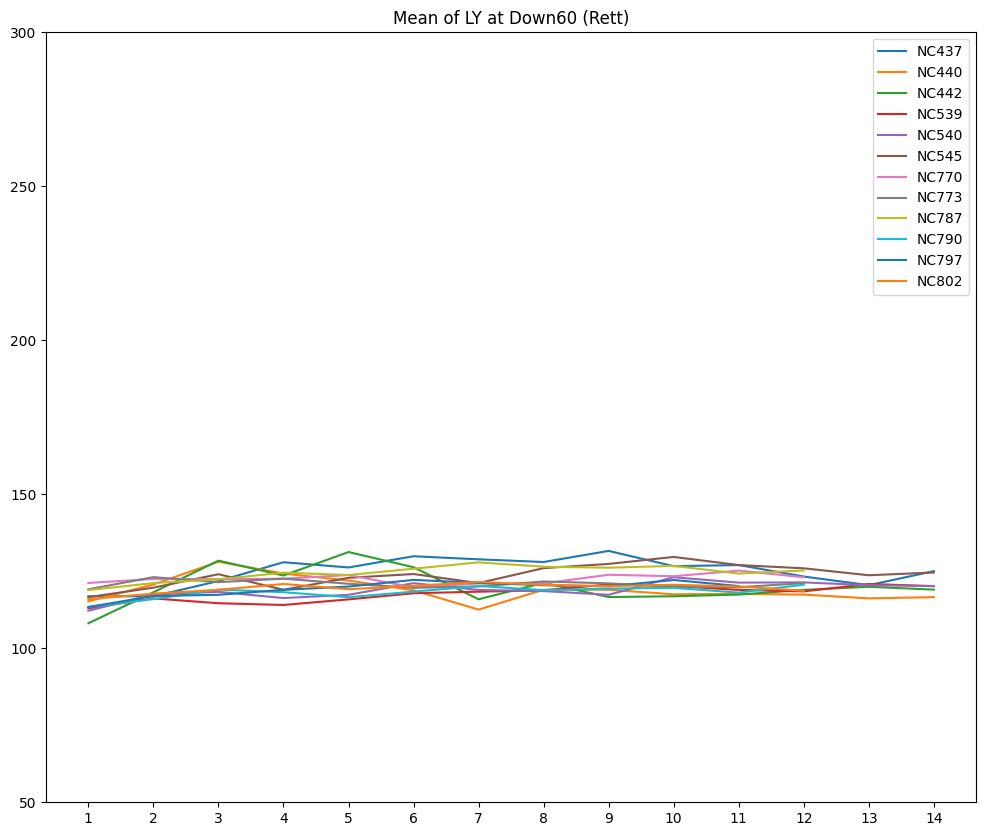

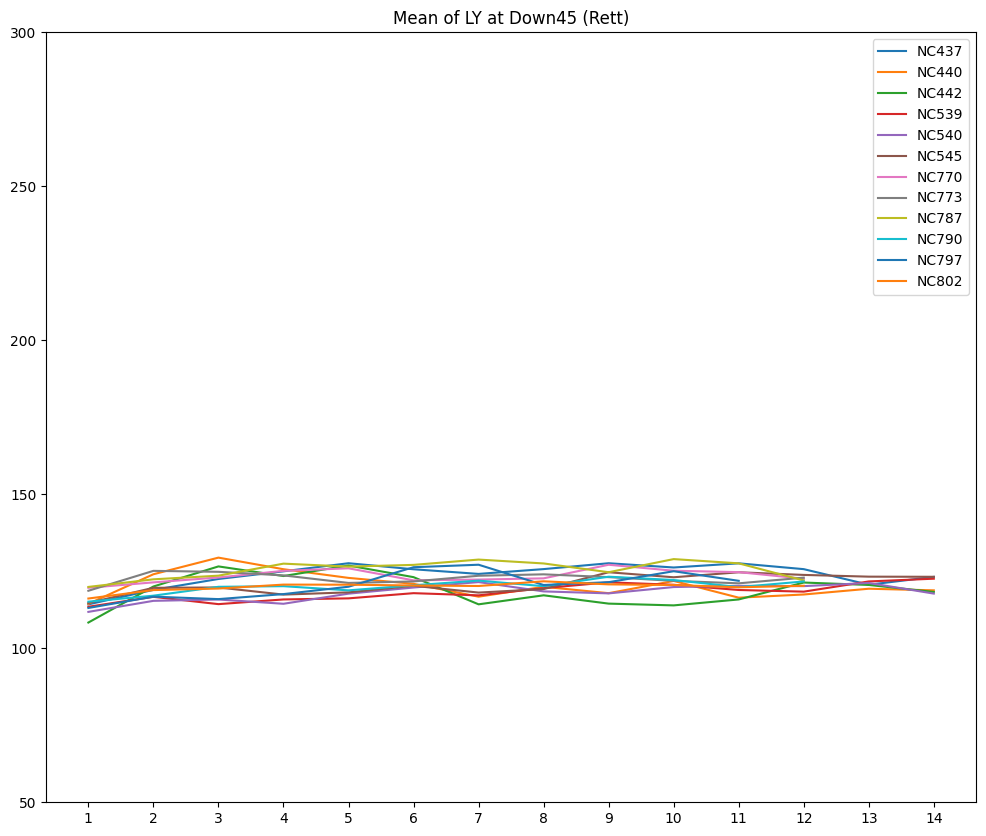

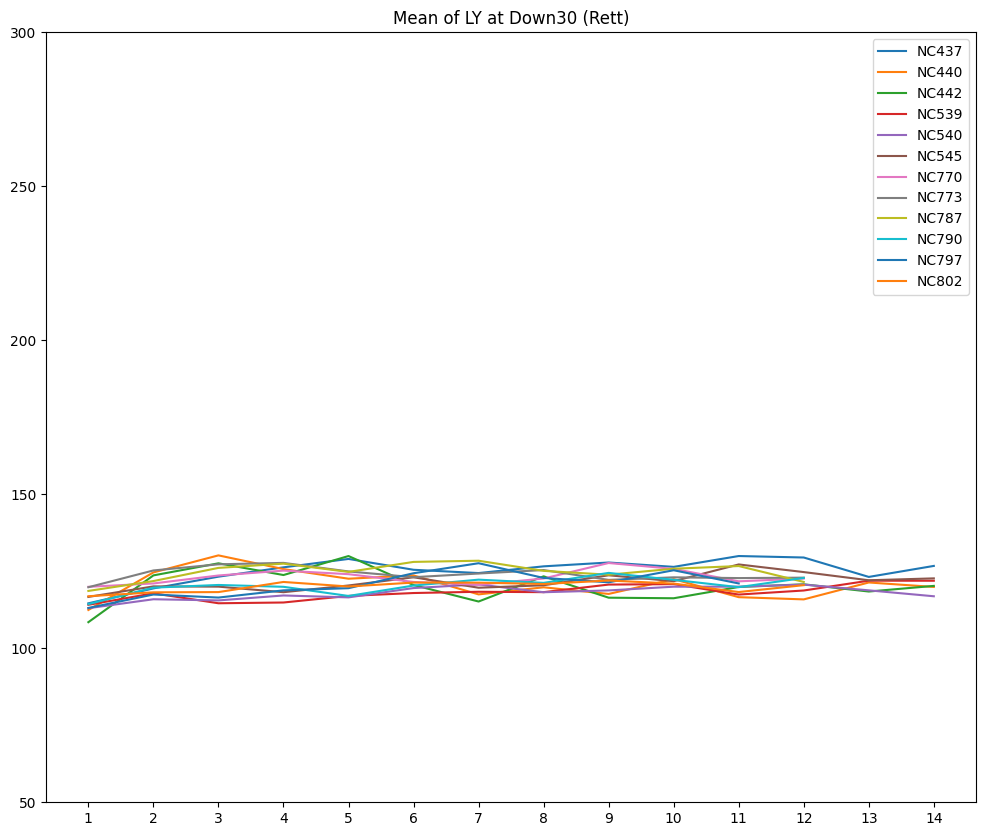

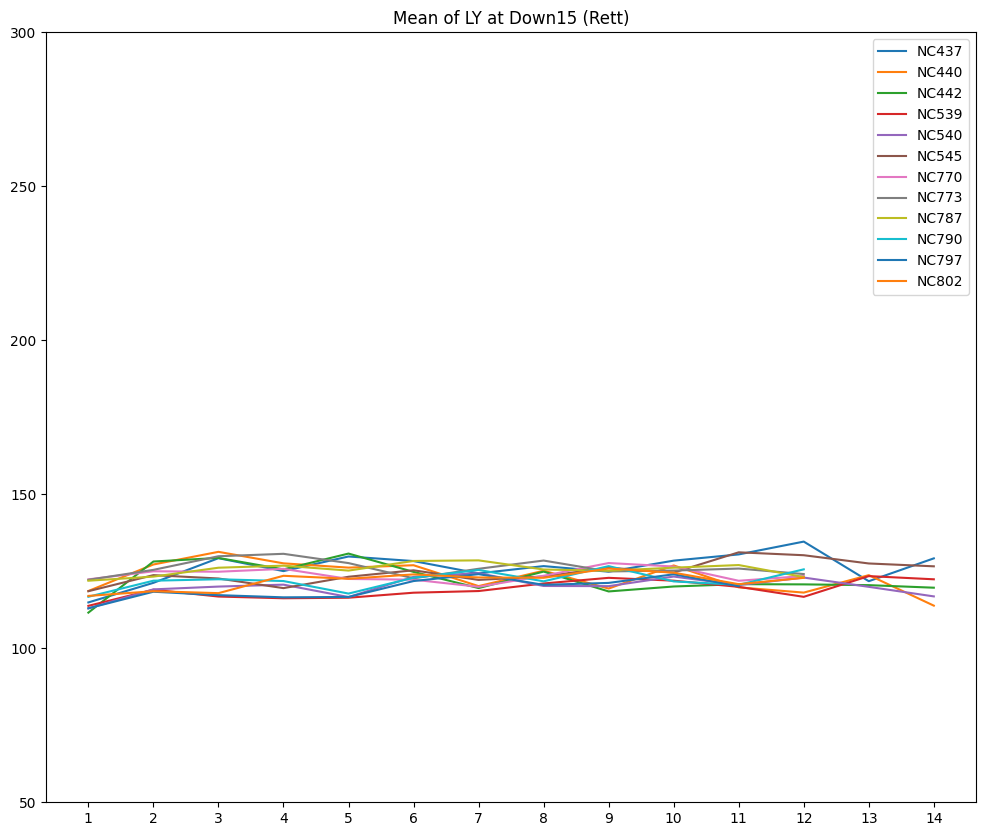

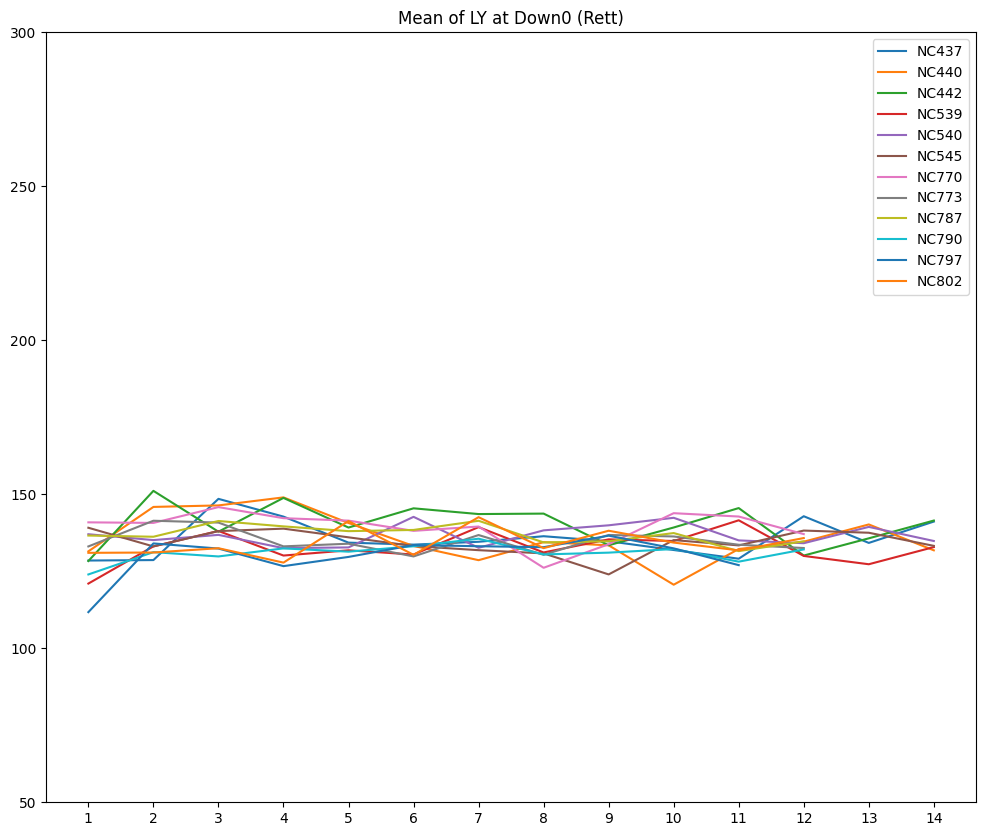

In [ ]:
# 14: down_LY_mean_list 

for i in range(len(down_speed_list)):
  df = generate_df_list(rett, 14, down_speed_list[i])
  plotline(df, rett_labels, days, 'Mean', 'LY', down_title_list[i], 'Rett')

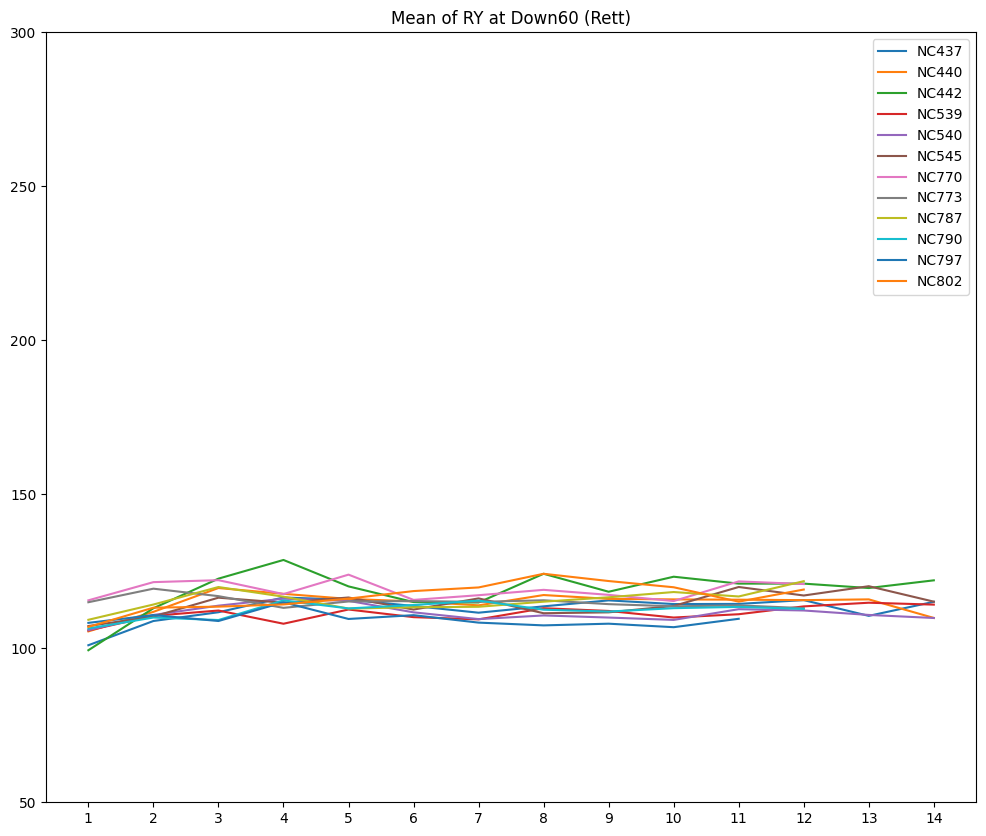

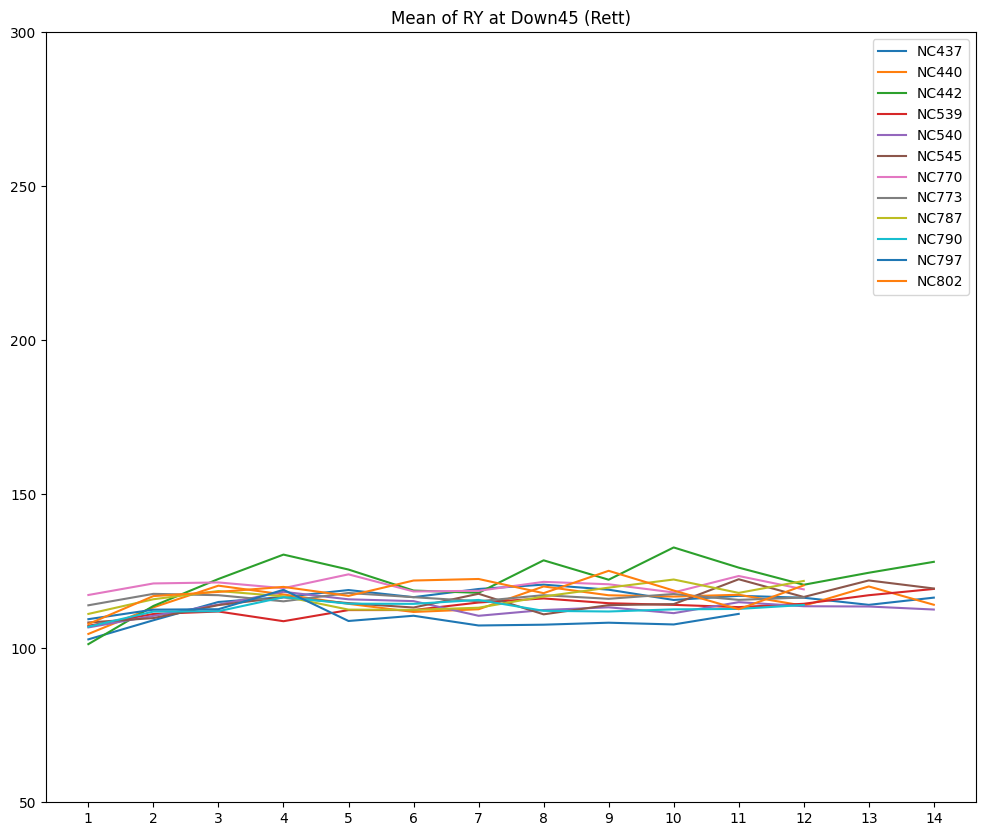

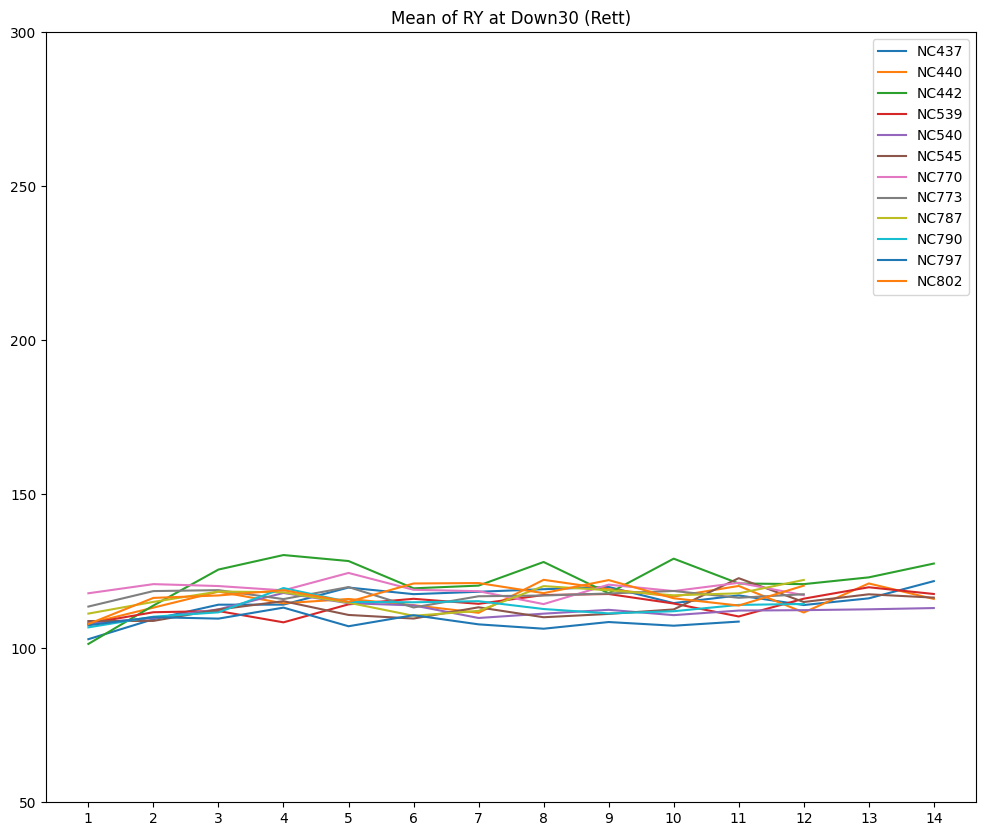

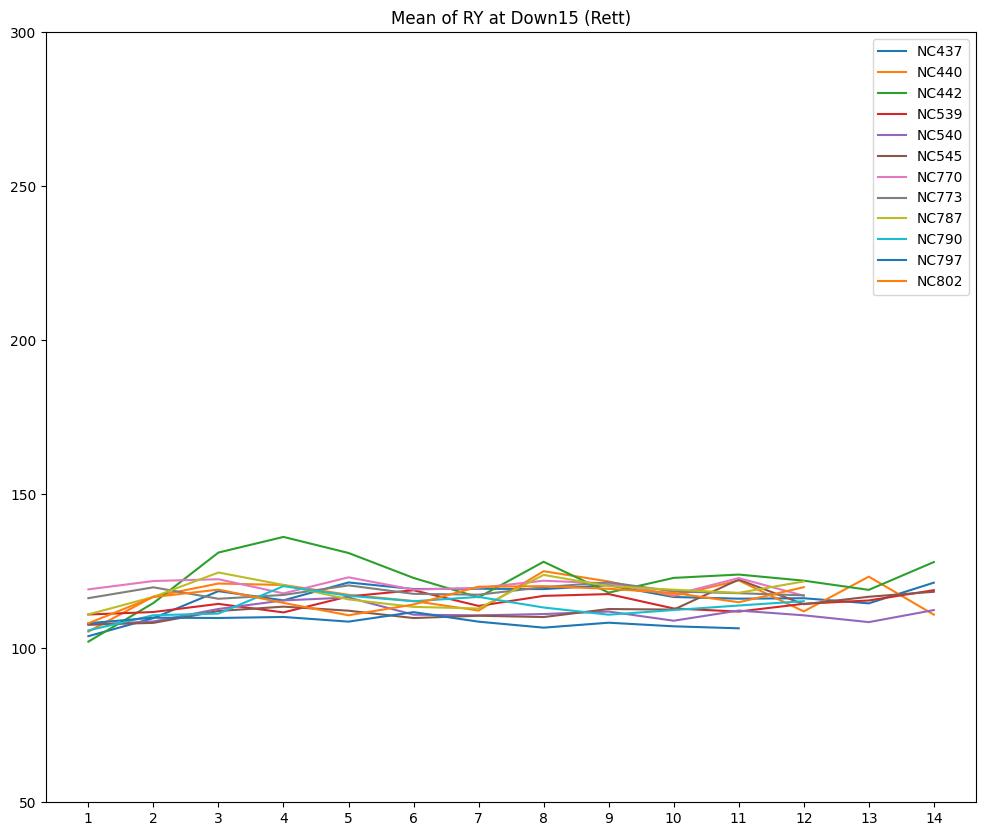

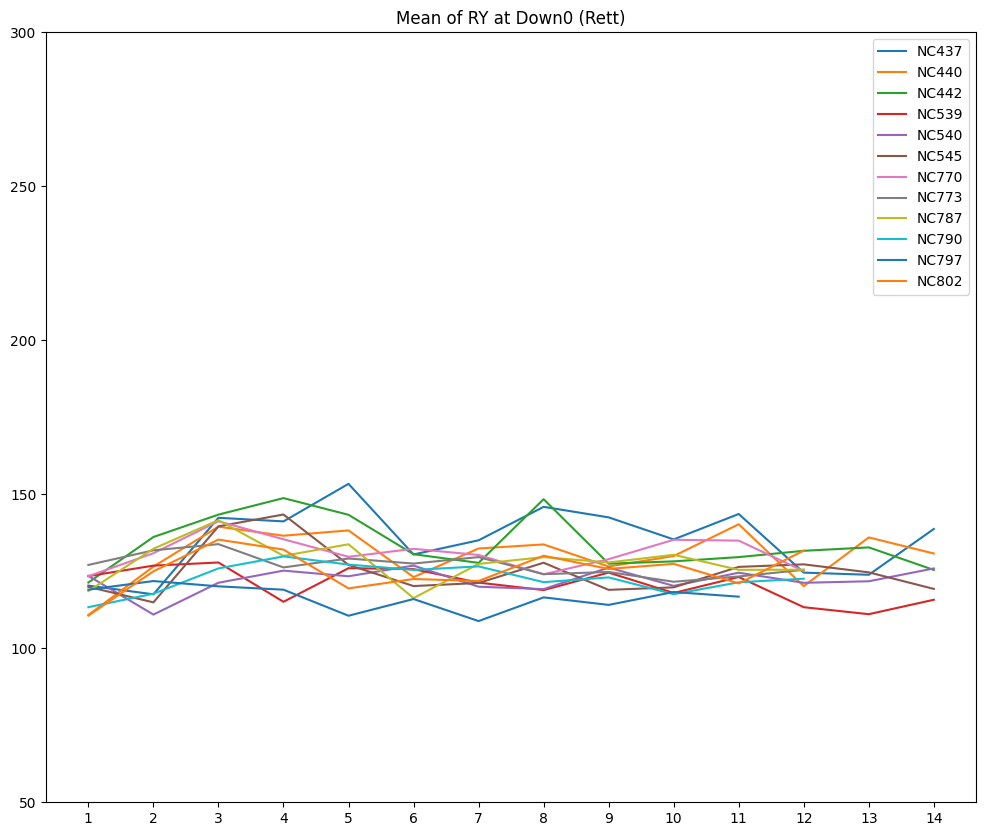

In [ ]:
# 15: down_RY_mean_list

for i in range(len(down_speed_list)):
  df = generate_df_list(rett, 15, down_speed_list[i])
  plotline(df, rett_labels, days, 'Mean', 'RY', down_title_list[i], 'Rett')

## Not useful Std

In [ ]:
# Std LX

wild_plotline(std_mean_436[0], std_mean_443[0], std_mean_506[0],
        "NC436", "NC443", "NC506", 
        days, 'Variability', 'LX', 'Up 60', 'Wild')

rett_plotline(std_mean_437[0], std_mean_440[0], std_mean_442[0],
        "NC437", "NC440", "NC442", 
        days, 'Variability', 'LX', 'Up 60', 'Rett')

In [ ]:
# Std Up RX

wild_plotline(std_mean_436[1], std_mean_443[1], std_mean_506[1],
        "NC436", "NC443", "NC506", 
        days, 'Variability', 'RX', 'Up 60', 'Wild')

rett_plotline(std_mean_437[1], std_mean_440[1], std_mean_442[1],
        "NC437", "NC440", "NC442", 
        days, 'Variability', 'RX', 'Up 60', 'Rett')

In [ ]:
# Std Up LY

wild_plotline(std_mean_436[2], std_mean_443[2], std_mean_506[2],
        "NC436", "NC443", "NC506", 
        days, 'Variability', 'LY', 'Up 60', 'Wild')

rett_plotline(std_mean_437[2], std_mean_440[2], std_mean_442[2],
        "NC437", "NC440", "NC442", 
        days, 'Variability', 'LY', 'Up 60', 'Rett')

In [ ]:
# Std Up RY

wild_plotline(std_mean_436[3], std_mean_443[3], std_mean_506[3],
        "NC436", "NC443", "NC506", 
        days, 'Variability', 'RY', 'Up 60', 'Wild')

rett_plotline(std_mean_437[3], std_mean_440[3], std_mean_442[3],
        "NC437", "NC440", "NC442", 
        days, 'Variability', 'RY', 'Up 60', 'Rett')

In [ ]:
# Std Down LX

wild_plotline(std_mean_436[4], std_mean_443[4], std_mean_506[4],
        "NC436", "NC443", "NC506", 
        days, 'Variability', 'LX', 'Down 60', 'Wild')

rett_plotline(std_mean_437[4], std_mean_440[4], std_mean_442[4],
        "NC437", "NC440", "NC442", 
        days, 'Variability', 'LX', 'Down 60', 'Rett')

In [ ]:
# Std Down RX

wild_plotline(std_mean_436[5], std_mean_443[5], std_mean_506[5],
        "NC436", "NC443", "NC506", 
        days, 'Variability', 'RX', 'Down 60', 'Wild')

rett_plotline(std_mean_437[5], std_mean_440[5], std_mean_442[5],
        "NC437", "NC440", "NC442", 
        days, 'Variability', 'RX', 'Down 60', 'Rett')

In [ ]:
# Std Down LY

wild_plotline(std_mean_436[6], std_mean_443[6], std_mean_506[6],
        "NC436", "NC443", "NC506", 
        days, 'Variability', 'LY', 'Down 60', 'Wild')

rett_plotline(std_mean_437[6], std_mean_440[6], std_mean_442[6],
        "NC437", "NC440", "NC442", 
        days, 'Variability', 'LY', 'Down 60', 'Rett')

In [ ]:
# Std Down RY

wild_plotline(std_mean_436[7], std_mean_443[7], std_mean_506[7],
        "NC436", "NC443", "NC506", 
        days, 'Variability', 'RY', 'Down 60', 'Wild')

rett_plotline(std_mean_437[7], std_mean_440[7], std_mean_442[7],
        "NC437", "NC440", "NC442", 
        days, 'Variability', 'RY', 'Down 60', 'Rett')

## Not useful Mean

In [ ]:
def wild_plotline(df1,df2,df3,l1,l2,l3, xt, stat, pos, speed, type):
  p1 = np.asarray(df1)
  p2 = np.asarray(df2)
  p3 = np.asarray(df3)

  x = range(14)
  plt.xticks(x, xt)
  plt.ylim(80,300)

  plt.title(stat + ' of ' + pos + ' at ' + speed + ' (' + type + ')')

  plt.plot(p1, label = l1, color='blue')
  plt.plot(p2, label = l2, color='green')
  plt.plot(p3, label = l3, color='darkcyan')
  plt.legend()
  plt.show()

def rett_plotline(df1,df2,df3,l1,l2,l3, xt, stat, pos, speed, type):
  p1 = np.asarray(df1)
  p2 = np.asarray(df2)
  p3 = np.asarray(df3)

  x = range(14)
  plt.xticks(x, xt)
  plt.ylim(80,300)

  plt.title(stat + ' of ' + pos + ' at ' + speed + ' (' + type + ')')
  plt.plot(p1, label = l1, color='red')
  plt.plot(p2, label = l2, color='orange')
  plt.plot(p3, label = l3, color='gold')
  plt.legend()
  plt.show()

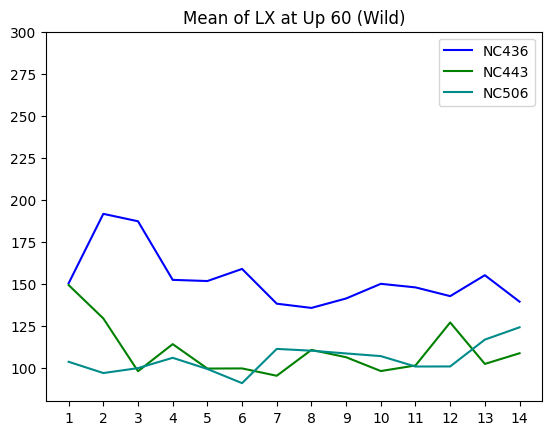

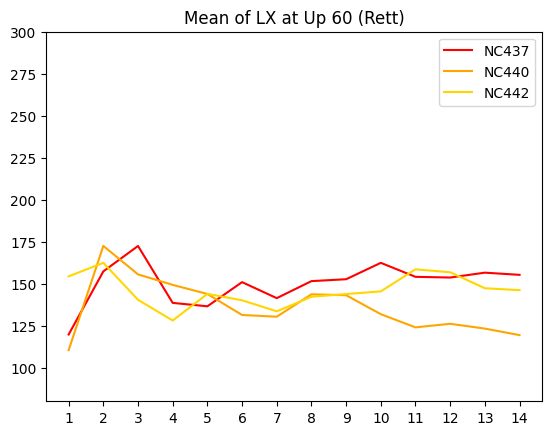

In [ ]:
# Mean Up LX

wild_plotline(std_mean_436[8], std_mean_443[8], std_mean_506[8],
        "NC436", "NC443", "NC506", 
        days, 'Mean', 'LX', 'Up 60', 'Wild')

rett_plotline(std_mean_437[8], std_mean_440[8], std_mean_442[8],
        "NC437", "NC440", "NC442", 
        days, 'Mean', 'LX', 'Up 60', 'Rett')

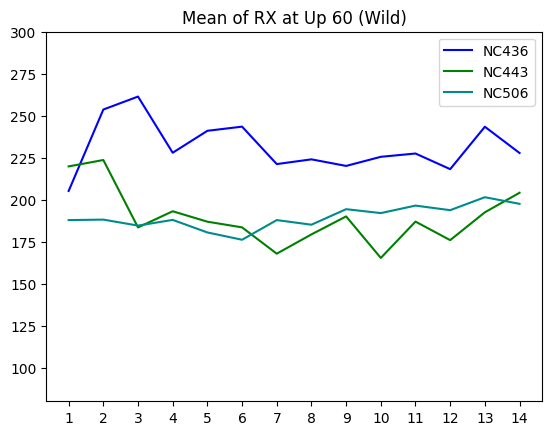

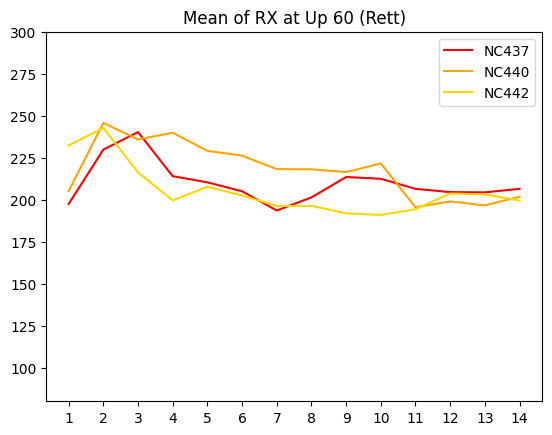

In [ ]:
# Mean Up RX

wild_plotline(std_mean_436[9], std_mean_443[9], std_mean_506[9],
        "NC436", "NC443", "NC506", 
        days, 'Mean', 'RX', 'Up 60', 'Wild')

rett_plotline(std_mean_437[9], std_mean_440[9], std_mean_442[9],
        "NC437", "NC440", "NC442", 
        days, 'Mean', 'RX', 'Up 60', 'Rett')

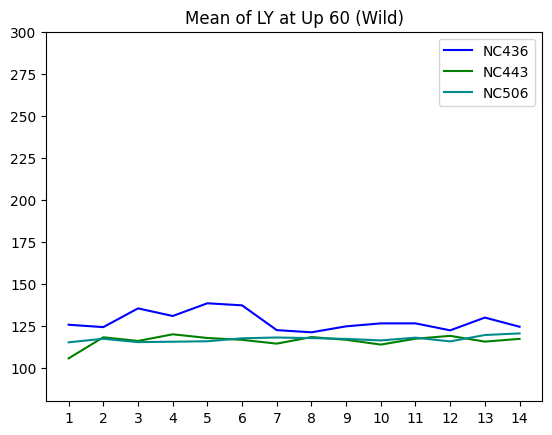

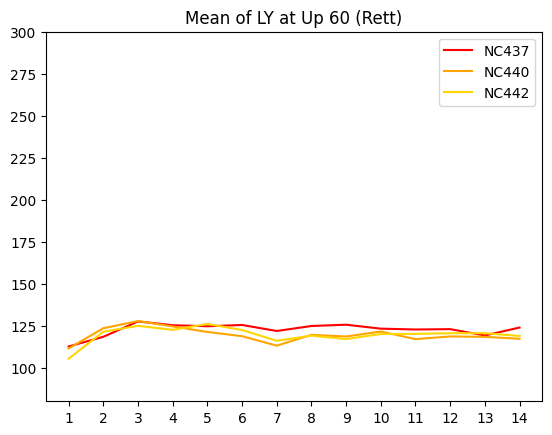

In [ ]:
# Mean Up LY

wild_plotline(std_mean_436[10], std_mean_443[10], std_mean_506[10],
        "NC436", "NC443", "NC506", 
        days, 'Mean', 'LY', 'Up 60', 'Wild')

rett_plotline(std_mean_437[10], std_mean_440[10], std_mean_442[10],
        "NC437", "NC440", "NC442", 
        days, 'Mean', 'LY', 'Up 60', 'Rett')

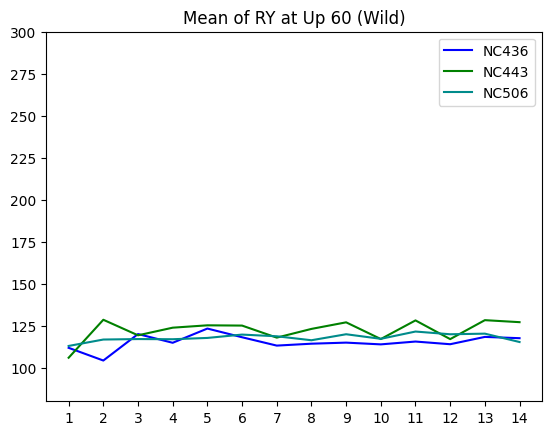

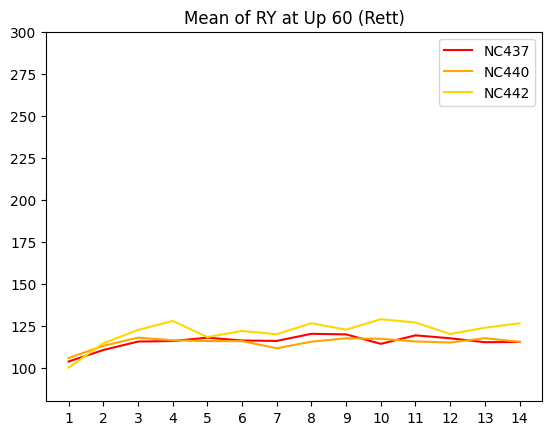

In [ ]:
# Mean Up RY

wild_plotline(std_mean_436[11], std_mean_443[11], std_mean_506[11],
        "NC436", "NC443", "NC506", 
        days, 'Mean', 'RY', 'Up 60', 'Wild')

rett_plotline(std_mean_437[11], std_mean_440[11], std_mean_442[11],
        "NC437", "NC440", "NC442", 
        days, 'Mean', 'RY', 'Up 60', 'Rett')

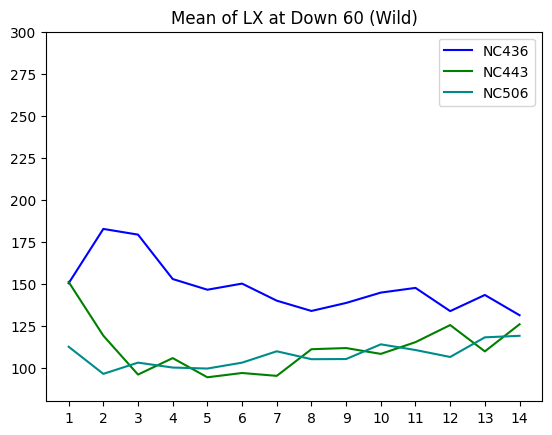

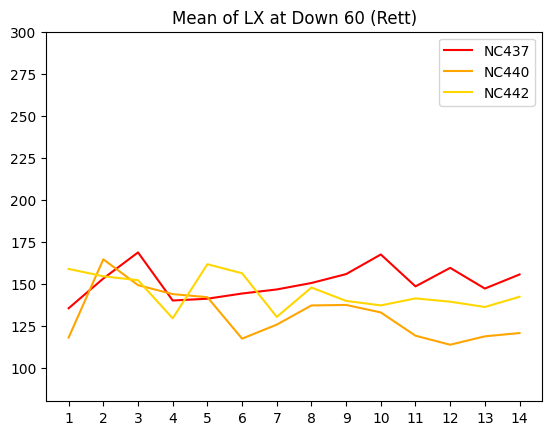

In [ ]:
# Mean Down LX

wild_plotline(std_mean_436[12], std_mean_443[12], std_mean_506[12],
        "NC436", "NC443", "NC506", 
        days, 'Mean', 'LX', 'Down 60', 'Wild')

rett_plotline(std_mean_437[12], std_mean_440[12], std_mean_442[12],
        "NC437", "NC440", "NC442", 
        days, 'Mean', 'LX', 'Down 60', 'Rett')

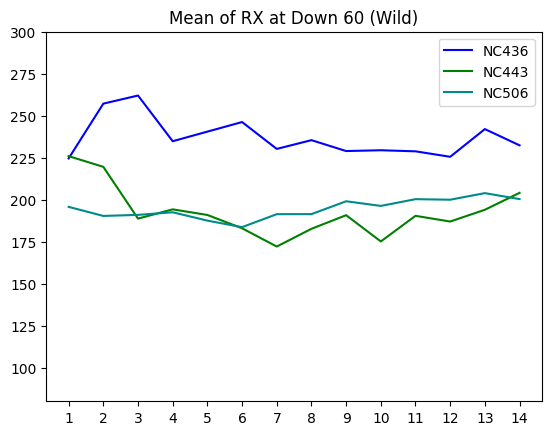

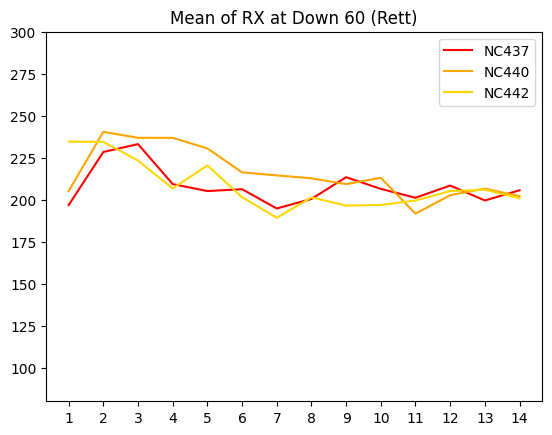

In [ ]:
# Mean Down RX

wild_plotline(std_mean_436[13], std_mean_443[13], std_mean_506[13],
        "NC436", "NC443", "NC506", 
        days, 'Mean', 'RX', 'Down 60', 'Wild')

rett_plotline(std_mean_437[13], std_mean_440[13], std_mean_442[13],
        "NC437", "NC440", "NC442", 
        days, 'Mean', 'RX', 'Down 60', 'Rett')

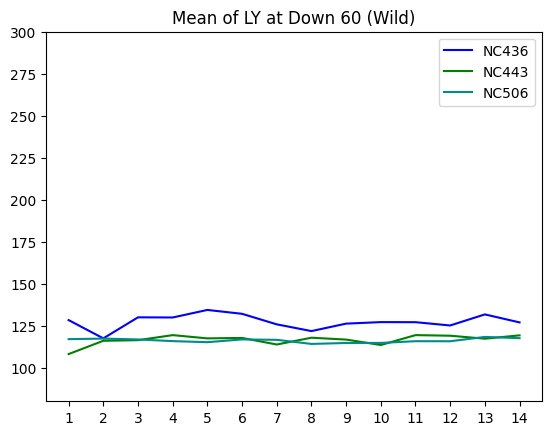

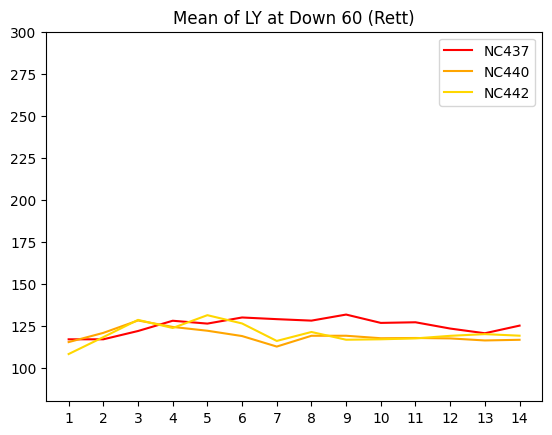

In [ ]:
# Mean Down LY

wild_plotline(std_mean_436[14], std_mean_443[14], std_mean_506[14],
        "NC436", "NC443", "NC506", 
        days, 'Mean', 'LY', 'Down 60', 'Wild')

rett_plotline(std_mean_437[14], std_mean_440[14], std_mean_442[14],
        "NC437", "NC440", "NC442", 
        days, 'Mean', 'LY', 'Down 60', 'Rett')

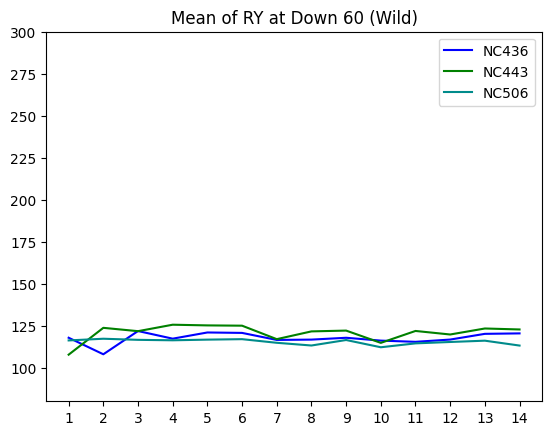

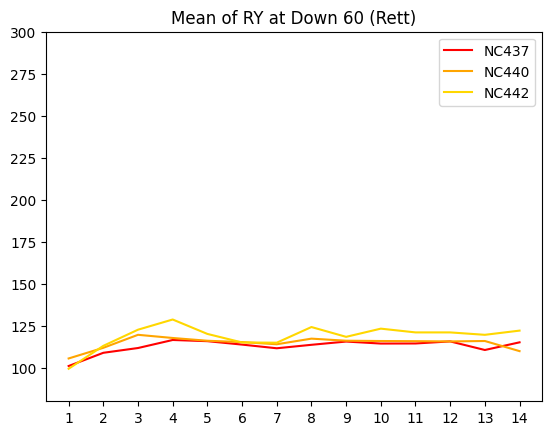

In [ ]:
# Mean Down RY

wild_plotline(std_mean_436[15], std_mean_443[15], std_mean_506[15],
        "NC436", "NC443", "NC506", 
        days, 'Mean', 'RY', 'Down 60', 'Wild')

rett_plotline(std_mean_437[15], std_mean_440[15], std_mean_442[15],
        "NC437", "NC440", "NC442", 
        days, 'Mean', 'RY', 'Down 60', 'Rett')

In [ ]:
# plotline(std_mean[0], days, 'Variability', 'LX', 'Speed up 60')
# print(std_mean[0])
# plotline(std_mean[8], days, 'Mean', 'LX', 'Speed up 60')
# print(std_mean[8])

# plotline(std_mean[1], days, 'Variability', 'RX', 'Speed up 60')
# print(std_mean[1])
# plotline(std_mean[9], days, 'Mean', 'RX', 'Speed up 60')
# print(std_mean[9])

# plotline(std_mean[2], days, 'Variability', 'LY', 'Speed up 60')
# print(std_mean[2])
# plotline(std_mean[10], days, 'Mean', 'LY', 'Speed up 60')
# print(std_mean[10])

# plotline(std_mean[3], days, 'Variability', 'RY', 'Speed up 60')
# print(std_mean[3])
# plotline(std_mean[11], days, 'Mean', 'RY', 'Speed up 60')
# print(std_mean[11])

In [ ]:
# plotline(std_mean[4], days, 'Variability', 'LX', 'Speed down 60')
# print(std_mean[4])
# plotline(std_mean[12], days, 'Mean', 'LX', 'Speed down 60')
# print(std_mean[12])

# plotline(std_mean[5], days, 'Variability', 'RX', 'Speed down 60')
# print(std_mean[5])
# plotline(std_mean[13], days, 'Mean', 'RX', 'Speed down 60')
# print(std_mean[13])

# plotline(std_mean[6], days, 'Variability', 'LY', 'Speed down 60')
# print(std_mean[6])
# plotline(std_mean[14], days, 'Mean', 'LY', 'Speed down 60')
# print(std_mean[14])

# plotline(std_mean[7], days, 'Variability', 'RY', 'Speed down 60')
# print(std_mean[7])
# plotline(std_mean[15], days, 'Mean', 'RY', 'Speed down 60')
# print(std_mean[15])

In [ ]:
def wild_plotline(df, xt, stat, pos, speed):
  p = np.asarray(df)
  x = range(14)
  plt.xticks(x, xt)
  plt.title(stat + ' of ' + pos + ' at ' + speed)
  plt.plot(p) #color
  plt.show()

def rett_plotline(df, xt, stat, pos, speed):
  p = np.asarray(df)
  x = range(14)
  plt.xticks(x, xt)
  plt.title(stat + ' of ' + pos + ' at ' + speed)
  plt.plot(p, color='red') #color
  plt.show()